# Basic GAN Network

> Add blockquote



In [ ]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt

In [ ]:
def show(tensor, ch=1, size=(28,28), num = 16):
    data = tensor.detach().cpu().view(-1, ch, *size)
    grid = make_grid(data[:num], nrow=4).permute(1, 2, 0)
    plt.imshow(grid)
    plt.show()

In [ ]:
epochs = 500
cur_step = 0
info_step = 300
mean_gen_loss = 0
mean_disc_loss = 0

z_dim = 64
lr = 0.00001
loss_func = nn.BCEWithLogitsLoss()

bs = 128
device = 'cuda' if torch.cuda.is_available() else 'cpu'

dataloader = DataLoader(
    MNIST('.', download=True, transform=transforms.ToTensor()),
    shuffle=True, batch_size=bs
)

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 9.91M/9.91M [00:00<00:00, 17.7MB/s]


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 28.9k/28.9k [00:00<00:00, 491kB/s]


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 1.65M/1.65M [00:01<00:00, 1.11MB/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw

Failed to download (trying next):
<urlopen error [SSL: CERTIFICATE_VERIFY_FAILED] certificate verify failed: certificate has expired (_ssl.c:1007)>



100%|██████████| 4.54k/4.54k [00:00<00:00, 5.58MB/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [ ]:
def genBlock(inp, out):
    return nn.Sequential(
        nn.Linear(inp, out),
        nn.BatchNorm1d(out),
        nn.ReLU(inplace=True)
    )

class Generator(nn.Module):
    def __init__(self, z_dim=64, i_dim=784, h_dim=128):
        super().__init__()
        self.gen = nn.Sequential(
            genBlock(z_dim, h_dim),   #inp 64, out 128
            genBlock(h_dim, h_dim*2),  #inp = 128 , ou 256
            genBlock(h_dim*2, h_dim*4), # 256 -> 512
            genBlock(h_dim*4, h_dim*8), #512 -> 1024
            nn.Linear(h_dim*8, i_dim),
            nn.Sigmoid(),
        )
    def forward(self, noise):
        return self.gen(noise)

def gen_noise(number, z_dim):
    return torch.randn(number, z_dim).to(device)

In [ ]:
def discBlock(inp, out):
    return nn.Sequential(
        nn.Linear(inp, out),
        nn.LeakyReLU(0.2)
    )

class Discriminator(nn.Module):
    def __init__(self, i_dim=784, h_dim=256):
        super().__init__()
        self.disc = nn.Sequential(
            discBlock(i_dim, h_dim*4),
            discBlock(h_dim*4, h_dim*2),
            discBlock(h_dim*2, h_dim),
            nn.Linear(h_dim, 1)
        )

    def forward(self, image):
        return self.disc(image)

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

gen

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Linear(in_features=64, out_features=128, bias=True)
      (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Linear(in_features=128, out_features=256, bias=True)
      (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): Linear(in_features=256, out_features=512, bias=True)
      (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): Linear(in_features=512, out_features=1024, bias=True)
      (1): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (4): Linear(in_features=1024, out_features=784, bias=True)
    (5): Sigmoid()
  )
)

In [ ]:
disc

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Linear(in_features=784, out_features=1024, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Linear(in_features=1024, out_features=512, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Linear(in_features=512, out_features=256, bias=True)
      (1): LeakyReLU(negative_slope=0.2)
    )
    (3): Linear(in_features=256, out_features=1, bias=True)
  )
)

torch.Size([128, 1, 28, 28]) torch.Size([128])
tensor([4, 1, 9, 6, 8, 3, 0, 5, 5, 7])


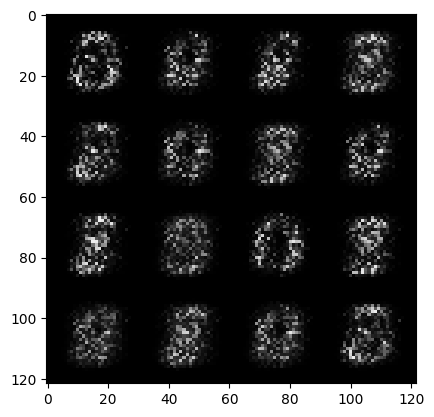

In [ ]:
x, y = next(iter(dataloader))
print(x.shape, y.shape)
print(y[:10])

noise = gen_noise(bs, z_dim)
fake = gen(noise)
show(fake)

In [ ]:
def calc_gen_loss(loss_func, gen, disc, number, z_dim):
    noise = gen_noise(number, z_dim)
    fake = gen(noise)
    pred = disc(fake)
    targets = torch.ones_like(pred)
    gen_loss = loss_func(pred, targets)
    return gen_loss

def calc_disc_loss(loss_func, gen, disc, number, real, z_dim):
    noise = gen_noise(number, z_dim)
    fake = gen(noise)
    disc_fake = disc(fake.detach())
    disc_fake_targets = torch.zeros_like(disc_fake)
    disc_fake_loss = loss_func(disc_fake, disc_fake_targets)

    disc_real = disc(real)
    disc_real_targets = torch.ones_like(disc_real)
    disc_real_loss = loss_func(disc_real, disc_real_targets)

    disc_loss = (disc_fake_loss + disc_real_loss) / 2
    return disc_loss

  0%|          | 0/469 [00:00<?, ?it/s]

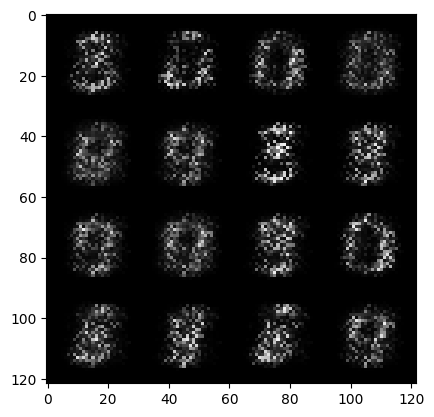

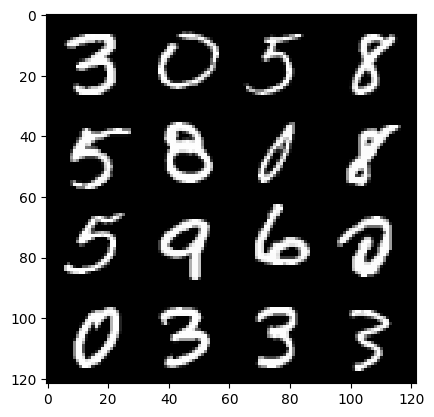

0: step 2700 / Gen loss: 4.336543056964873 / Disc loss: 0.029687370210885997


  0%|          | 0/469 [00:00<?, ?it/s]

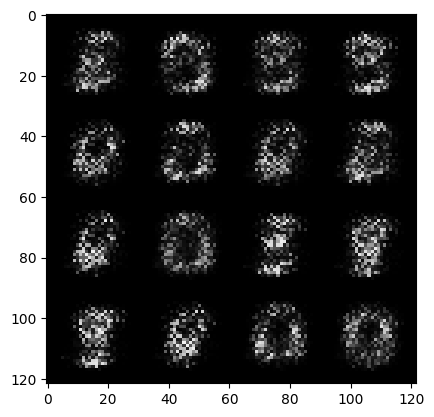

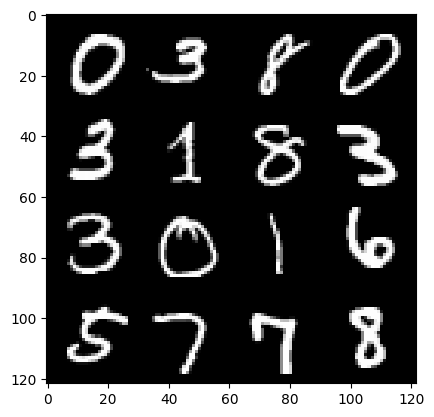

1: step 3000 / Gen loss: 4.70555035909017 / Disc loss: 0.027254239656031125


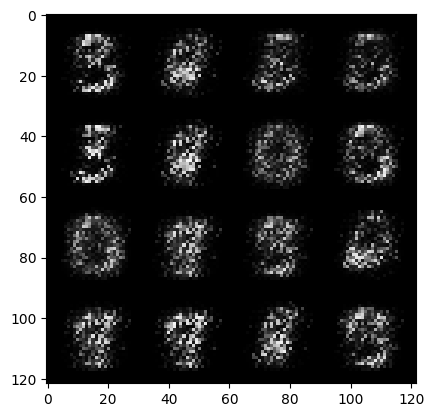

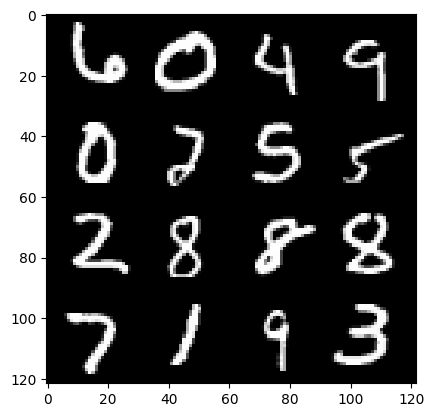

1: step 3300 / Gen loss: 5.01942812760671 / Disc loss: 0.02653299960618219


  0%|          | 0/469 [00:00<?, ?it/s]

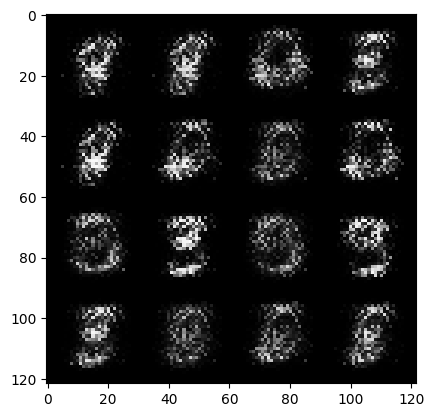

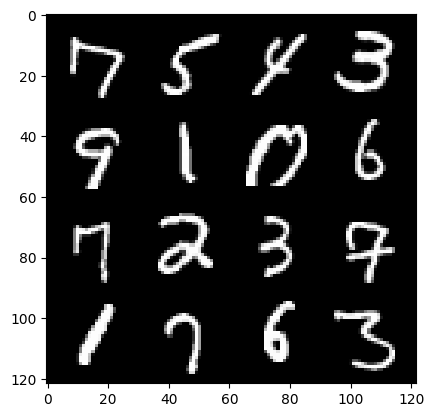

2: step 3600 / Gen loss: 5.166704592704775 / Disc loss: 0.022693668166175487


  0%|          | 0/469 [00:00<?, ?it/s]

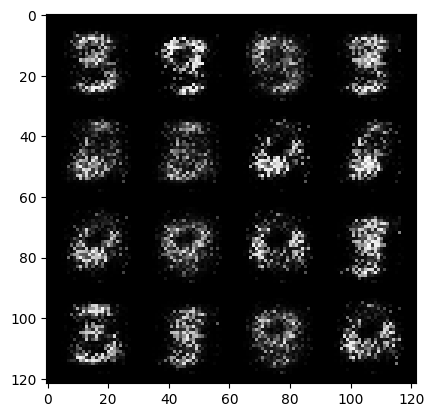

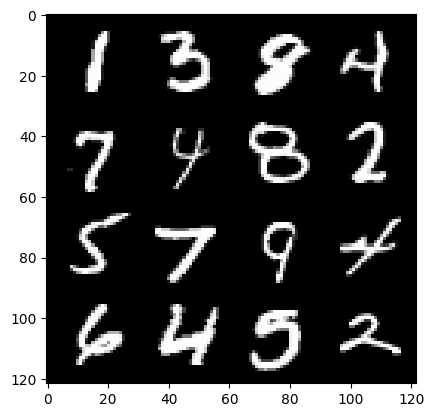

3: step 3900 / Gen loss: 5.37458246707916 / Disc loss: 0.018635320846612267


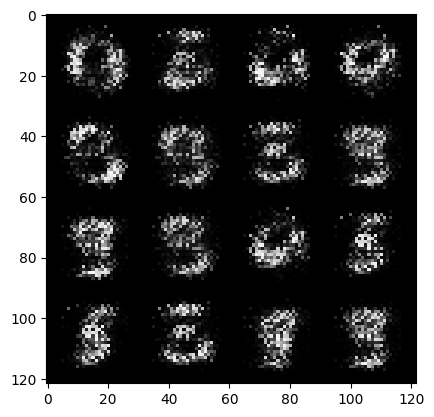

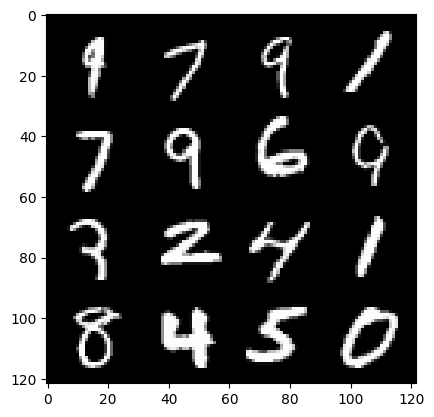

3: step 4200 / Gen loss: 5.691083219846088 / Disc loss: 0.01807953925182421


  0%|          | 0/469 [00:00<?, ?it/s]

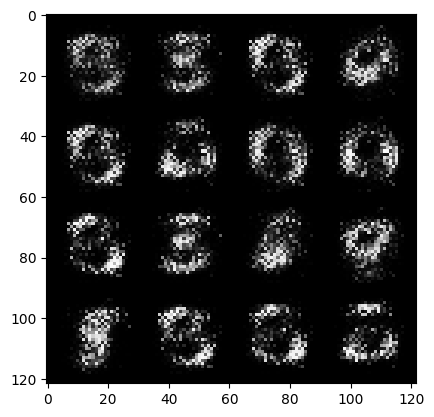

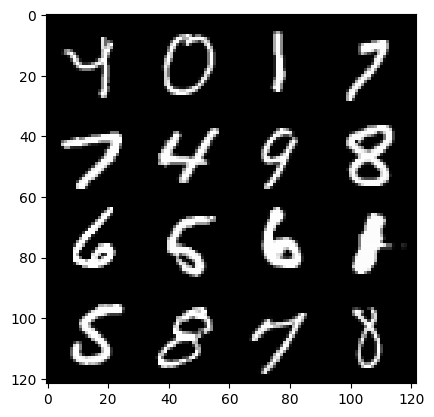

4: step 4500 / Gen loss: 6.005213812192281 / Disc loss: 0.013732349833784003


  0%|          | 0/469 [00:00<?, ?it/s]

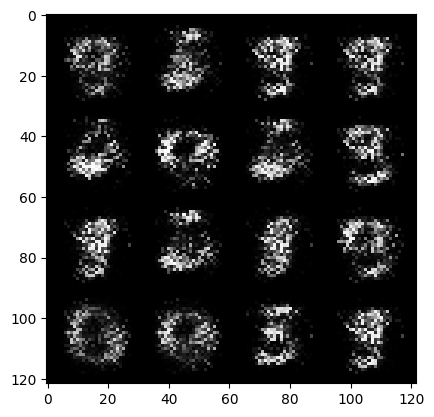

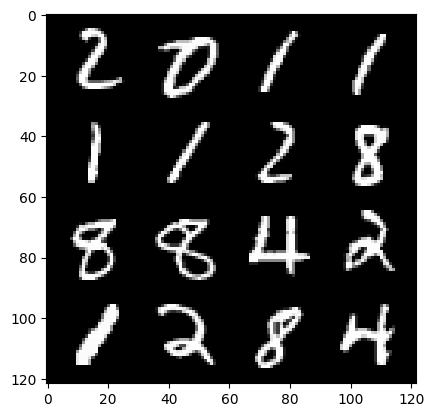

5: step 4800 / Gen loss: 6.304382761319482 / Disc loss: 0.011688293040109179


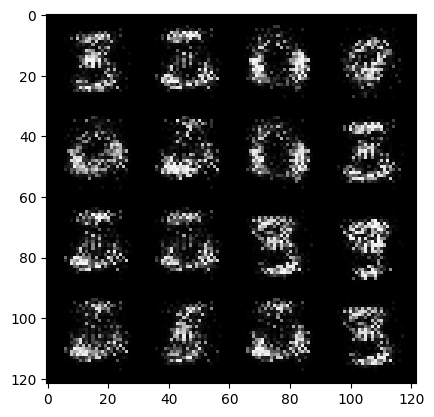

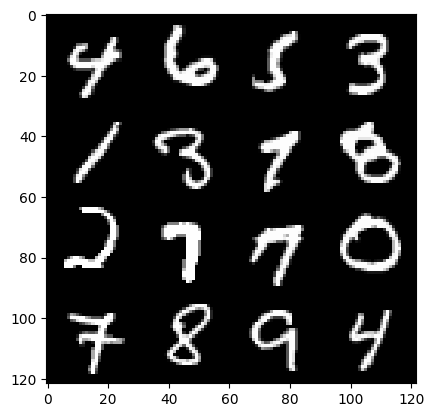

5: step 5100 / Gen loss: 6.412462984720865 / Disc loss: 0.009854639730571452


  0%|          | 0/469 [00:00<?, ?it/s]

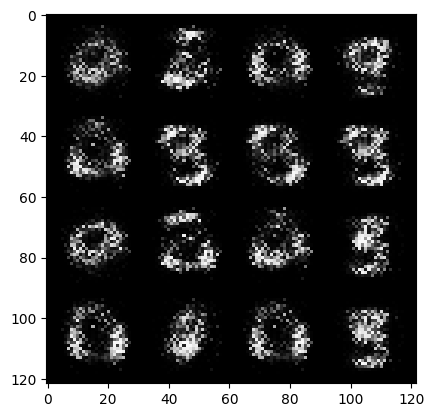

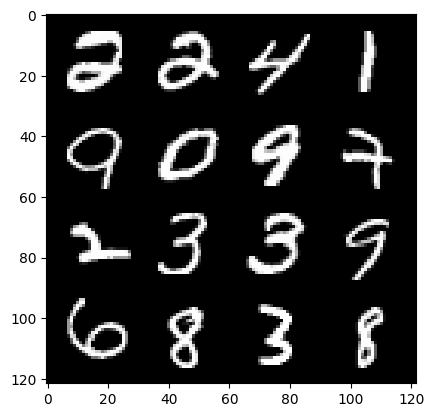

6: step 5400 / Gen loss: 6.307105762163798 / Disc loss: 0.009294352501941223


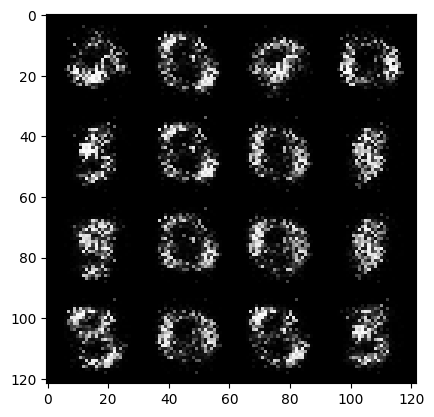

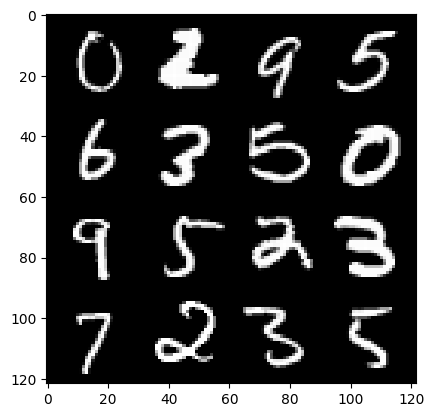

6: step 5700 / Gen loss: 6.528946336110434 / Disc loss: 0.009190271333791312


  0%|          | 0/469 [00:00<?, ?it/s]

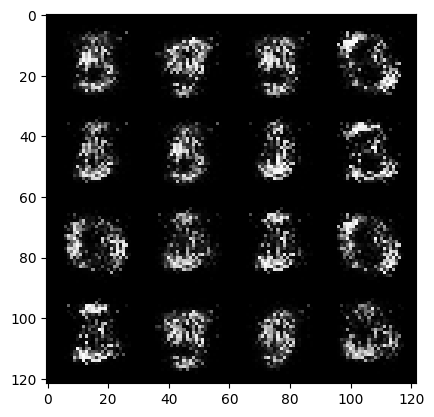

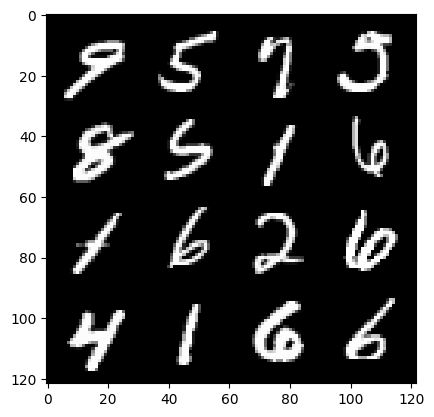

7: step 6000 / Gen loss: 6.719971906344095 / Disc loss: 0.008569117826409636


  0%|          | 0/469 [00:00<?, ?it/s]

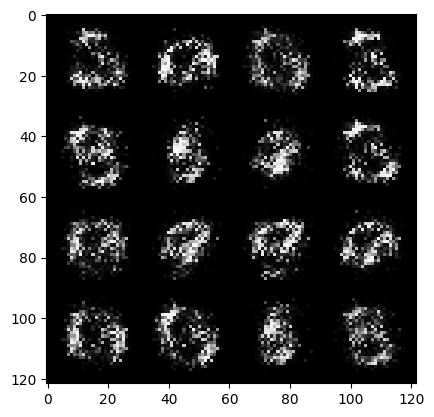

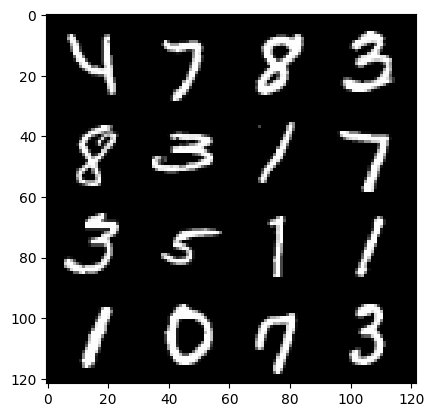

8: step 6300 / Gen loss: 6.855106840133665 / Disc loss: 0.008296583503639947


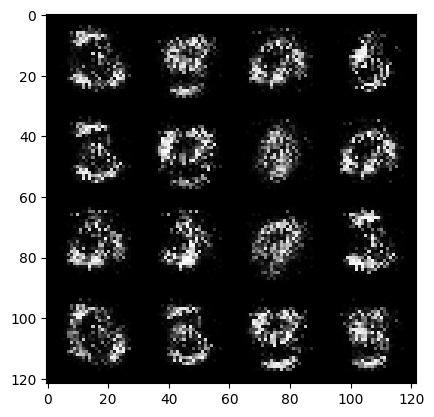

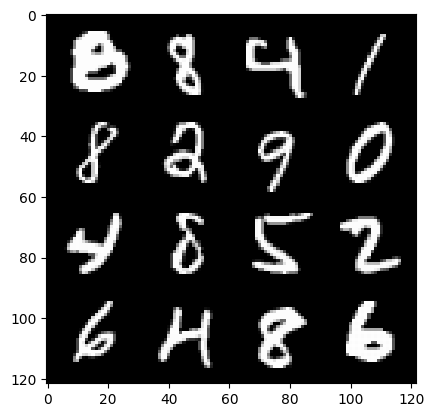

8: step 6600 / Gen loss: 6.972265254656471 / Disc loss: 0.008970613025594506


  0%|          | 0/469 [00:00<?, ?it/s]

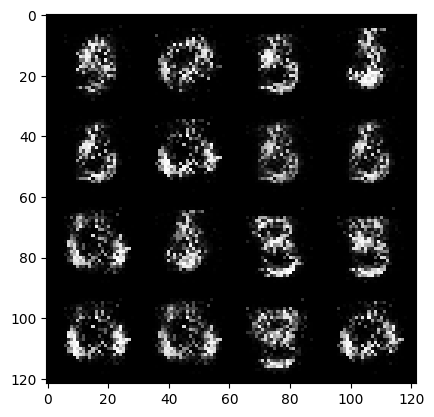

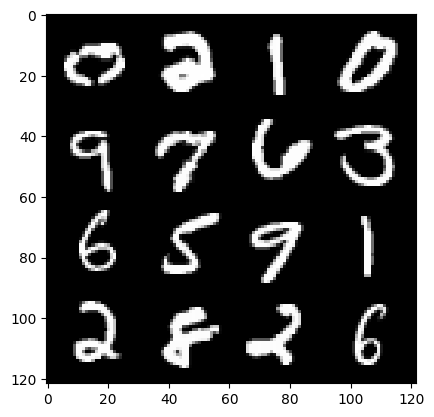

9: step 6900 / Gen loss: 7.35183082898458 / Disc loss: 0.008086892718371624


  0%|          | 0/469 [00:00<?, ?it/s]

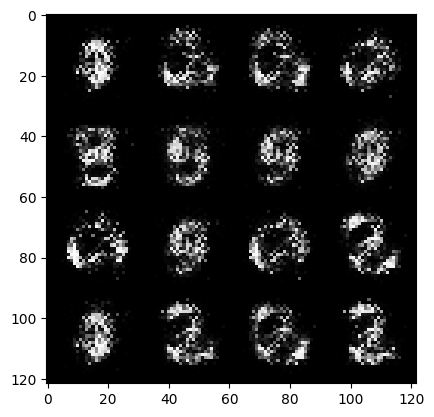

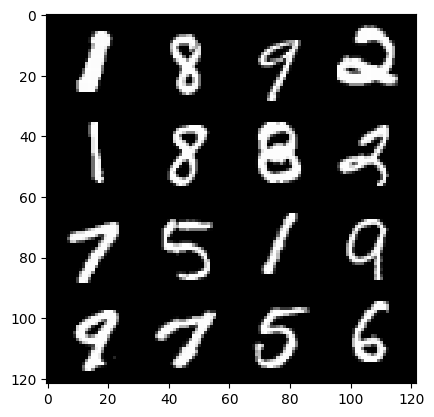

10: step 7200 / Gen loss: 7.1413644059499095 / Disc loss: 0.009054464679987474


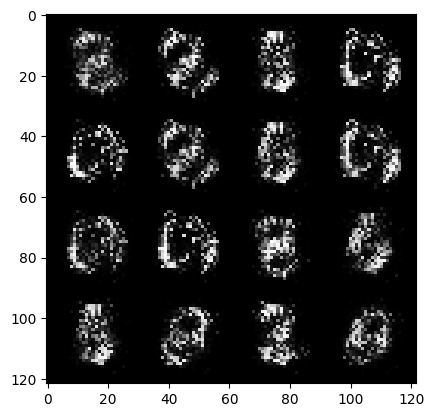

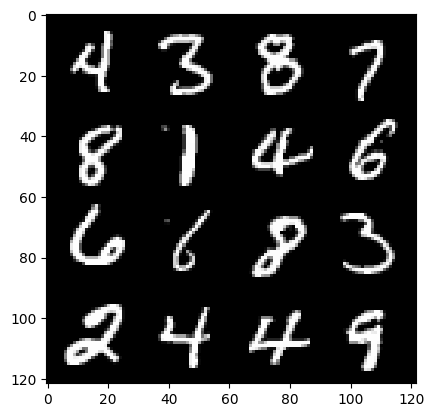

10: step 7500 / Gen loss: 7.2817005666097 / Disc loss: 0.009225375712849192


  0%|          | 0/469 [00:00<?, ?it/s]

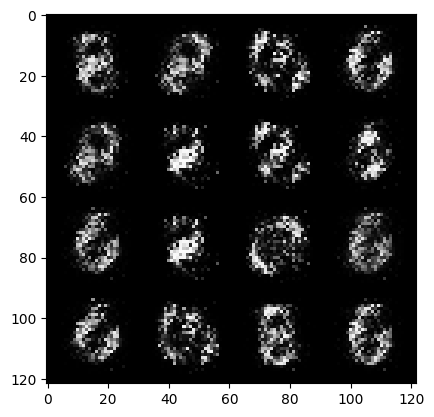

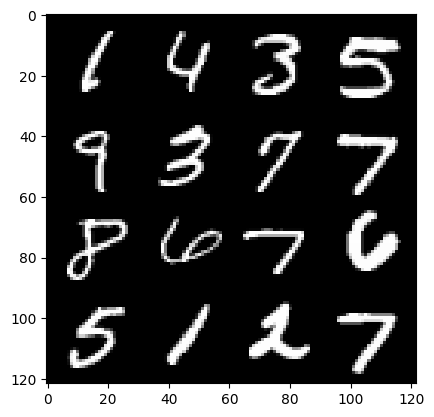

11: step 7800 / Gen loss: 7.55303032716115 / Disc loss: 0.011067608445106685


  0%|          | 0/469 [00:00<?, ?it/s]

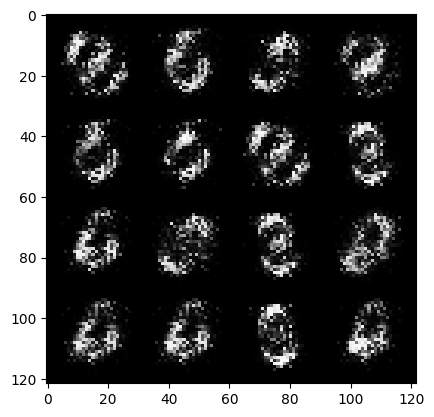

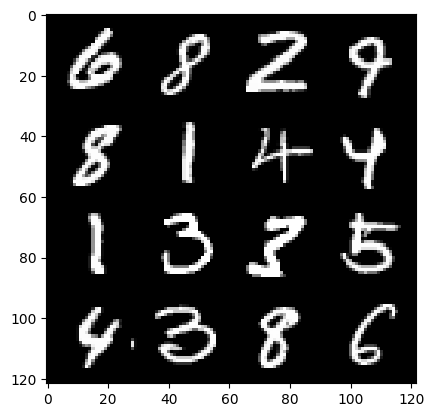

12: step 8100 / Gen loss: 7.122974476814275 / Disc loss: 0.015495222162765762


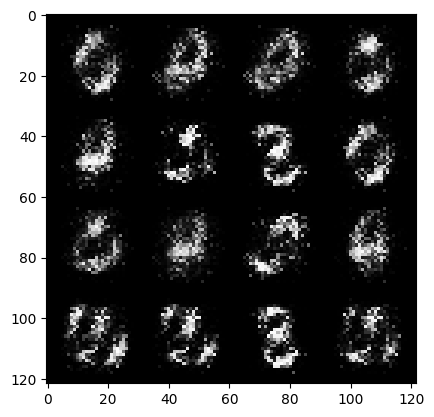

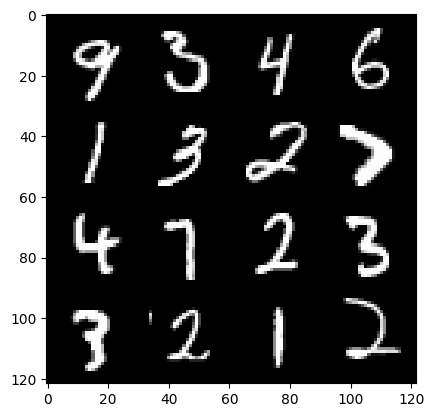

12: step 8400 / Gen loss: 7.294718303680423 / Disc loss: 0.01515990782451506


  0%|          | 0/469 [00:00<?, ?it/s]

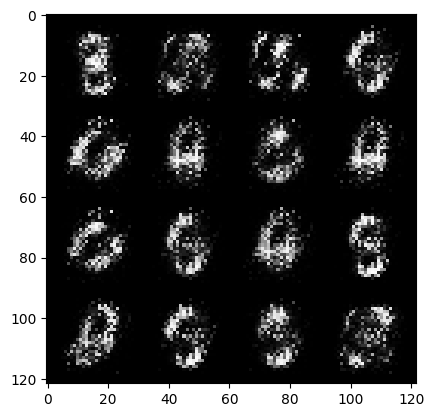

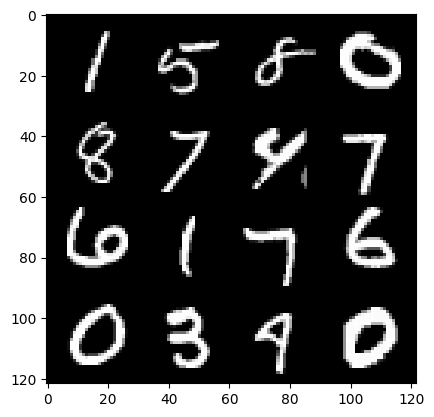

13: step 8700 / Gen loss: 6.975134166081743 / Disc loss: 0.012241725329464926


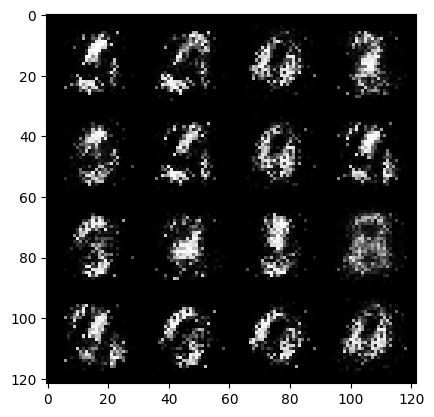

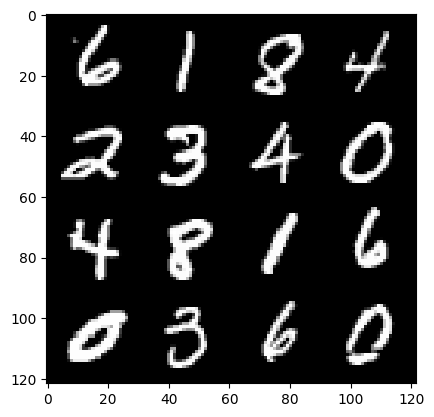

13: step 9000 / Gen loss: 7.29489375591278 / Disc loss: 0.00970096626707042


  0%|          | 0/469 [00:00<?, ?it/s]

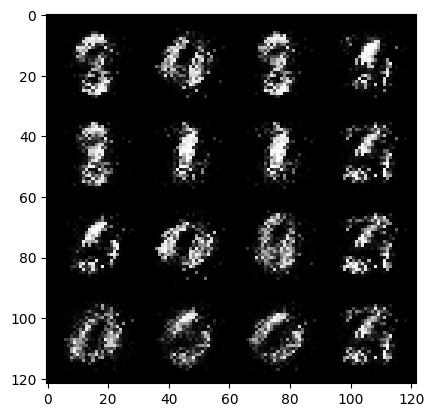

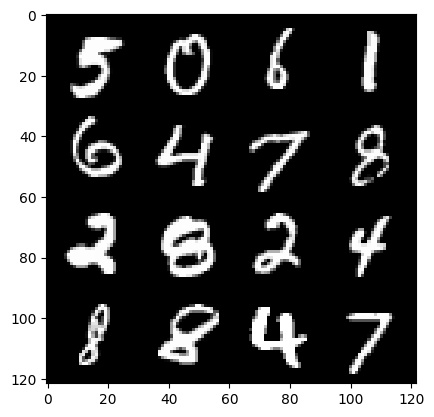

14: step 9300 / Gen loss: 7.830852977434795 / Disc loss: 0.008608118796255431


  0%|          | 0/469 [00:00<?, ?it/s]

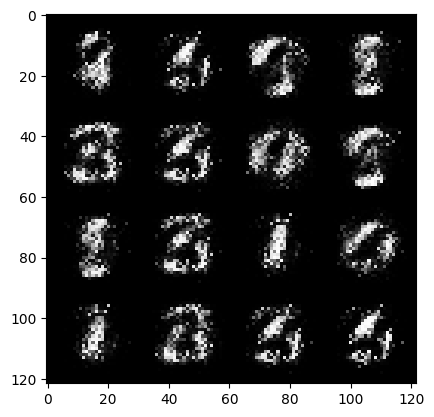

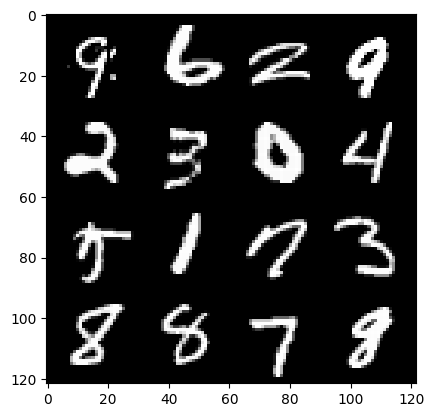

15: step 9600 / Gen loss: 7.4724505058924375 / Disc loss: 0.010679153017699712


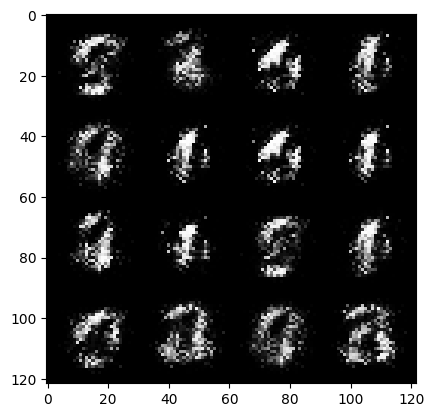

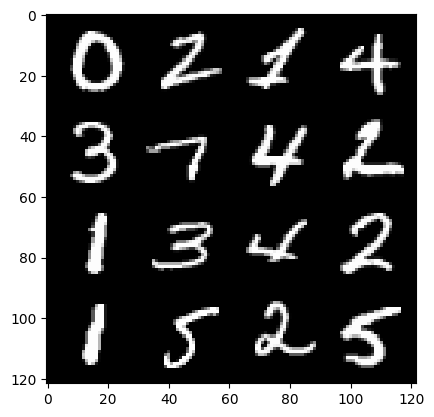

15: step 9900 / Gen loss: 7.271238265037537 / Disc loss: 0.011283710668794808


  0%|          | 0/469 [00:00<?, ?it/s]

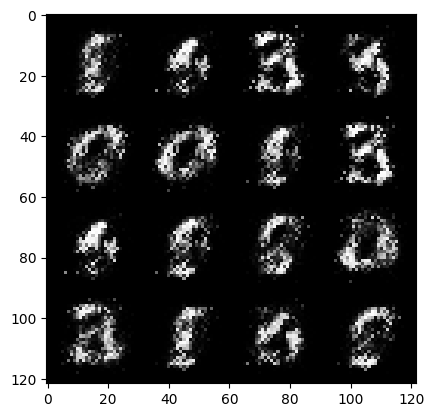

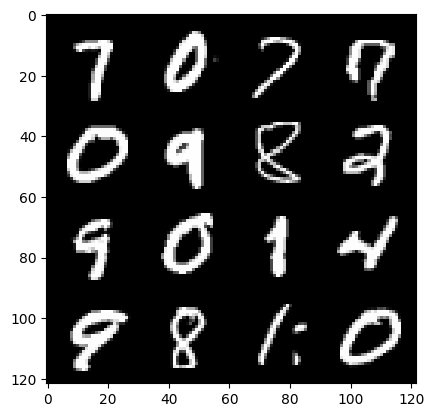

16: step 10200 / Gen loss: 7.126734371185299 / Disc loss: 0.011639483645558365


  0%|          | 0/469 [00:00<?, ?it/s]

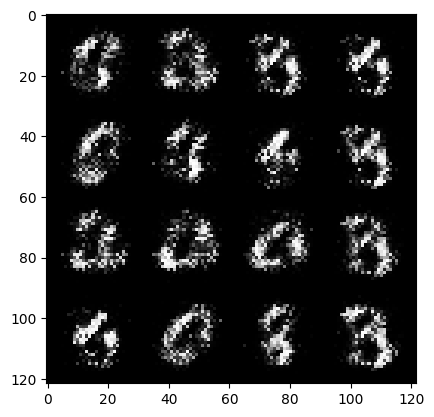

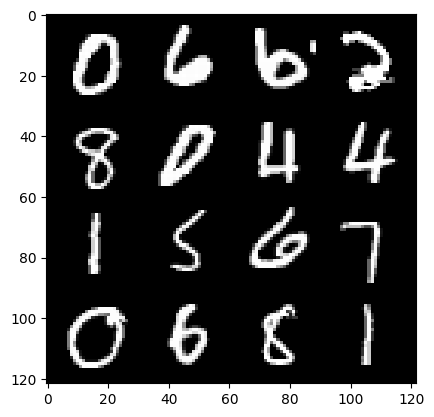

17: step 10500 / Gen loss: 6.5842471567789715 / Disc loss: 0.011035987510501088


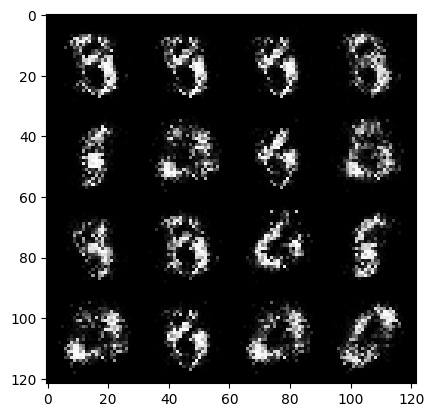

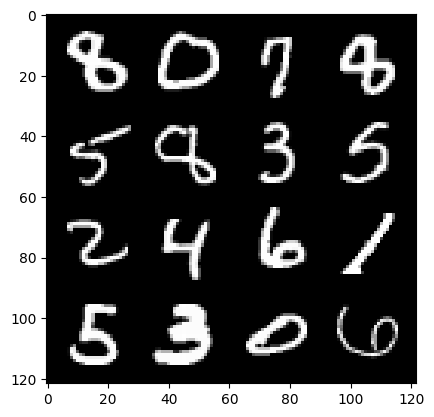

17: step 10800 / Gen loss: 6.6653955364227295 / Disc loss: 0.009219625230956213


  0%|          | 0/469 [00:00<?, ?it/s]

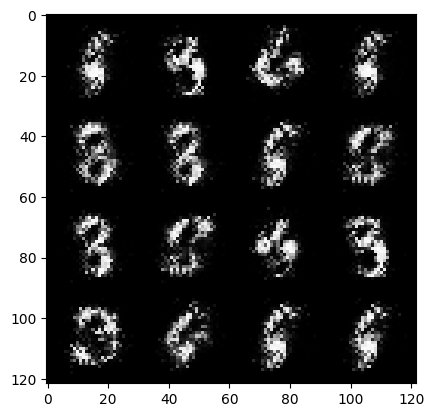

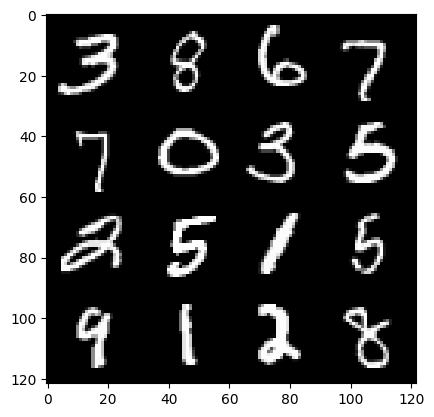

18: step 11100 / Gen loss: 6.923814091682434 / Disc loss: 0.010074241769422461


  0%|          | 0/469 [00:00<?, ?it/s]

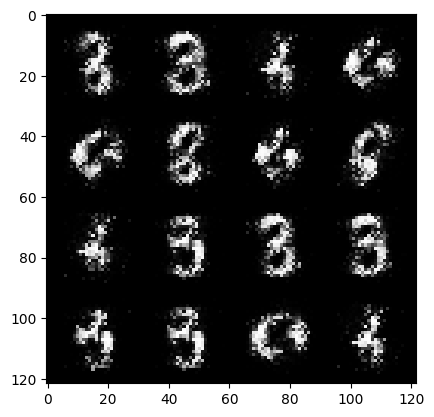

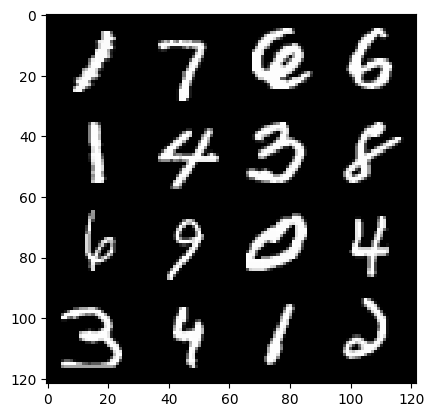

19: step 11400 / Gen loss: 6.722937099138893 / Disc loss: 0.013925706710045525


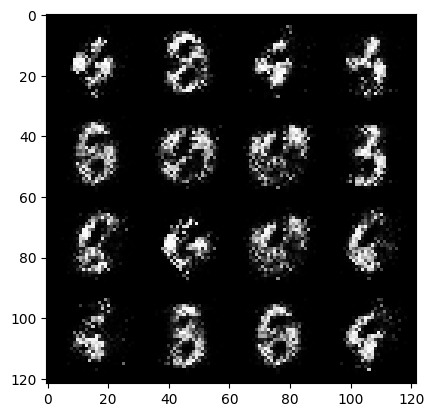

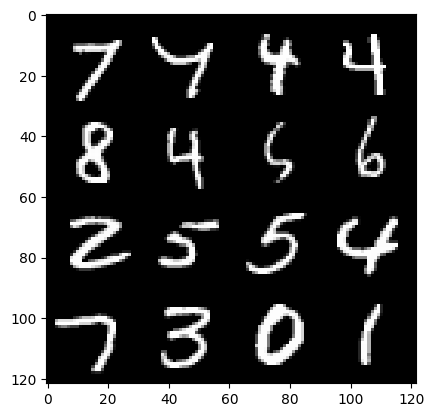

19: step 11700 / Gen loss: 6.801360642115278 / Disc loss: 0.012832518192008133


  0%|          | 0/469 [00:00<?, ?it/s]

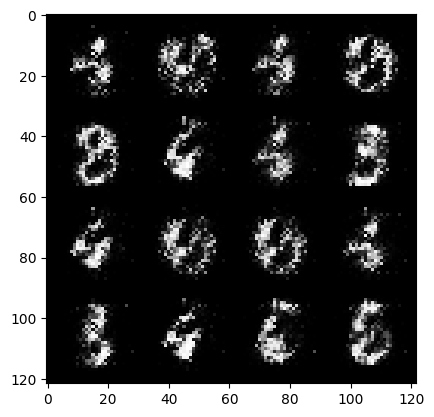

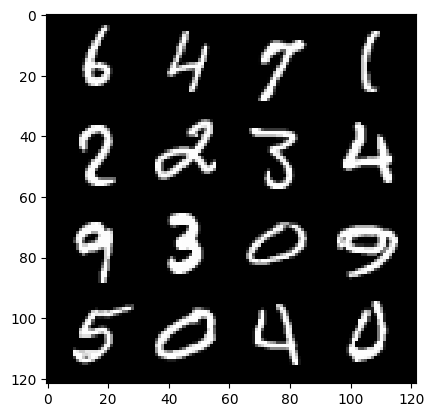

20: step 12000 / Gen loss: 7.198060150146484 / Disc loss: 0.011813418819413835


  0%|          | 0/469 [00:00<?, ?it/s]

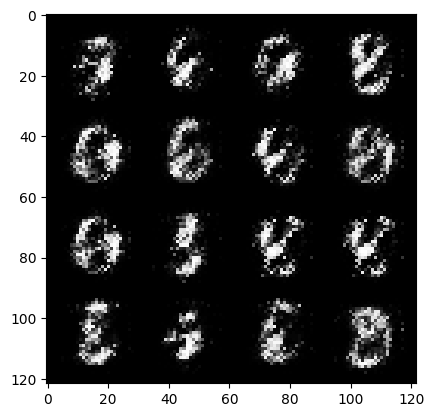

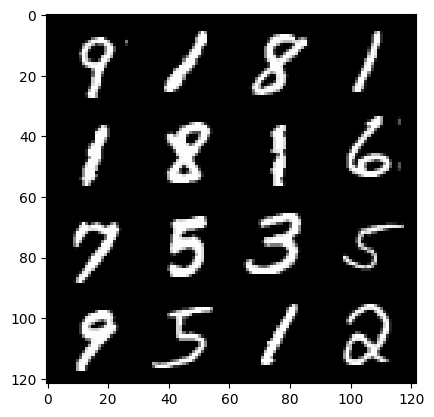

21: step 12300 / Gen loss: 6.730410477320357 / Disc loss: 0.01347479009457554


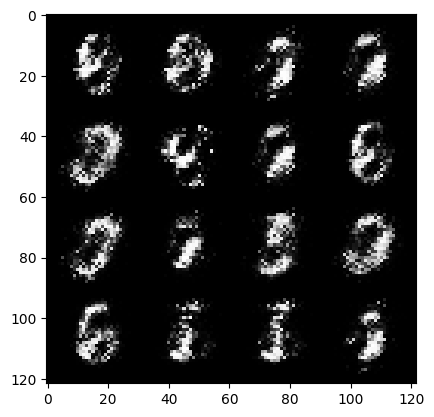

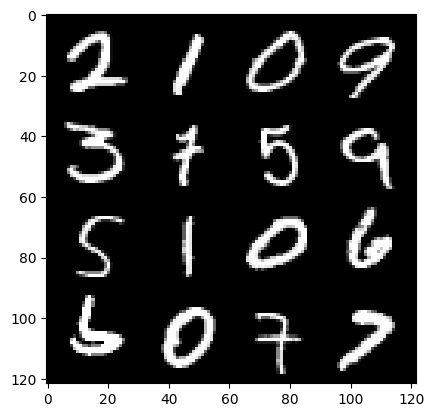

21: step 12600 / Gen loss: 6.492376875877377 / Disc loss: 0.015855076552058273


  0%|          | 0/469 [00:00<?, ?it/s]

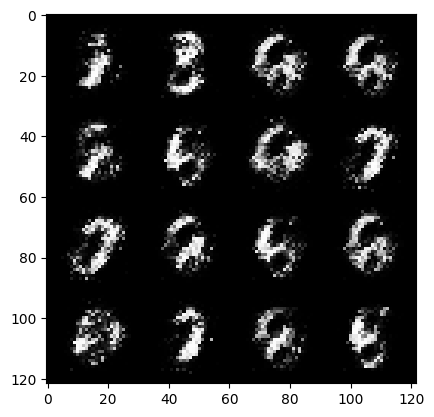

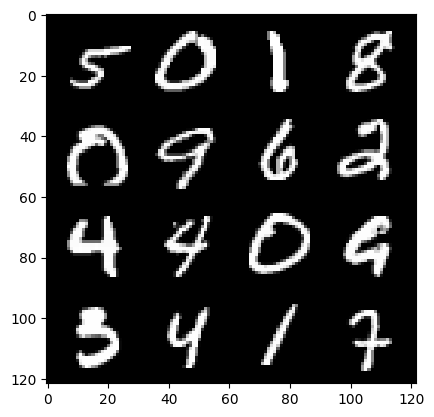

22: step 12900 / Gen loss: 6.4304440259933475 / Disc loss: 0.014779886306884387


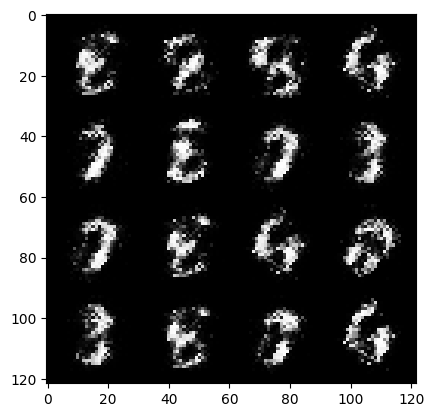

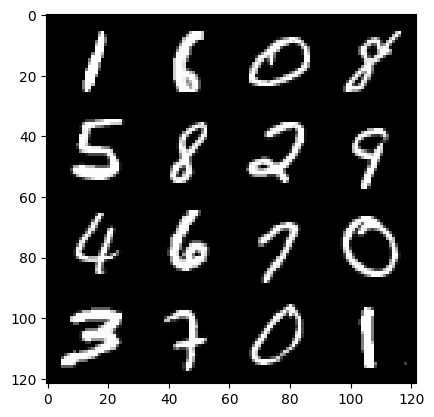

22: step 13200 / Gen loss: 6.383527901967367 / Disc loss: 0.01512055813722933


  0%|          | 0/469 [00:00<?, ?it/s]

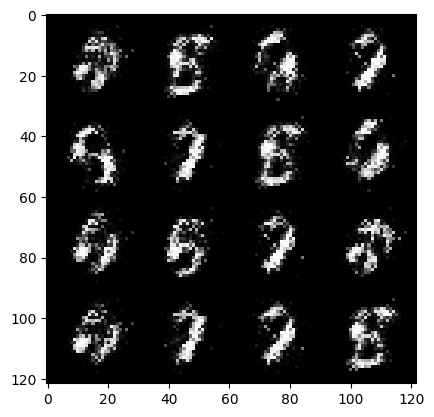

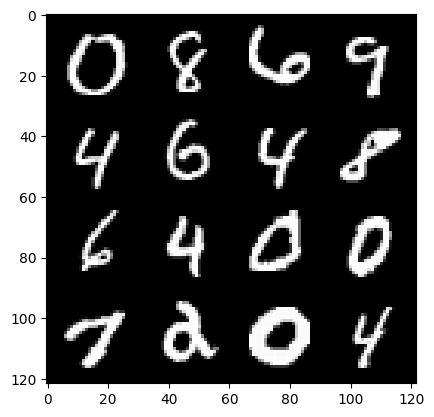

23: step 13500 / Gen loss: 6.447892265319825 / Disc loss: 0.014839087250487241


  0%|          | 0/469 [00:00<?, ?it/s]

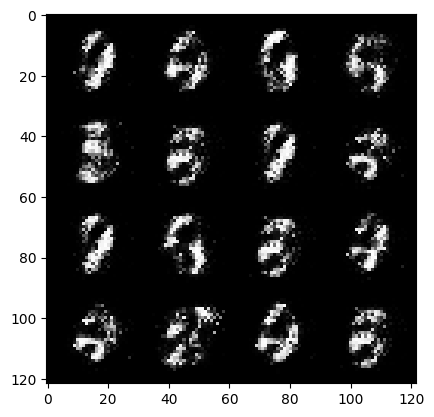

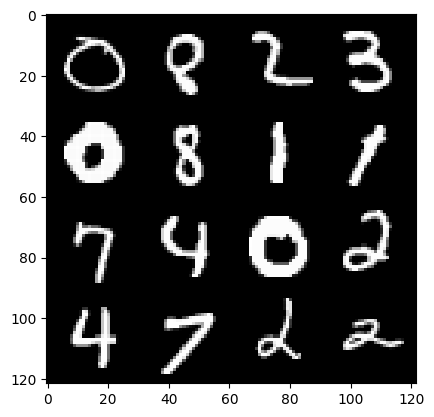

24: step 13800 / Gen loss: 6.584837460517883 / Disc loss: 0.015415252439755328


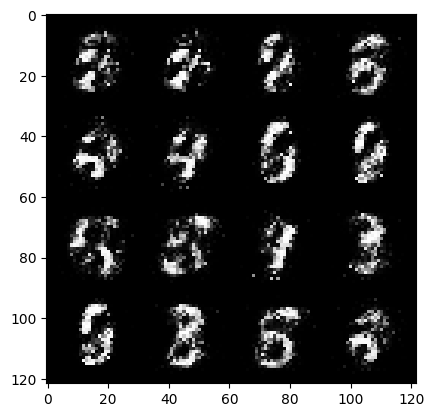

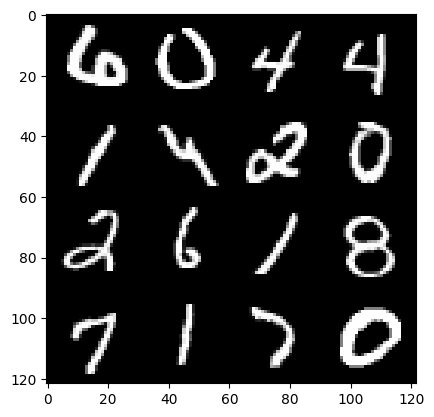

24: step 14100 / Gen loss: 6.443354042371108 / Disc loss: 0.016229371530935163


  0%|          | 0/469 [00:00<?, ?it/s]

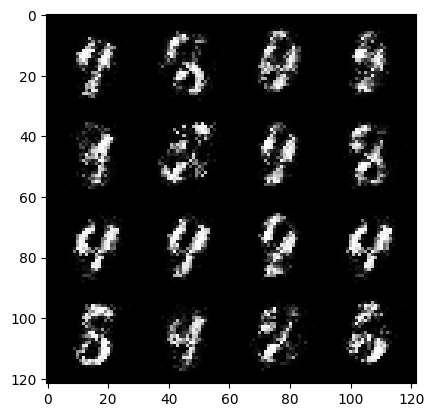

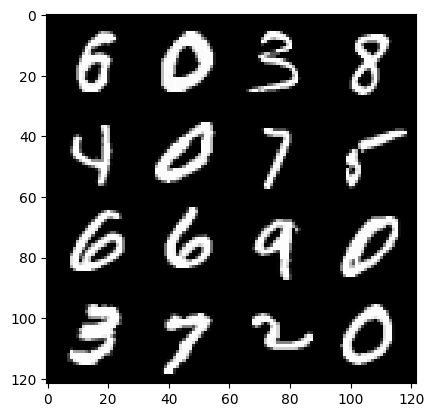

25: step 14400 / Gen loss: 6.741235497792561 / Disc loss: 0.01908106171215575


  0%|          | 0/469 [00:00<?, ?it/s]

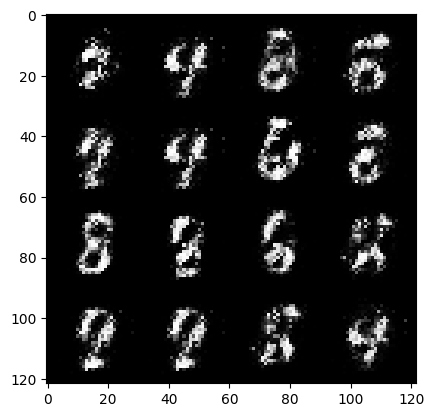

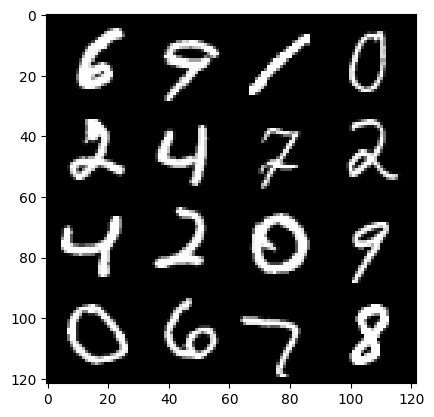

26: step 14700 / Gen loss: 6.513878782590231 / Disc loss: 0.021016422395283983


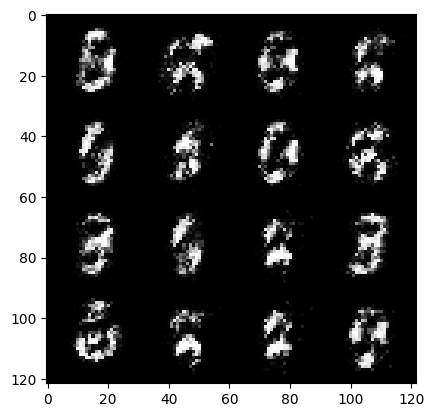

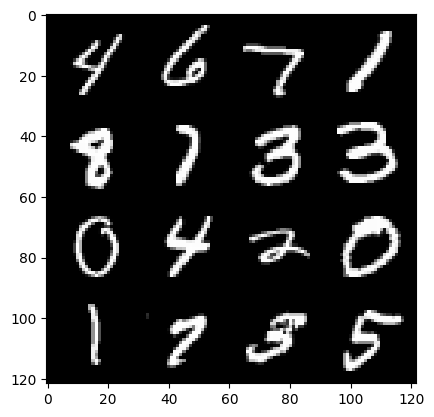

26: step 15000 / Gen loss: 6.493542534510294 / Disc loss: 0.024602901912294323


  0%|          | 0/469 [00:00<?, ?it/s]

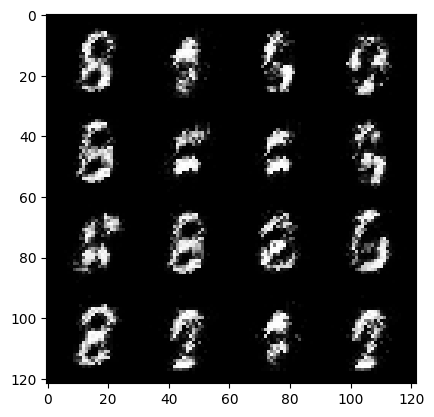

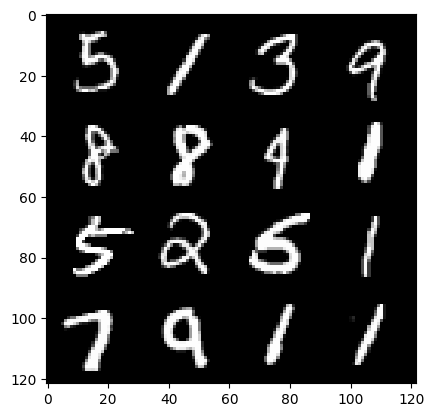

27: step 15300 / Gen loss: 6.259913104375202 / Disc loss: 0.025161887655655524


  0%|          | 0/469 [00:00<?, ?it/s]

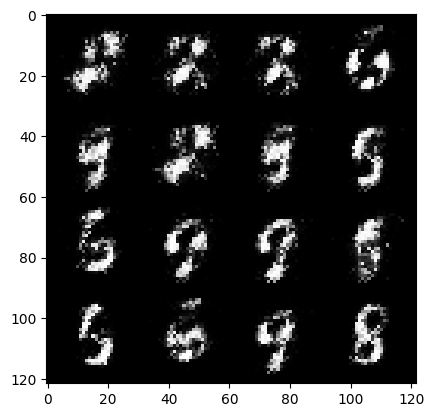

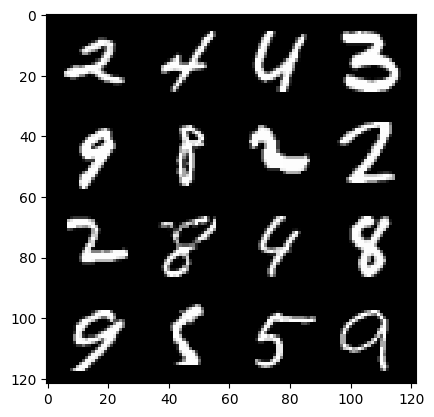

28: step 15600 / Gen loss: 6.305845818519593 / Disc loss: 0.021431479100914055


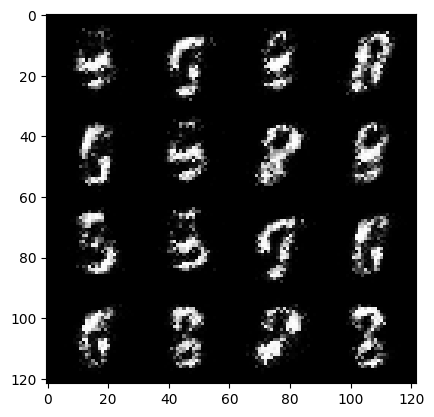

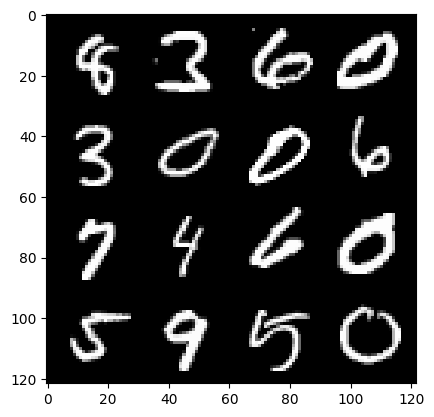

28: step 15900 / Gen loss: 6.139562230110162 / Disc loss: 0.022183699446419864


  0%|          | 0/469 [00:00<?, ?it/s]

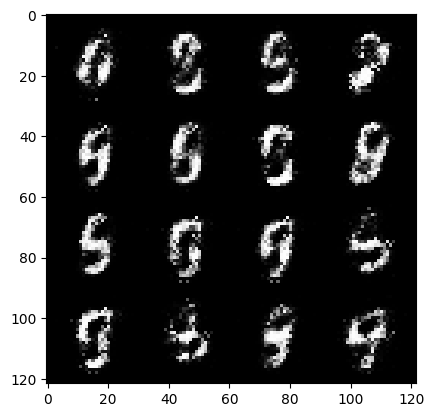

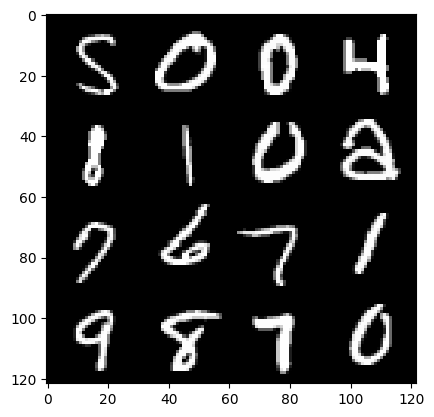

29: step 16200 / Gen loss: 6.545725477536518 / Disc loss: 0.023741504051722578


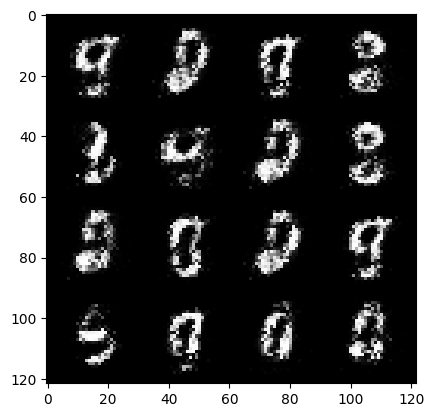

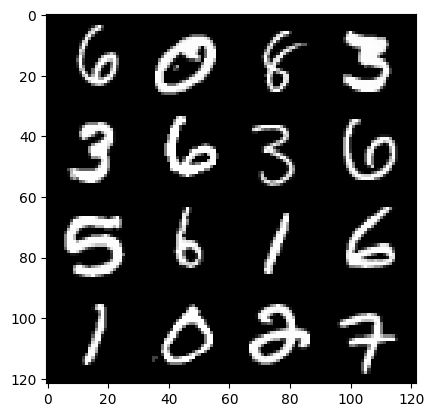

29: step 16500 / Gen loss: 6.2678564214706425 / Disc loss: 0.02771870291170973


  0%|          | 0/469 [00:00<?, ?it/s]

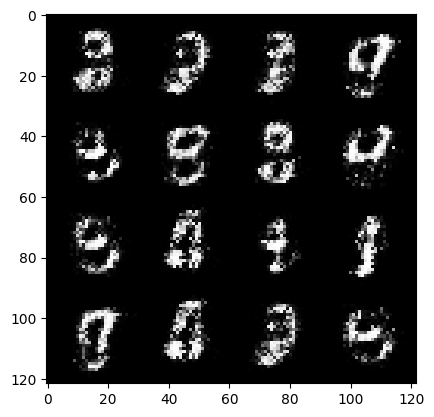

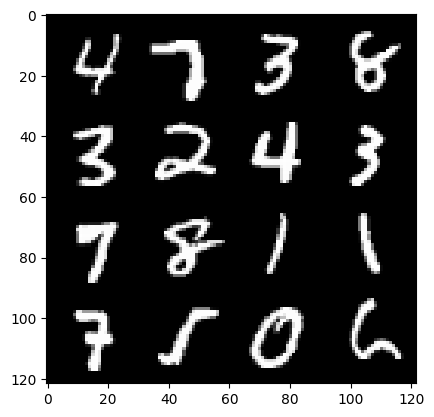

30: step 16800 / Gen loss: 6.196584320068363 / Disc loss: 0.026960123406412708


  0%|          | 0/469 [00:00<?, ?it/s]

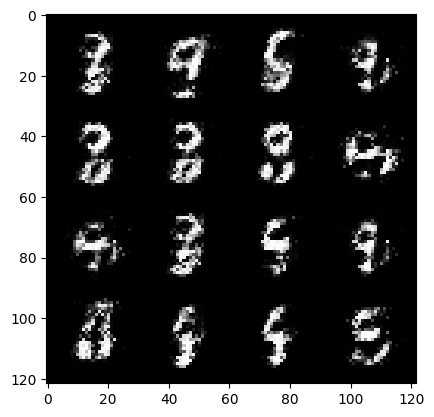

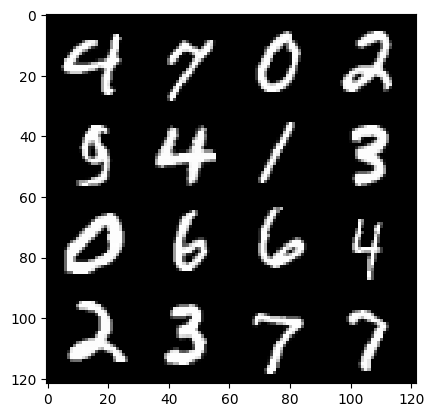

31: step 17100 / Gen loss: 6.321608870824182 / Disc loss: 0.02470381258210788


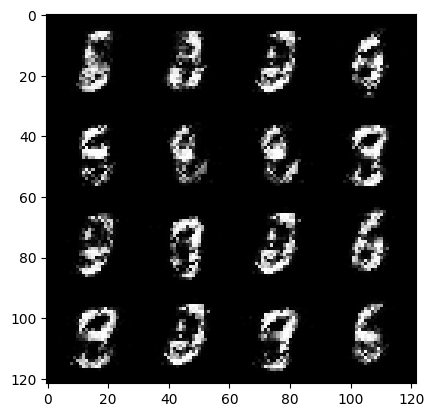

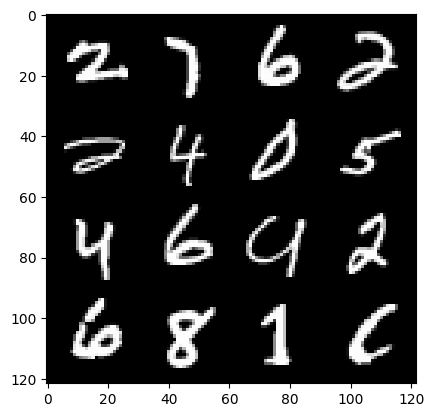

31: step 17400 / Gen loss: 5.9374685192108165 / Disc loss: 0.026106881257146605


  0%|          | 0/469 [00:00<?, ?it/s]

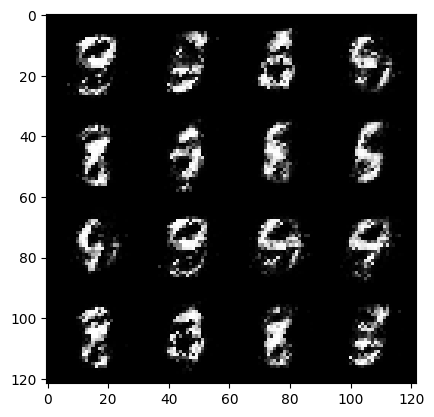

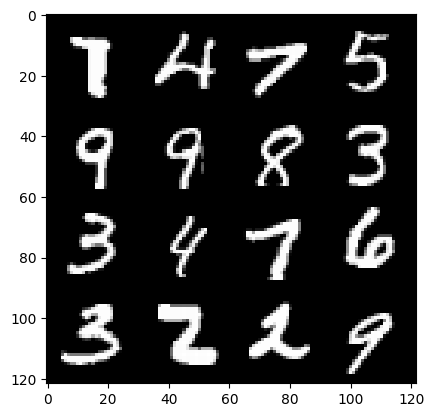

32: step 17700 / Gen loss: 6.3730545997619625 / Disc loss: 0.023244889100703086


  0%|          | 0/469 [00:00<?, ?it/s]

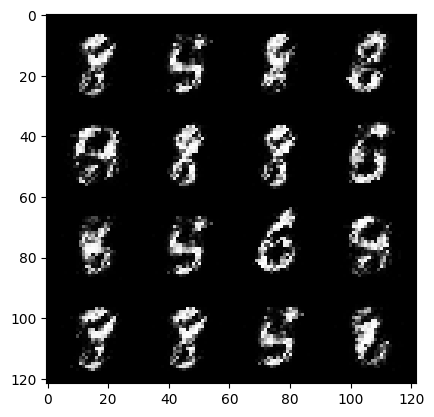

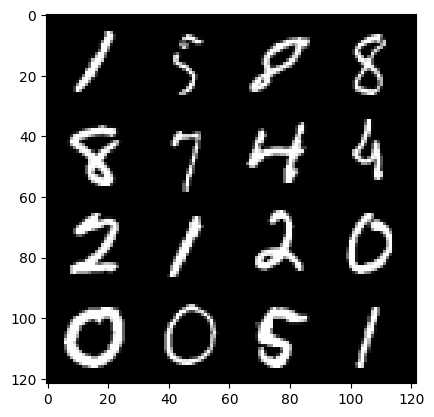

33: step 18000 / Gen loss: 6.284330538113913 / Disc loss: 0.02563427447962264


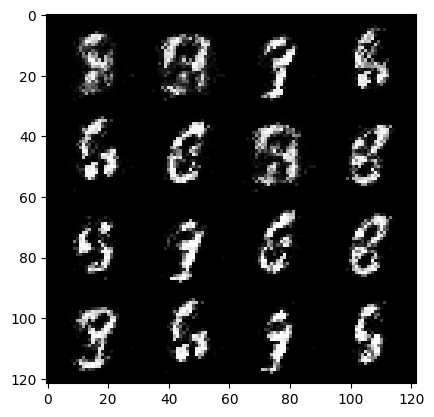

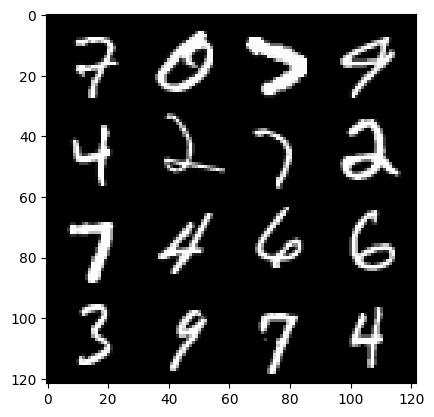

33: step 18300 / Gen loss: 6.339719449679059 / Disc loss: 0.031498219314962626


  0%|          | 0/469 [00:00<?, ?it/s]

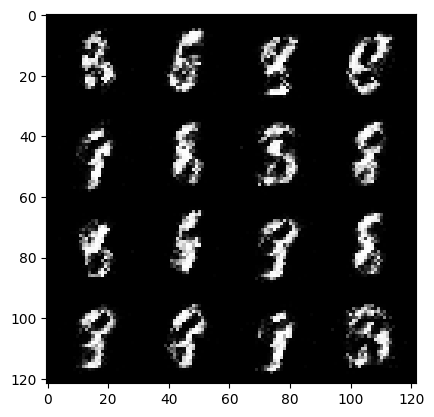

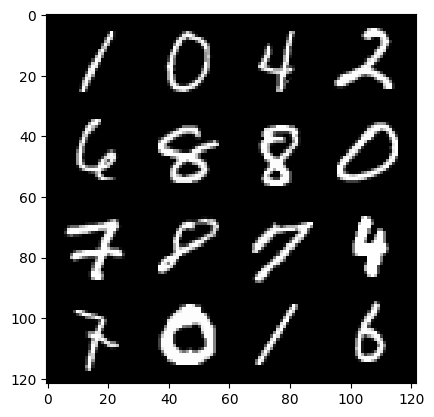

34: step 18600 / Gen loss: 6.179846804936727 / Disc loss: 0.034644122663885356


  0%|          | 0/469 [00:00<?, ?it/s]

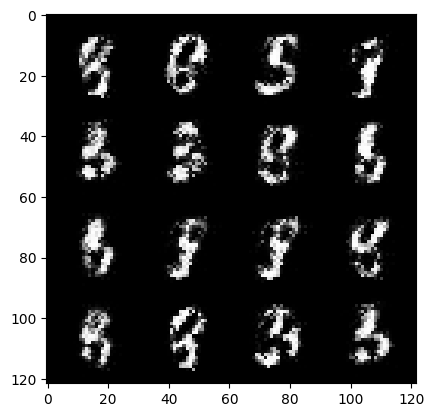

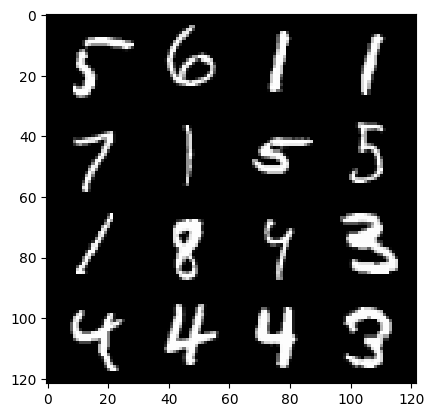

35: step 18900 / Gen loss: 5.9099059899648045 / Disc loss: 0.03104435028973965


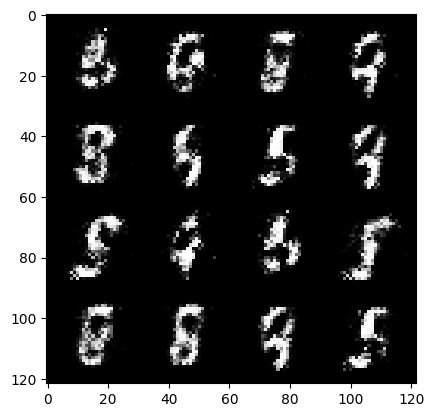

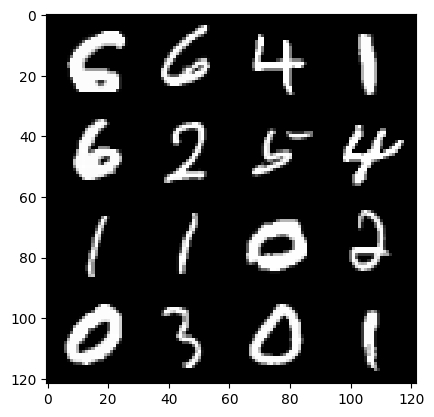

35: step 19200 / Gen loss: 6.109617807070414 / Disc loss: 0.0332916866708547


  0%|          | 0/469 [00:00<?, ?it/s]

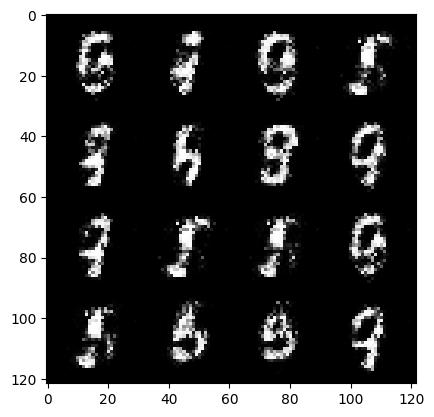

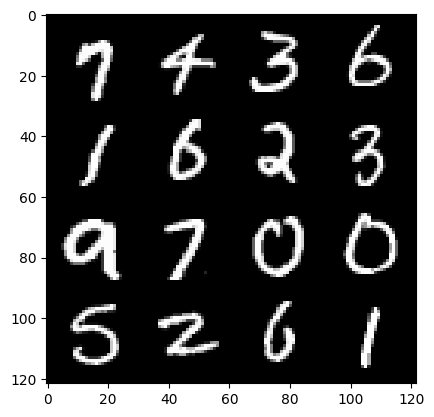

36: step 19500 / Gen loss: 6.12425298690796 / Disc loss: 0.033118862664947894


  0%|          | 0/469 [00:00<?, ?it/s]

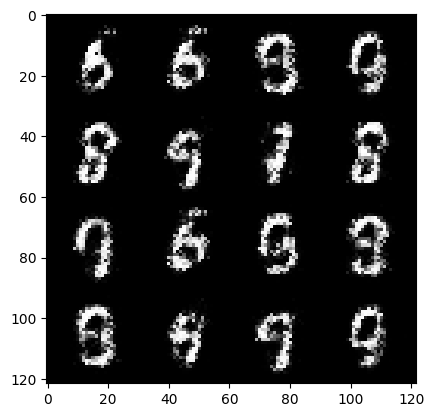

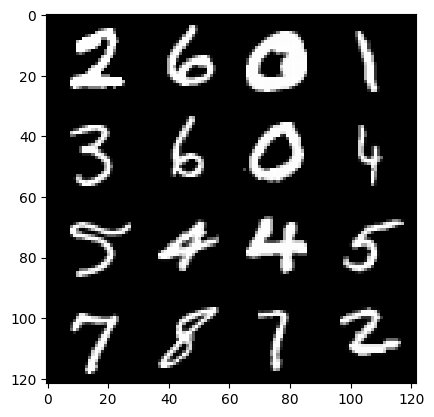

37: step 19800 / Gen loss: 6.04129572868347 / Disc loss: 0.03742131055953603


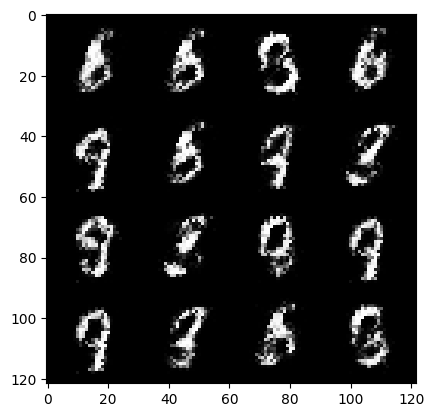

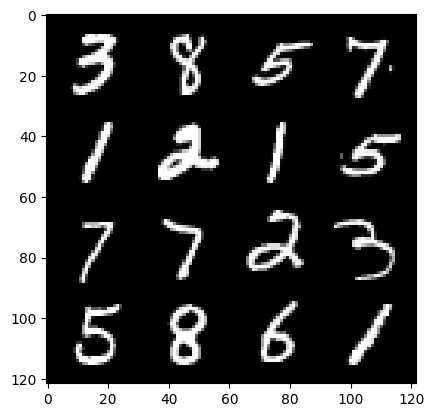

37: step 20100 / Gen loss: 5.870353550910944 / Disc loss: 0.042056701318360847


  0%|          | 0/469 [00:00<?, ?it/s]

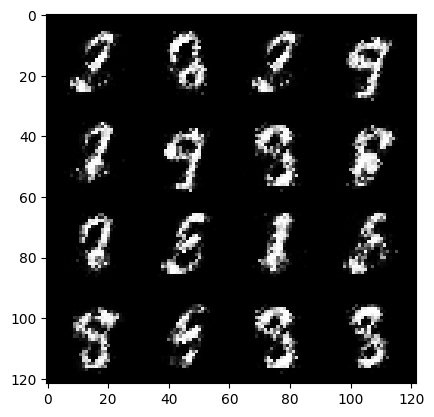

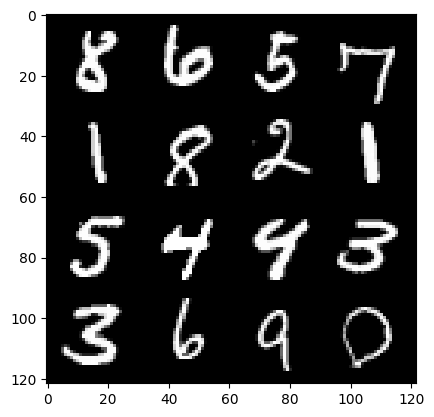

38: step 20400 / Gen loss: 5.666138440767927 / Disc loss: 0.037778167060265946


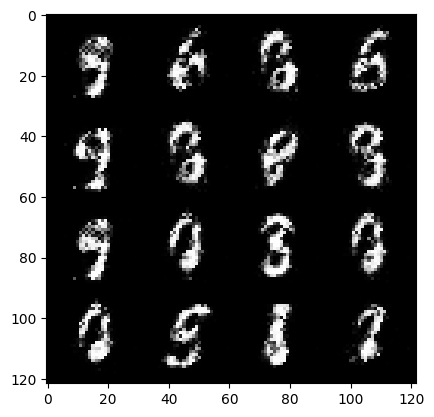

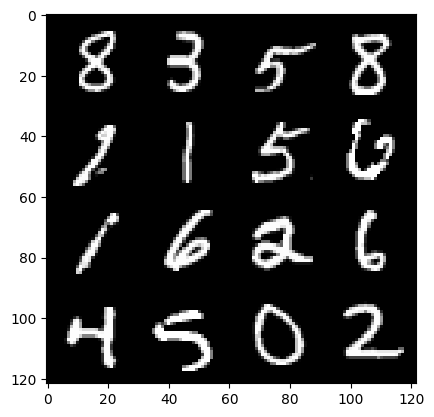

38: step 20700 / Gen loss: 5.945326555569968 / Disc loss: 0.04099455046467483


  0%|          | 0/469 [00:00<?, ?it/s]

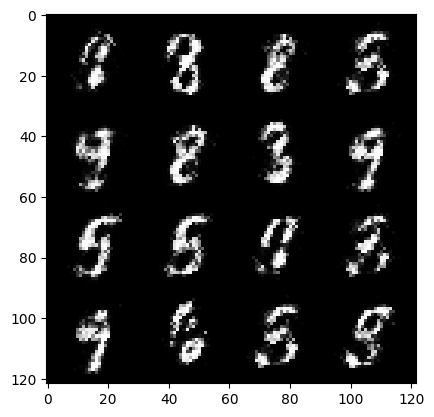

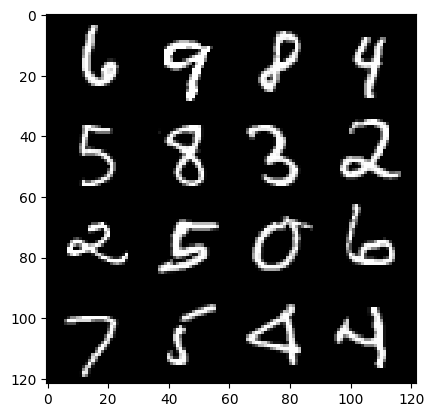

39: step 21000 / Gen loss: 5.609920800526936 / Disc loss: 0.05028513641717533


  0%|          | 0/469 [00:00<?, ?it/s]

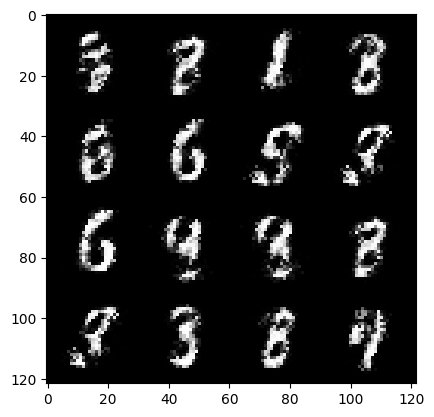

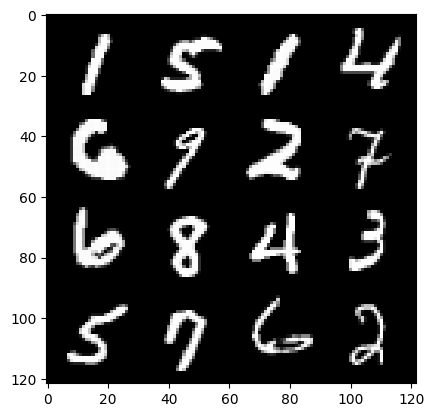

40: step 21300 / Gen loss: 5.247786859671276 / Disc loss: 0.0600365686851243


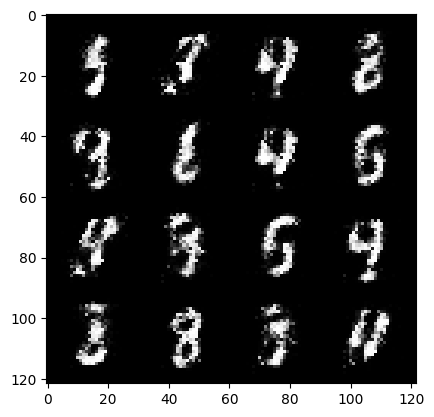

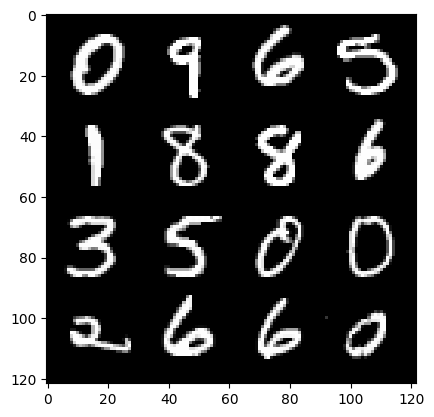

40: step 21600 / Gen loss: 5.327373960812887 / Disc loss: 0.05328010393306615


  0%|          | 0/469 [00:00<?, ?it/s]

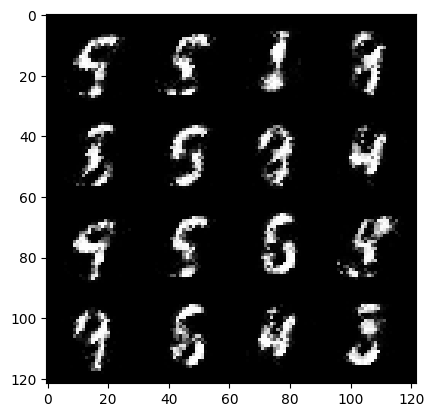

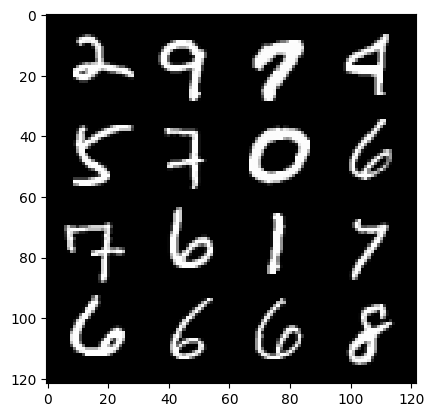

41: step 21900 / Gen loss: 5.511634481747952 / Disc loss: 0.04802774026989939


  0%|          | 0/469 [00:00<?, ?it/s]

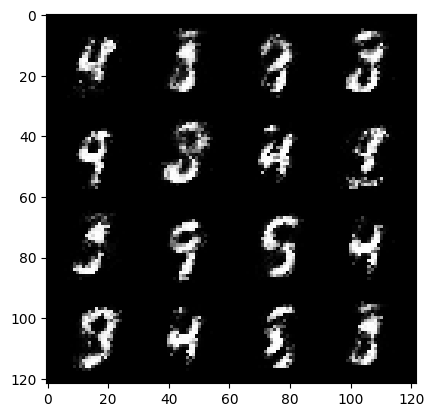

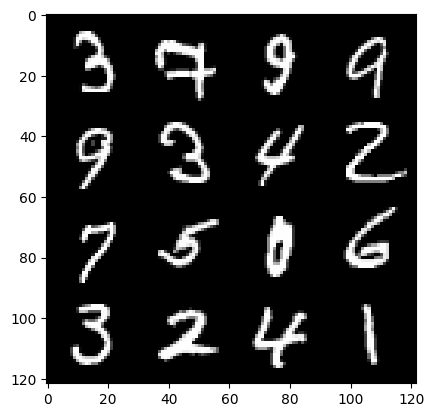

42: step 22200 / Gen loss: 5.438960202534997 / Disc loss: 0.061376863190283404


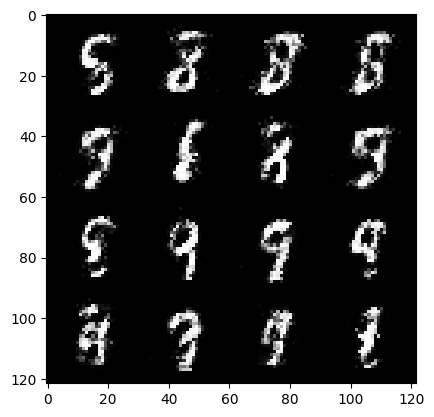

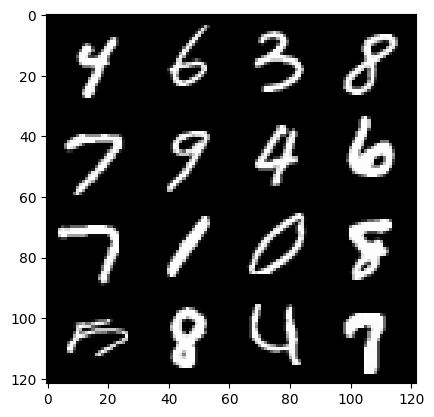

42: step 22500 / Gen loss: 5.429153652985891 / Disc loss: 0.048513207510113704


  0%|          | 0/469 [00:00<?, ?it/s]

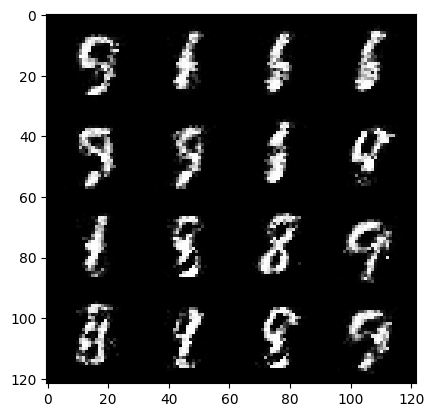

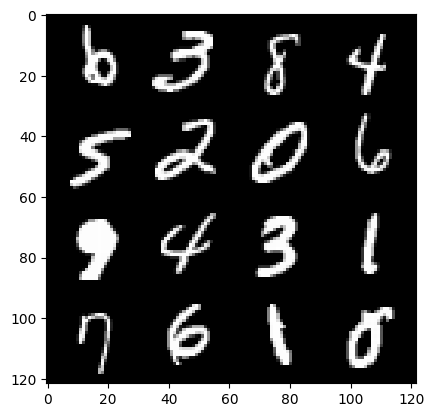

43: step 22800 / Gen loss: 5.492053958574931 / Disc loss: 0.04673896806314589


  0%|          | 0/469 [00:00<?, ?it/s]

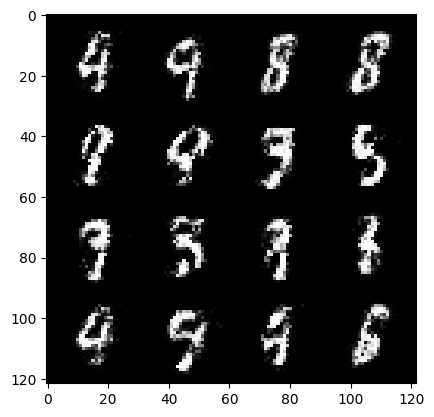

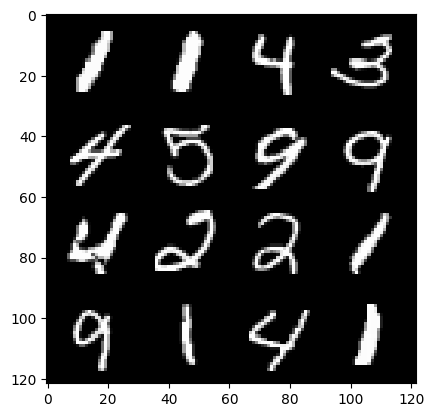

44: step 23100 / Gen loss: 5.147127370834353 / Disc loss: 0.06327115830654902


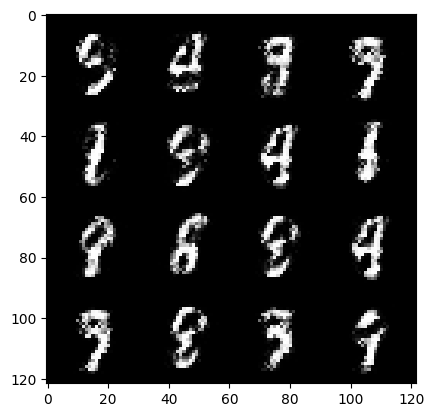

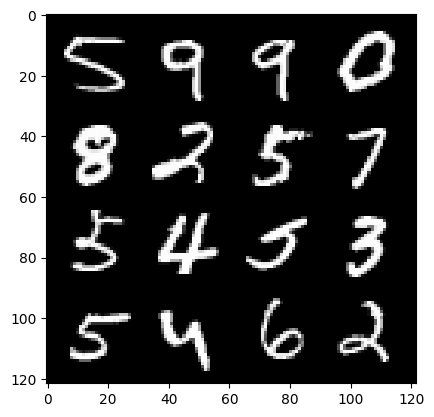

44: step 23400 / Gen loss: 4.976670149962111 / Disc loss: 0.06454986823101835


  0%|          | 0/469 [00:00<?, ?it/s]

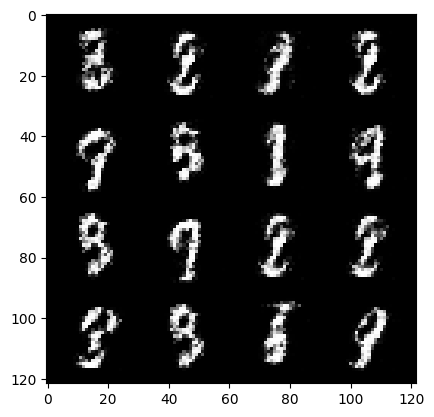

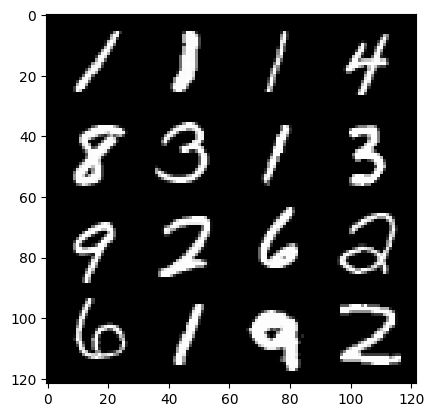

45: step 23700 / Gen loss: 4.763033892313642 / Disc loss: 0.06668944936245685


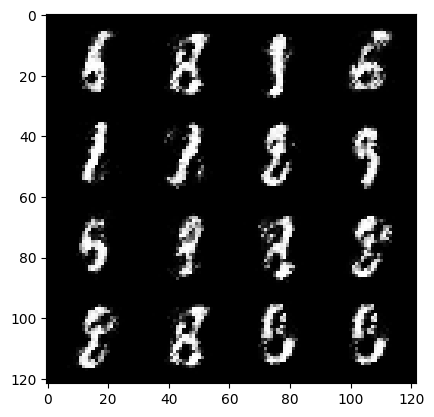

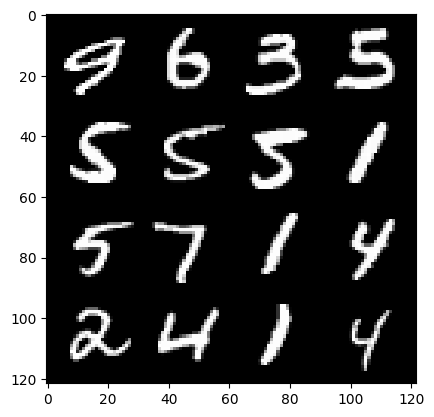

45: step 24000 / Gen loss: 4.867812046209973 / Disc loss: 0.08089152735968434


  0%|          | 0/469 [00:00<?, ?it/s]

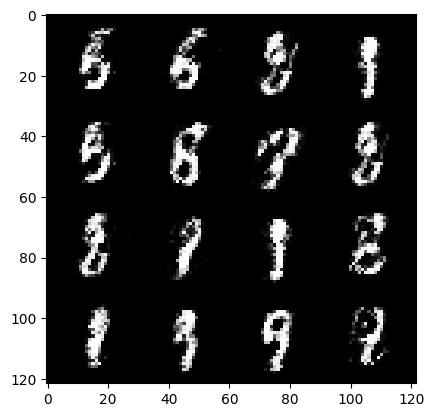

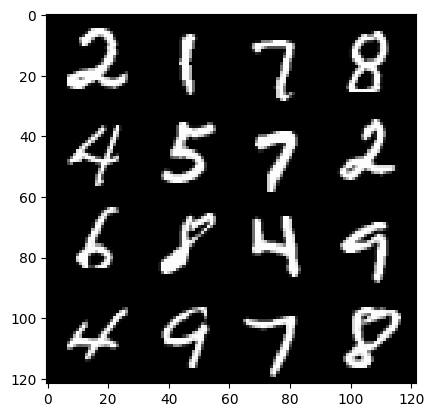

46: step 24300 / Gen loss: 4.6689014371236155 / Disc loss: 0.0735964980473121


  0%|          | 0/469 [00:00<?, ?it/s]

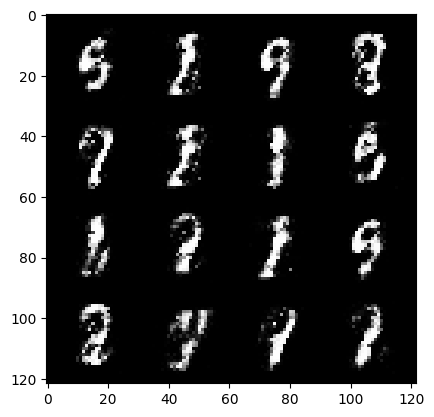

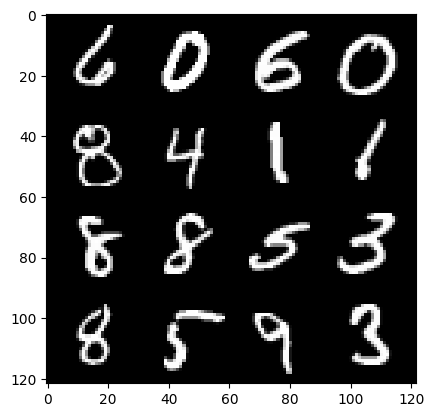

47: step 24600 / Gen loss: 5.072952728271482 / Disc loss: 0.06236676796029008


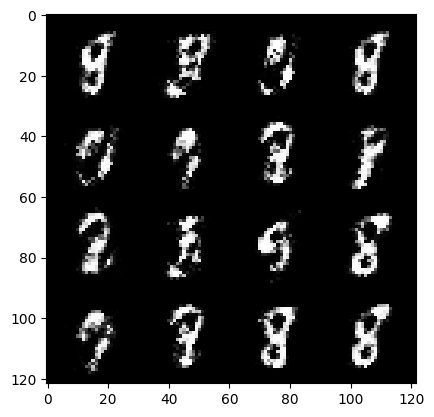

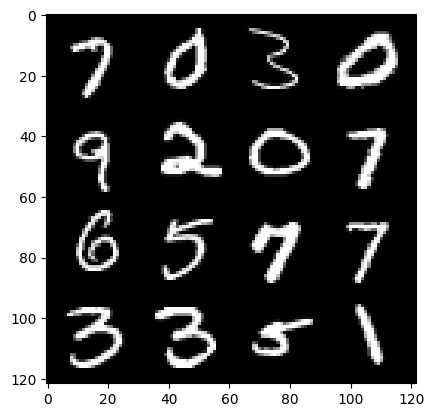

47: step 24900 / Gen loss: 4.829903271993006 / Disc loss: 0.0598534407218297


  0%|          | 0/469 [00:00<?, ?it/s]

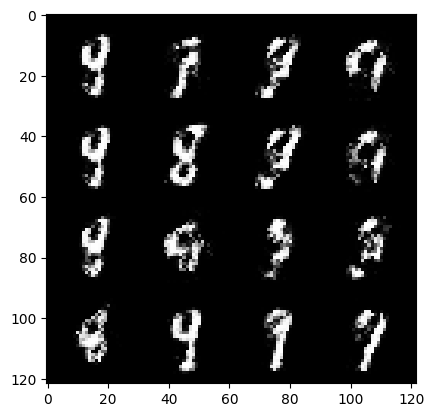

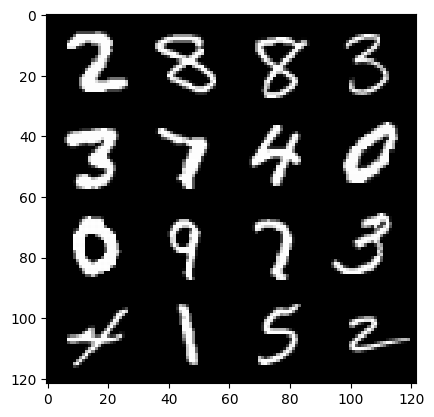

48: step 25200 / Gen loss: 5.087892573674523 / Disc loss: 0.06301881819032133


  0%|          | 0/469 [00:00<?, ?it/s]

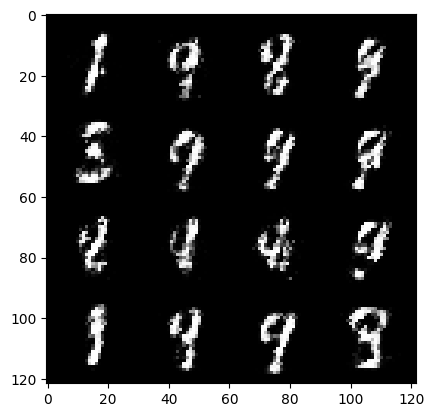

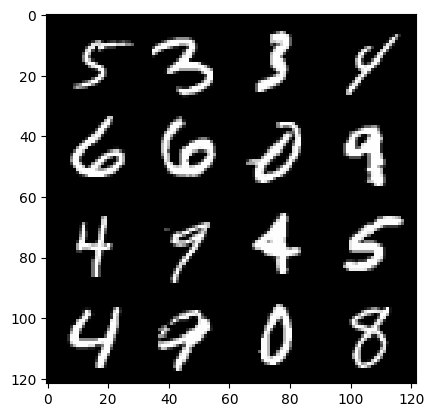

49: step 25500 / Gen loss: 5.053905221621192 / Disc loss: 0.07956951160604757


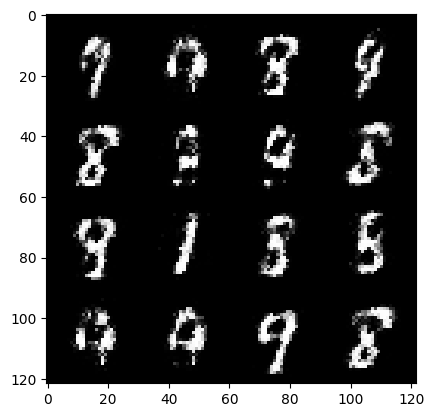

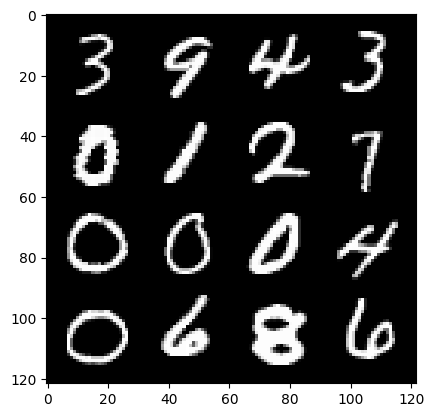

49: step 25800 / Gen loss: 4.8523470139503475 / Disc loss: 0.06619018883754808


  0%|          | 0/469 [00:00<?, ?it/s]

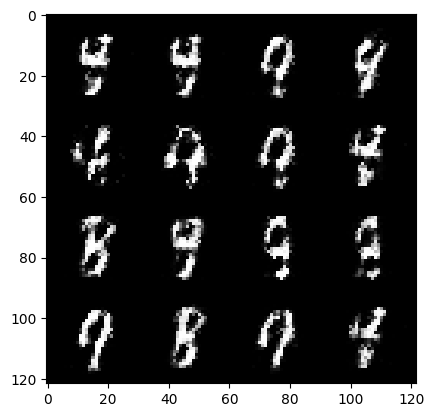

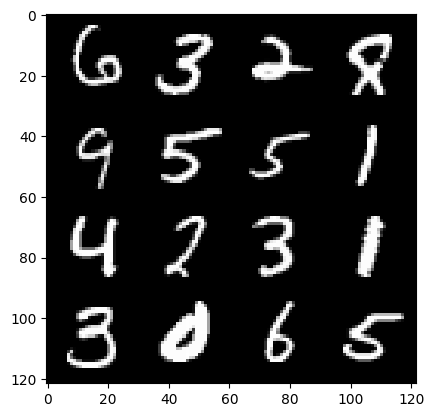

50: step 26100 / Gen loss: 4.80008760134379 / Disc loss: 0.08159129351377484


  0%|          | 0/469 [00:00<?, ?it/s]

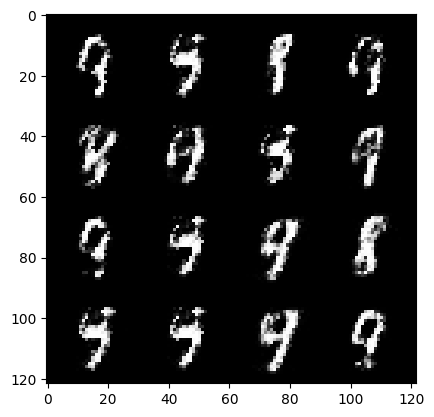

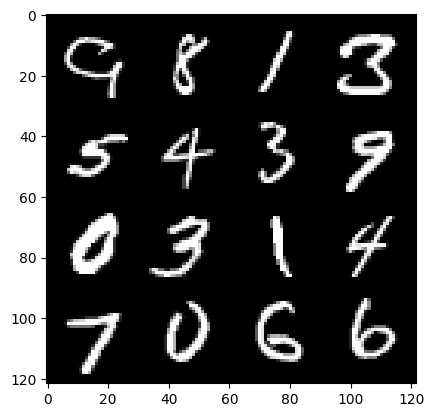

51: step 26400 / Gen loss: 4.66660988807678 / Disc loss: 0.08370457684000325


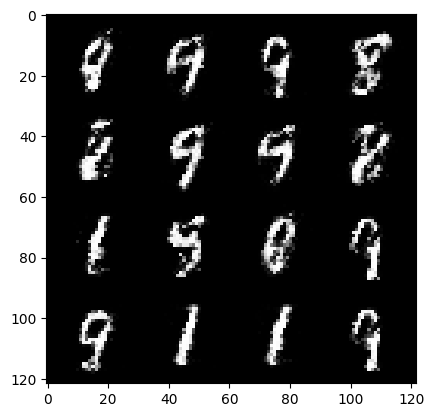

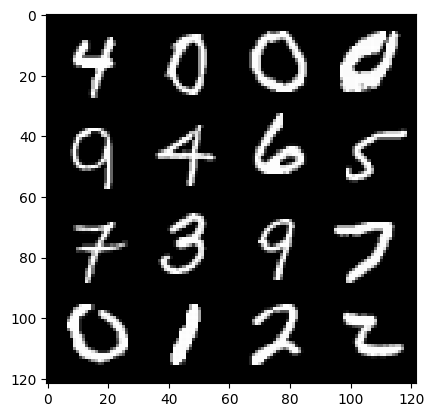

51: step 26700 / Gen loss: 4.852094807624814 / Disc loss: 0.07564158147821819


  0%|          | 0/469 [00:00<?, ?it/s]

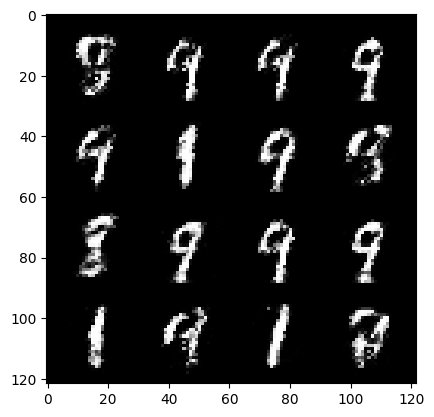

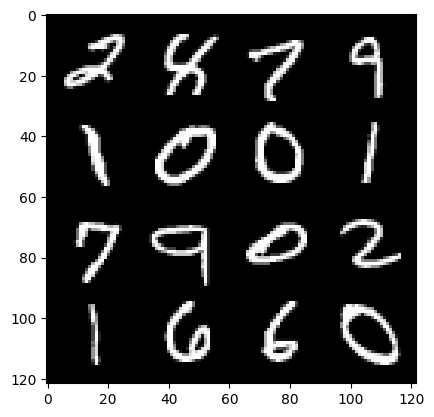

52: step 27000 / Gen loss: 4.57754784663518 / Disc loss: 0.08909426278124256


  0%|          | 0/469 [00:00<?, ?it/s]

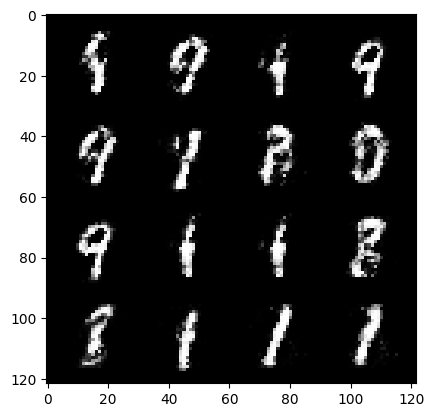

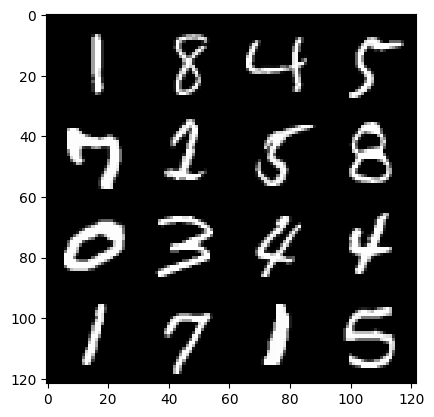

53: step 27300 / Gen loss: 4.234434773921967 / Disc loss: 0.11442768665651487


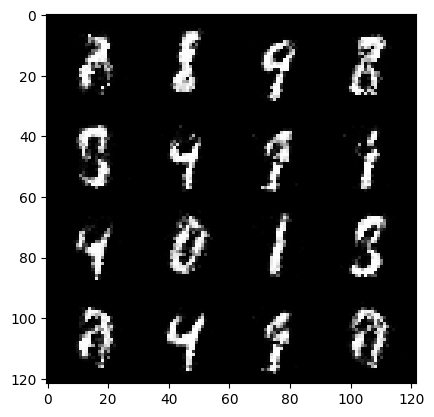

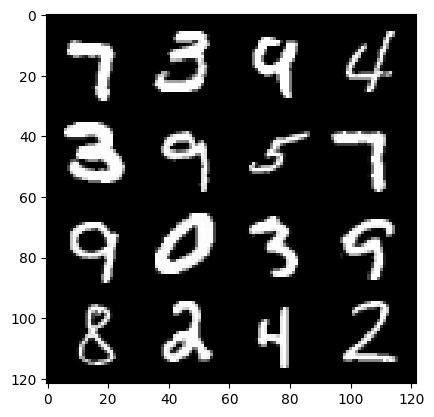

53: step 27600 / Gen loss: 4.33376295487086 / Disc loss: 0.10174092739820473


  0%|          | 0/469 [00:00<?, ?it/s]

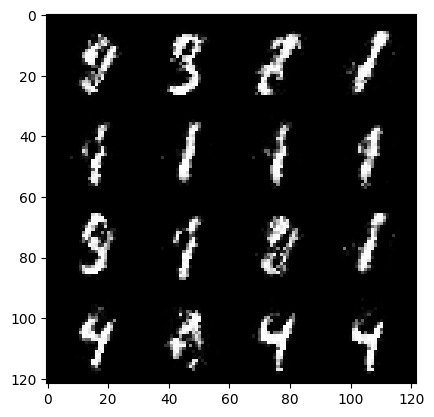

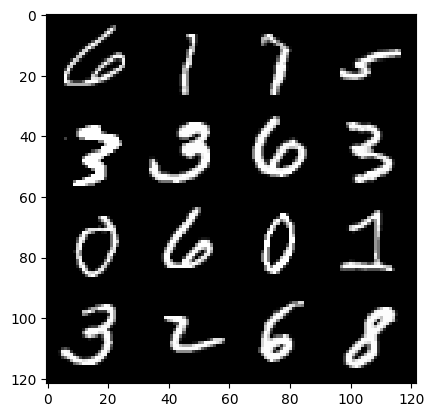

54: step 27900 / Gen loss: 4.458186371326449 / Disc loss: 0.09074028450374803


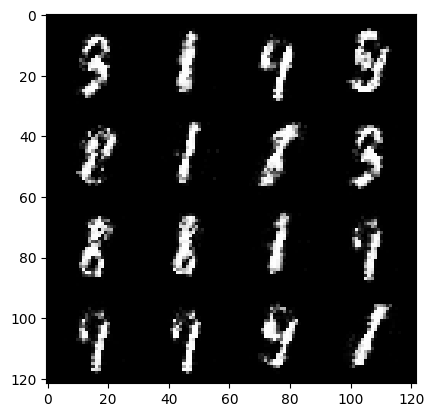

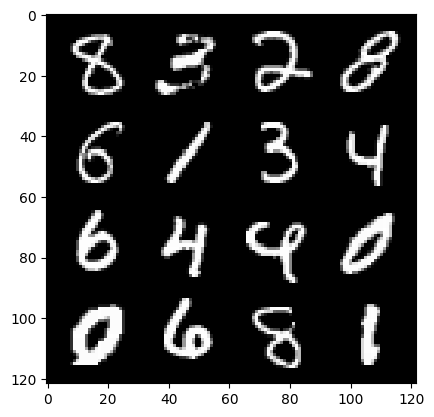

54: step 28200 / Gen loss: 4.4651135373115505 / Disc loss: 0.09880970840652782


  0%|          | 0/469 [00:00<?, ?it/s]

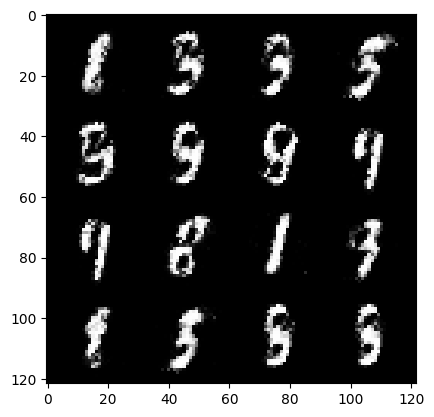

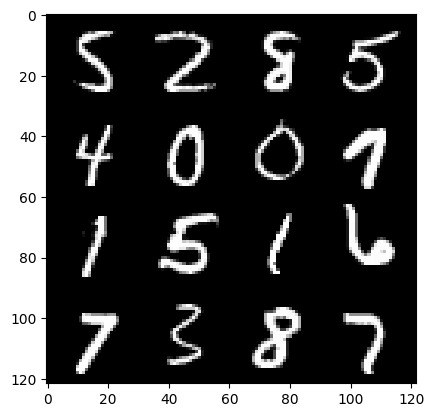

55: step 28500 / Gen loss: 4.216753892898559 / Disc loss: 0.11393399864435194


  0%|          | 0/469 [00:00<?, ?it/s]

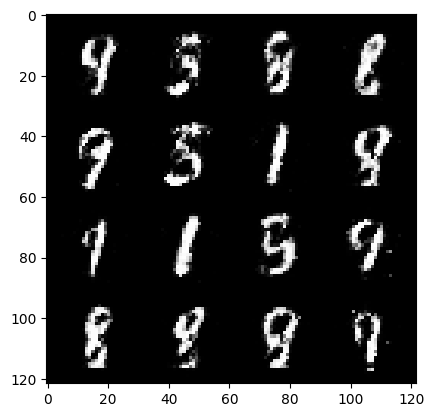

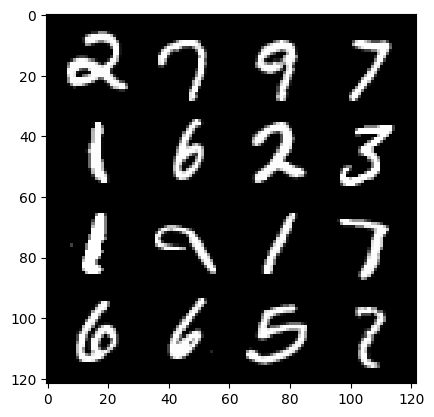

56: step 28800 / Gen loss: 4.3119277445475275 / Disc loss: 0.10755287454773986


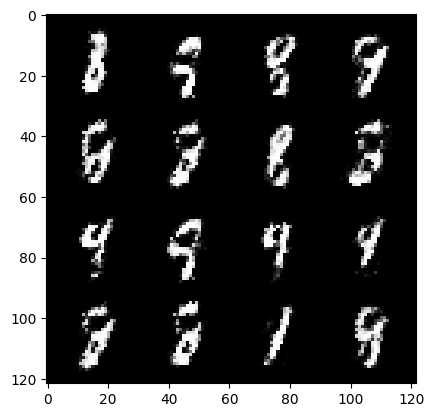

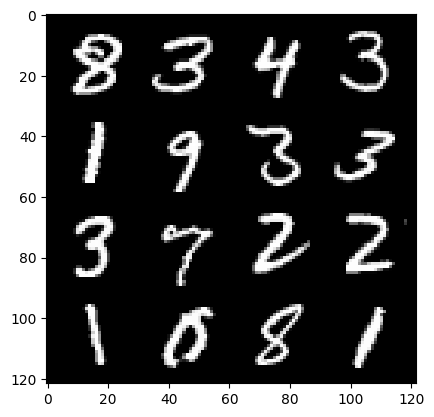

56: step 29100 / Gen loss: 4.172225191593171 / Disc loss: 0.11869486606369412


  0%|          | 0/469 [00:00<?, ?it/s]

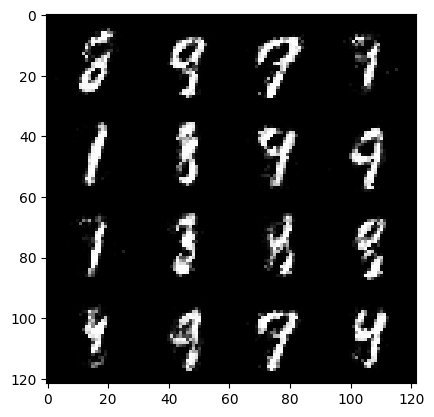

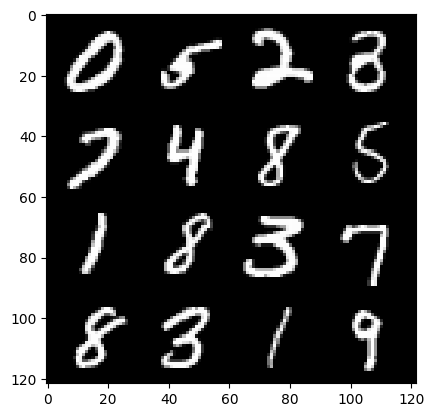

57: step 29400 / Gen loss: 4.008406829039256 / Disc loss: 0.12357582598924632


  0%|          | 0/469 [00:00<?, ?it/s]

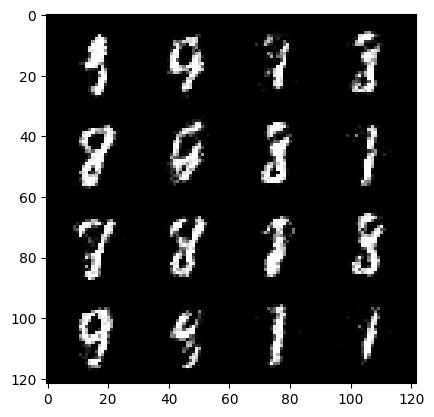

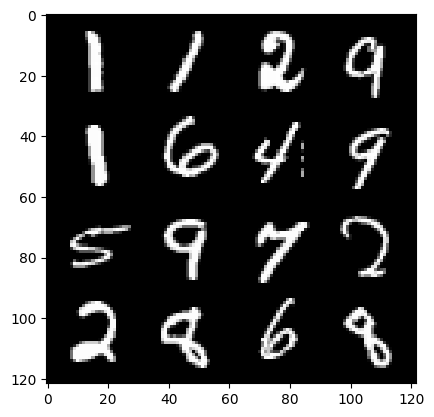

58: step 29700 / Gen loss: 4.177009686628974 / Disc loss: 0.11779472626745699


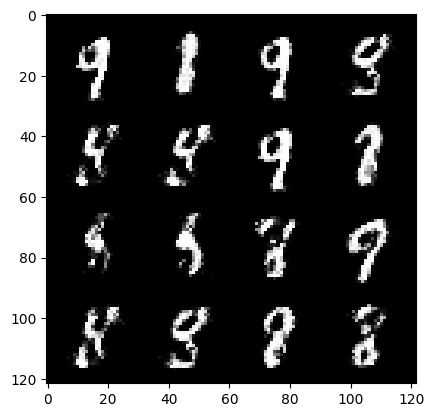

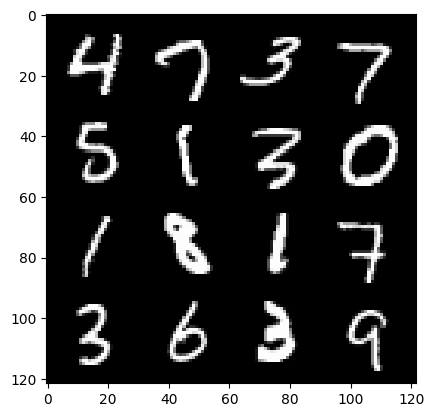

58: step 30000 / Gen loss: 3.816861724853517 / Disc loss: 0.1336349791536728


  0%|          | 0/469 [00:00<?, ?it/s]

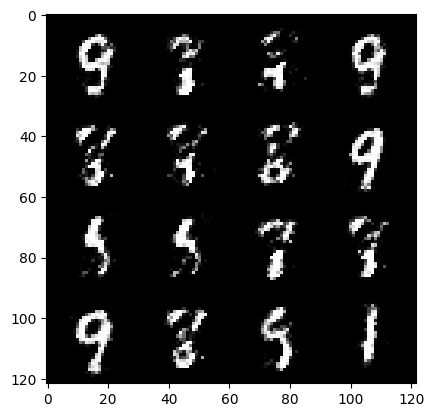

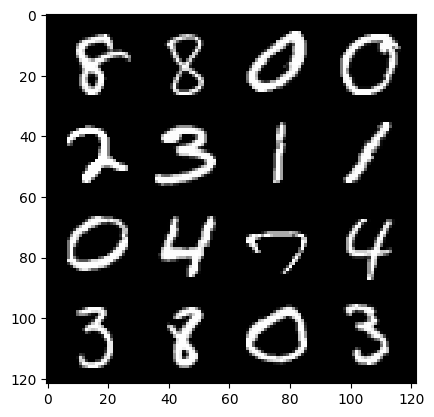

59: step 30300 / Gen loss: 3.77309028228124 / Disc loss: 0.12457360345870258


  0%|          | 0/469 [00:00<?, ?it/s]

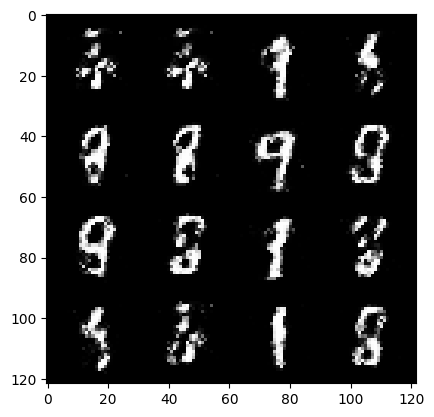

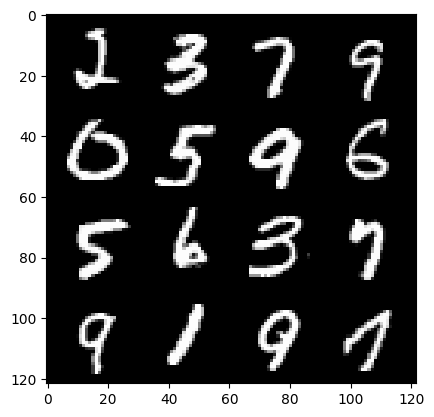

60: step 30600 / Gen loss: 3.8171722809473656 / Disc loss: 0.11344521973282091


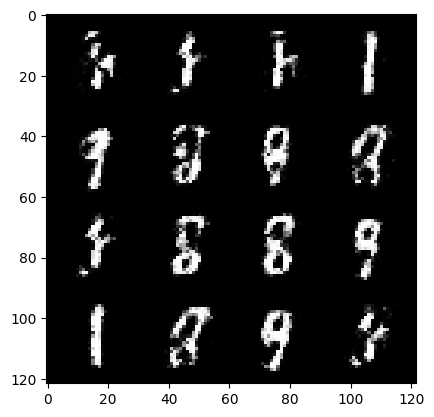

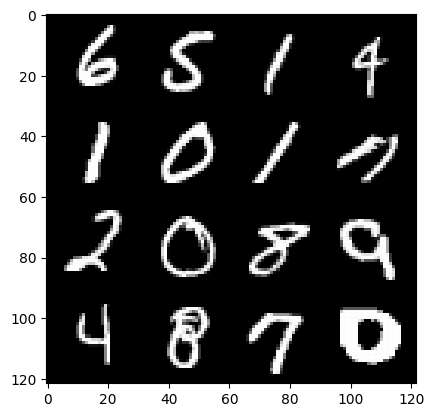

60: step 30900 / Gen loss: 3.7600274499257416 / Disc loss: 0.12712654400616893


  0%|          | 0/469 [00:00<?, ?it/s]

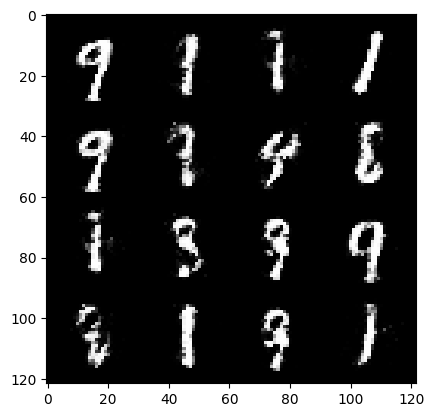

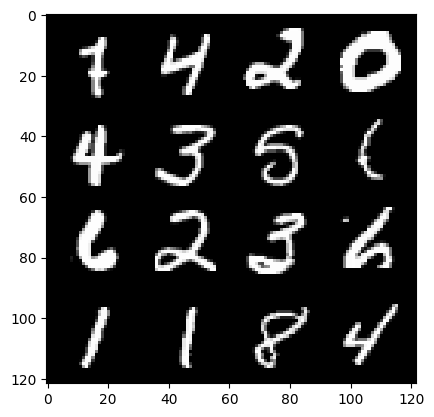

61: step 31200 / Gen loss: 3.7739078474044794 / Disc loss: 0.14102607345829404


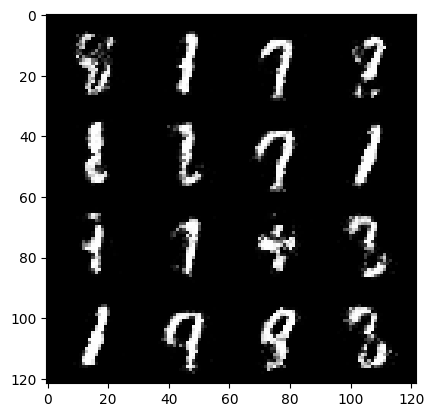

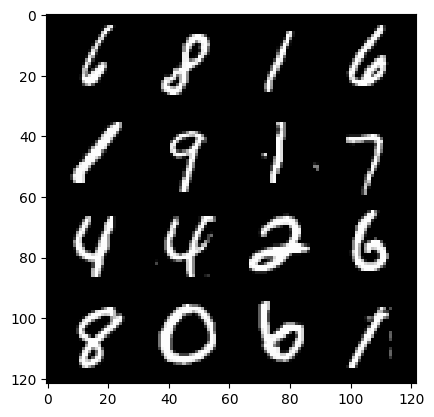

61: step 31500 / Gen loss: 3.6706533567110697 / Disc loss: 0.15239392819503933


  0%|          | 0/469 [00:00<?, ?it/s]

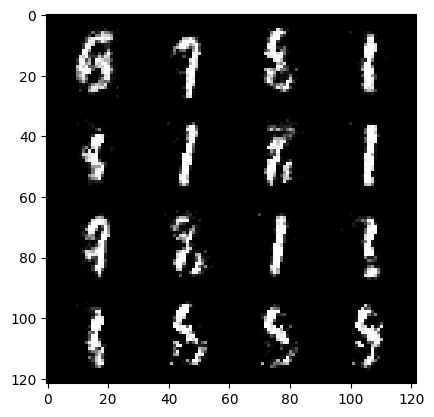

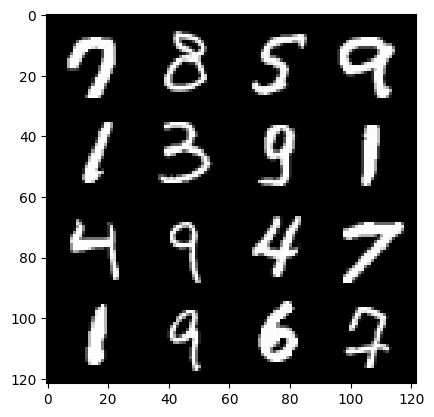

62: step 31800 / Gen loss: 3.86722720305125 / Disc loss: 0.1271066304296255


  0%|          | 0/469 [00:00<?, ?it/s]

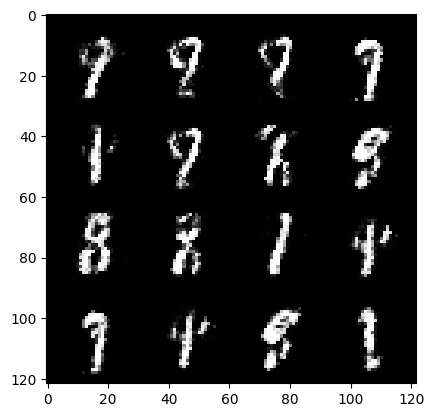

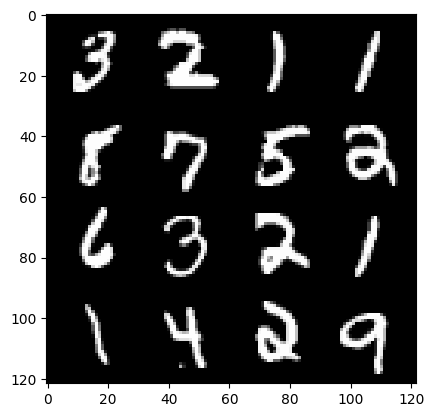

63: step 32100 / Gen loss: 3.796389895280203 / Disc loss: 0.1303933698808153


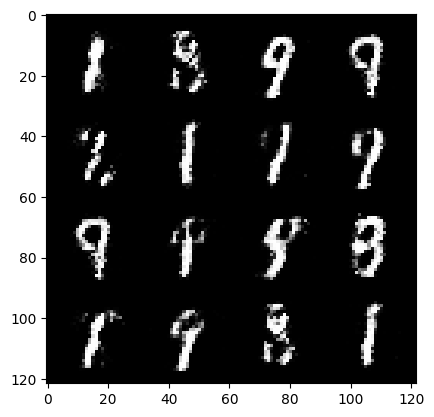

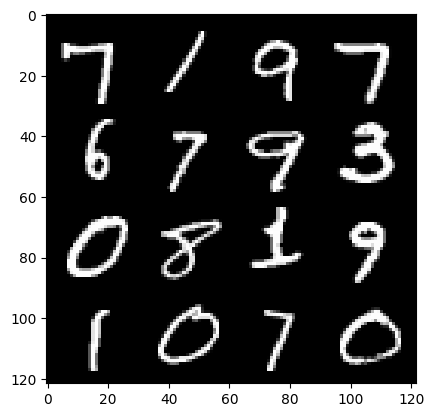

63: step 32400 / Gen loss: 3.6750838987032597 / Disc loss: 0.14313682883977893


  0%|          | 0/469 [00:00<?, ?it/s]

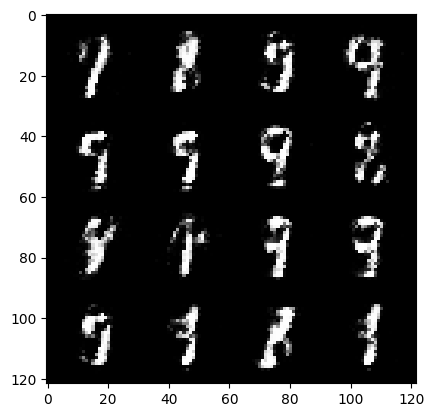

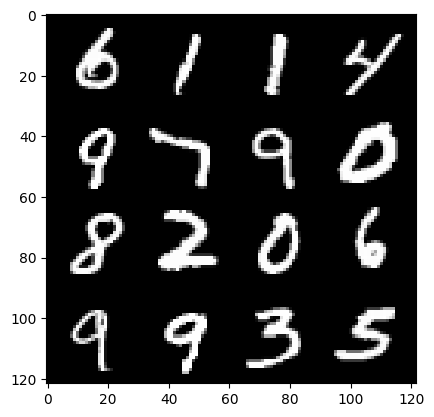

64: step 32700 / Gen loss: 3.688113164107001 / Disc loss: 0.1519666572163503


  0%|          | 0/469 [00:00<?, ?it/s]

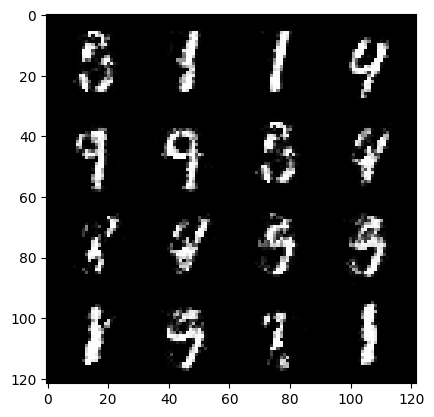

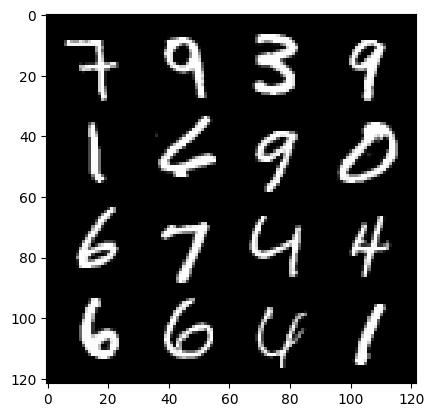

65: step 33000 / Gen loss: 3.66783045053482 / Disc loss: 0.1428498750180005


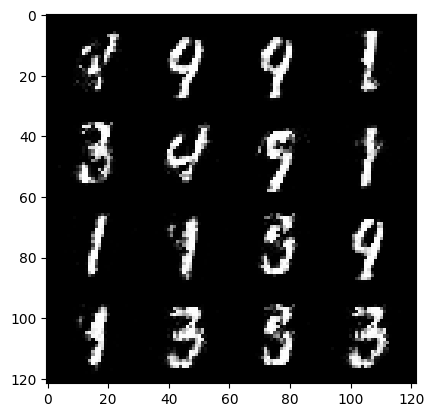

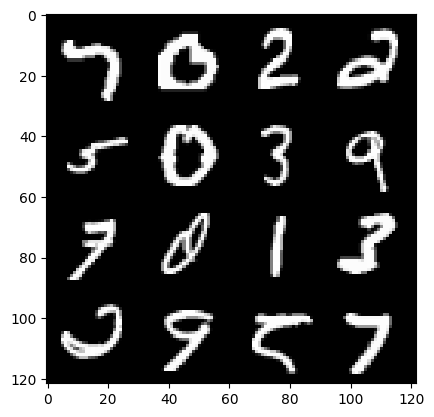

65: step 33300 / Gen loss: 3.6265172966321275 / Disc loss: 0.1385391699771086


  0%|          | 0/469 [00:00<?, ?it/s]

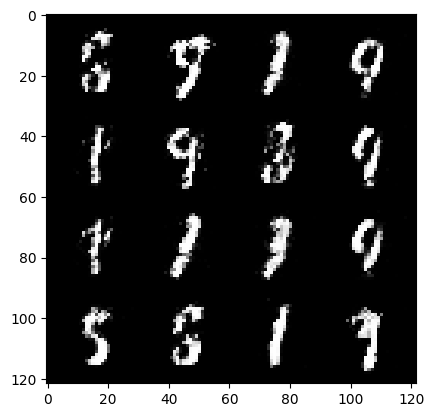

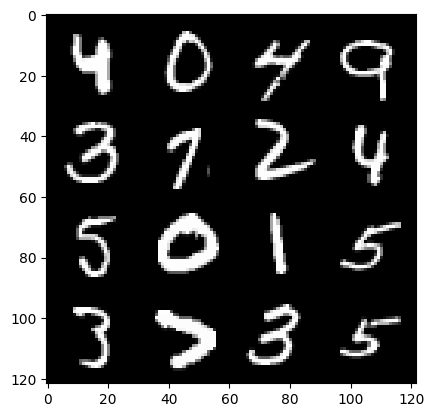

66: step 33600 / Gen loss: 3.7898869895935072 / Disc loss: 0.12313067502031719


  0%|          | 0/469 [00:00<?, ?it/s]

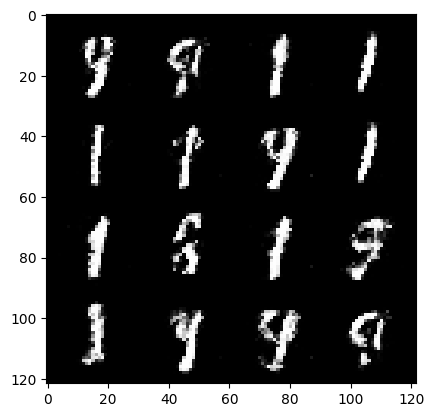

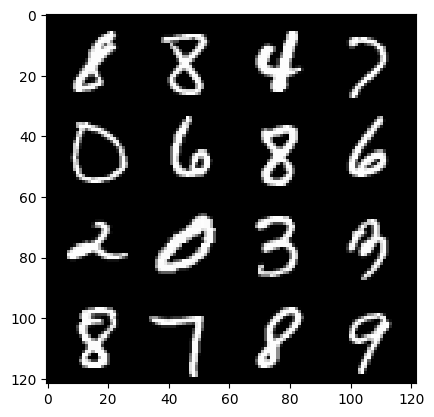

67: step 33900 / Gen loss: 3.445892512798309 / Disc loss: 0.15338310040533545


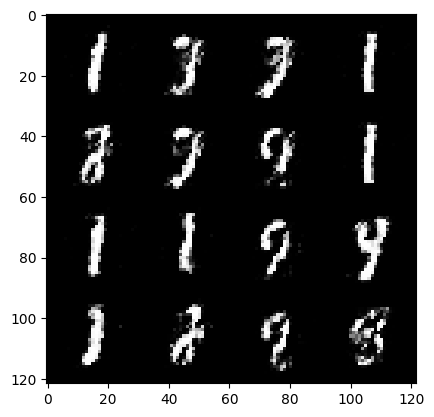

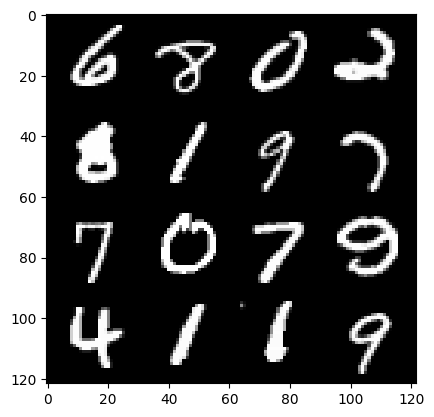

67: step 34200 / Gen loss: 3.4548491319020562 / Disc loss: 0.13925735448797563


  0%|          | 0/469 [00:00<?, ?it/s]

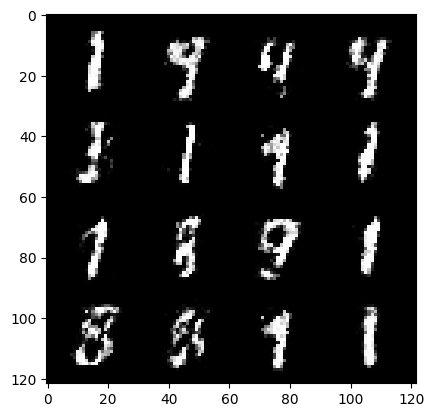

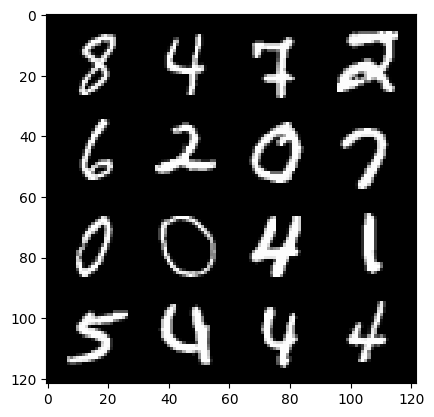

68: step 34500 / Gen loss: 3.5528595225016275 / Disc loss: 0.14049386399487662


  0%|          | 0/469 [00:00<?, ?it/s]

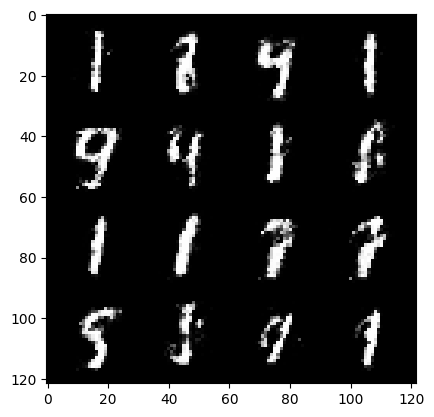

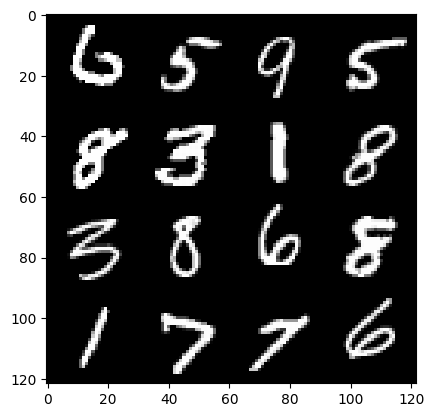

69: step 34800 / Gen loss: 3.4627439030011495 / Disc loss: 0.1593332668890555


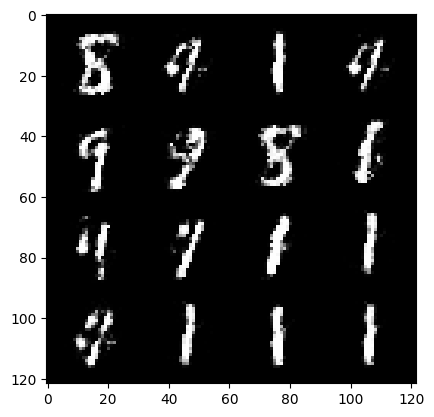

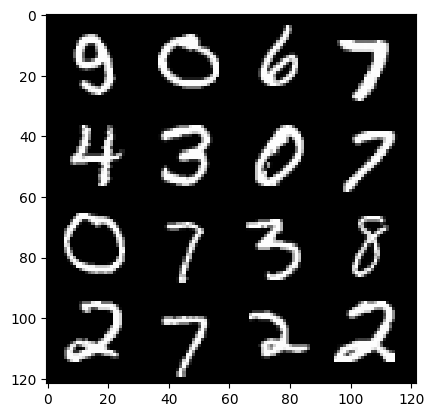

69: step 35100 / Gen loss: 3.480769532521566 / Disc loss: 0.17375757701694977


  0%|          | 0/469 [00:00<?, ?it/s]

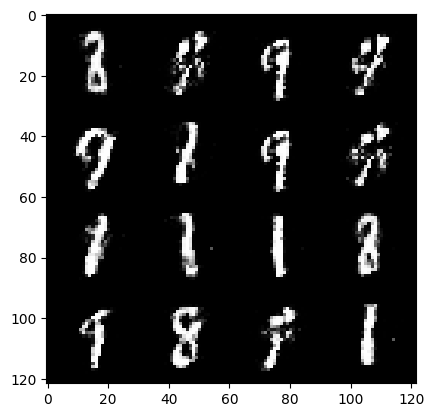

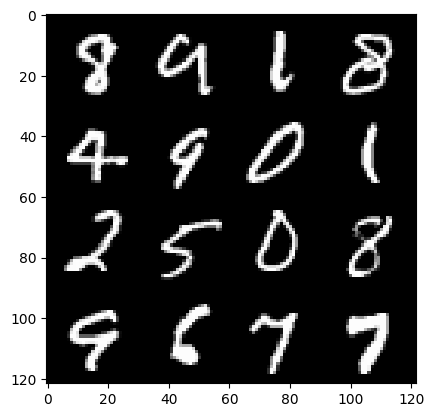

70: step 35400 / Gen loss: 3.2828124721845016 / Disc loss: 0.18810706585645665


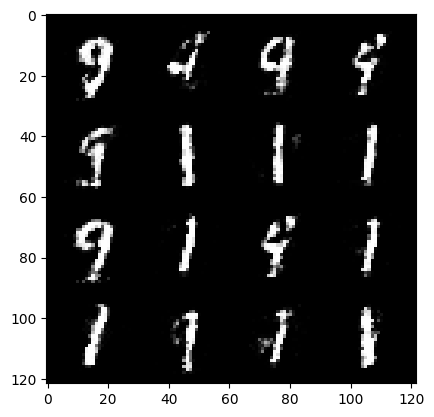

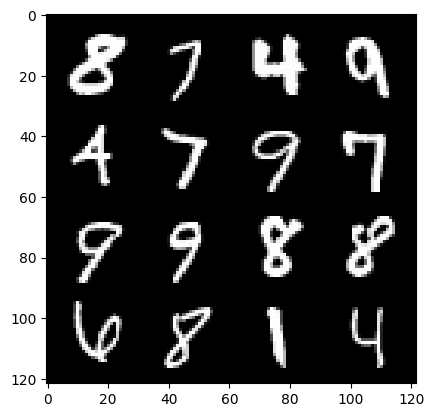

70: step 35700 / Gen loss: 3.1385738404591907 / Disc loss: 0.1890608367572227


  0%|          | 0/469 [00:00<?, ?it/s]

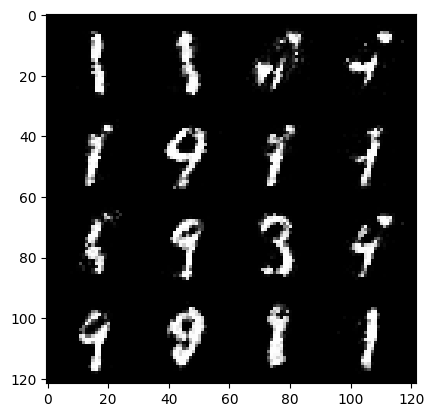

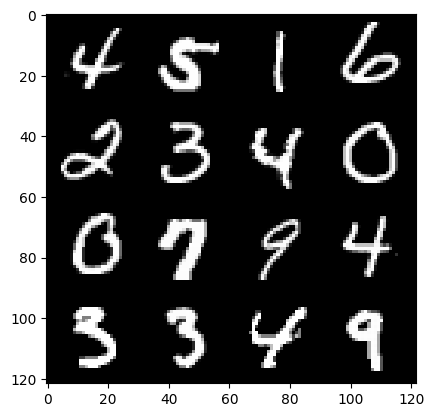

71: step 36000 / Gen loss: 3.198346865177152 / Disc loss: 0.16266098676870264


  0%|          | 0/469 [00:00<?, ?it/s]

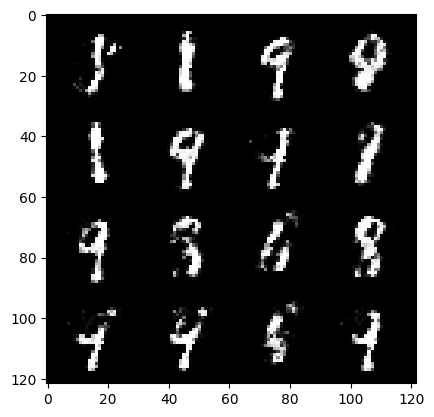

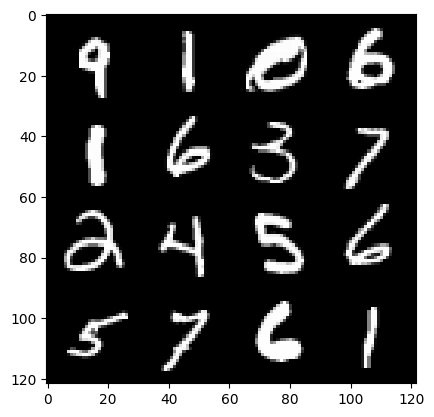

72: step 36300 / Gen loss: 3.2013484183947245 / Disc loss: 0.17077883504331112


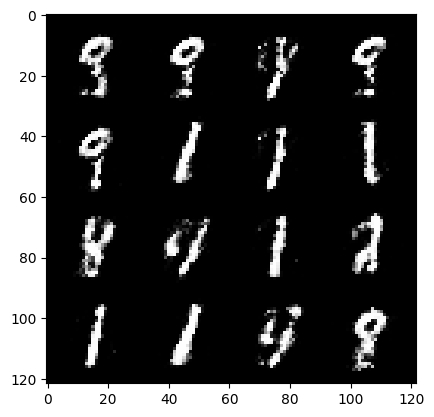

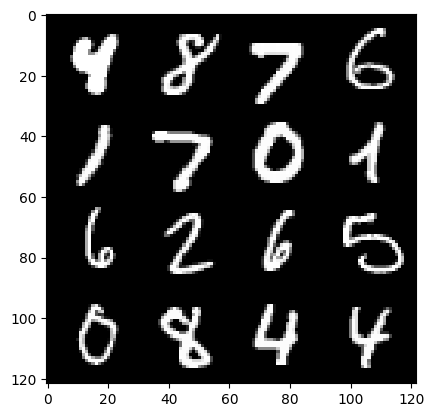

72: step 36600 / Gen loss: 3.0833632373809787 / Disc loss: 0.1877215772618851


  0%|          | 0/469 [00:00<?, ?it/s]

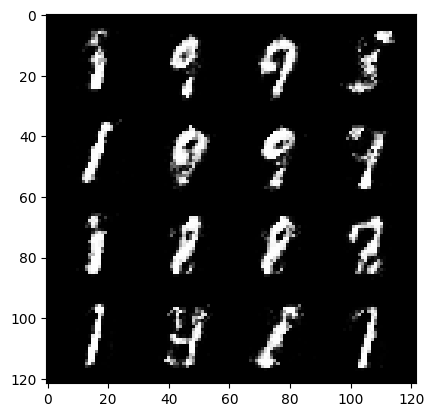

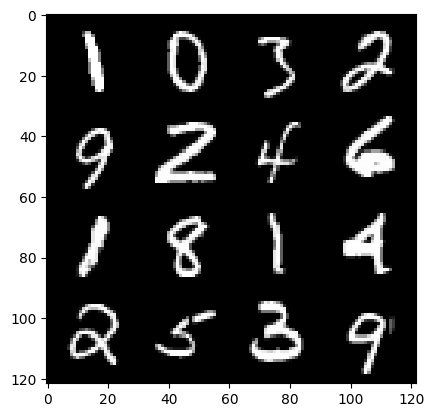

73: step 36900 / Gen loss: 2.8620309917132056 / Disc loss: 0.22238769419491294


  0%|          | 0/469 [00:00<?, ?it/s]

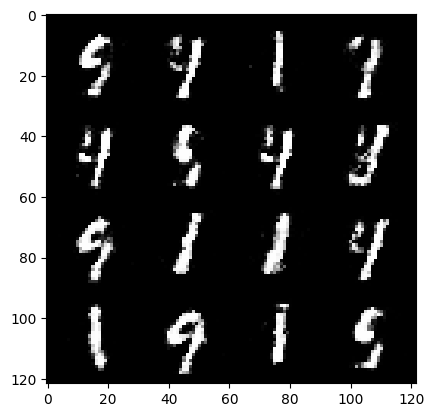

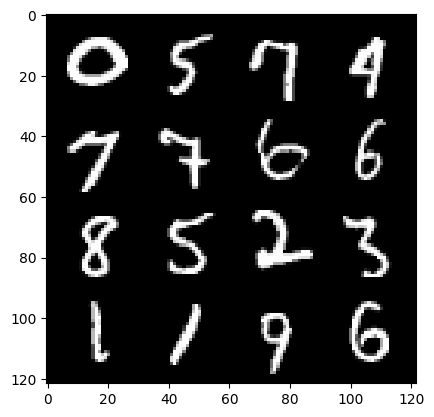

74: step 37200 / Gen loss: 2.8883702564239484 / Disc loss: 0.19190682152907043


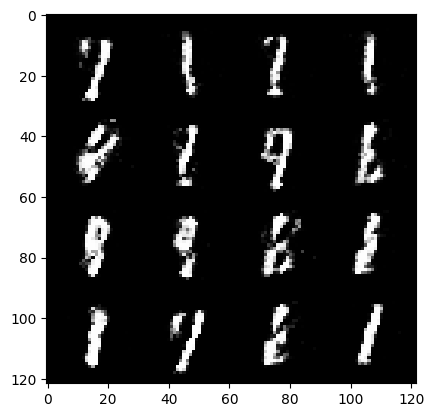

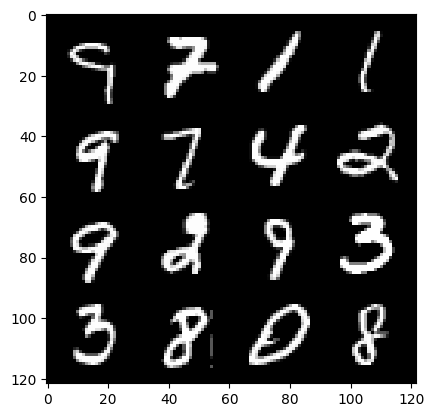

74: step 37500 / Gen loss: 2.9789920600255315 / Disc loss: 0.1772927428285281


  0%|          | 0/469 [00:00<?, ?it/s]

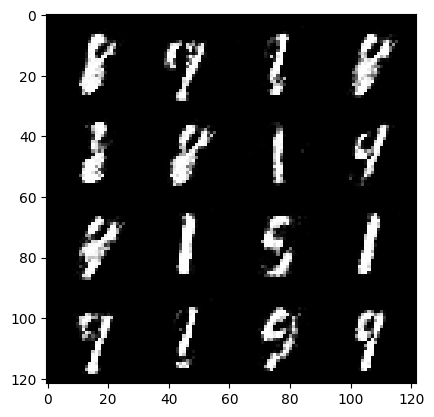

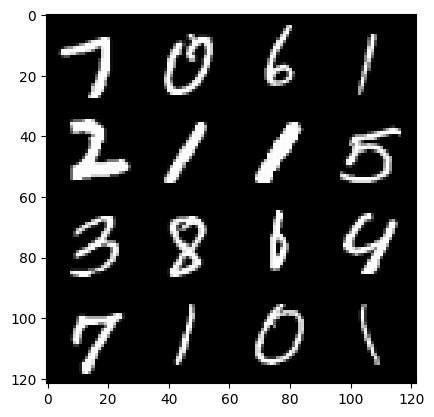

75: step 37800 / Gen loss: 3.0492289431889876 / Disc loss: 0.16243684994677707


  0%|          | 0/469 [00:00<?, ?it/s]

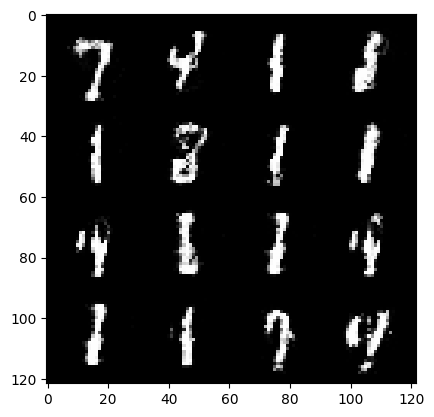

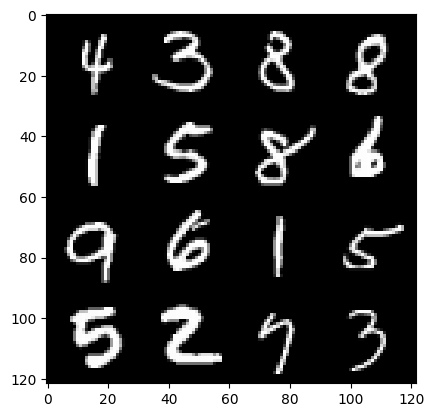

76: step 38100 / Gen loss: 2.947360281944273 / Disc loss: 0.19140269172688326


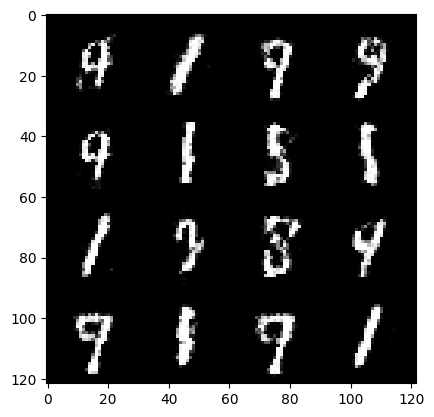

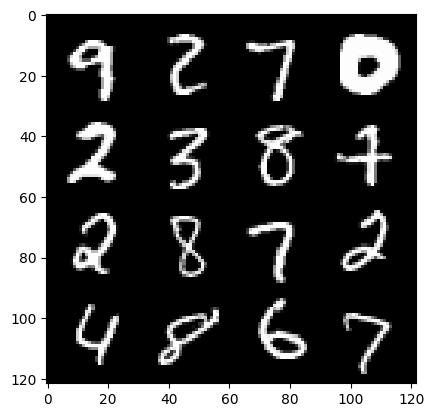

76: step 38400 / Gen loss: 2.8334663836161287 / Disc loss: 0.19999760501086708


  0%|          | 0/469 [00:00<?, ?it/s]

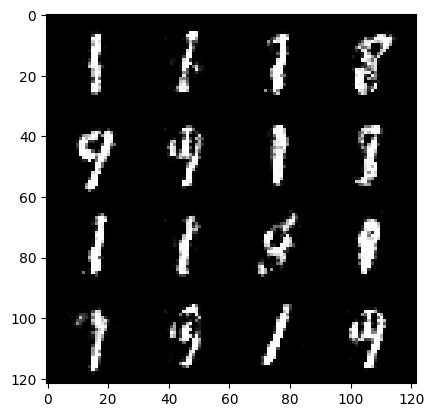

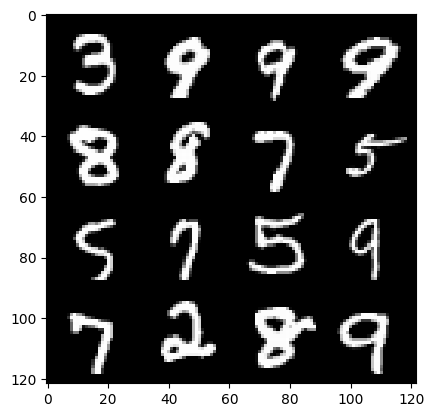

77: step 38700 / Gen loss: 2.895744230747226 / Disc loss: 0.19742124055822682


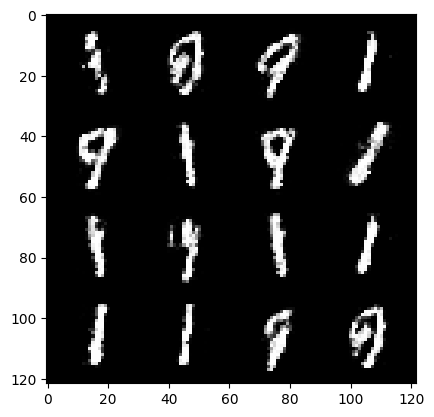

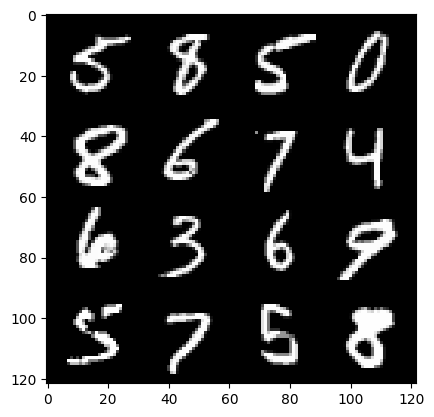

77: step 39000 / Gen loss: 2.8272622164090486 / Disc loss: 0.21668772766987496


  0%|          | 0/469 [00:00<?, ?it/s]

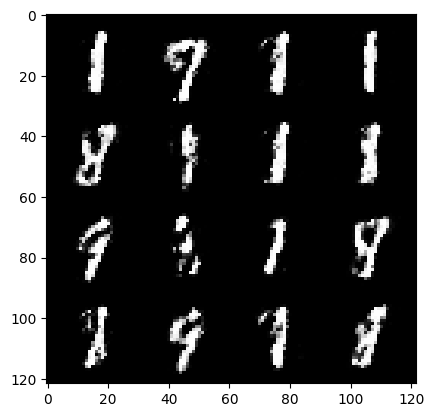

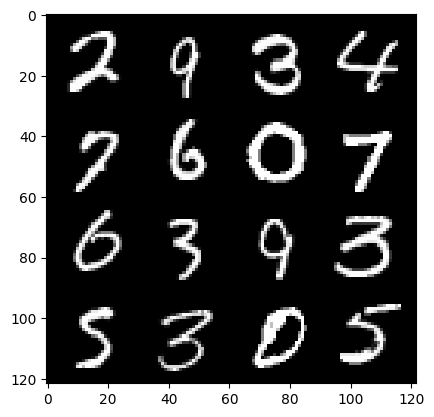

78: step 39300 / Gen loss: 2.7125218645731595 / Disc loss: 0.22134503498673438


  0%|          | 0/469 [00:00<?, ?it/s]

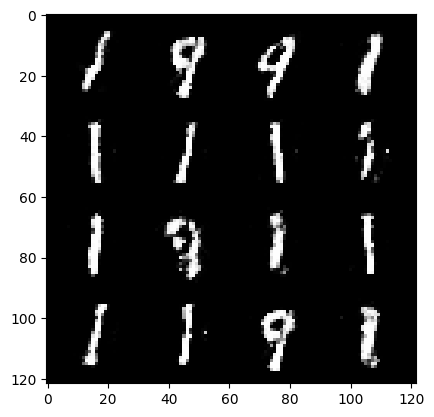

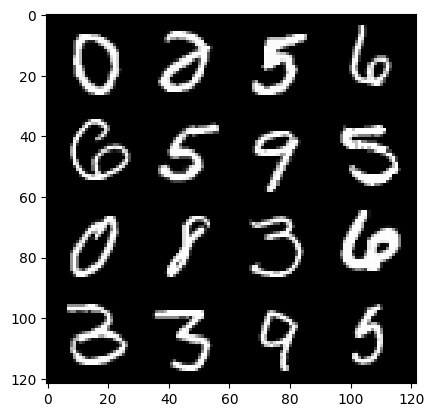

79: step 39600 / Gen loss: 2.6989187935988106 / Disc loss: 0.20698061180611438


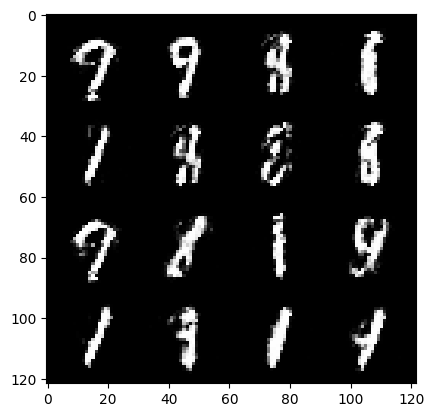

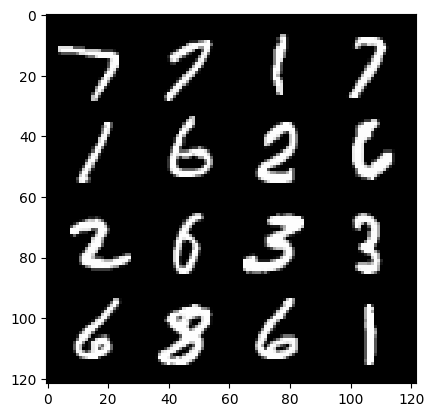

79: step 39900 / Gen loss: 2.700590272744498 / Disc loss: 0.21502651090423264


  0%|          | 0/469 [00:00<?, ?it/s]

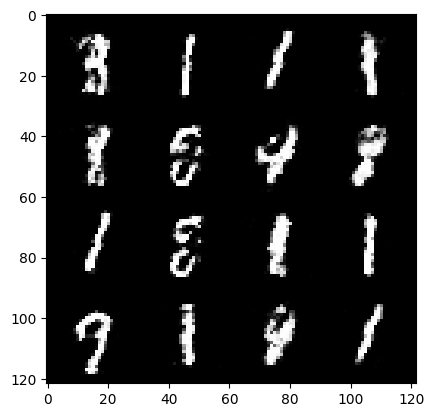

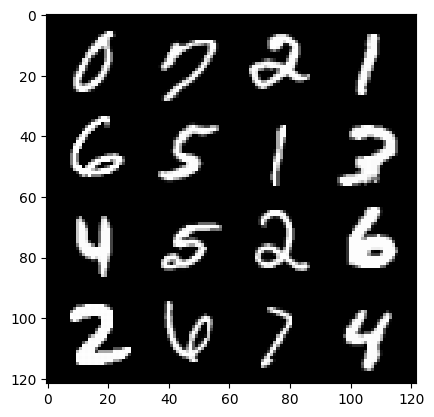

80: step 40200 / Gen loss: 2.6340847500165303 / Disc loss: 0.2261818785468738


  0%|          | 0/469 [00:00<?, ?it/s]

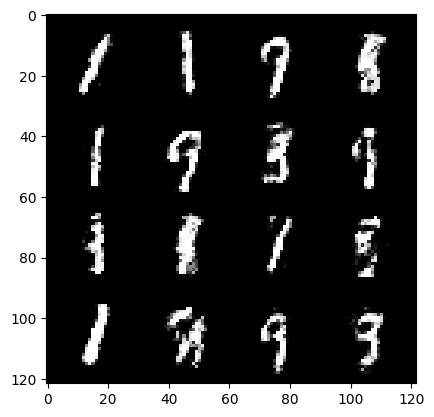

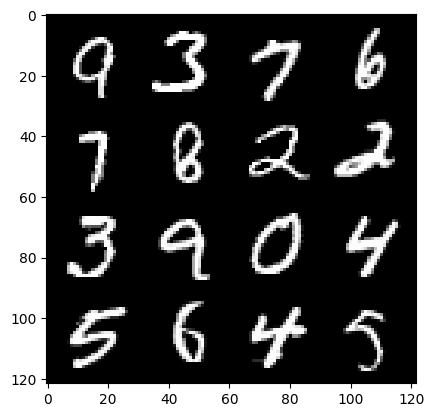

81: step 40500 / Gen loss: 2.5734916631380704 / Disc loss: 0.22268216823538148


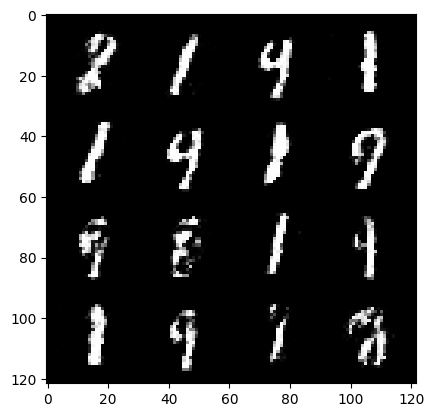

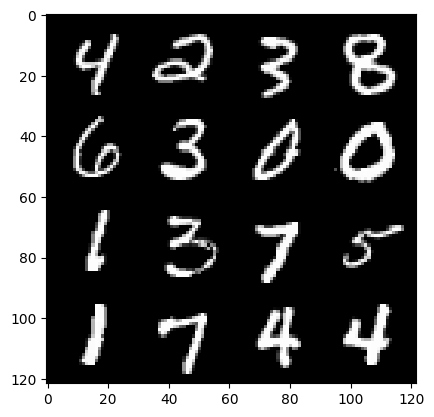

81: step 40800 / Gen loss: 2.576312700907392 / Disc loss: 0.23039097433288896


  0%|          | 0/469 [00:00<?, ?it/s]

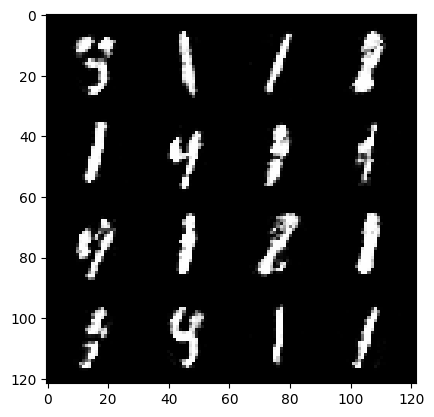

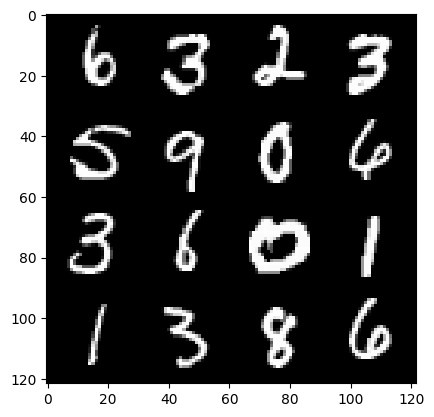

82: step 41100 / Gen loss: 2.507893364826838 / Disc loss: 0.23578140929341315


  0%|          | 0/469 [00:00<?, ?it/s]

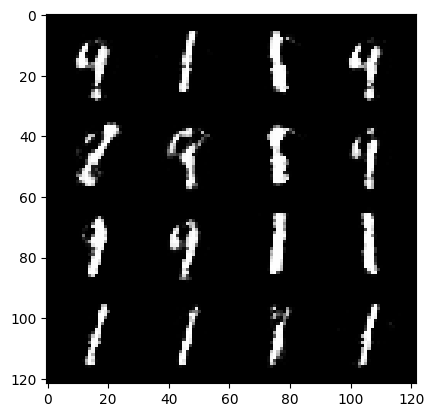

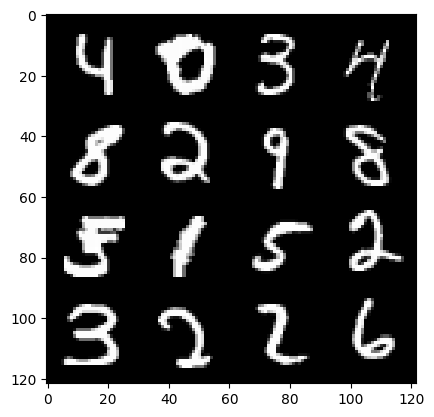

83: step 41400 / Gen loss: 2.610873866875966 / Disc loss: 0.21952604725956906


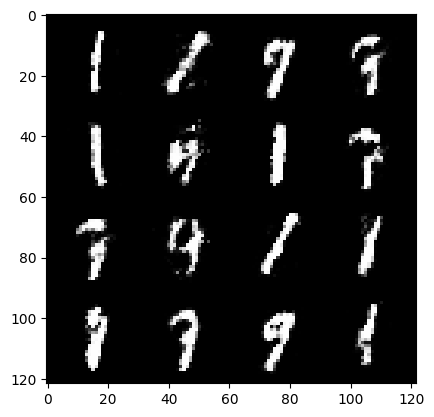

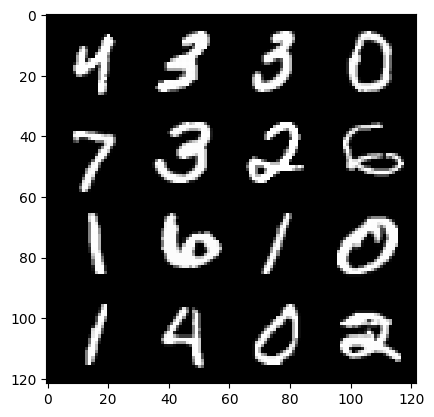

83: step 41700 / Gen loss: 2.58210861603419 / Disc loss: 0.21907269865274423


  0%|          | 0/469 [00:00<?, ?it/s]

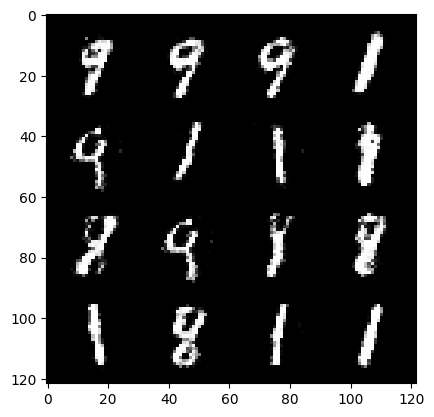

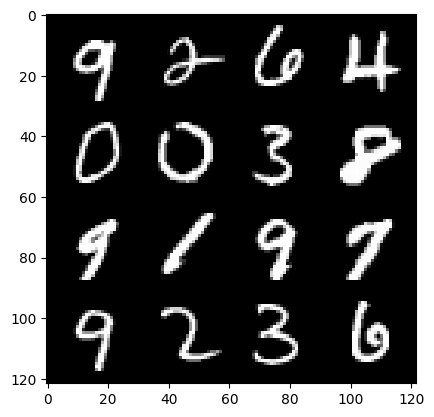

84: step 42000 / Gen loss: 2.576553493340809 / Disc loss: 0.23262797445058822


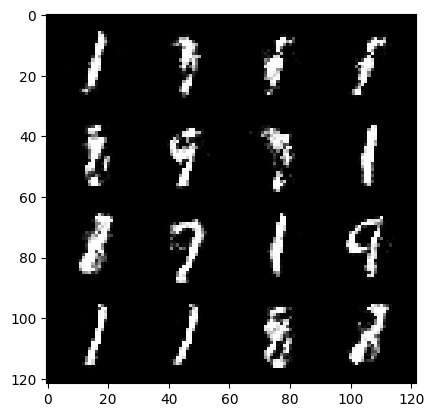

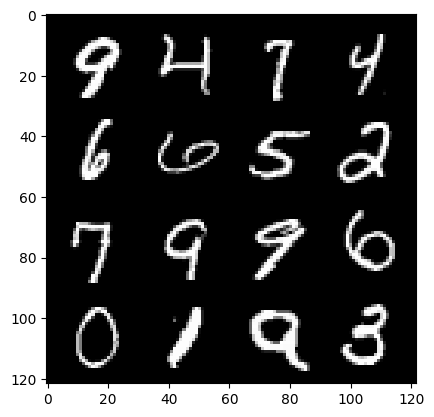

84: step 42300 / Gen loss: 2.514321322441101 / Disc loss: 0.23068514664967862


  0%|          | 0/469 [00:00<?, ?it/s]

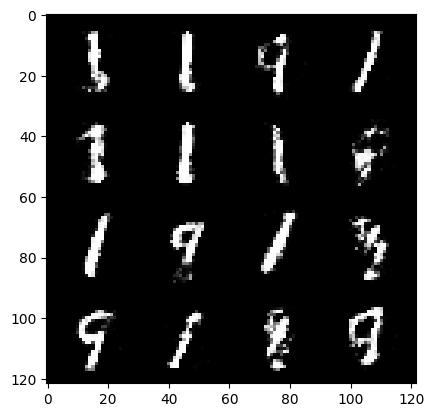

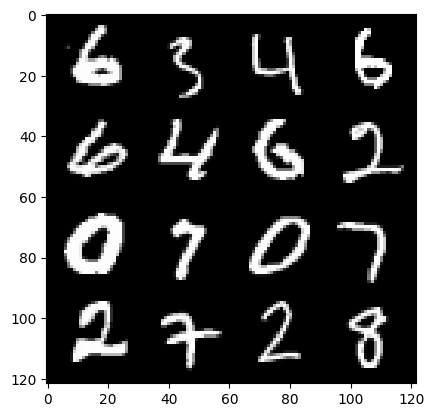

85: step 42600 / Gen loss: 2.5894602044423416 / Disc loss: 0.21878390242656076


  0%|          | 0/469 [00:00<?, ?it/s]

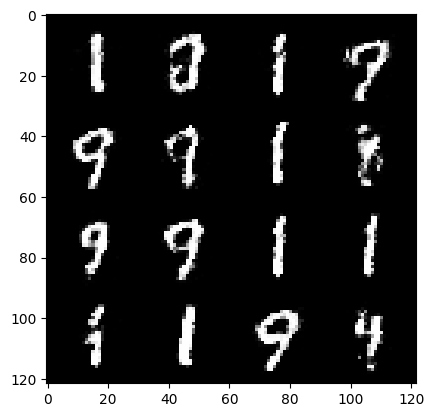

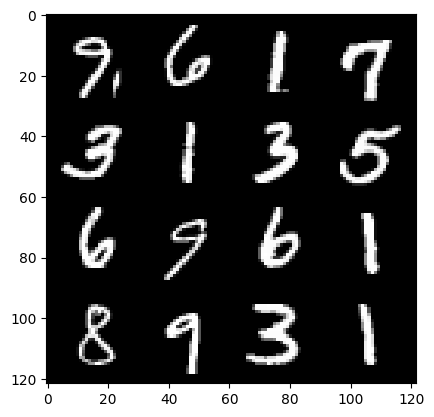

86: step 42900 / Gen loss: 2.5488656111558283 / Disc loss: 0.2255420277516049


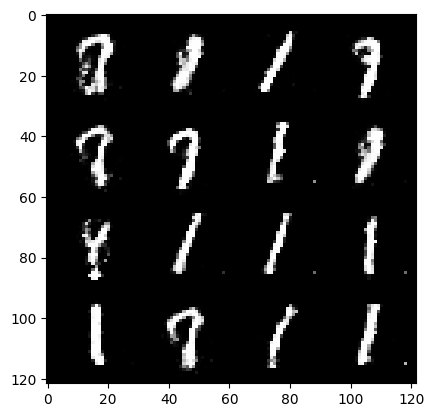

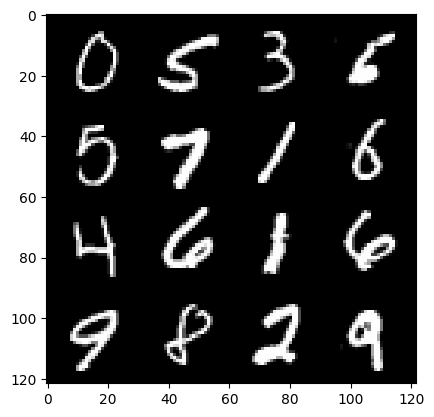

86: step 43200 / Gen loss: 2.4918346504370366 / Disc loss: 0.22845692358911046


  0%|          | 0/469 [00:00<?, ?it/s]

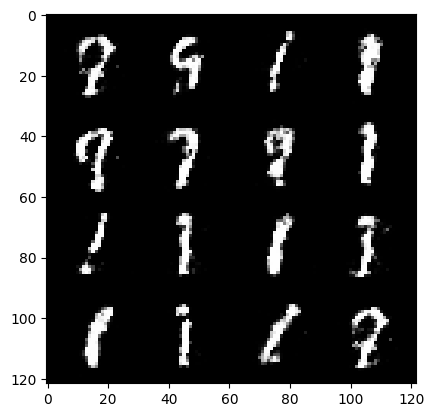

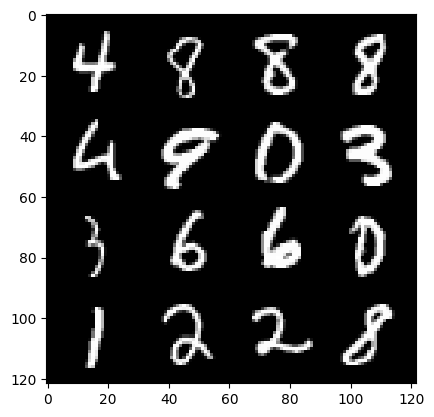

87: step 43500 / Gen loss: 2.3709336594740558 / Disc loss: 0.25439427271485343


  0%|          | 0/469 [00:00<?, ?it/s]

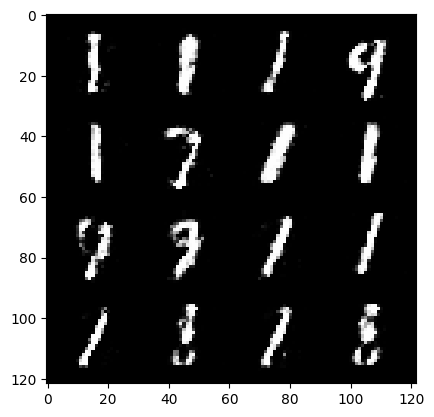

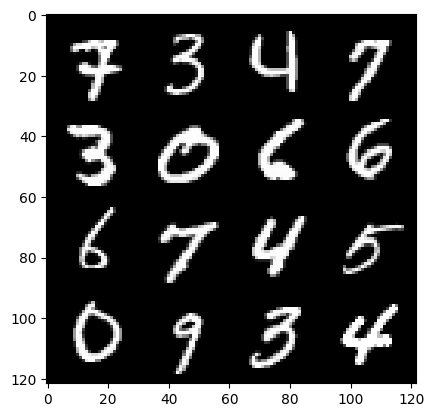

88: step 43800 / Gen loss: 2.3612827893098203 / Disc loss: 0.2413422589500748


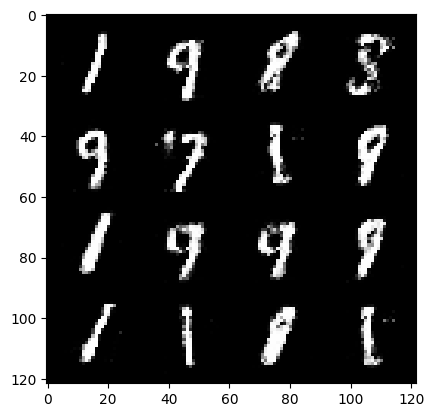

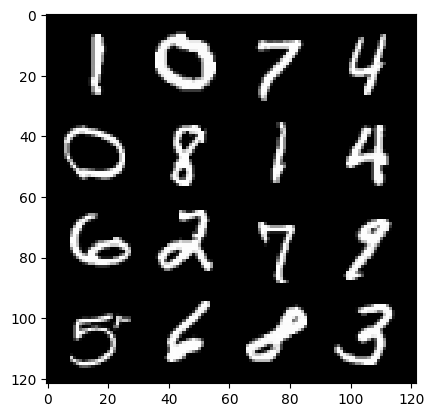

88: step 44100 / Gen loss: 2.3396556135018662 / Disc loss: 0.24822080696622545


  0%|          | 0/469 [00:00<?, ?it/s]

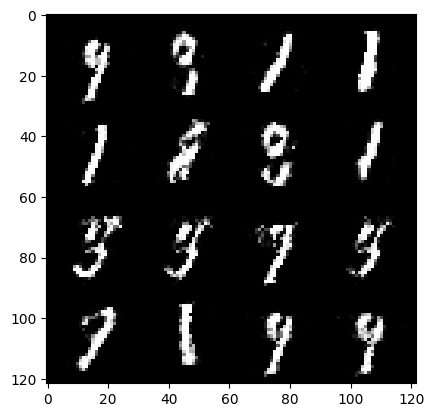

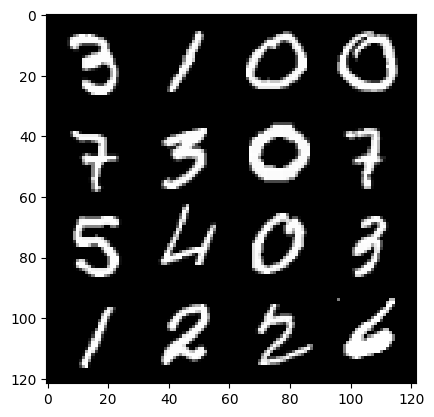

89: step 44400 / Gen loss: 2.2885707473754873 / Disc loss: 0.25412286286552754


  0%|          | 0/469 [00:00<?, ?it/s]

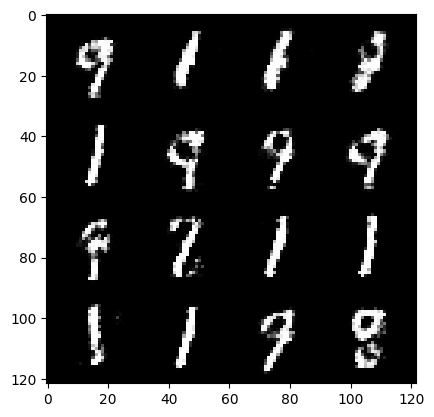

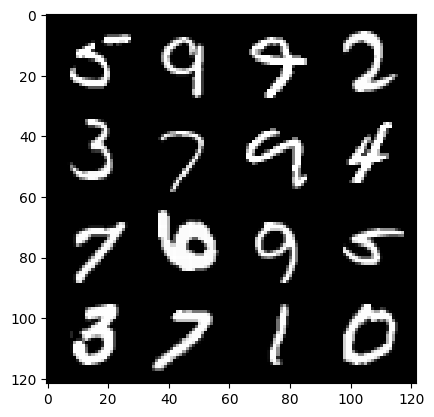

90: step 44700 / Gen loss: 2.338355716466904 / Disc loss: 0.24846154823899277


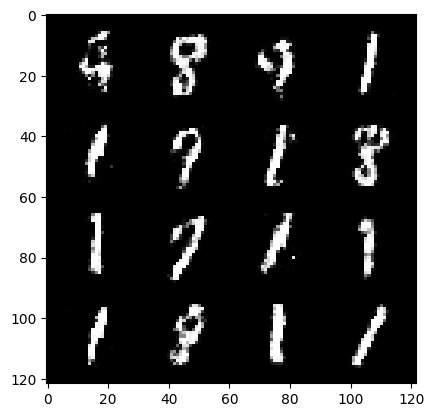

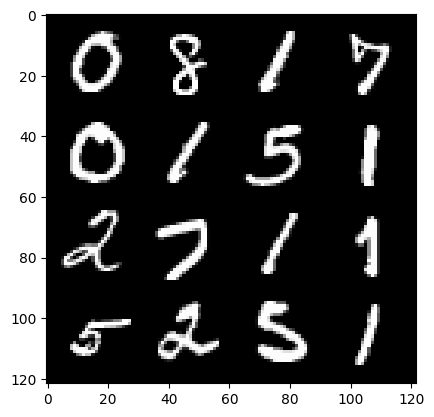

90: step 45000 / Gen loss: 2.318321706453961 / Disc loss: 0.24066568421820791


  0%|          | 0/469 [00:00<?, ?it/s]

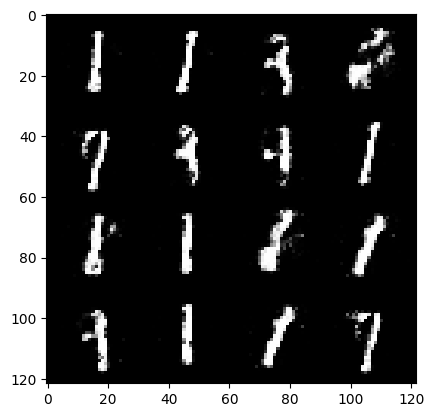

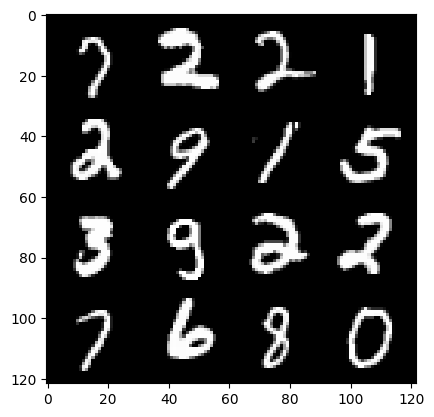

91: step 45300 / Gen loss: 2.2781664490699773 / Disc loss: 0.25411583860715237


  0%|          | 0/469 [00:00<?, ?it/s]

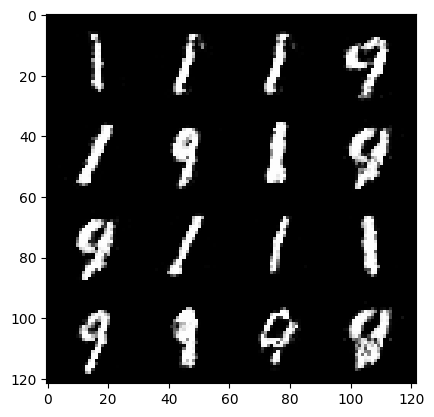

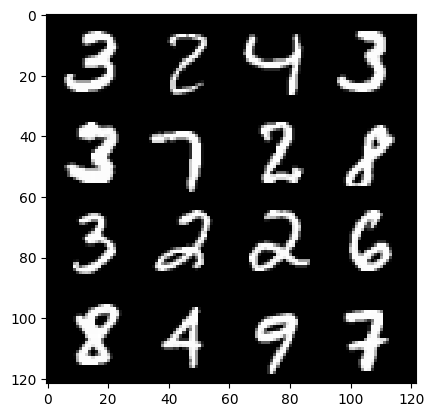

92: step 45600 / Gen loss: 2.269298630952836 / Disc loss: 0.245238667478164


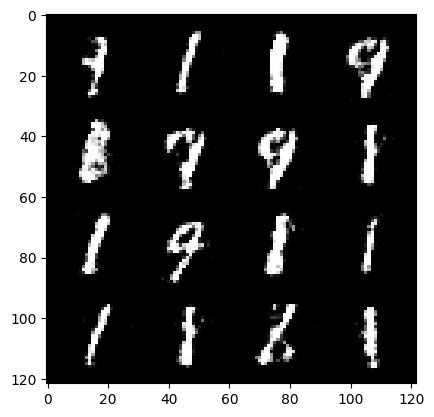

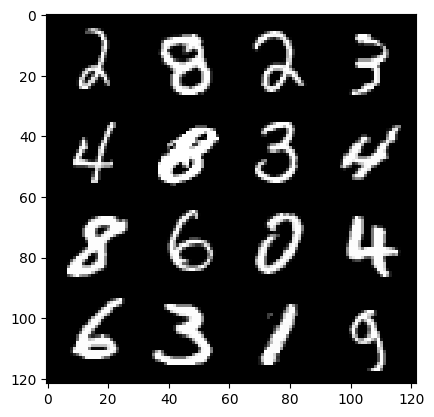

92: step 45900 / Gen loss: 2.317789149284363 / Disc loss: 0.23328885088364273


  0%|          | 0/469 [00:00<?, ?it/s]

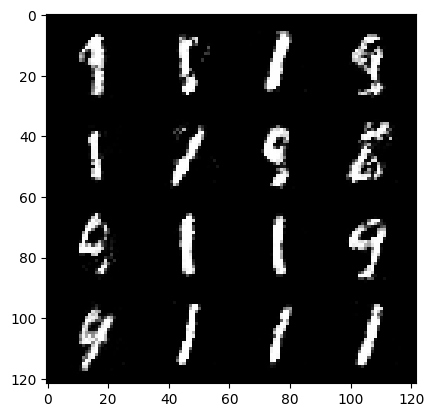

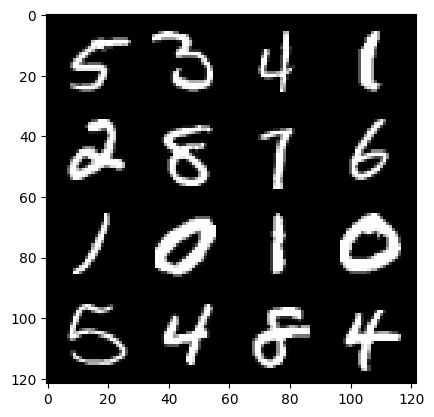

93: step 46200 / Gen loss: 2.3079804694652566 / Disc loss: 0.24715303952495246


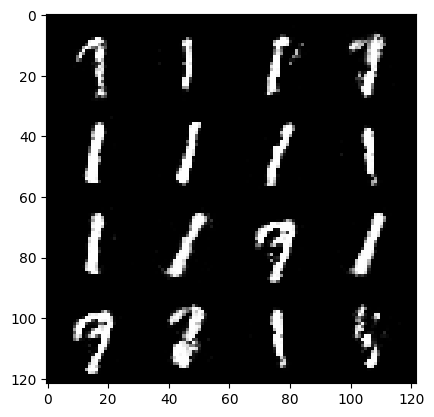

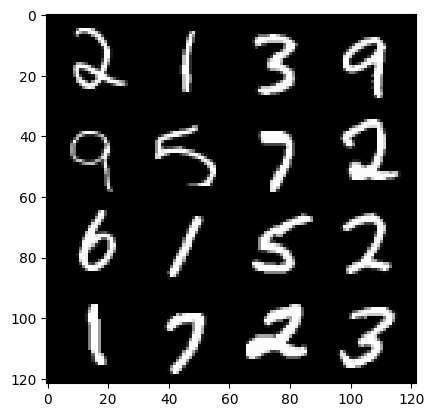

93: step 46500 / Gen loss: 2.2783425140380844 / Disc loss: 0.2440700361629327


  0%|          | 0/469 [00:00<?, ?it/s]

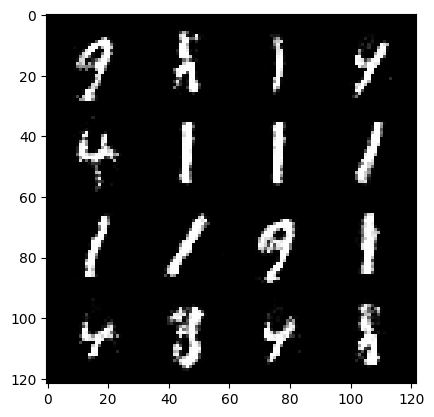

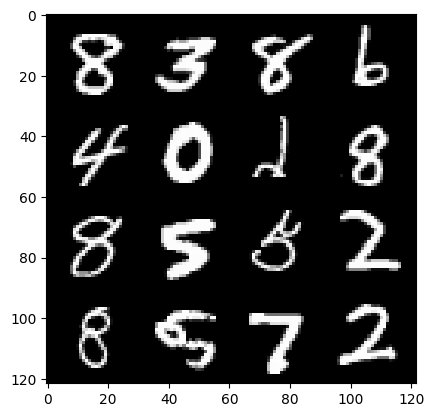

94: step 46800 / Gen loss: 2.298848753770194 / Disc loss: 0.2479967547456423


  0%|          | 0/469 [00:00<?, ?it/s]

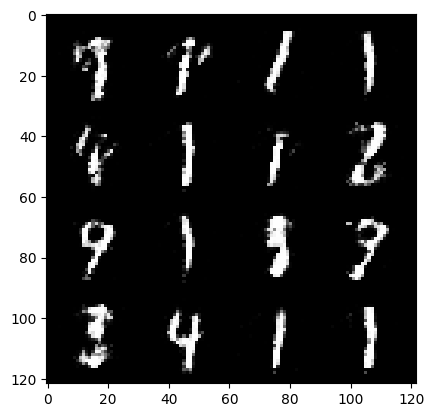

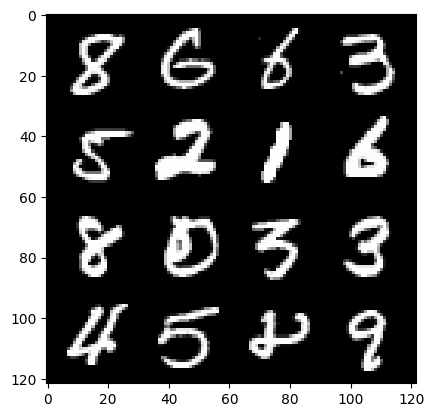

95: step 47100 / Gen loss: 2.1196462325255077 / Disc loss: 0.2871735357244809


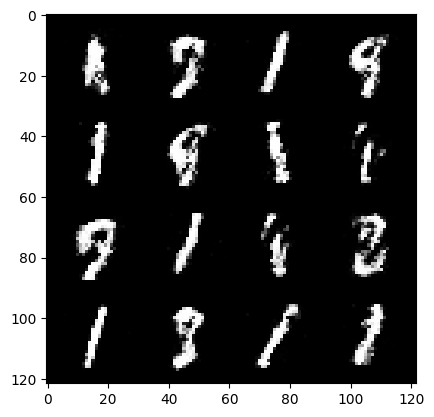

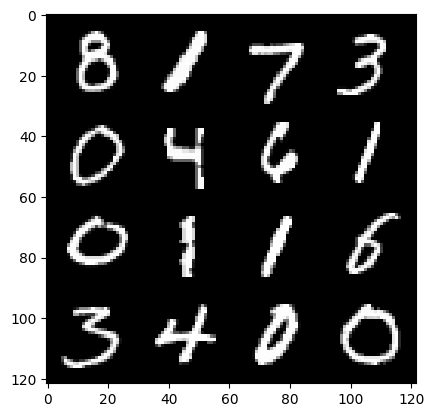

95: step 47400 / Gen loss: 2.1940223491191877 / Disc loss: 0.26137447292606053


  0%|          | 0/469 [00:00<?, ?it/s]

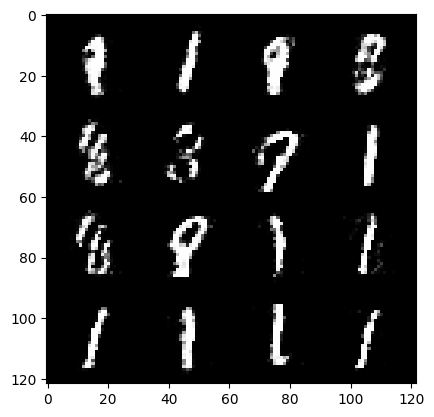

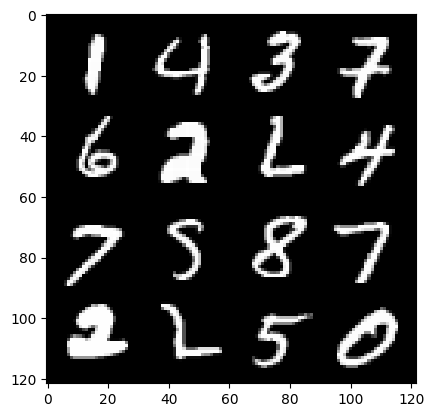

96: step 47700 / Gen loss: 2.2040568621953325 / Disc loss: 0.2508931167423727


  0%|          | 0/469 [00:00<?, ?it/s]

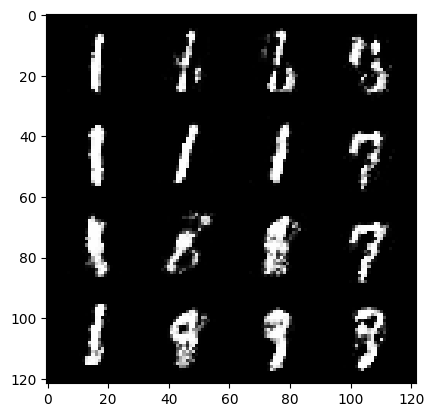

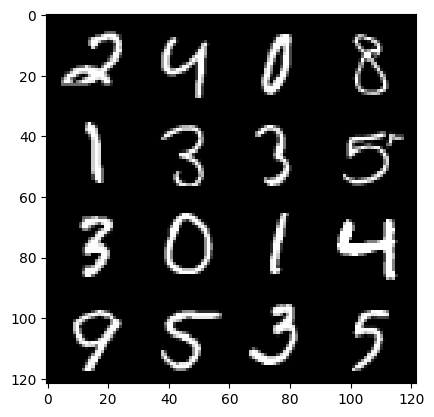

97: step 48000 / Gen loss: 2.2051046295960735 / Disc loss: 0.2663969063758851


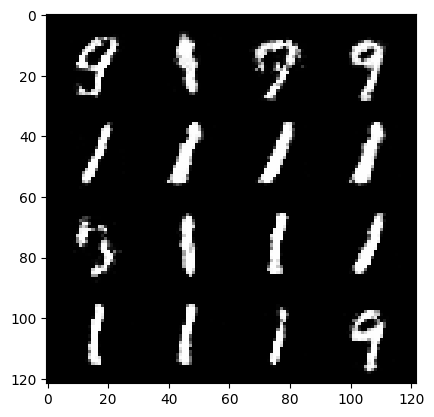

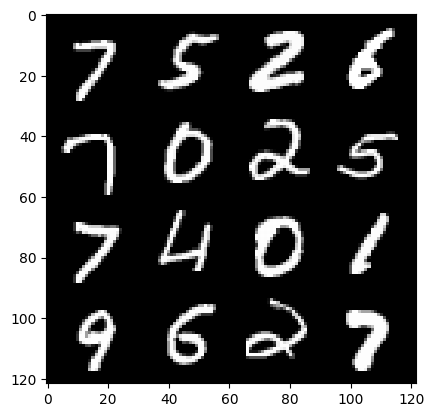

97: step 48300 / Gen loss: 2.146229445139566 / Disc loss: 0.26132303178310395


  0%|          | 0/469 [00:00<?, ?it/s]

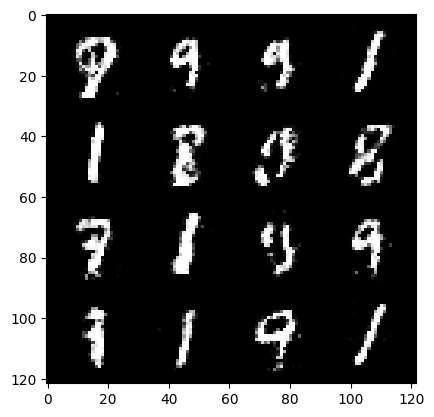

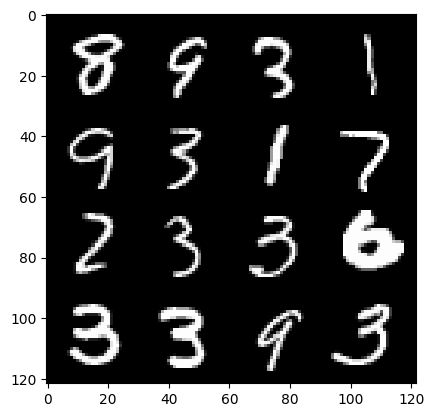

98: step 48600 / Gen loss: 2.158452152808506 / Disc loss: 0.27290250246723485


  0%|          | 0/469 [00:00<?, ?it/s]

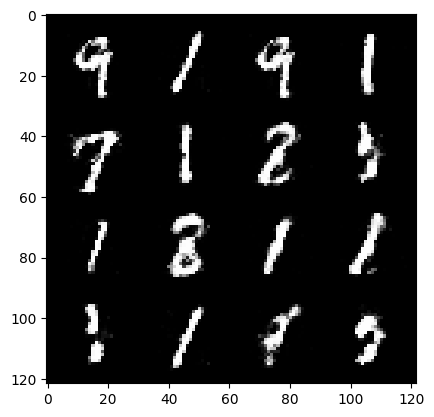

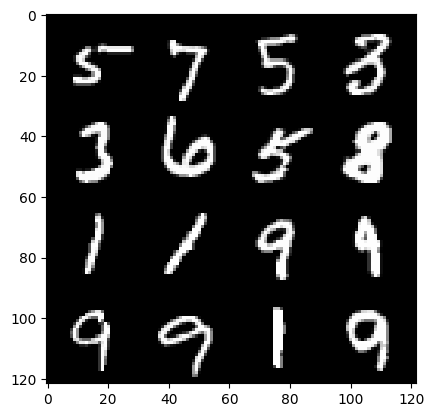

99: step 48900 / Gen loss: 2.1415732153256735 / Disc loss: 0.2618750327825544


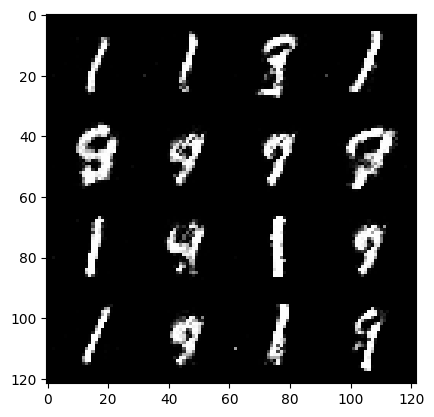

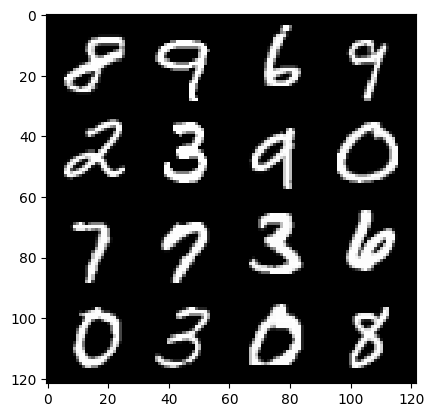

99: step 49200 / Gen loss: 2.0993403017520893 / Disc loss: 0.27130299717187856


  0%|          | 0/469 [00:00<?, ?it/s]

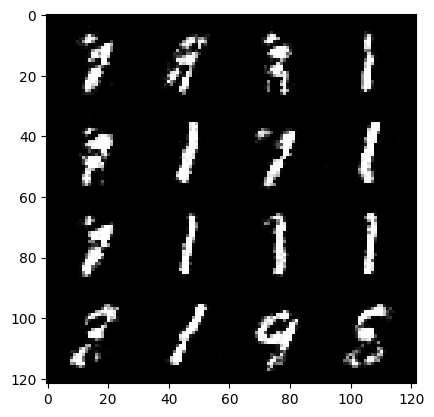

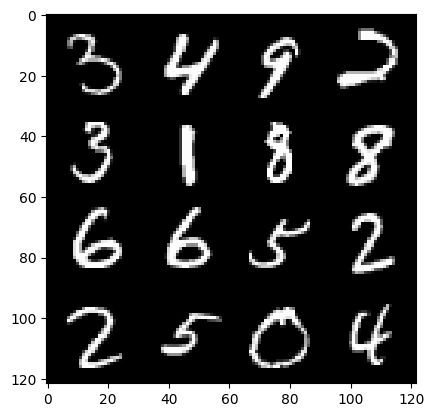

100: step 49500 / Gen loss: 2.1623970699310306 / Disc loss: 0.2555006291468939


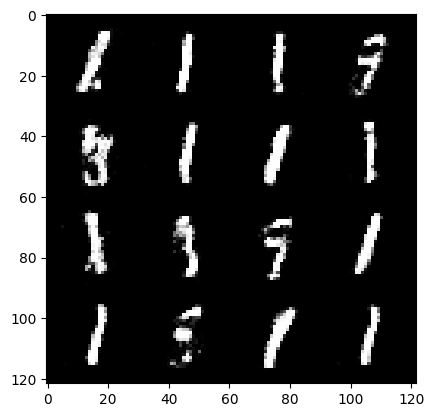

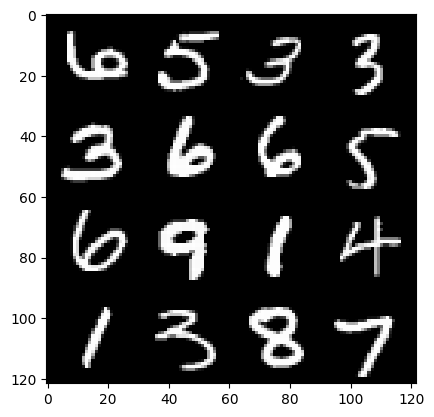

100: step 49800 / Gen loss: 2.168933698733647 / Disc loss: 0.26104121377070727


  0%|          | 0/469 [00:00<?, ?it/s]

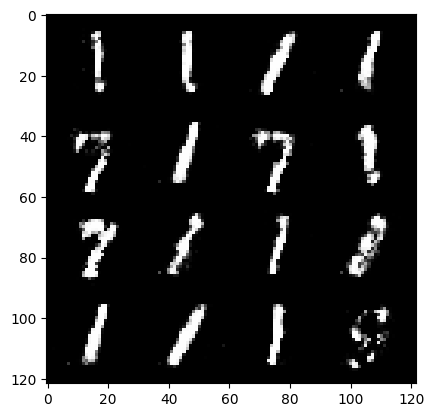

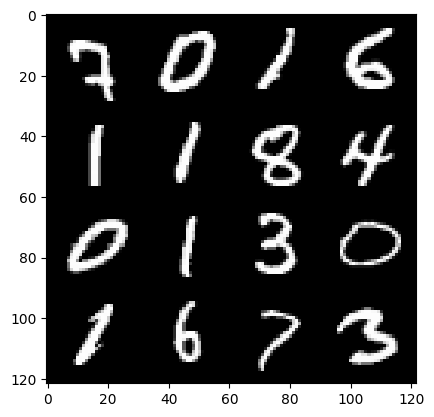

101: step 50100 / Gen loss: 2.101393363475801 / Disc loss: 0.26788844347000135


  0%|          | 0/469 [00:00<?, ?it/s]

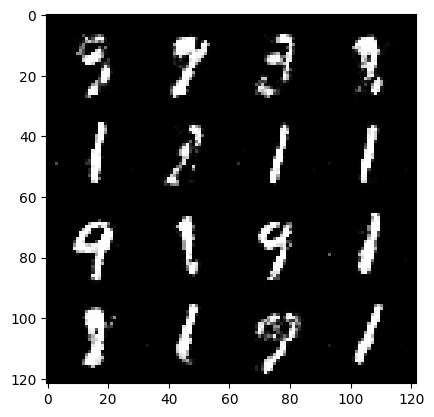

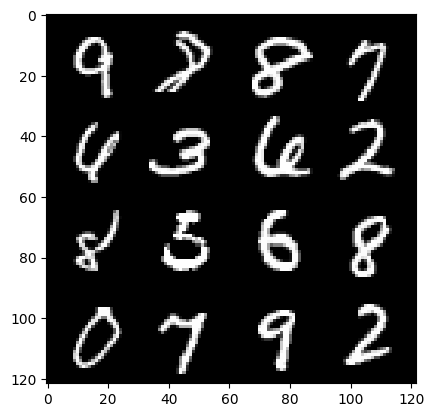

102: step 50400 / Gen loss: 2.0779128237565354 / Disc loss: 0.27208111787835754


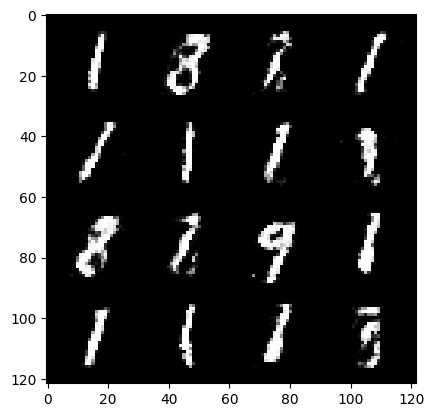

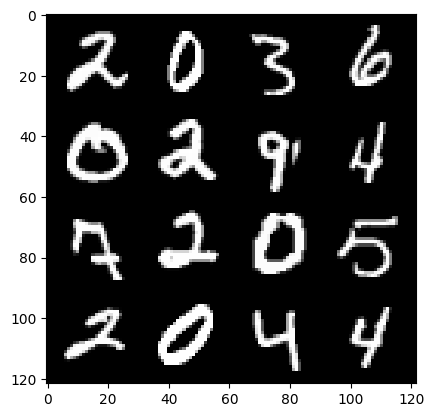

102: step 50700 / Gen loss: 2.0431205916404718 / Disc loss: 0.28060847580432896


  0%|          | 0/469 [00:00<?, ?it/s]

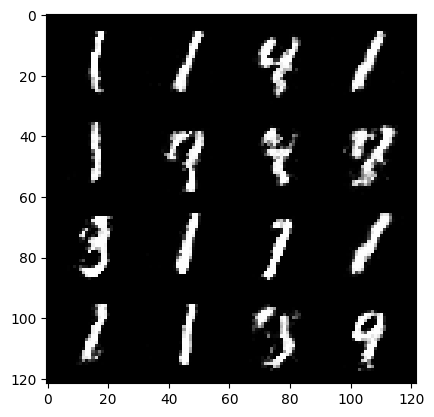

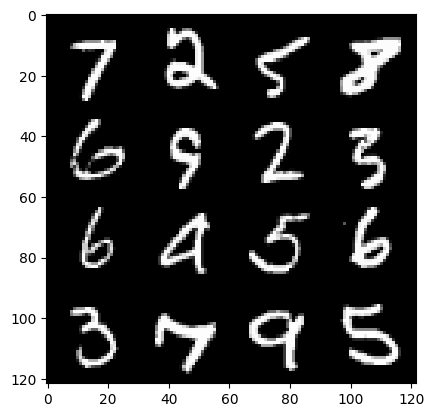

103: step 51000 / Gen loss: 2.0724448013305663 / Disc loss: 0.27266852617263787


  0%|          | 0/469 [00:00<?, ?it/s]

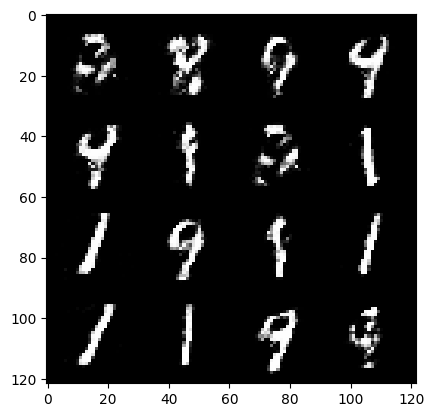

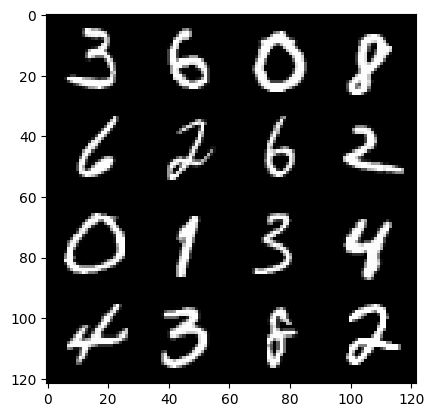

104: step 51300 / Gen loss: 2.0290928832689916 / Disc loss: 0.29108827074368787


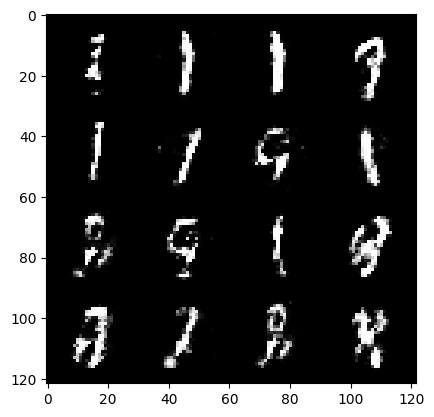

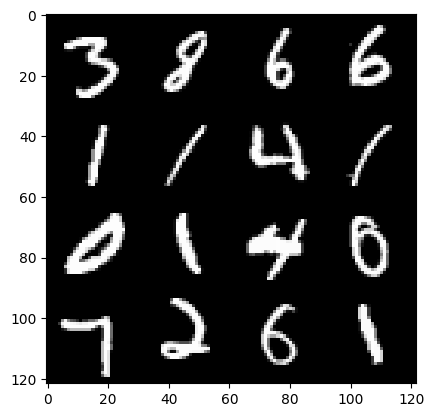

104: step 51600 / Gen loss: 1.949773100217185 / Disc loss: 0.29565991729497915


  0%|          | 0/469 [00:00<?, ?it/s]

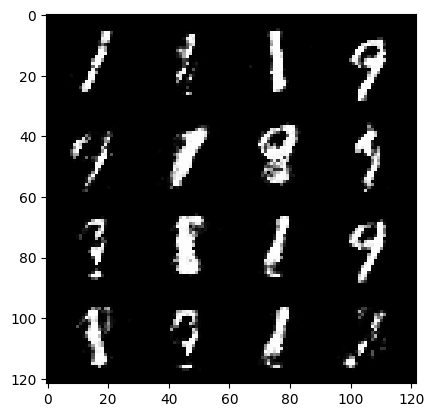

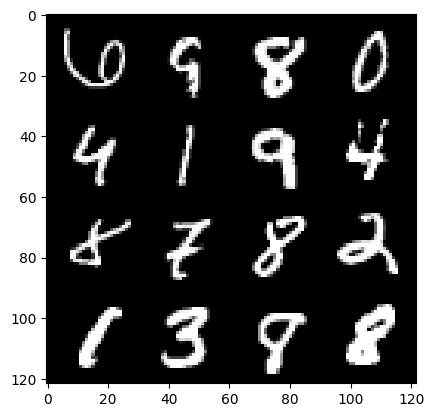

105: step 51900 / Gen loss: 2.1242041460673002 / Disc loss: 0.251497183640798


  0%|          | 0/469 [00:00<?, ?it/s]

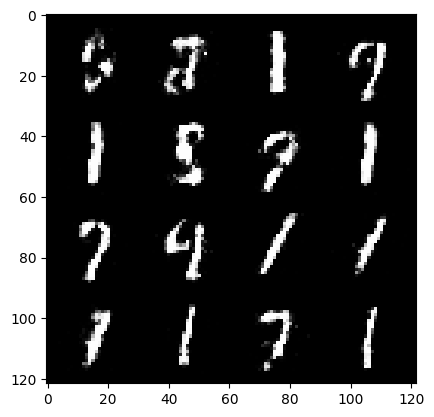

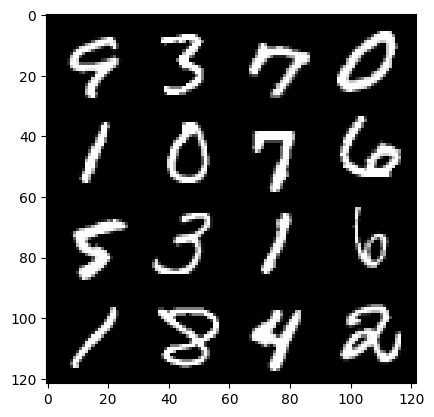

106: step 52200 / Gen loss: 2.0390383887290957 / Disc loss: 0.274467698285977


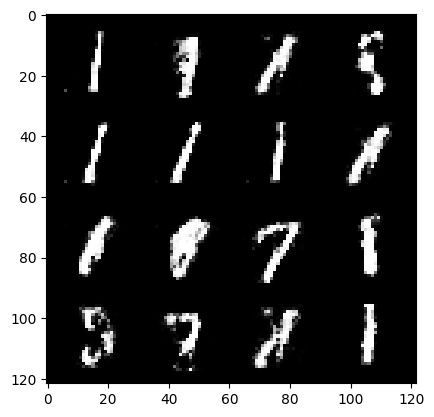

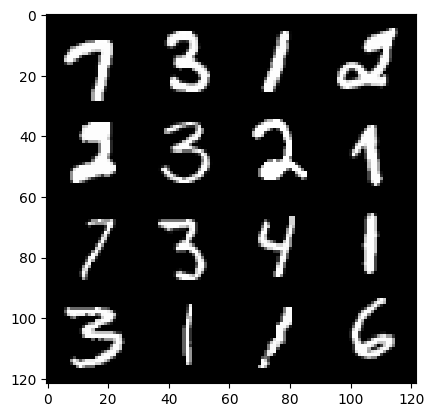

106: step 52500 / Gen loss: 1.9700530183315266 / Disc loss: 0.29138441910346374


  0%|          | 0/469 [00:00<?, ?it/s]

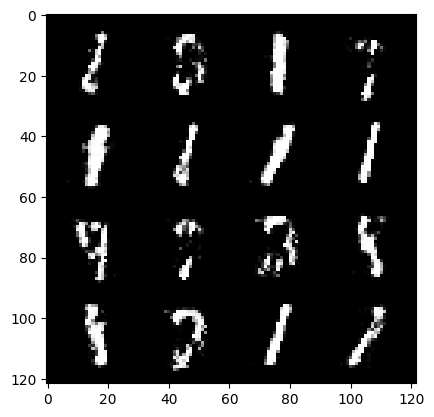

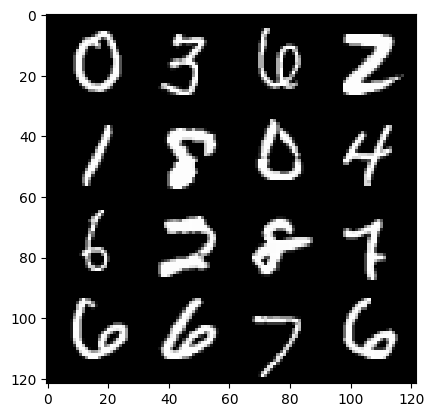

107: step 52800 / Gen loss: 1.9610927589734404 / Disc loss: 0.2932414017617702


  0%|          | 0/469 [00:00<?, ?it/s]

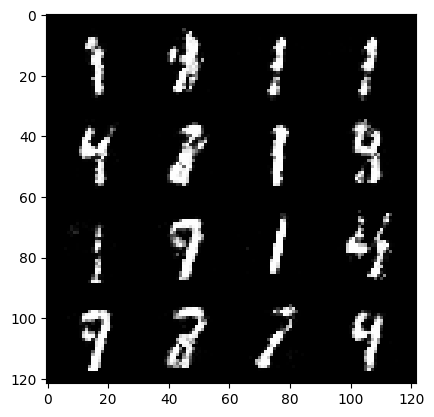

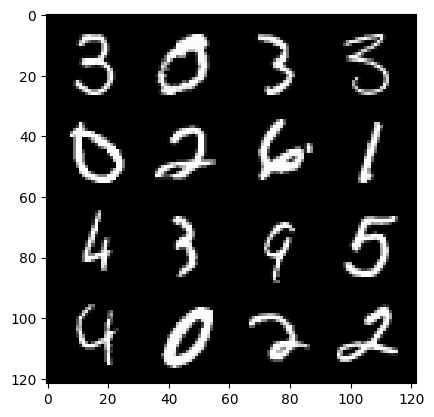

108: step 53100 / Gen loss: 1.9704981052875512 / Disc loss: 0.28562211478749944


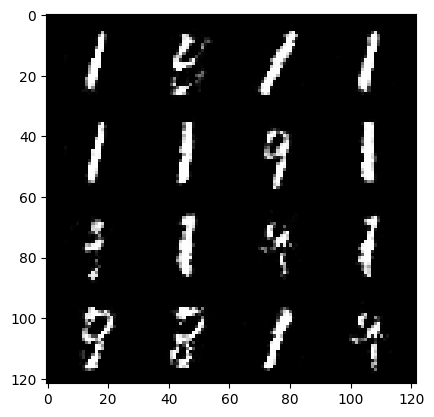

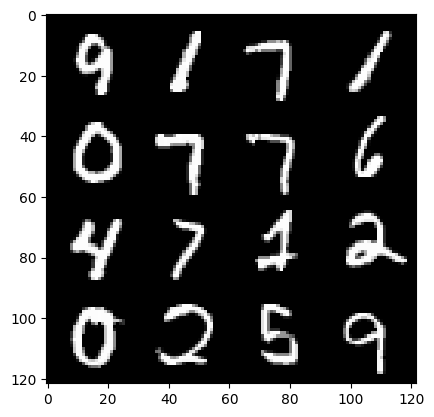

108: step 53400 / Gen loss: 2.0045622853438068 / Disc loss: 0.27259283403555545


  0%|          | 0/469 [00:00<?, ?it/s]

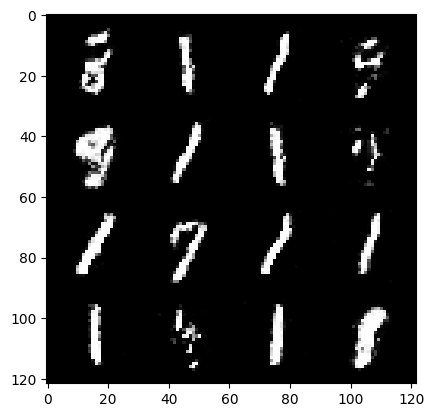

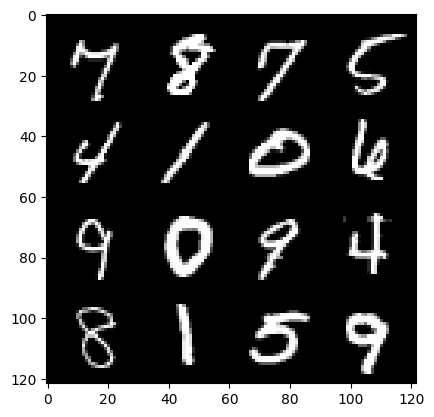

109: step 53700 / Gen loss: 2.05734889149666 / Disc loss: 0.26700391158461584


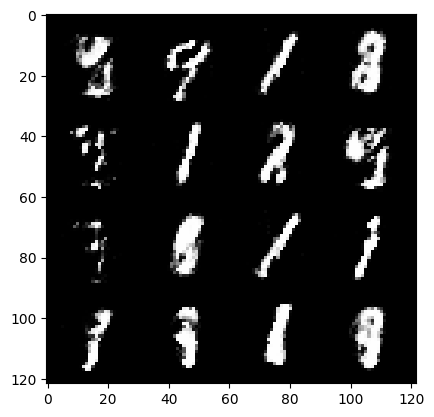

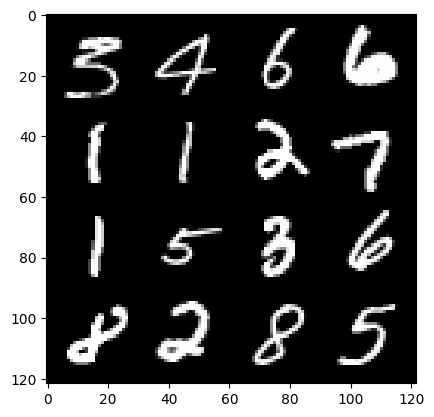

109: step 54000 / Gen loss: 1.9749694458643607 / Disc loss: 0.30133026435971255


  0%|          | 0/469 [00:00<?, ?it/s]

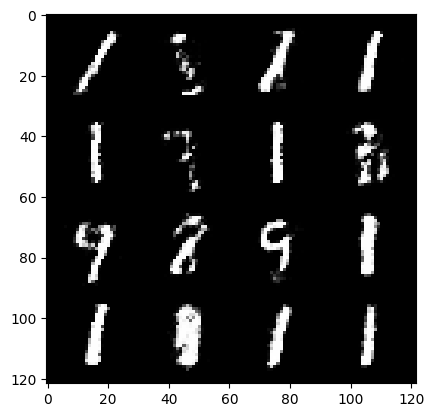

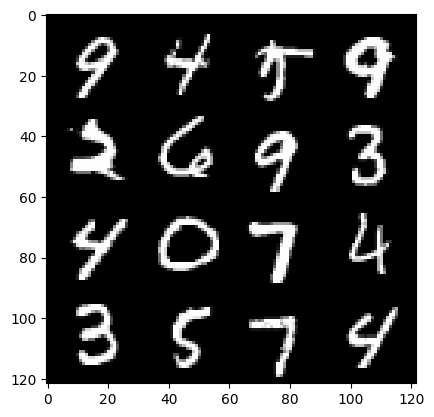

110: step 54300 / Gen loss: 1.948809341192246 / Disc loss: 0.28883412008484205


  0%|          | 0/469 [00:00<?, ?it/s]

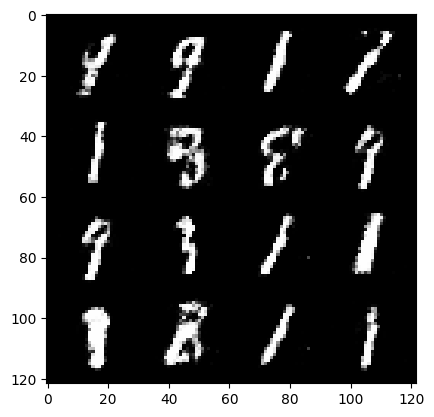

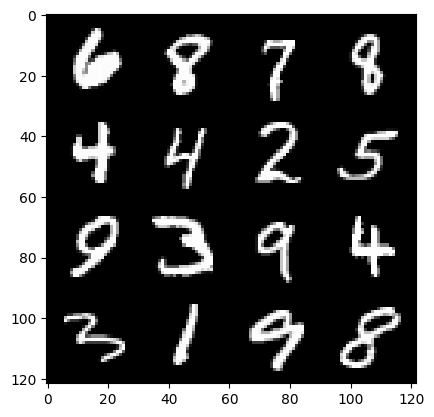

111: step 54600 / Gen loss: 2.0197253489494305 / Disc loss: 0.27960858543713885


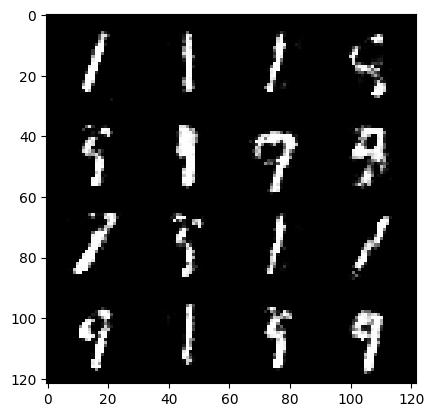

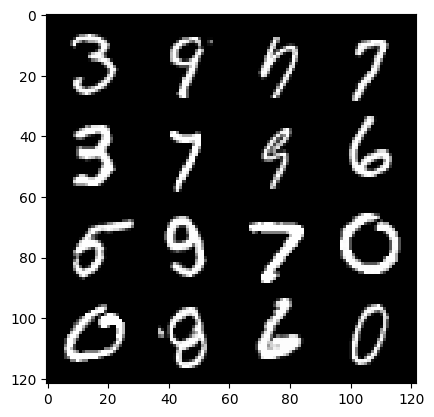

111: step 54900 / Gen loss: 1.965551383097966 / Disc loss: 0.28330079381664575


  0%|          | 0/469 [00:00<?, ?it/s]

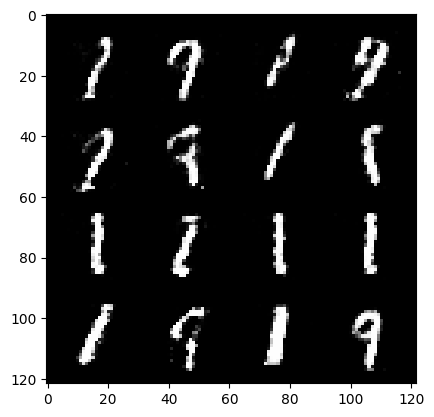

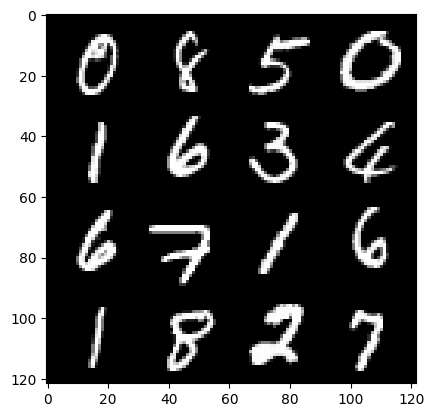

112: step 55200 / Gen loss: 1.8582549420992536 / Disc loss: 0.30454696883757926


  0%|          | 0/469 [00:00<?, ?it/s]

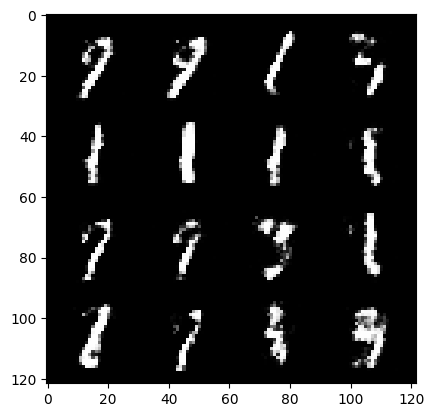

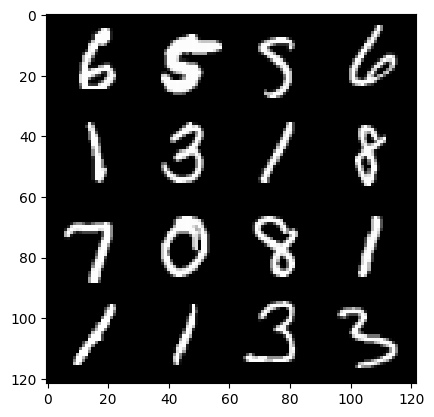

113: step 55500 / Gen loss: 1.9293089604377747 / Disc loss: 0.29548783322175337


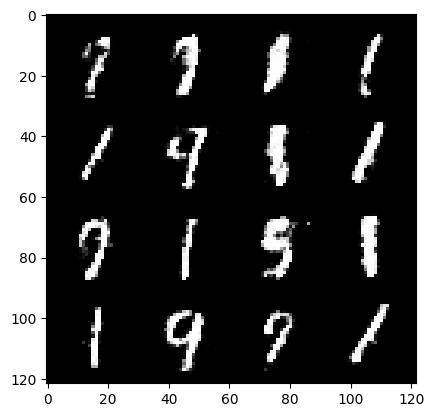

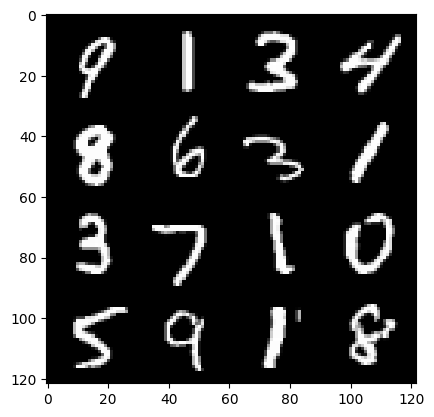

113: step 55800 / Gen loss: 1.9249492192268365 / Disc loss: 0.3003447364767395


  0%|          | 0/469 [00:00<?, ?it/s]

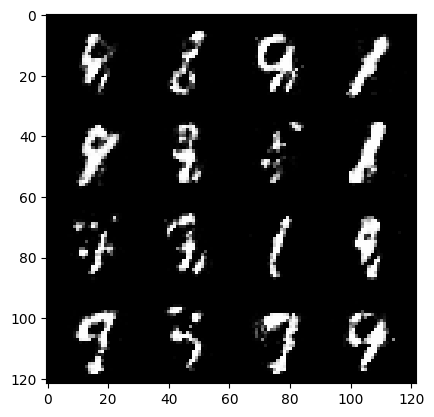

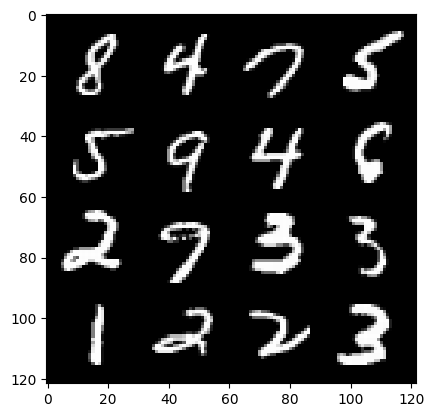

114: step 56100 / Gen loss: 1.868358266750972 / Disc loss: 0.3073687496284647


  0%|          | 0/469 [00:00<?, ?it/s]

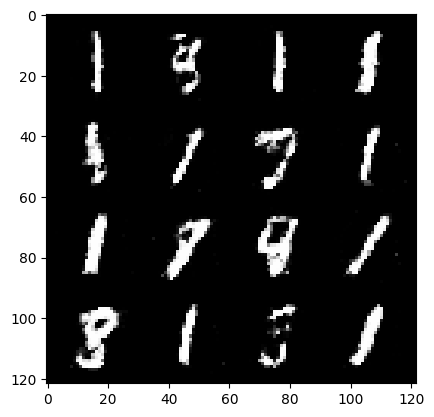

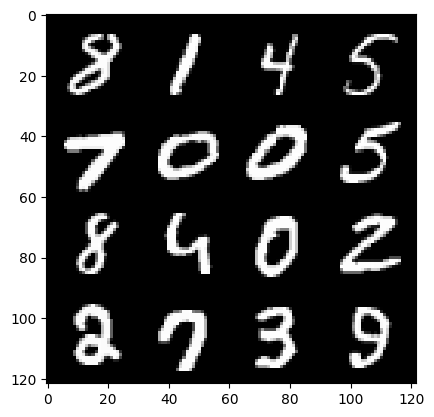

115: step 56400 / Gen loss: 1.8028975363572433 / Disc loss: 0.3293245109915735


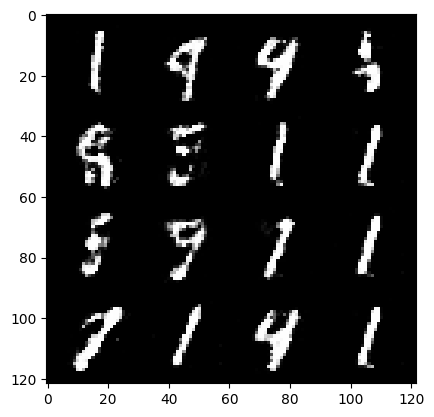

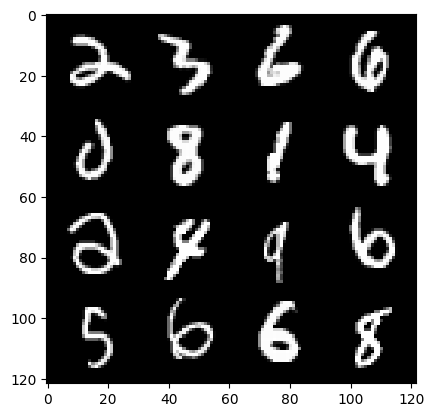

115: step 56700 / Gen loss: 1.8208819023768104 / Disc loss: 0.31825272351503386


  0%|          | 0/469 [00:00<?, ?it/s]

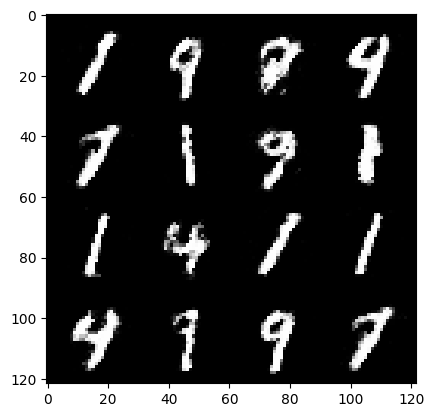

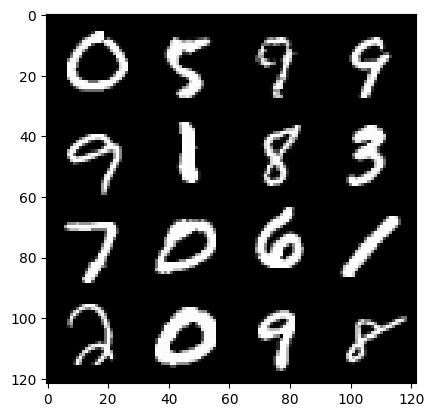

116: step 57000 / Gen loss: 1.855860062042872 / Disc loss: 0.3081288151443004


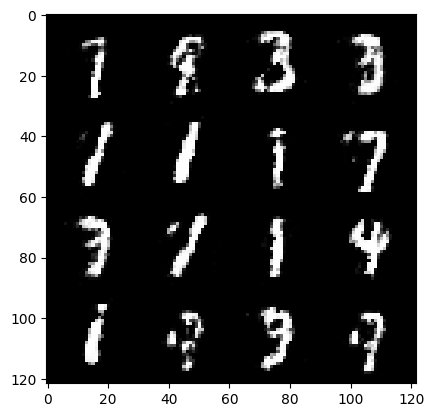

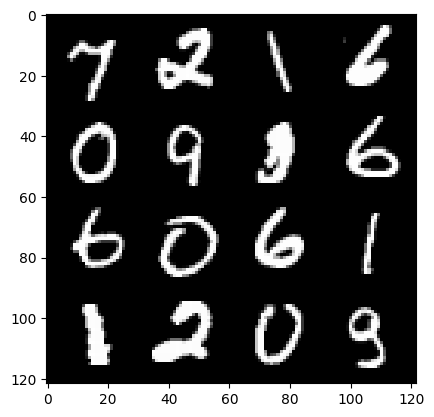

116: step 57300 / Gen loss: 1.8240104345480592 / Disc loss: 0.3304878453413643


  0%|          | 0/469 [00:00<?, ?it/s]

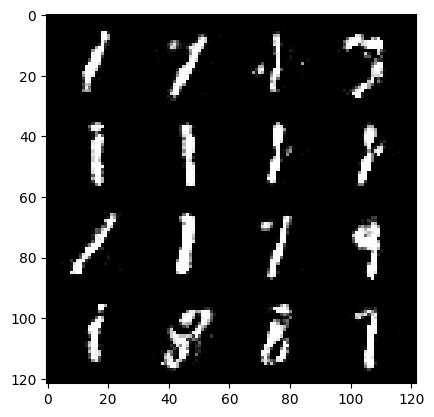

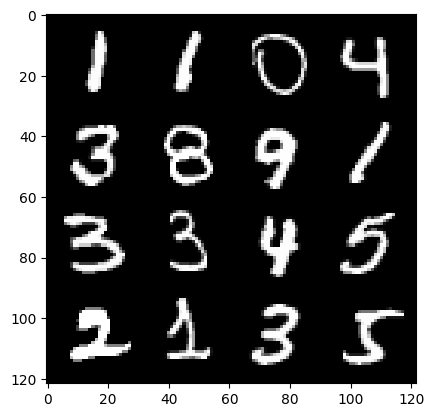

117: step 57600 / Gen loss: 1.8194583388169603 / Disc loss: 0.32292265077432014


  0%|          | 0/469 [00:00<?, ?it/s]

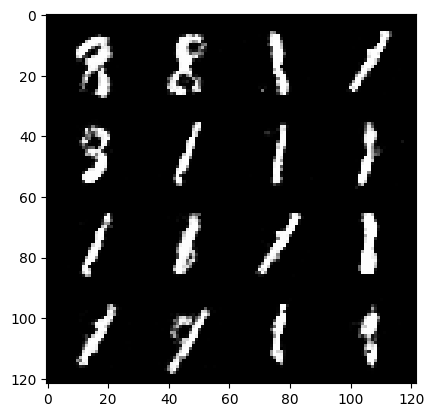

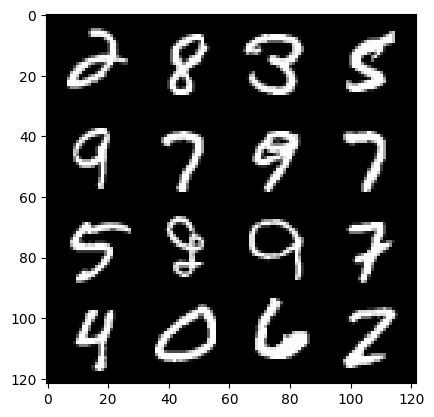

118: step 57900 / Gen loss: 1.8288661940892539 / Disc loss: 0.315562987079223


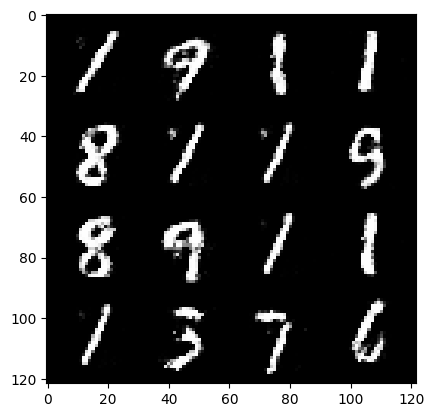

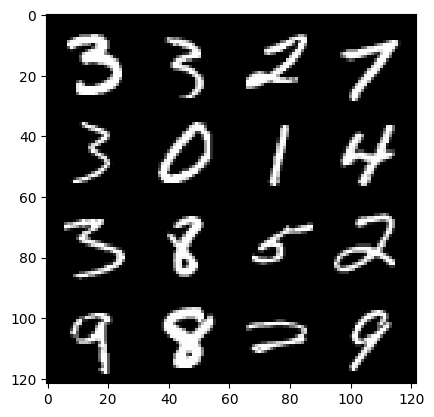

118: step 58200 / Gen loss: 1.8589687395095833 / Disc loss: 0.3125135939319928


  0%|          | 0/469 [00:00<?, ?it/s]

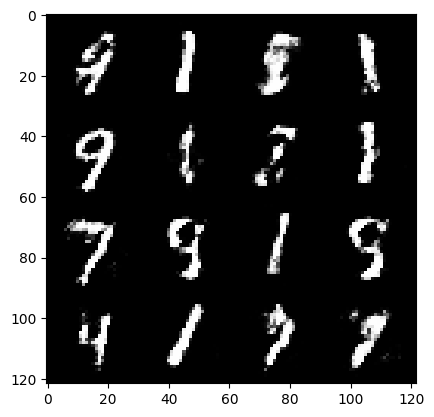

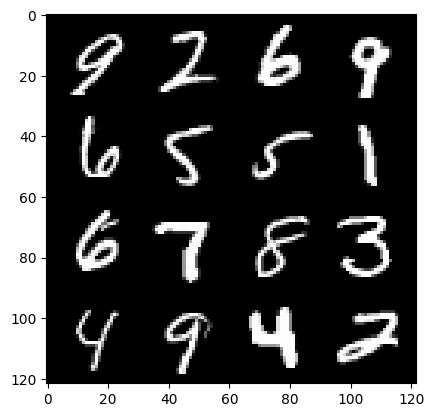

119: step 58500 / Gen loss: 1.796124960978826 / Disc loss: 0.324461831698815


  0%|          | 0/469 [00:00<?, ?it/s]

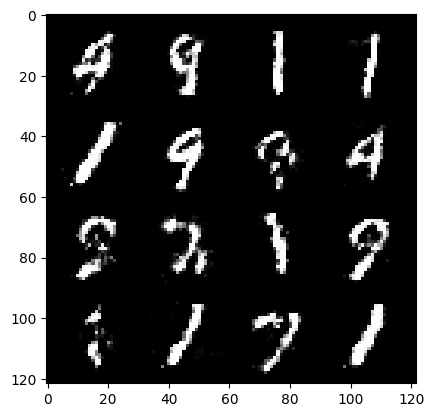

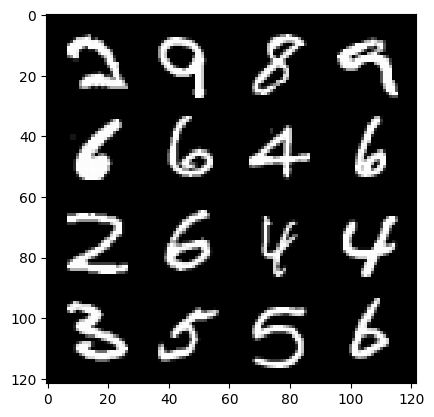

120: step 58800 / Gen loss: 1.7440351804097491 / Disc loss: 0.3449599296351272


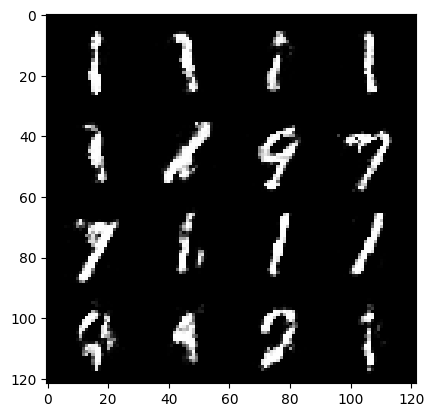

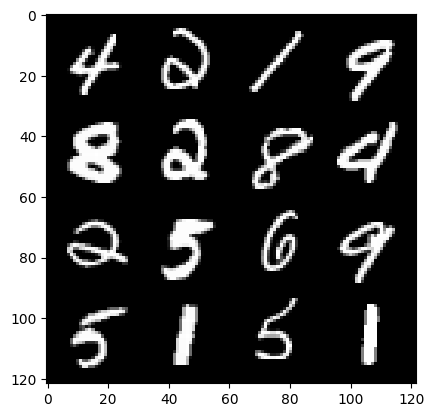

120: step 59100 / Gen loss: 1.7867140090465545 / Disc loss: 0.32131866539518017


  0%|          | 0/469 [00:00<?, ?it/s]

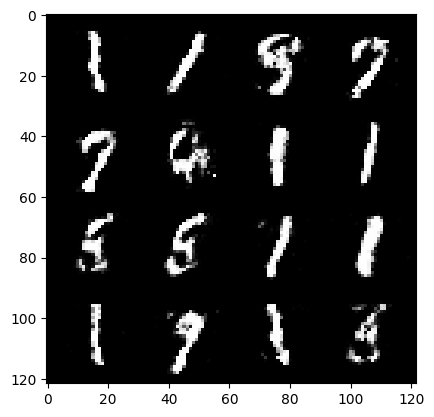

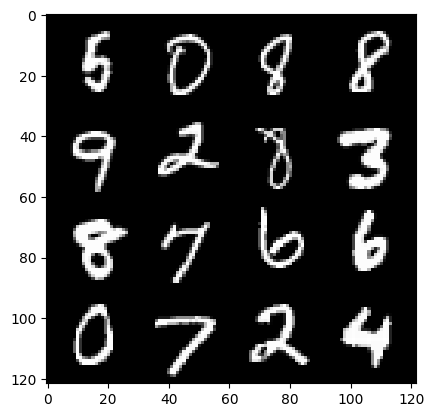

121: step 59400 / Gen loss: 1.784136075178783 / Disc loss: 0.32193420112133003


  0%|          | 0/469 [00:00<?, ?it/s]

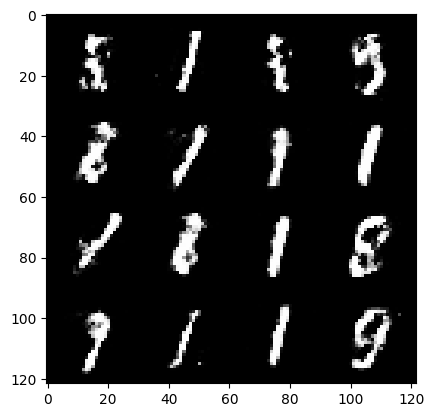

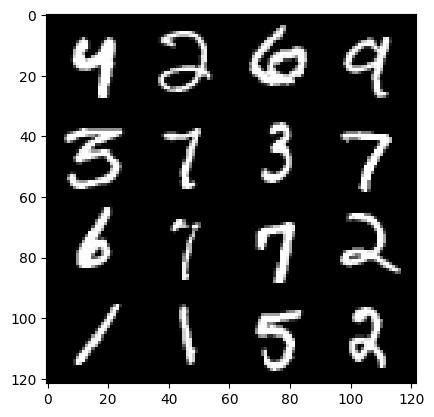

122: step 59700 / Gen loss: 1.7938285100460052 / Disc loss: 0.31993469104170796


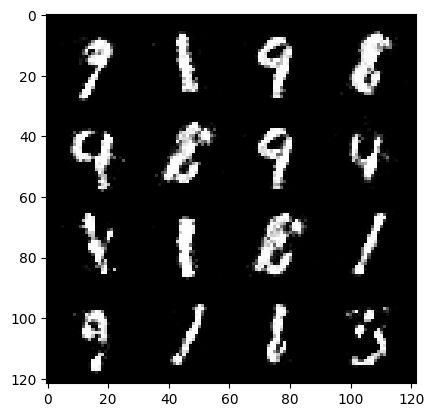

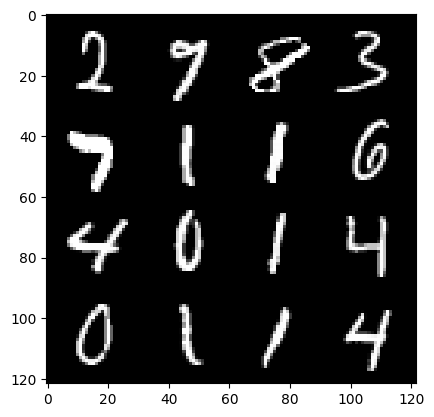

122: step 60000 / Gen loss: 1.7317682834466306 / Disc loss: 0.34059710755944234


  0%|          | 0/469 [00:00<?, ?it/s]

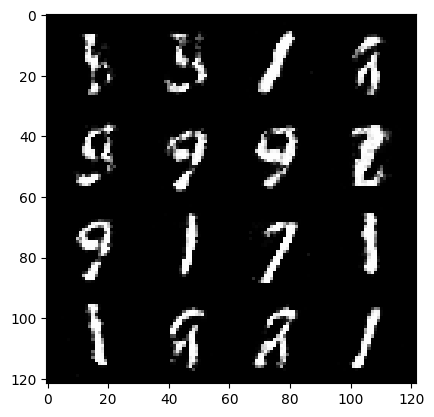

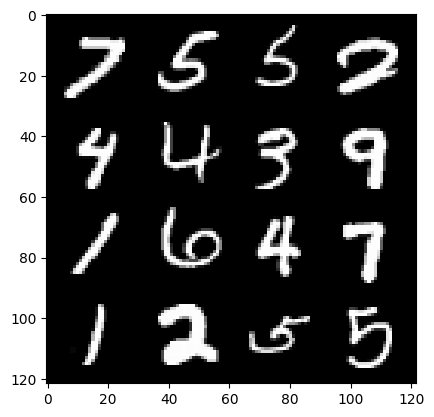

123: step 60300 / Gen loss: 1.741431794166564 / Disc loss: 0.33310247654716174


  0%|          | 0/469 [00:00<?, ?it/s]

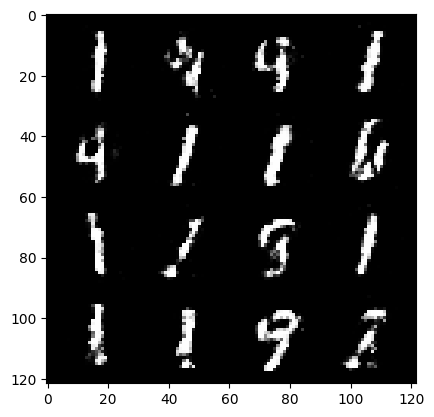

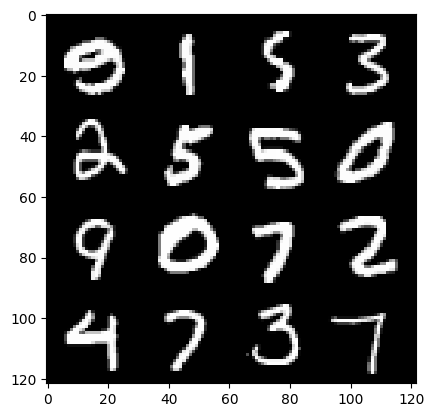

124: step 60600 / Gen loss: 1.7924195778369905 / Disc loss: 0.32408675392468744


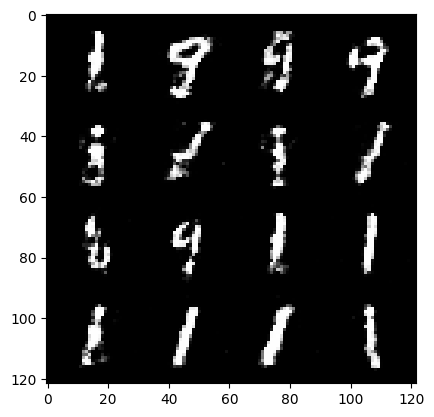

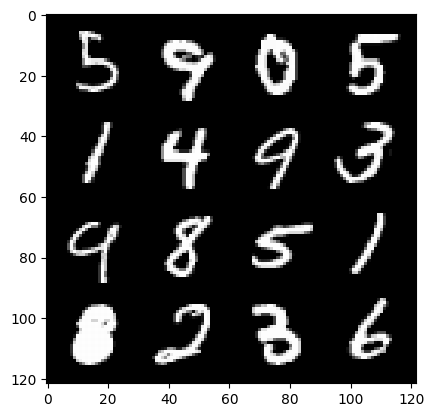

124: step 60900 / Gen loss: 1.844907867113749 / Disc loss: 0.3036634713908034


  0%|          | 0/469 [00:00<?, ?it/s]

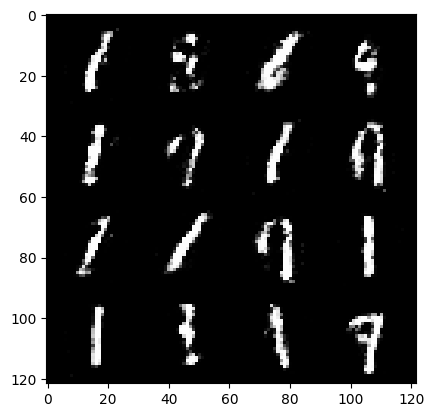

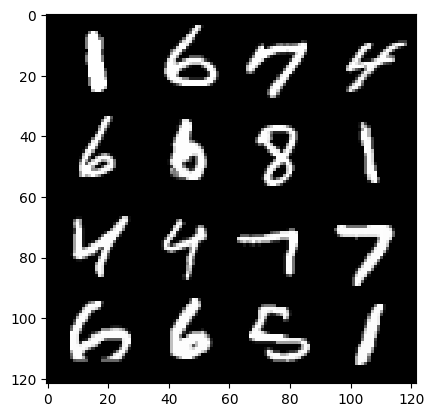

125: step 61200 / Gen loss: 1.732749346892038 / Disc loss: 0.33032105793555605


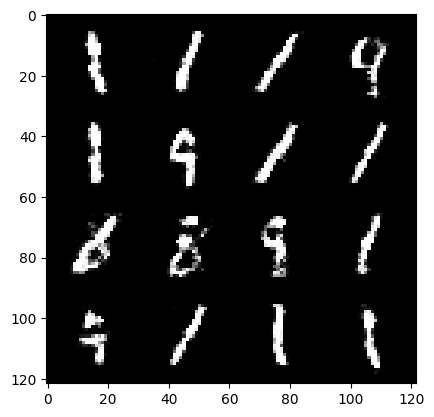

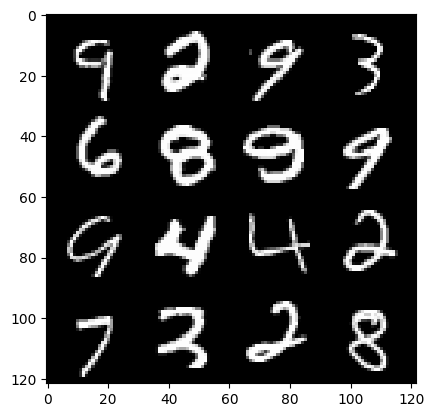

125: step 61500 / Gen loss: 1.7760630925496426 / Disc loss: 0.3116559828817842


  0%|          | 0/469 [00:00<?, ?it/s]

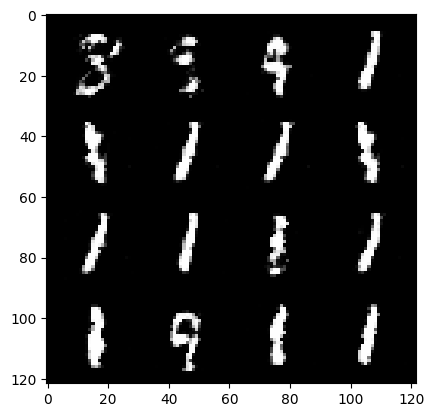

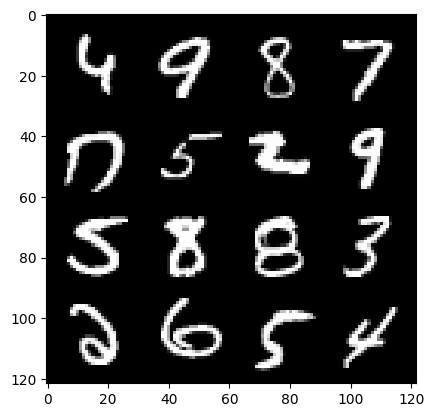

126: step 61800 / Gen loss: 1.8544410268465668 / Disc loss: 0.3154095327357453


  0%|          | 0/469 [00:00<?, ?it/s]

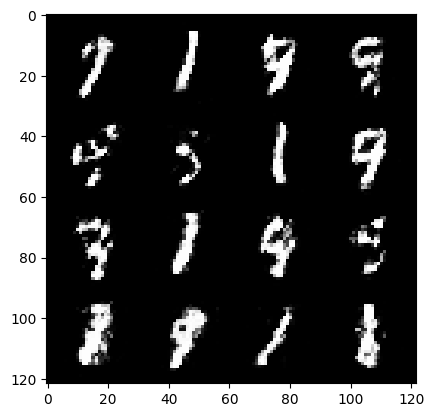

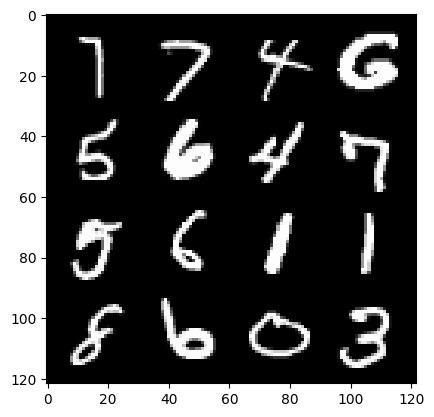

127: step 62100 / Gen loss: 1.8901456375916792 / Disc loss: 0.2997911516328654


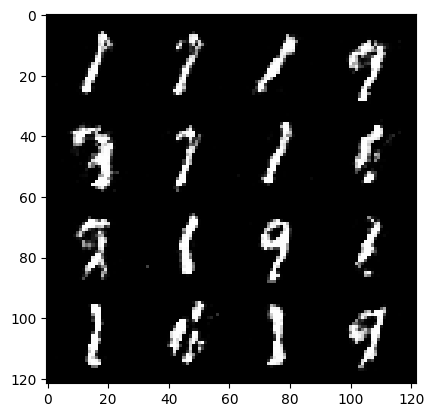

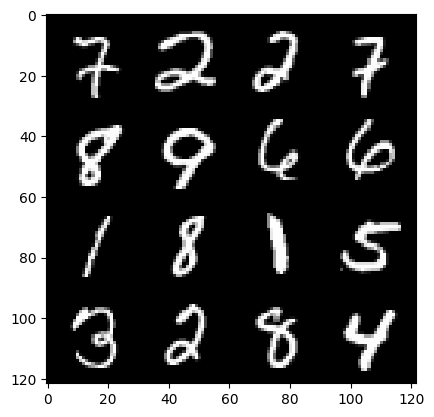

127: step 62400 / Gen loss: 1.82861401995023 / Disc loss: 0.31317878420154255


  0%|          | 0/469 [00:00<?, ?it/s]

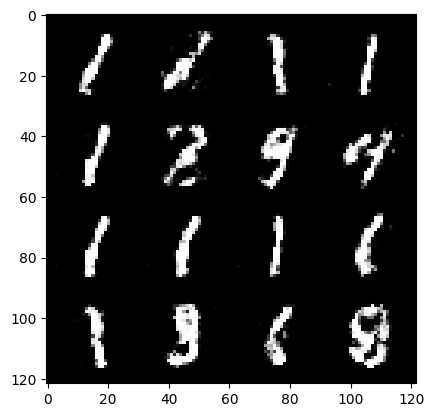

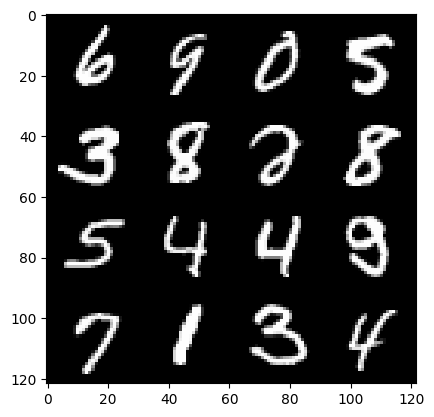

128: step 62700 / Gen loss: 1.8939479641119634 / Disc loss: 0.2978532467782498


  0%|          | 0/469 [00:00<?, ?it/s]

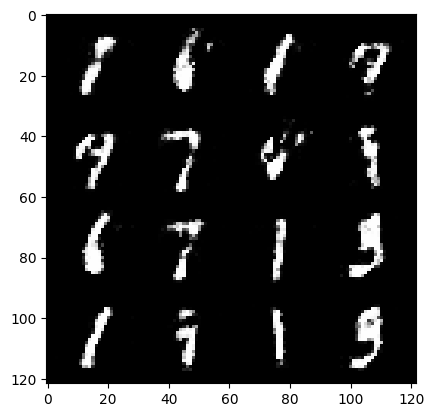

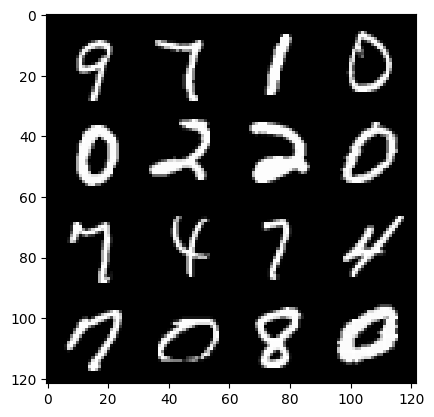

129: step 63000 / Gen loss: 1.8885969813664745 / Disc loss: 0.30824469427267714


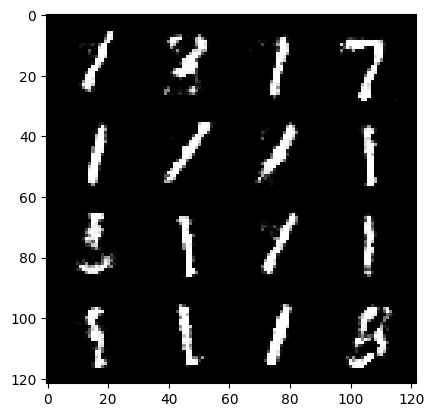

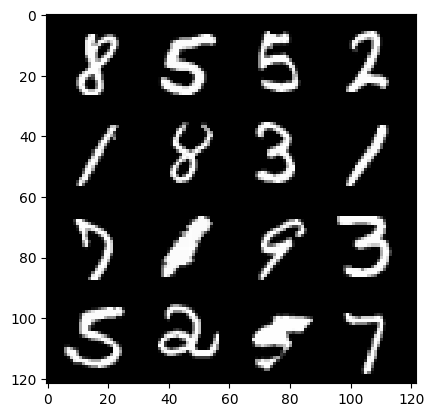

129: step 63300 / Gen loss: 1.8863927682240809 / Disc loss: 0.30765400499105466


  0%|          | 0/469 [00:00<?, ?it/s]

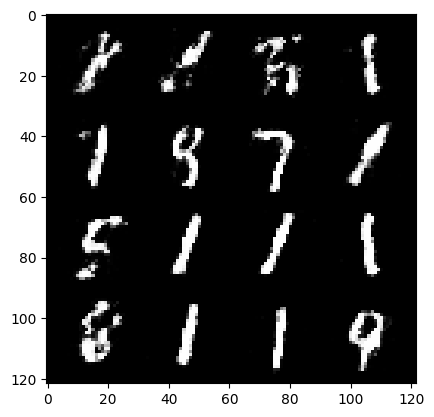

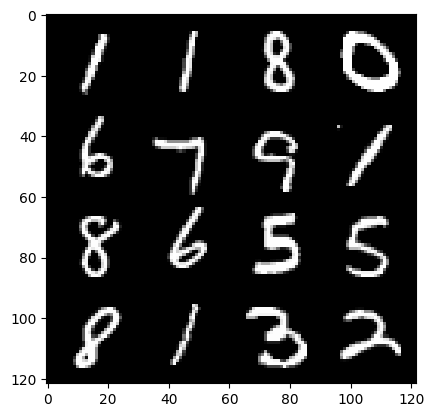

130: step 63600 / Gen loss: 1.8266646508375792 / Disc loss: 0.322255922704935


  0%|          | 0/469 [00:00<?, ?it/s]

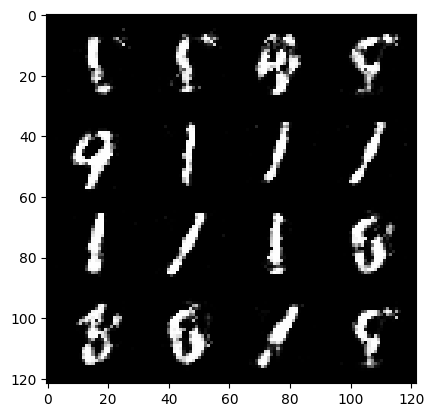

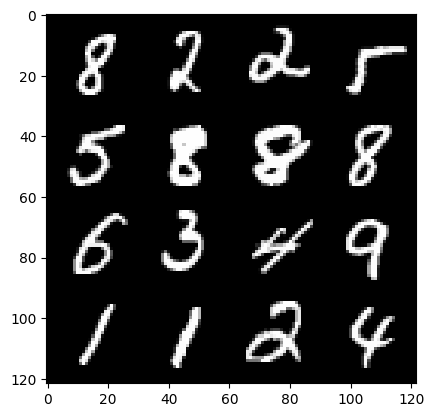

131: step 63900 / Gen loss: 1.7422277311484018 / Disc loss: 0.33820828706026107


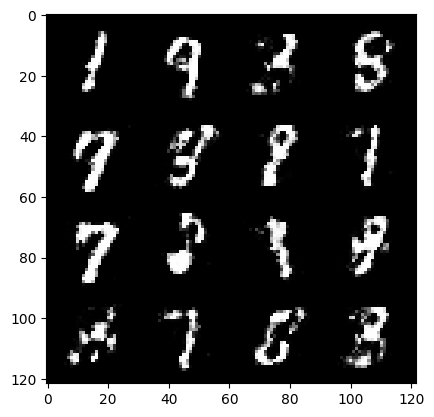

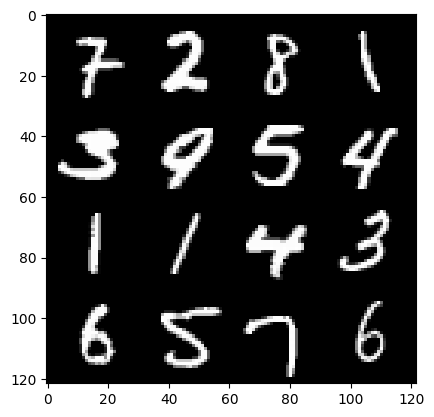

131: step 64200 / Gen loss: 1.820293884277343 / Disc loss: 0.3083540069560209


  0%|          | 0/469 [00:00<?, ?it/s]

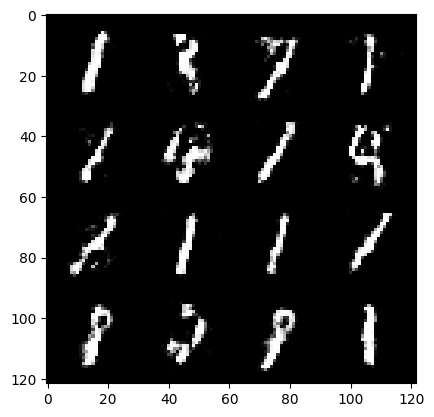

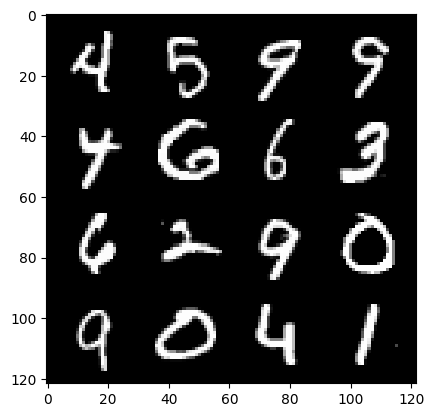

132: step 64500 / Gen loss: 1.7045807460943856 / Disc loss: 0.3378015881776812


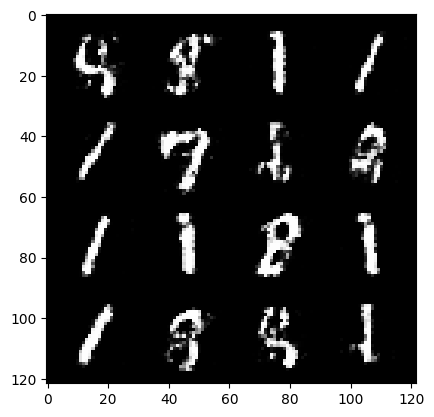

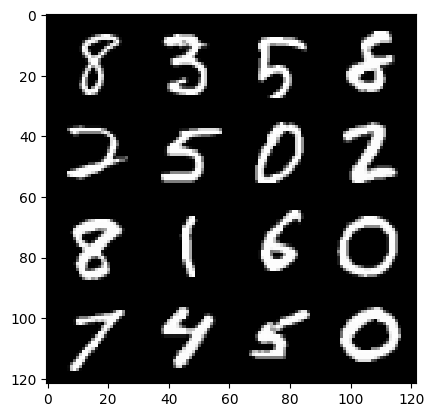

132: step 64800 / Gen loss: 1.7487390542030348 / Disc loss: 0.3303296439846353


  0%|          | 0/469 [00:00<?, ?it/s]

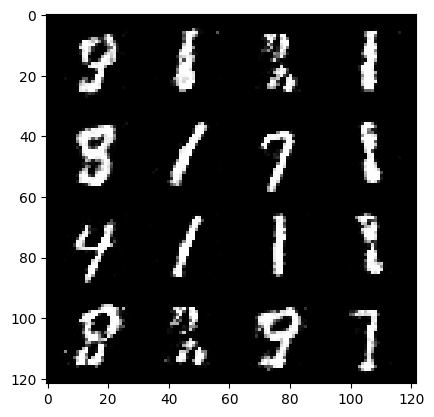

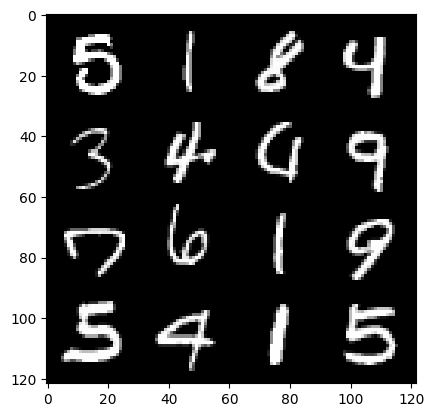

133: step 65100 / Gen loss: 1.7714629065990453 / Disc loss: 0.33301085511843337


  0%|          | 0/469 [00:00<?, ?it/s]

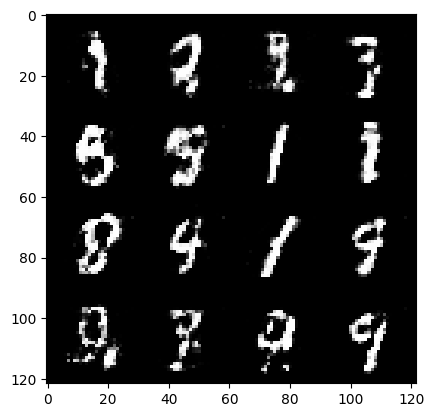

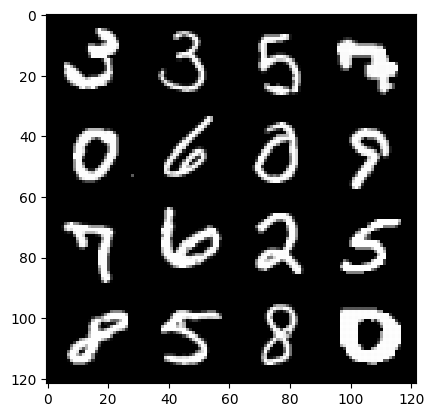

134: step 65400 / Gen loss: 1.7463536985715225 / Disc loss: 0.3337755775451661


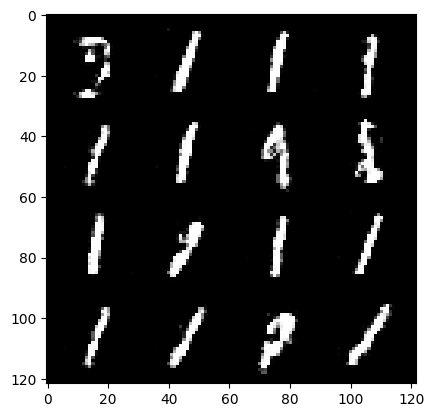

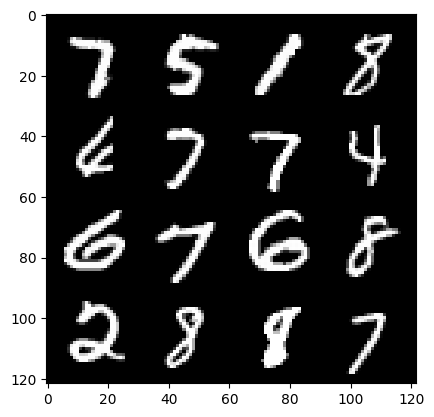

134: step 65700 / Gen loss: 1.7169522992769872 / Disc loss: 0.33920421501000725


  0%|          | 0/469 [00:00<?, ?it/s]

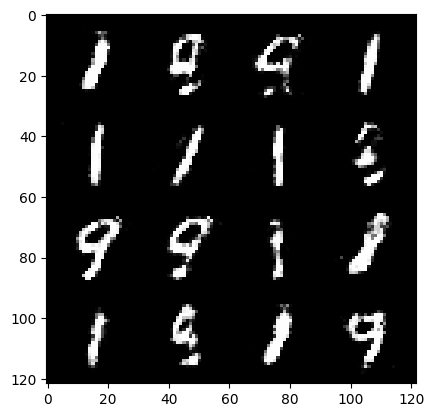

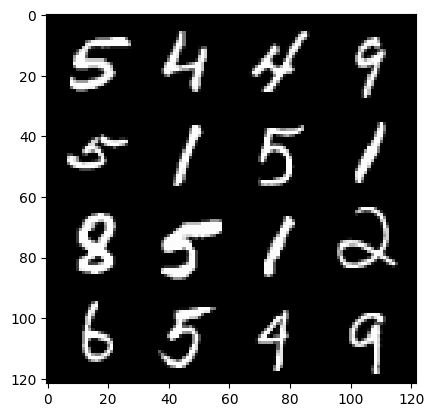

135: step 66000 / Gen loss: 1.737320698897044 / Disc loss: 0.3348576029638449


  0%|          | 0/469 [00:00<?, ?it/s]

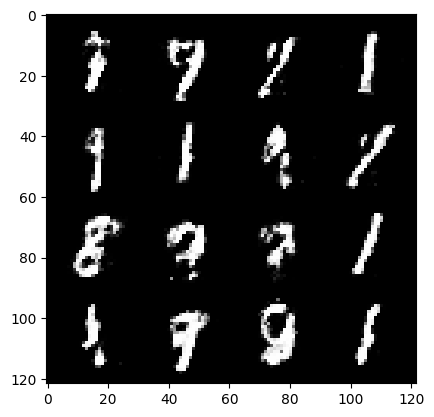

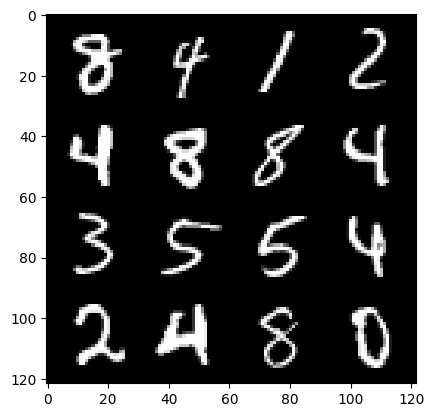

136: step 66300 / Gen loss: 1.7060074945290877 / Disc loss: 0.3340400561690329


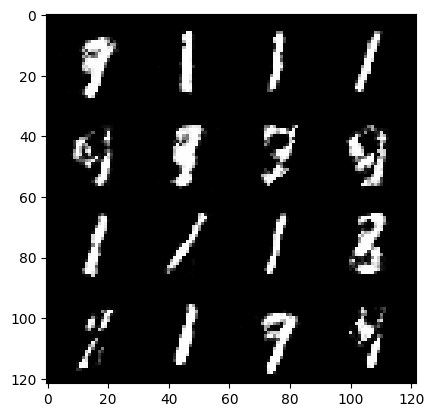

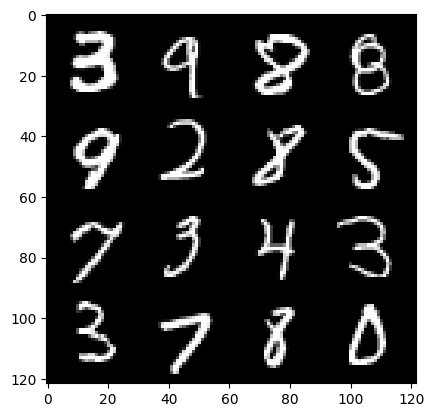

136: step 66600 / Gen loss: 1.7288637113571188 / Disc loss: 0.33513616770505916


  0%|          | 0/469 [00:00<?, ?it/s]

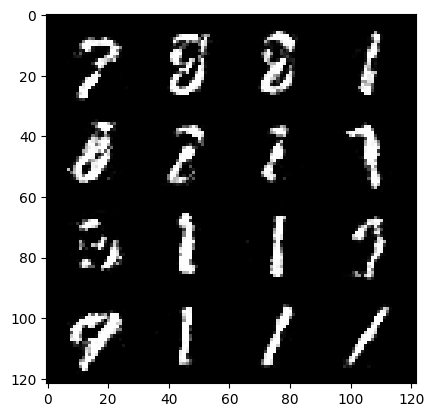

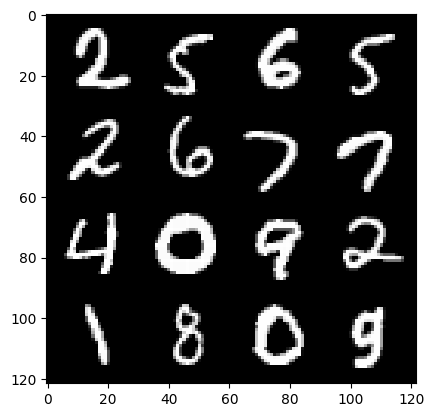

137: step 66900 / Gen loss: 1.6785428297519691 / Disc loss: 0.3494230262438458


  0%|          | 0/469 [00:00<?, ?it/s]

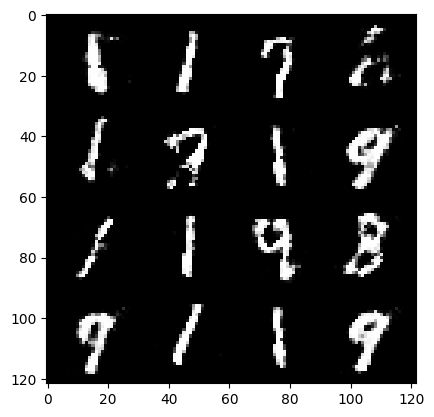

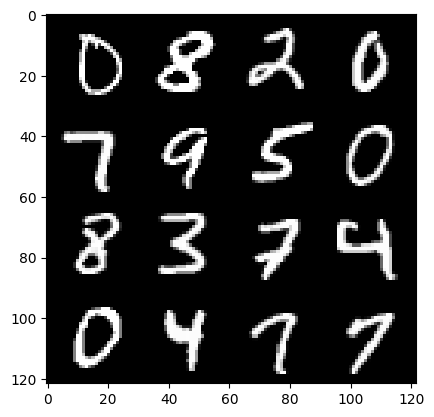

138: step 67200 / Gen loss: 1.6643276548385617 / Disc loss: 0.35405907193819675


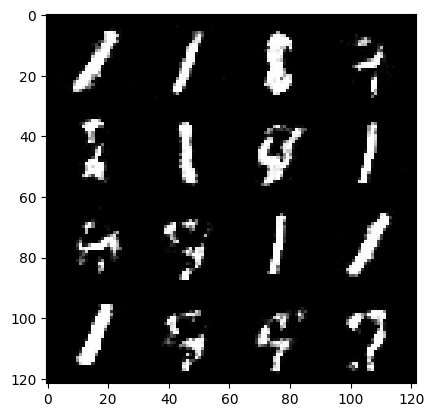

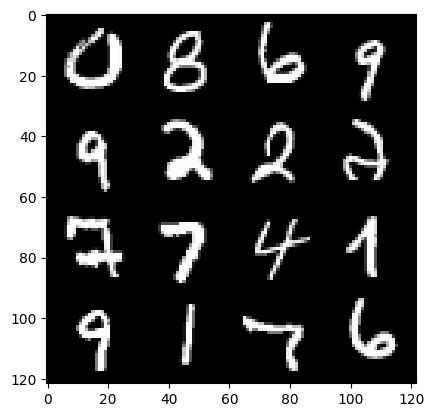

138: step 67500 / Gen loss: 1.6404587205251062 / Disc loss: 0.36451193432013196


  0%|          | 0/469 [00:00<?, ?it/s]

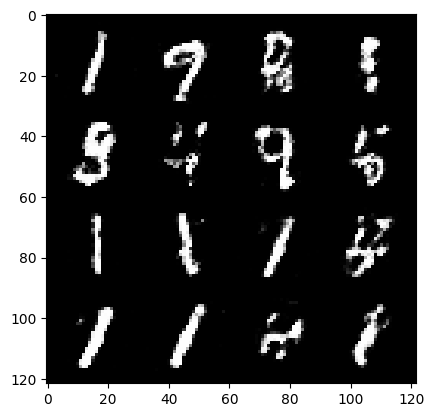

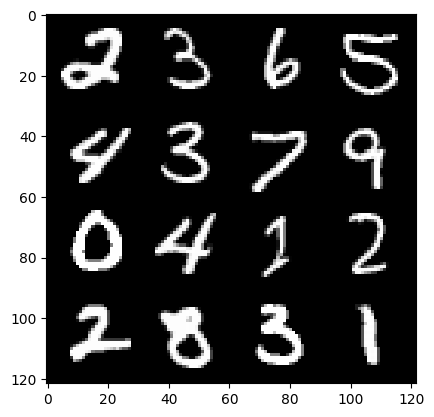

139: step 67800 / Gen loss: 1.672900556325913 / Disc loss: 0.3451079884668191


  0%|          | 0/469 [00:00<?, ?it/s]

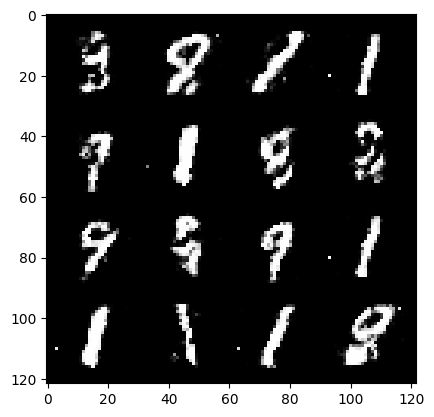

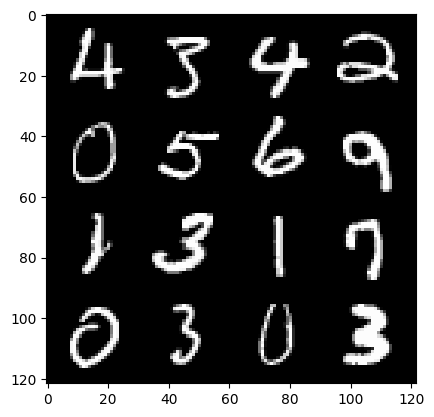

140: step 68100 / Gen loss: 1.636526546875636 / Disc loss: 0.36844706505537045


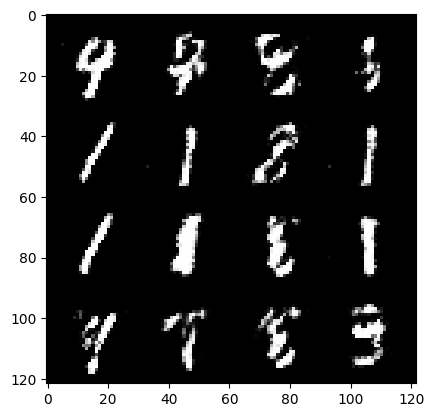

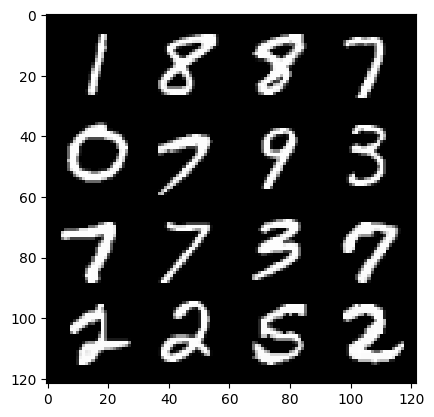

140: step 68400 / Gen loss: 1.6800420097510003 / Disc loss: 0.34270122393965713


  0%|          | 0/469 [00:00<?, ?it/s]

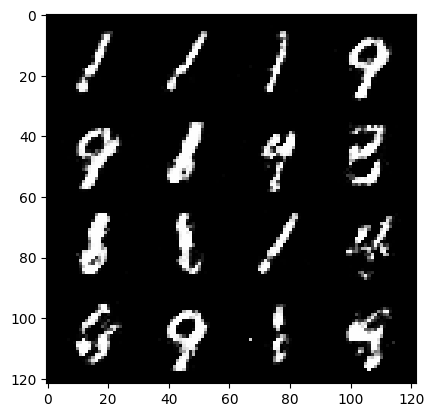

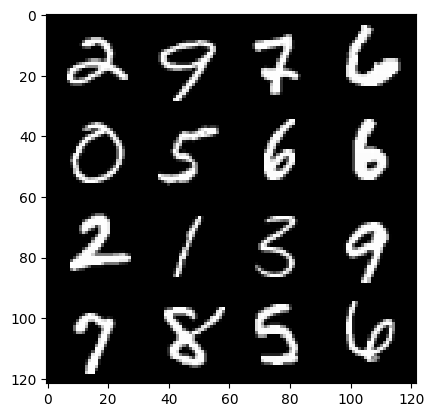

141: step 68700 / Gen loss: 1.6719254374504102 / Disc loss: 0.3324079352617263


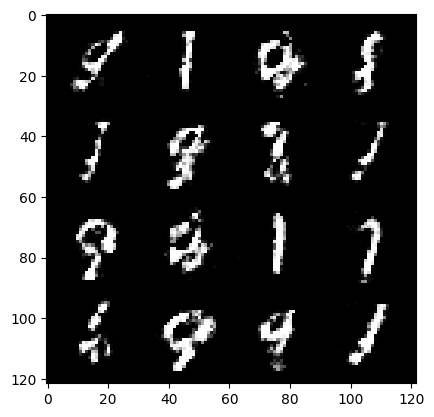

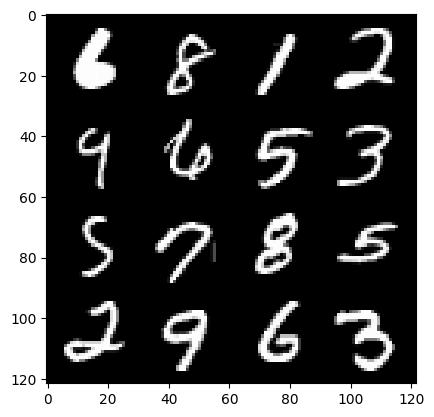

141: step 69000 / Gen loss: 1.7007193466027564 / Disc loss: 0.3408023334542913


  0%|          | 0/469 [00:00<?, ?it/s]

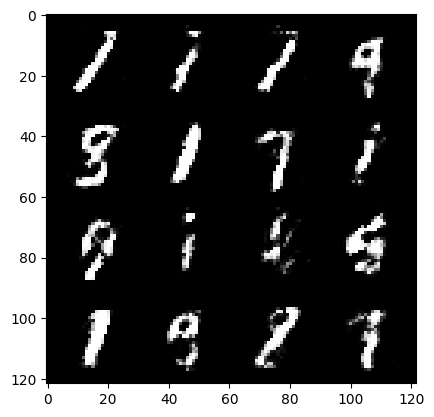

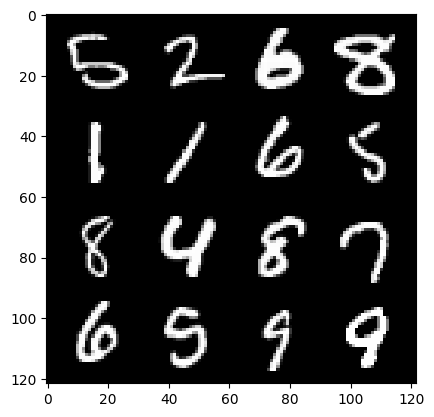

142: step 69300 / Gen loss: 1.7054126838843027 / Disc loss: 0.33372801279028236


  0%|          | 0/469 [00:00<?, ?it/s]

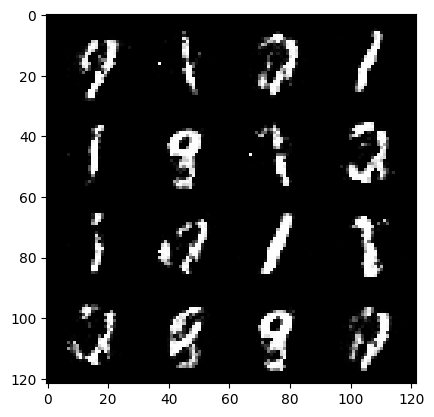

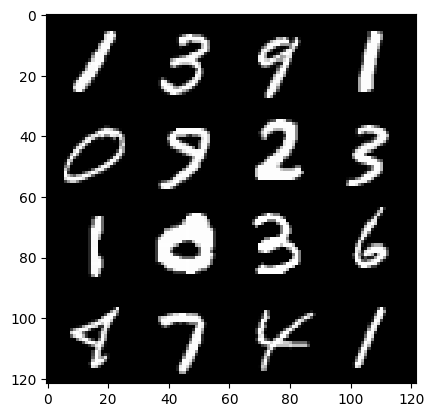

143: step 69600 / Gen loss: 1.6780699547131863 / Disc loss: 0.34951958323518406


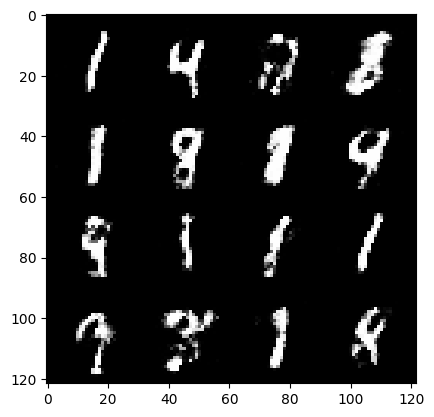

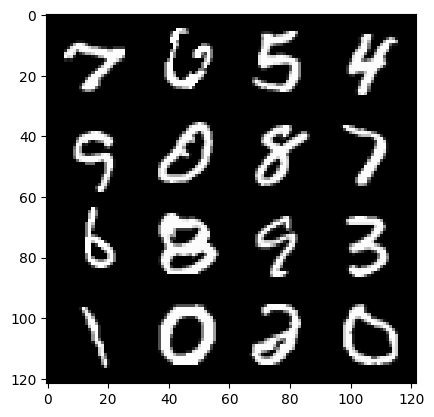

143: step 69900 / Gen loss: 1.6653719969590517 / Disc loss: 0.3385157632331055


  0%|          | 0/469 [00:00<?, ?it/s]

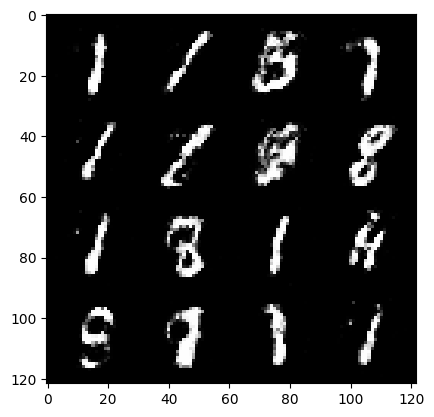

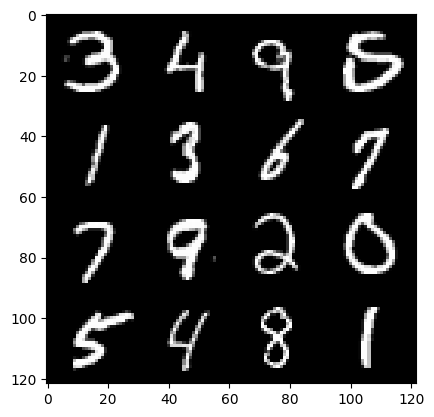

144: step 70200 / Gen loss: 1.6257826236883803 / Disc loss: 0.363546798725923


  0%|          | 0/469 [00:00<?, ?it/s]

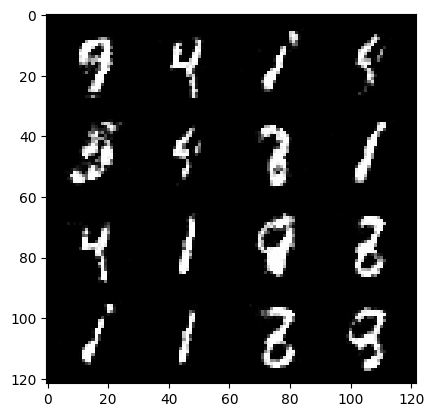

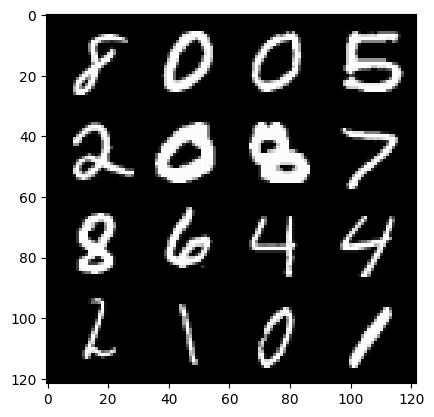

145: step 70500 / Gen loss: 1.6345215090115863 / Disc loss: 0.3455410971740885


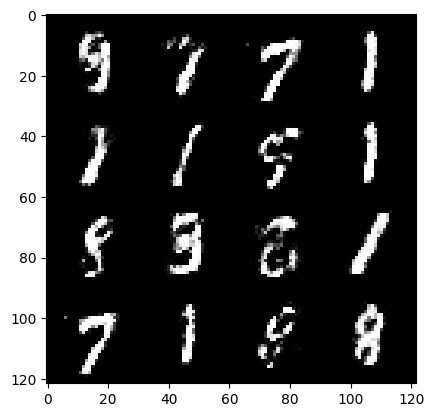

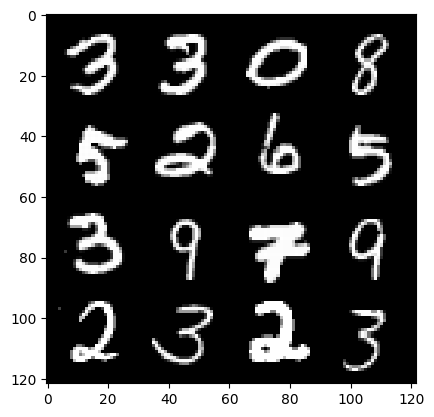

145: step 70800 / Gen loss: 1.6746746464570372 / Disc loss: 0.33905937562386185


  0%|          | 0/469 [00:00<?, ?it/s]

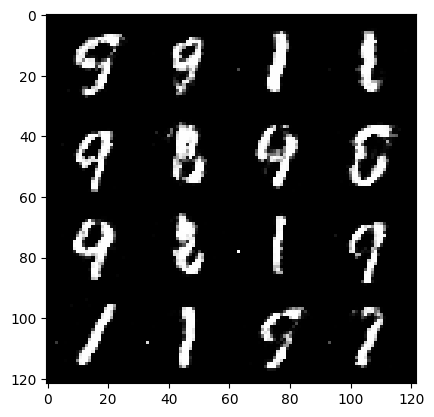

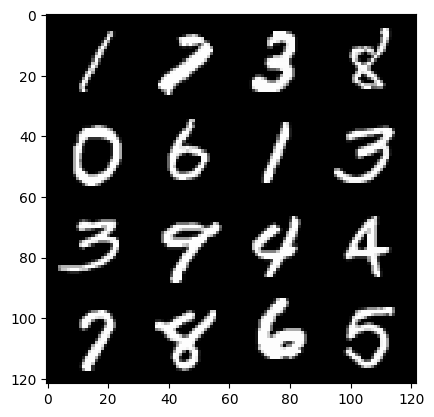

146: step 71100 / Gen loss: 1.6005746980508175 / Disc loss: 0.36867218265930807


  0%|          | 0/469 [00:00<?, ?it/s]

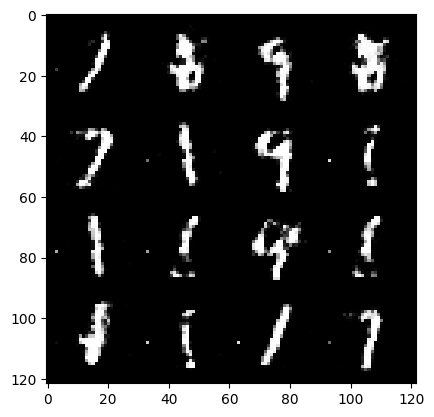

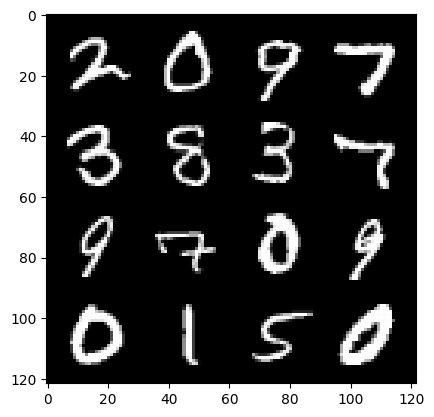

147: step 71400 / Gen loss: 1.6224813111623126 / Disc loss: 0.35936031838258103


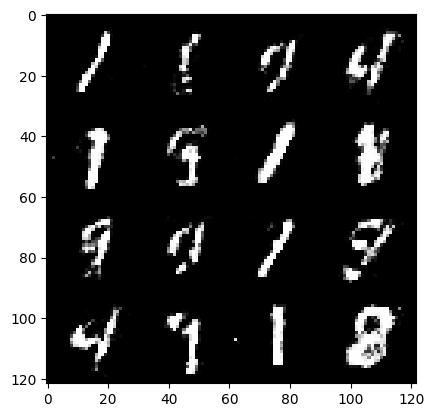

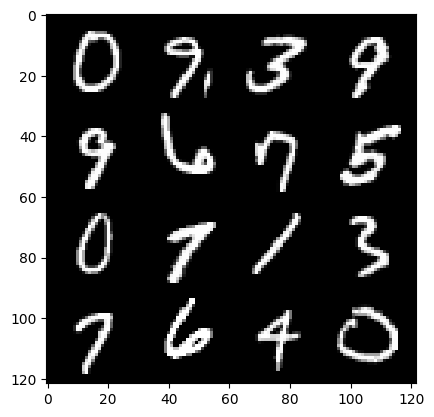

147: step 71700 / Gen loss: 1.635931003491084 / Disc loss: 0.35491814633210483


  0%|          | 0/469 [00:00<?, ?it/s]

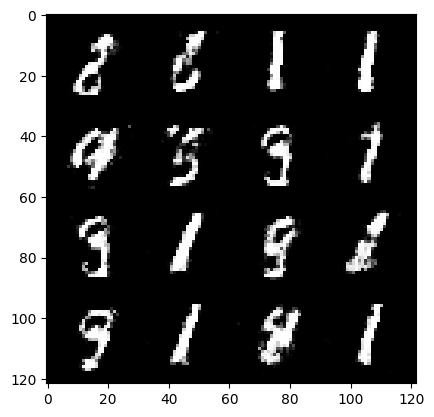

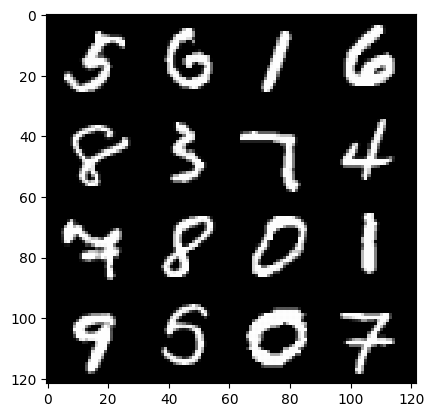

148: step 72000 / Gen loss: 1.6718003050486268 / Disc loss: 0.3467118326326209


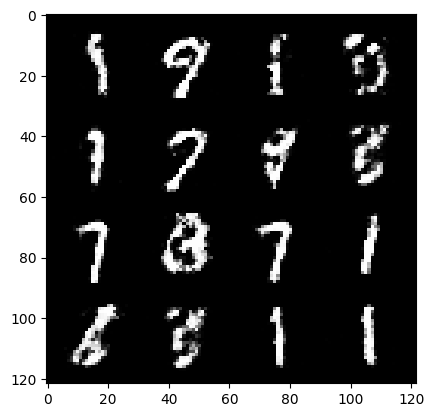

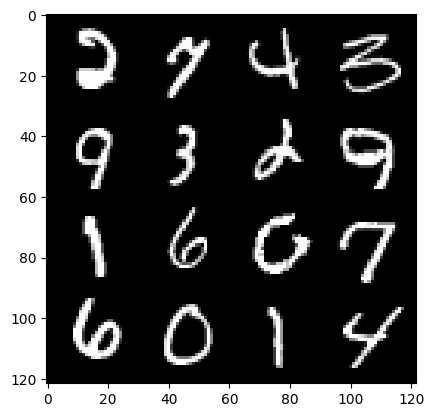

148: step 72300 / Gen loss: 1.6440573227405555 / Disc loss: 0.3485215631624062


  0%|          | 0/469 [00:00<?, ?it/s]

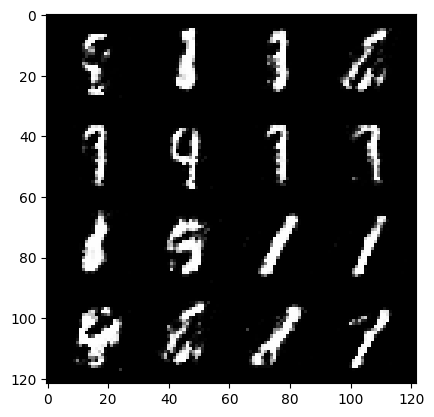

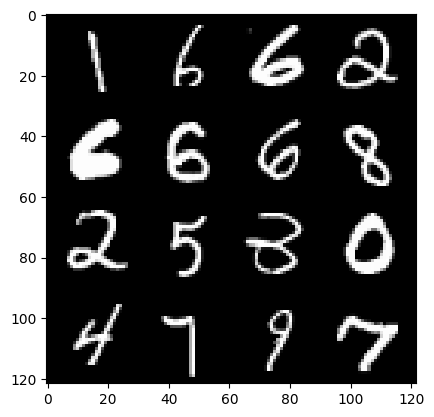

149: step 72600 / Gen loss: 1.5855303668975824 / Disc loss: 0.36678056975205736


  0%|          | 0/469 [00:00<?, ?it/s]

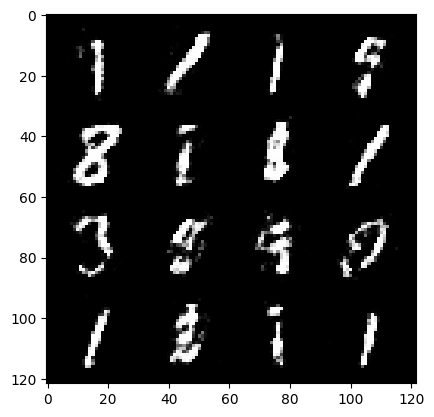

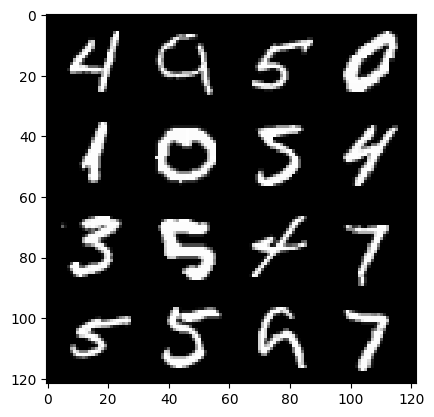

150: step 72900 / Gen loss: 1.59034659107526 / Disc loss: 0.35994786322116834


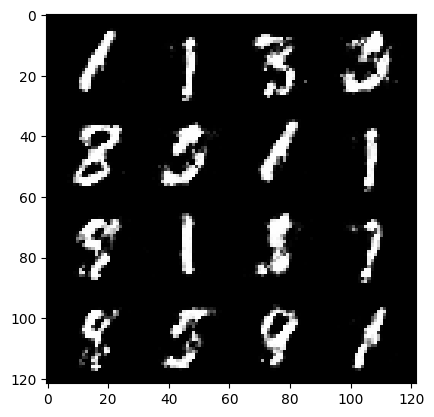

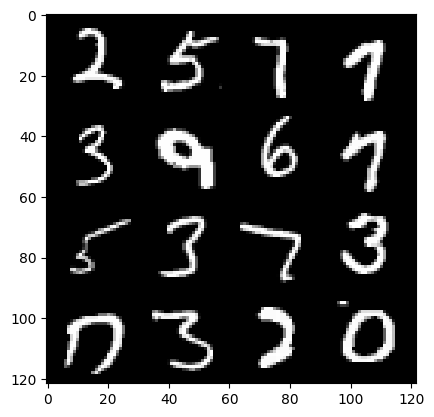

150: step 73200 / Gen loss: 1.6214498655001315 / Disc loss: 0.35546542952458055


  0%|          | 0/469 [00:00<?, ?it/s]

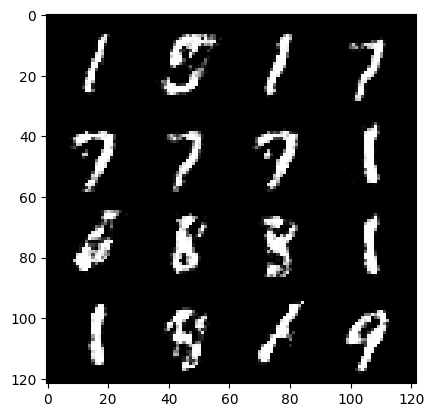

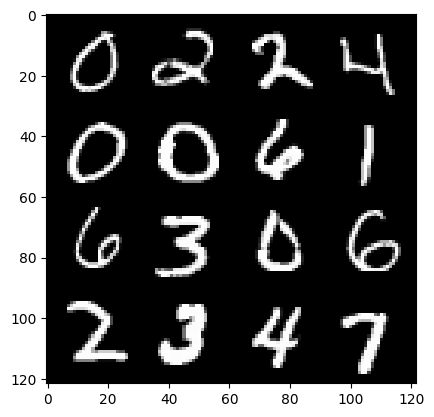

151: step 73500 / Gen loss: 1.6234672772884375 / Disc loss: 0.36101835856835035


  0%|          | 0/469 [00:00<?, ?it/s]

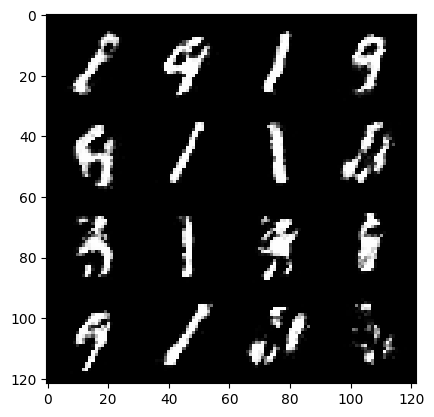

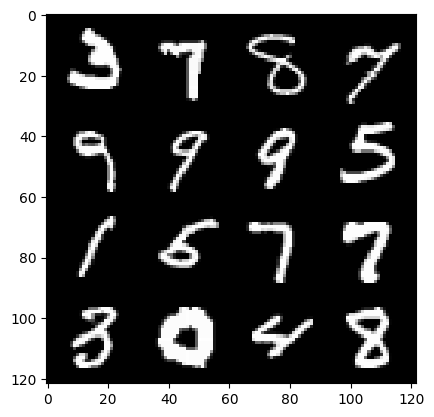

152: step 73800 / Gen loss: 1.6300827117760985 / Disc loss: 0.3613568335771559


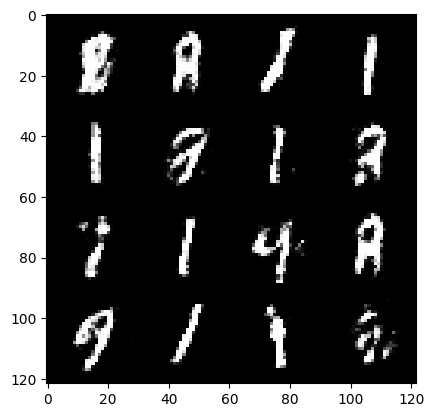

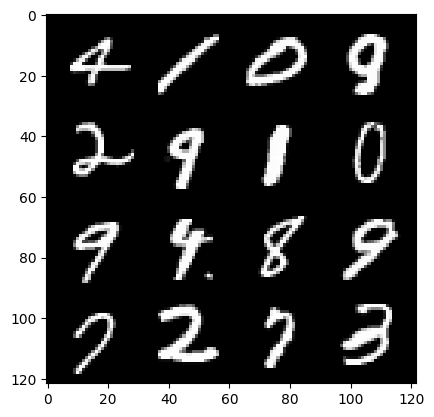

152: step 74100 / Gen loss: 1.5956168631712595 / Disc loss: 0.36613736848036443


  0%|          | 0/469 [00:00<?, ?it/s]

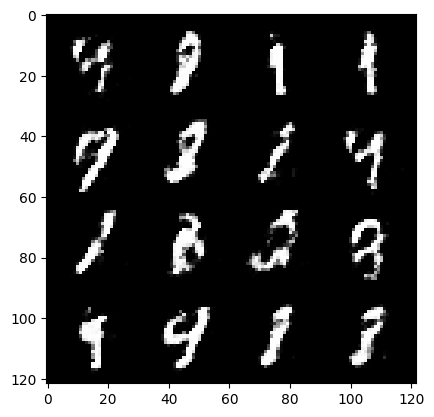

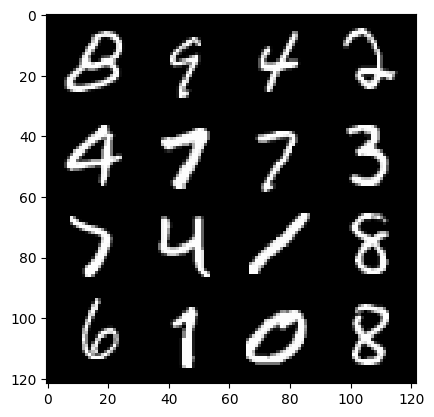

153: step 74400 / Gen loss: 1.5792332883675892 / Disc loss: 0.36426848570505793


  0%|          | 0/469 [00:00<?, ?it/s]

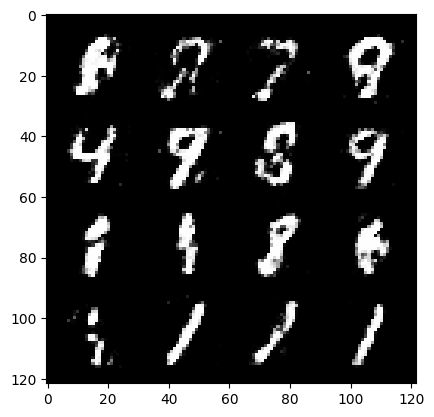

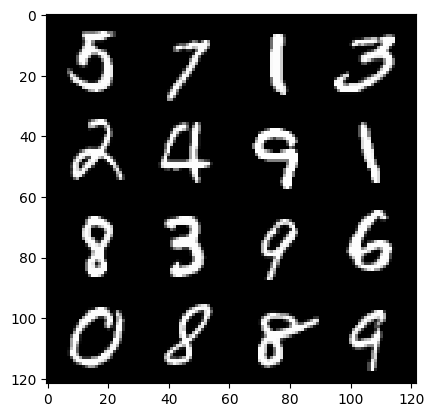

154: step 74700 / Gen loss: 1.5455204077561693 / Disc loss: 0.3793359688917796


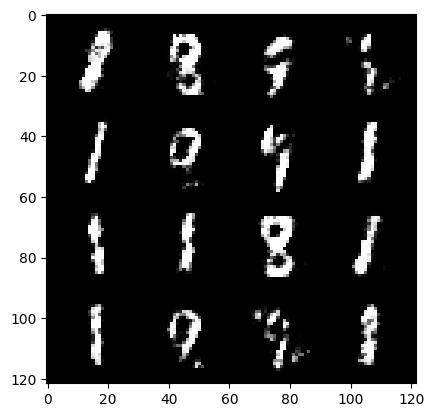

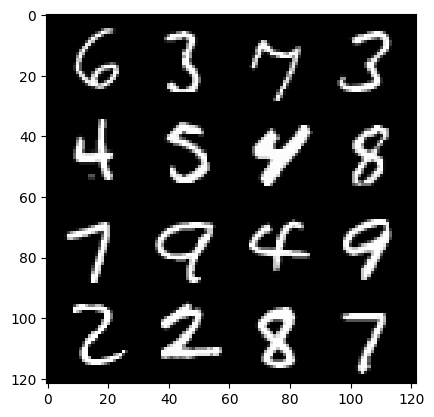

154: step 75000 / Gen loss: 1.5819845346609758 / Disc loss: 0.3615634459257126


  0%|          | 0/469 [00:00<?, ?it/s]

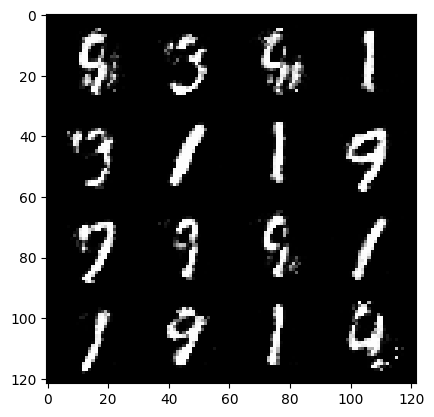

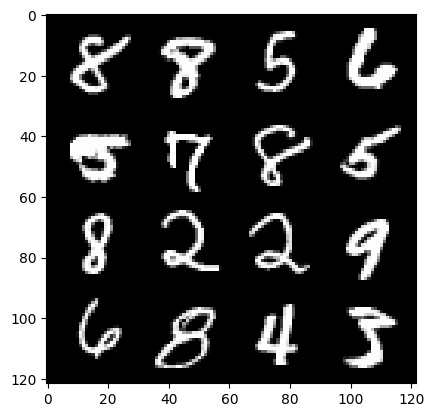

155: step 75300 / Gen loss: 1.6167656632264473 / Disc loss: 0.3689190556605656


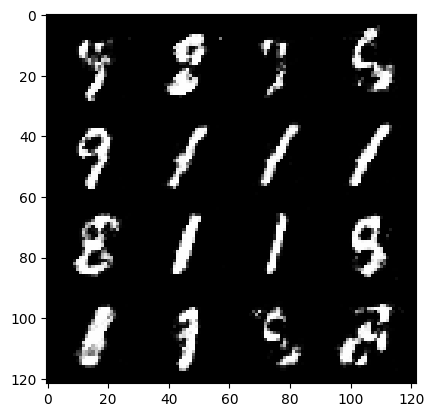

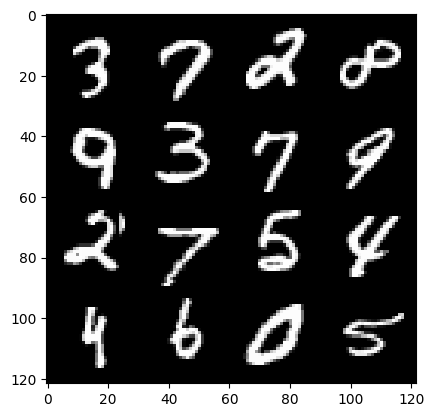

155: step 75600 / Gen loss: 1.6262746636072778 / Disc loss: 0.3533852768937746


  0%|          | 0/469 [00:00<?, ?it/s]

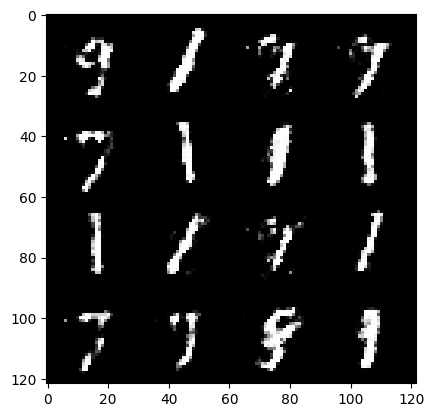

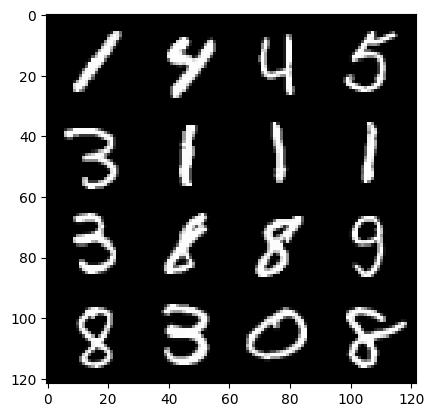

156: step 75900 / Gen loss: 1.5896757511297865 / Disc loss: 0.36265421022971456


  0%|          | 0/469 [00:00<?, ?it/s]

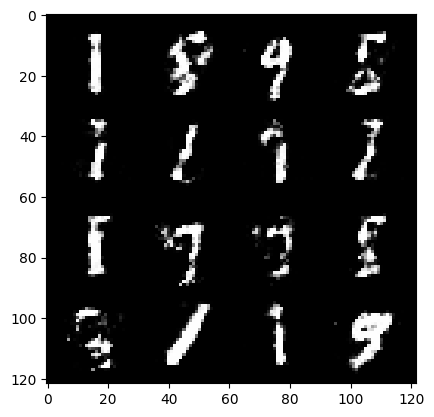

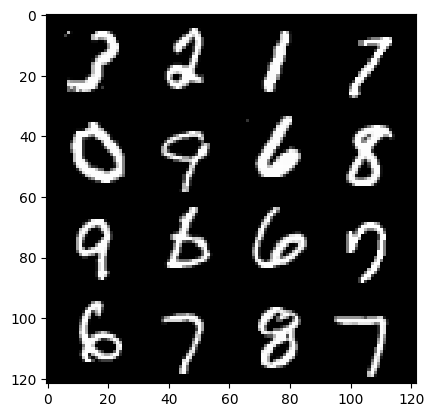

157: step 76200 / Gen loss: 1.5752166378498074 / Disc loss: 0.36731084098418565


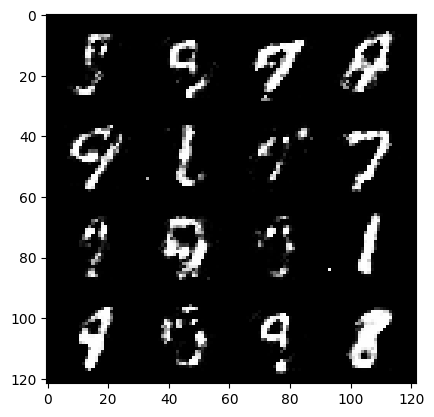

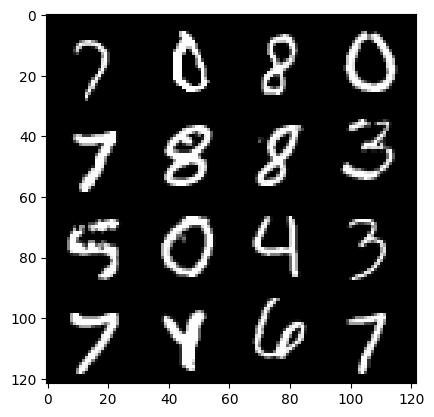

157: step 76500 / Gen loss: 1.545579403241476 / Disc loss: 0.3799293773372965


  0%|          | 0/469 [00:00<?, ?it/s]

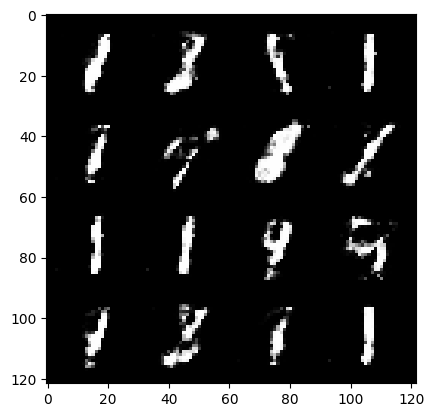

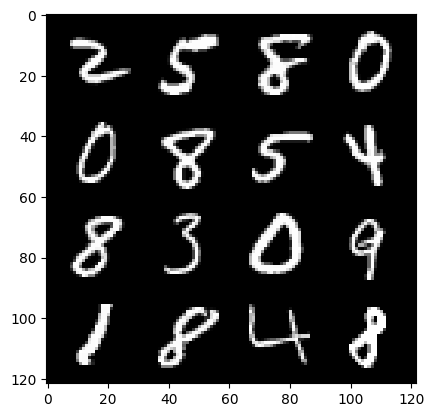

158: step 76800 / Gen loss: 1.588615418672561 / Disc loss: 0.3572870414455732


  0%|          | 0/469 [00:00<?, ?it/s]

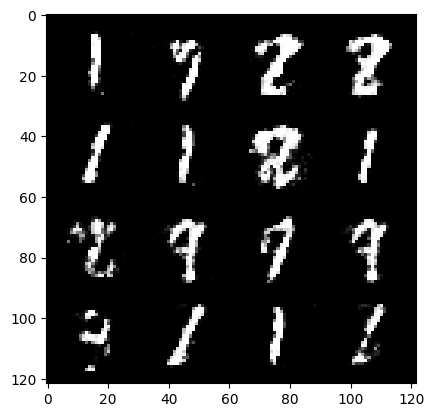

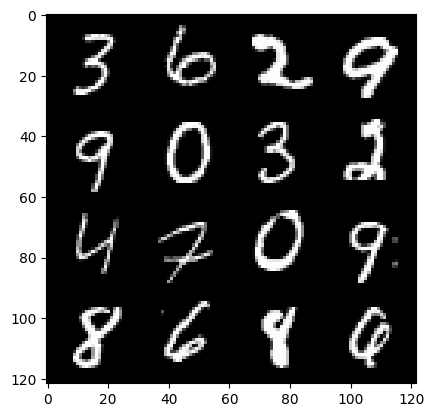

159: step 77100 / Gen loss: 1.58002081433932 / Disc loss: 0.36488175849119786


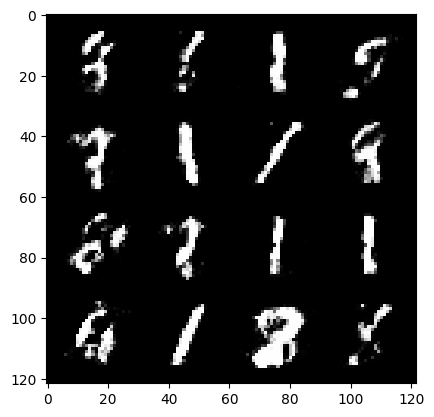

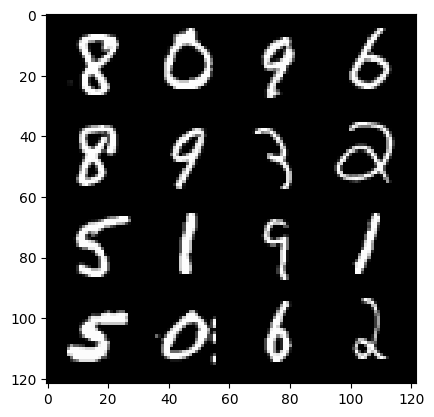

159: step 77400 / Gen loss: 1.5817084662119556 / Disc loss: 0.36815941413243597


  0%|          | 0/469 [00:00<?, ?it/s]

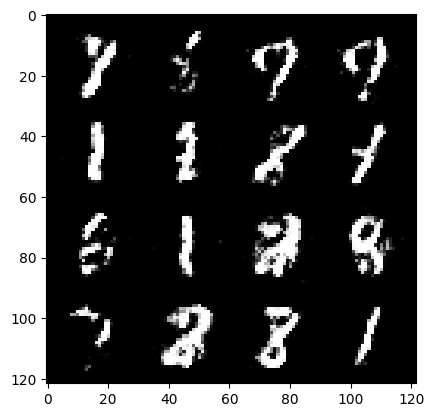

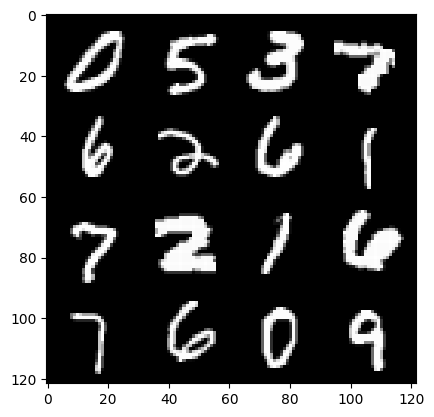

160: step 77700 / Gen loss: 1.6224039133389796 / Disc loss: 0.3512761585911114


  0%|          | 0/469 [00:00<?, ?it/s]

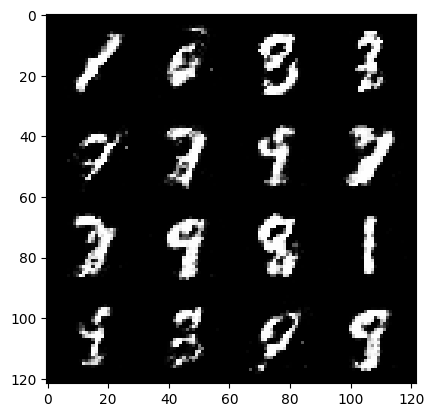

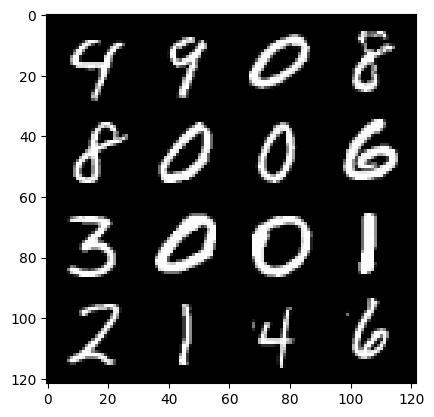

161: step 78000 / Gen loss: 1.6494095257918022 / Disc loss: 0.3562007127205532


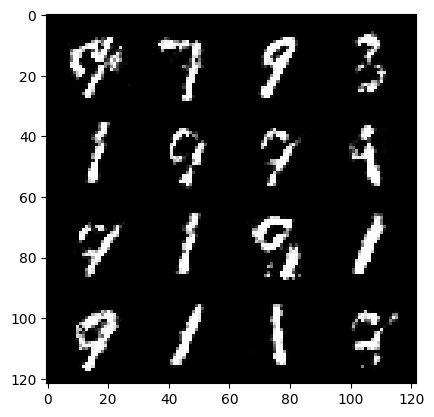

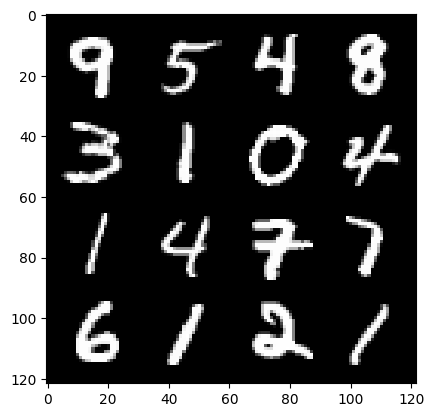

161: step 78300 / Gen loss: 1.6437835307916009 / Disc loss: 0.35720865994691864


  0%|          | 0/469 [00:00<?, ?it/s]

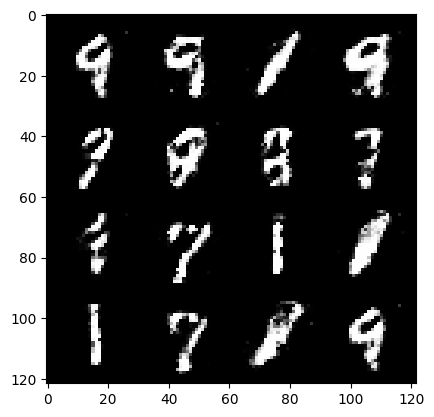

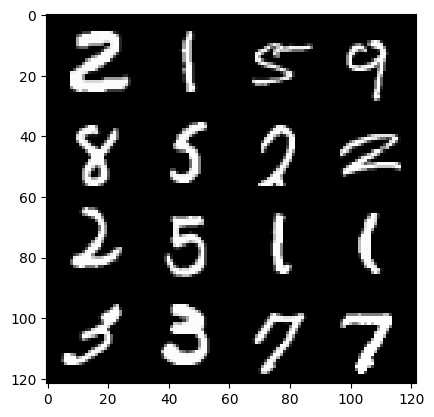

162: step 78600 / Gen loss: 1.5620289039611814 / Disc loss: 0.3731656859318416


  0%|          | 0/469 [00:00<?, ?it/s]

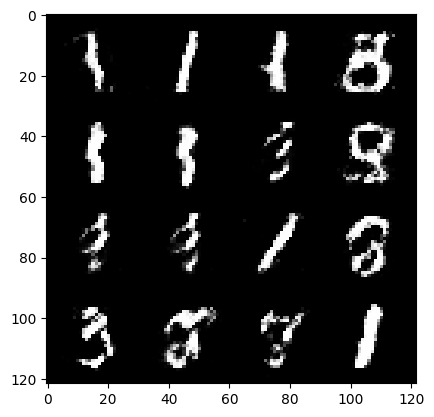

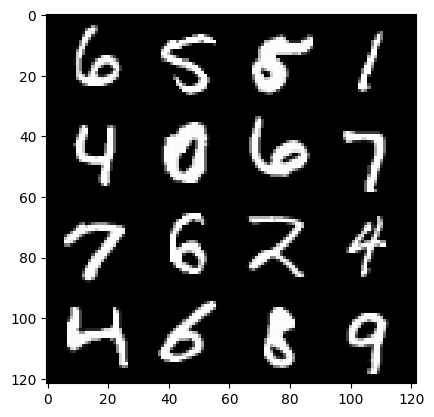

163: step 78900 / Gen loss: 1.5951361111799875 / Disc loss: 0.36981387764215456


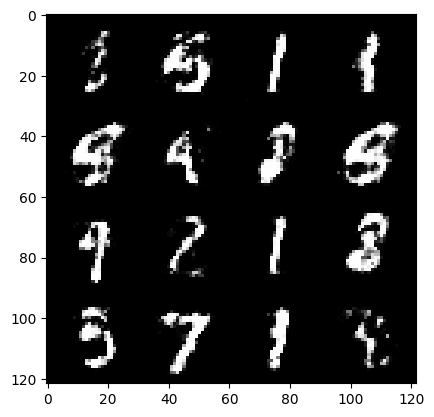

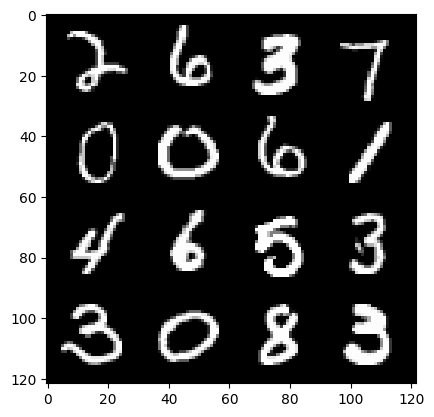

163: step 79200 / Gen loss: 1.5855632269382482 / Disc loss: 0.364402169485887


  0%|          | 0/469 [00:00<?, ?it/s]

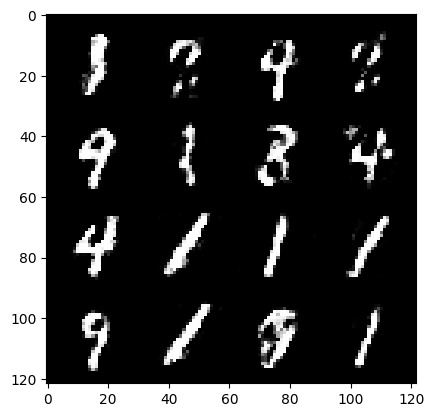

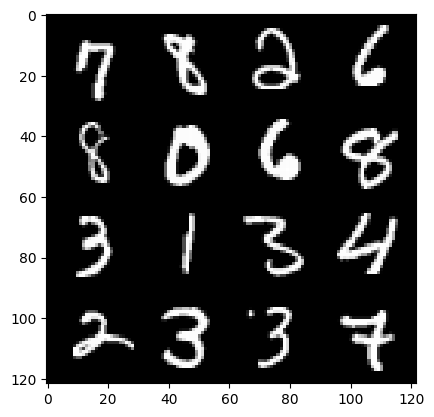

164: step 79500 / Gen loss: 1.6147218624750774 / Disc loss: 0.35732333521048204


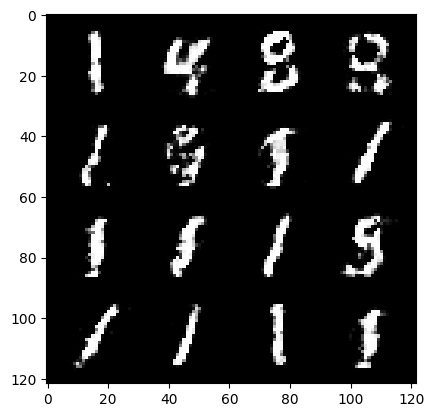

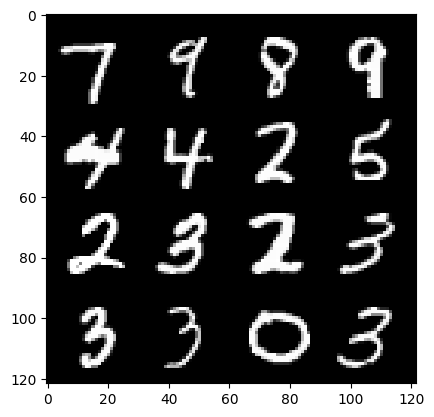

164: step 79800 / Gen loss: 1.6599126950899756 / Disc loss: 0.3458079425493875


  0%|          | 0/469 [00:00<?, ?it/s]

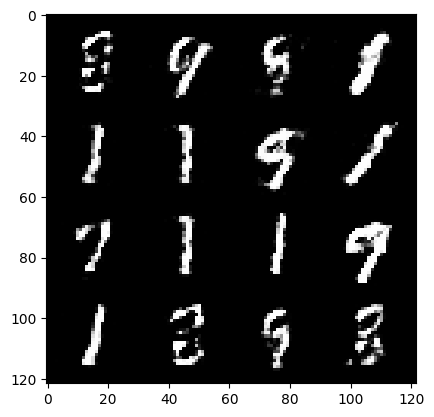

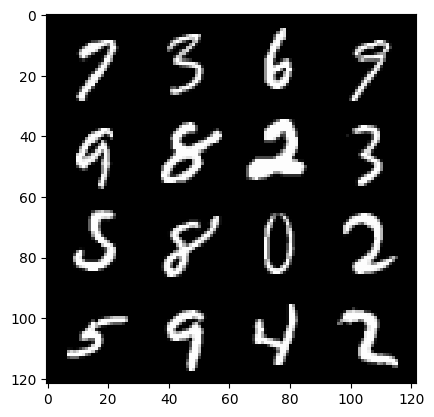

165: step 80100 / Gen loss: 1.5805765759944923 / Disc loss: 0.373116273780664


  0%|          | 0/469 [00:00<?, ?it/s]

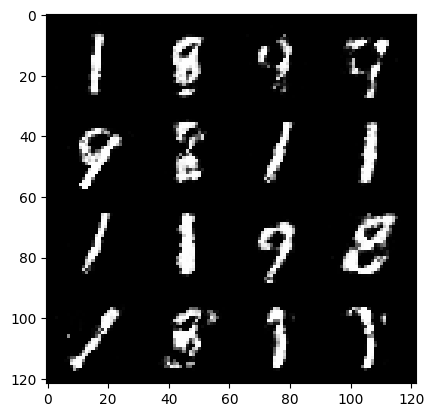

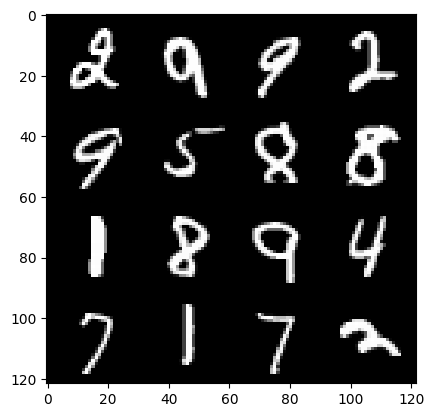

166: step 80400 / Gen loss: 1.543223239978154 / Disc loss: 0.3839632768432301


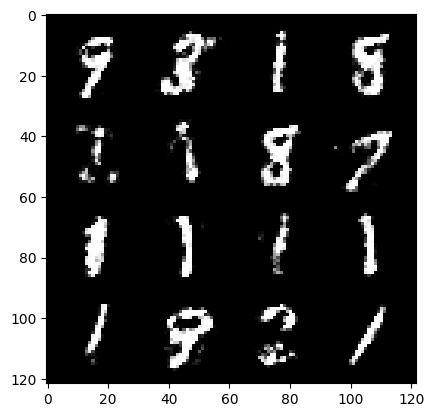

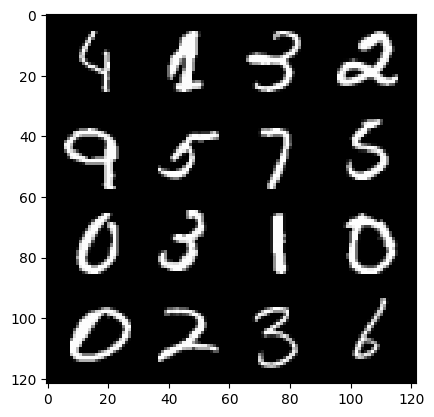

166: step 80700 / Gen loss: 1.5243081812063852 / Disc loss: 0.38069198528925563


  0%|          | 0/469 [00:00<?, ?it/s]

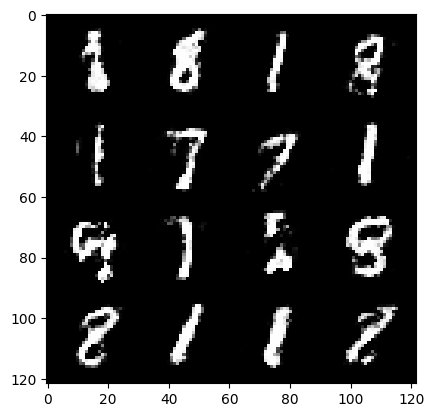

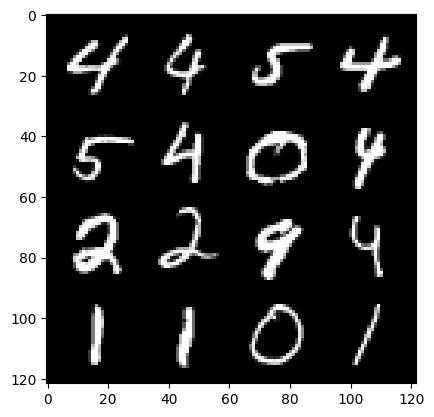

167: step 81000 / Gen loss: 1.5681425710519163 / Disc loss: 0.3684603629509605


  0%|          | 0/469 [00:00<?, ?it/s]

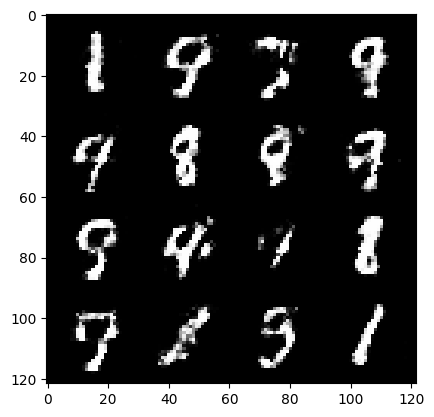

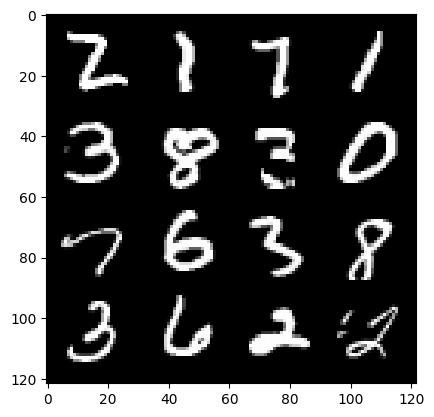

168: step 81300 / Gen loss: 1.564126320282617 / Disc loss: 0.3813281215230626


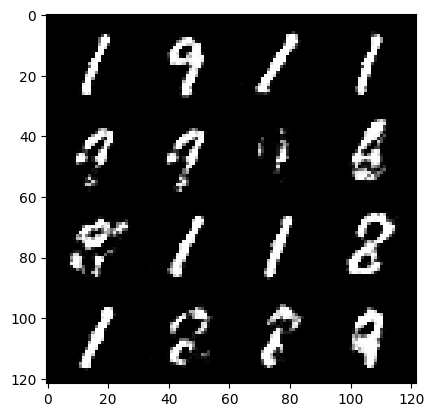

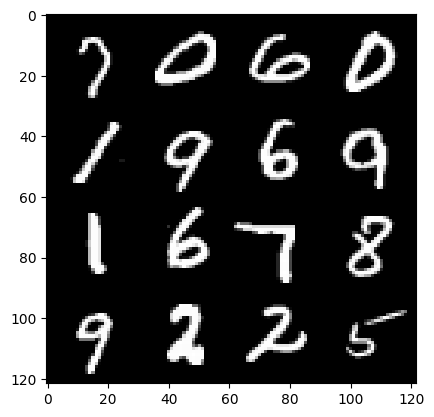

168: step 81600 / Gen loss: 1.4881250580151866 / Disc loss: 0.3988346482316654


  0%|          | 0/469 [00:00<?, ?it/s]

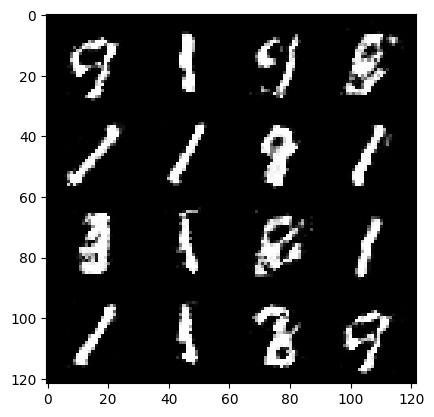

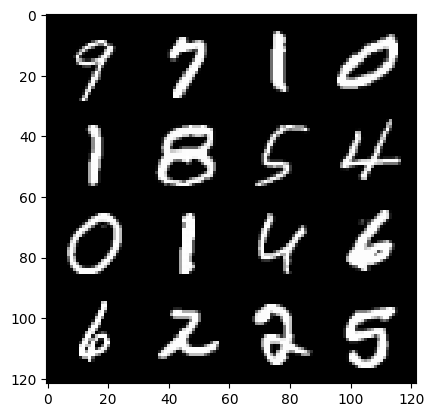

169: step 81900 / Gen loss: 1.548790054718654 / Disc loss: 0.37945884992678947


  0%|          | 0/469 [00:00<?, ?it/s]

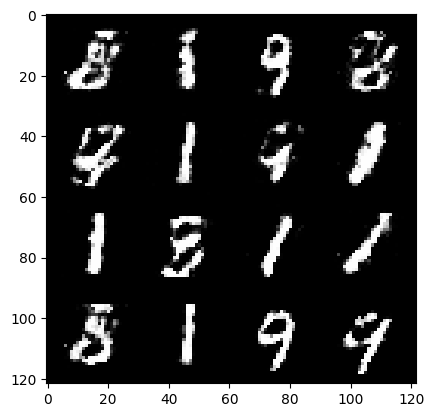

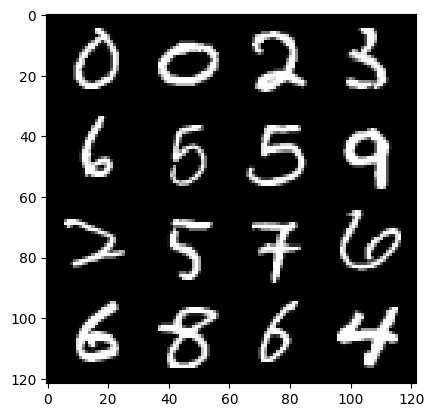

170: step 82200 / Gen loss: 1.5612410159905752 / Disc loss: 0.3802913562456767


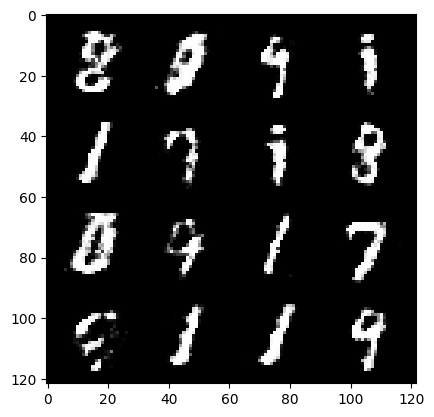

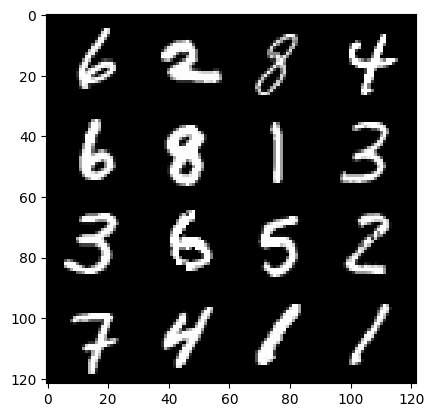

170: step 82500 / Gen loss: 1.4651558462778727 / Disc loss: 0.40633812238772693


  0%|          | 0/469 [00:00<?, ?it/s]

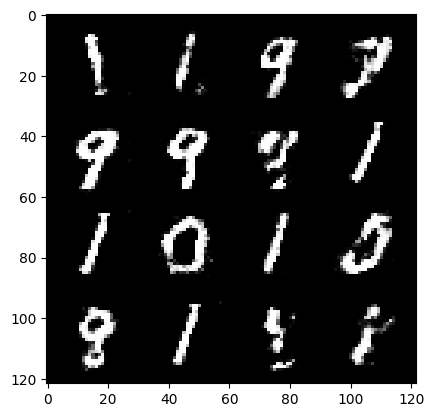

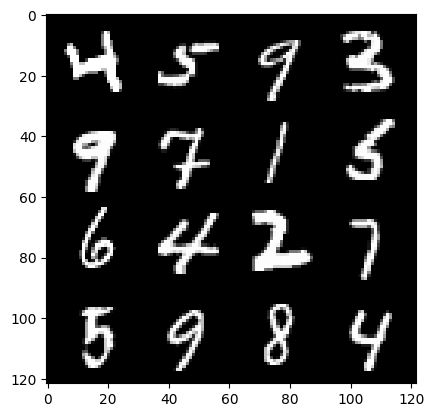

171: step 82800 / Gen loss: 1.4740003712972012 / Disc loss: 0.39402740438779194


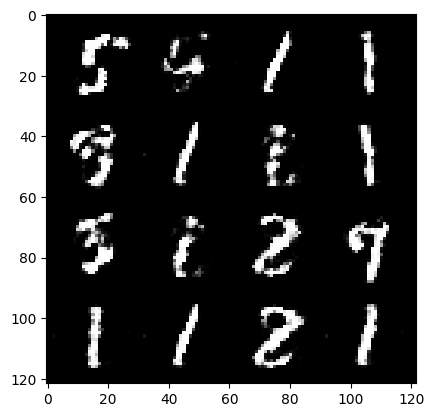

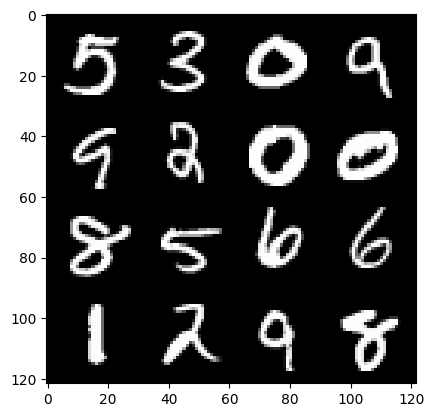

171: step 83100 / Gen loss: 1.4956652335325868 / Disc loss: 0.38808082739512095


  0%|          | 0/469 [00:00<?, ?it/s]

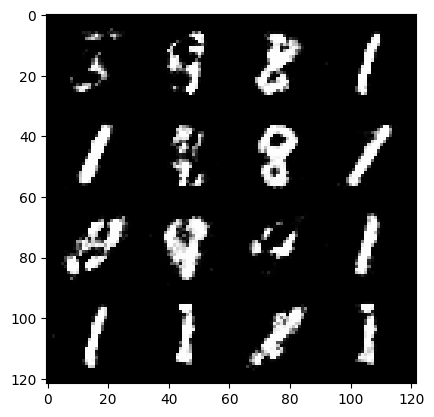

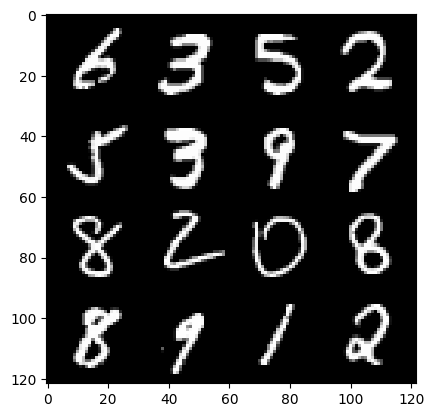

172: step 83400 / Gen loss: 1.4748099839687343 / Disc loss: 0.39451914727687826


  0%|          | 0/469 [00:00<?, ?it/s]

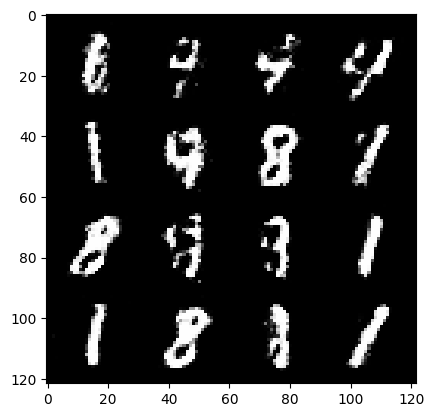

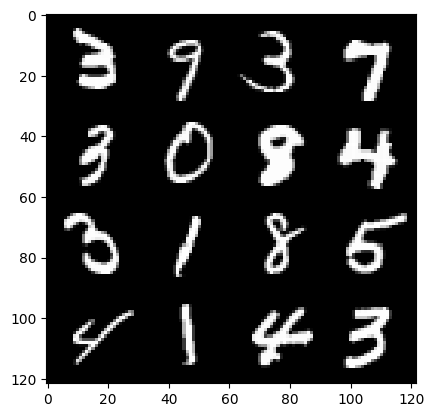

173: step 83700 / Gen loss: 1.4304391328493764 / Disc loss: 0.41132384965817137


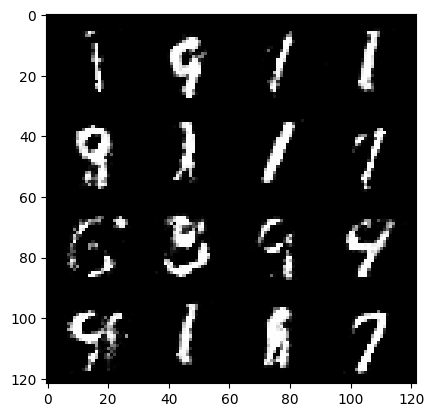

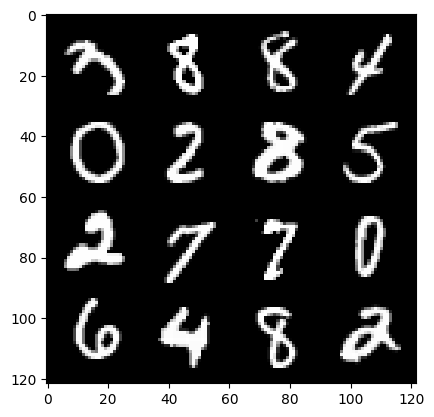

173: step 84000 / Gen loss: 1.3478246661027287 / Disc loss: 0.42724284609158836


  0%|          | 0/469 [00:00<?, ?it/s]

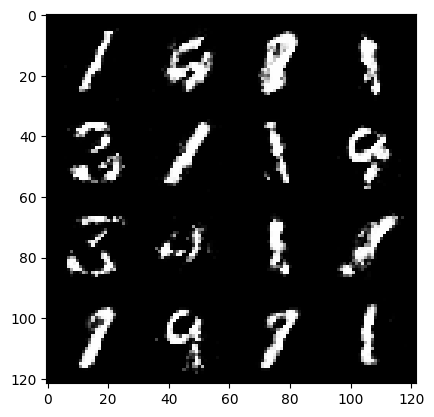

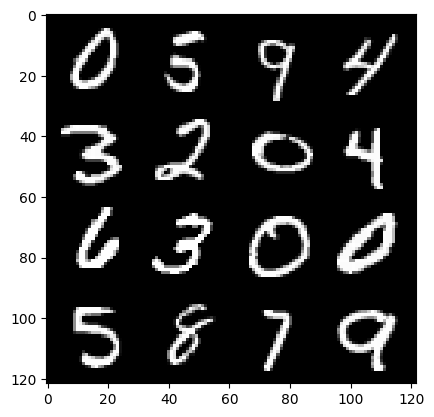

174: step 84300 / Gen loss: 1.3731556932131446 / Disc loss: 0.419581229587396


  0%|          | 0/469 [00:00<?, ?it/s]

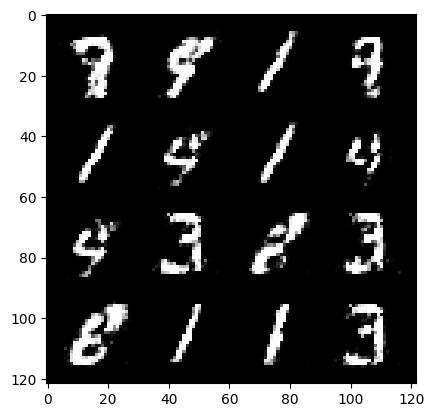

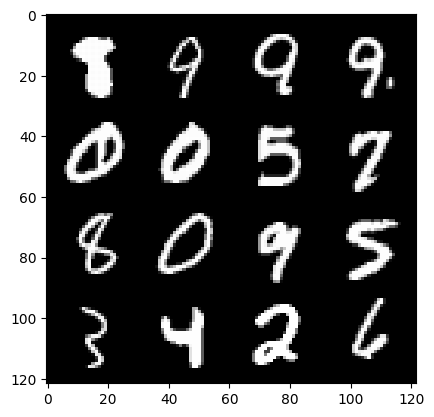

175: step 84600 / Gen loss: 1.4654107971986128 / Disc loss: 0.4088219429055851


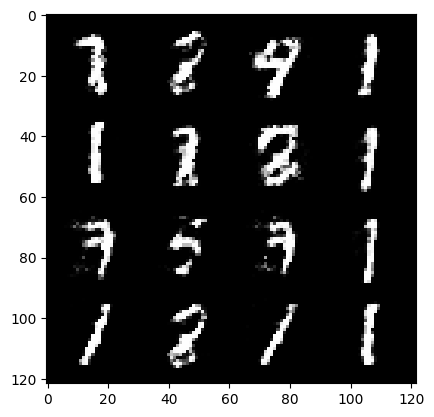

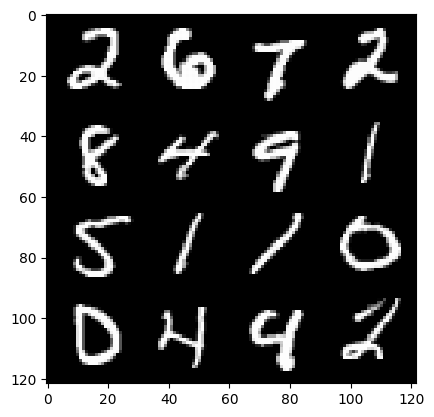

175: step 84900 / Gen loss: 1.3383283249537143 / Disc loss: 0.4375471099217732


  0%|          | 0/469 [00:00<?, ?it/s]

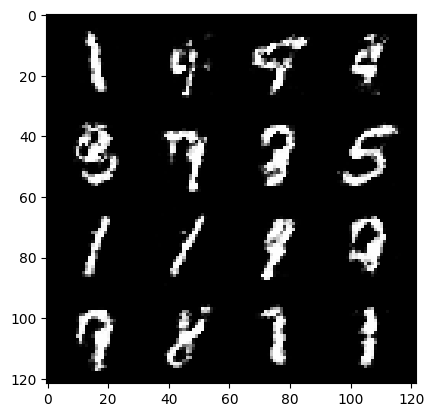

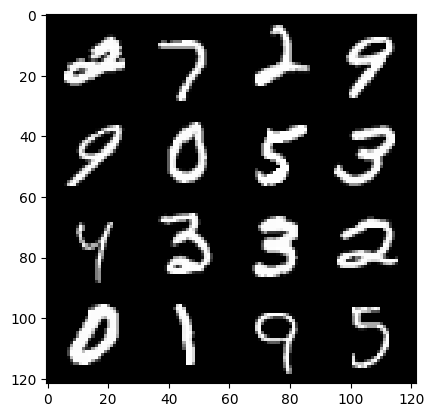

176: step 85200 / Gen loss: 1.4975376963615414 / Disc loss: 0.39378831634918826


  0%|          | 0/469 [00:00<?, ?it/s]

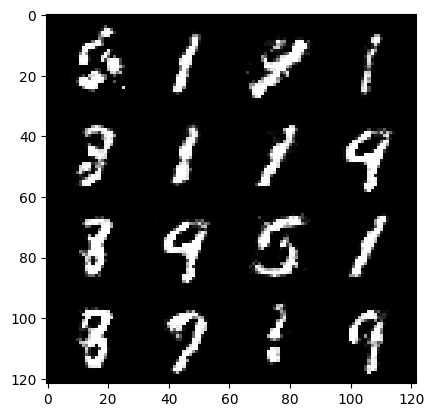

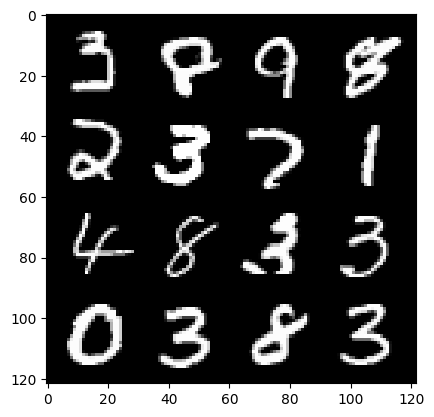

177: step 85500 / Gen loss: 1.4465447179476416 / Disc loss: 0.41001230130593014


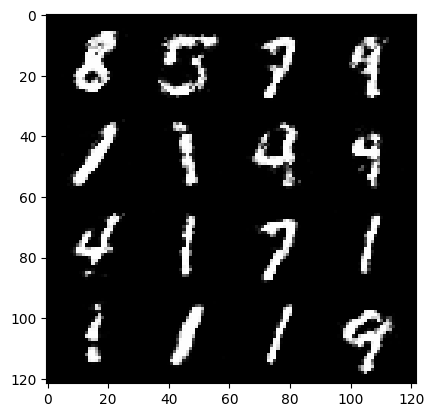

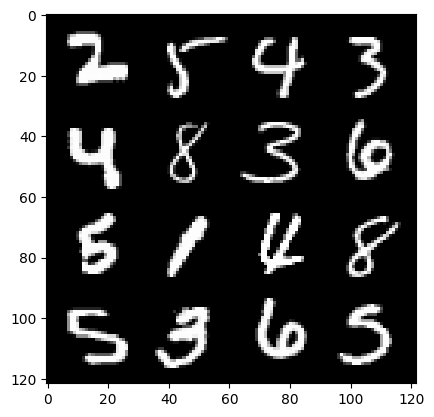

177: step 85800 / Gen loss: 1.4390675659974415 / Disc loss: 0.4124030169844627


  0%|          | 0/469 [00:00<?, ?it/s]

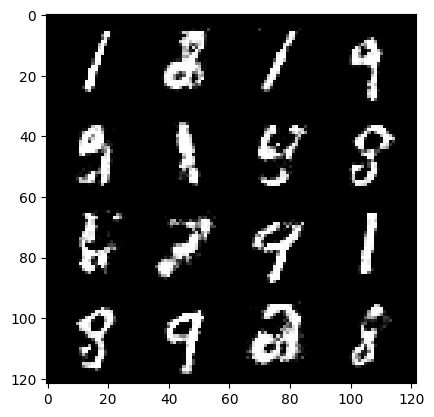

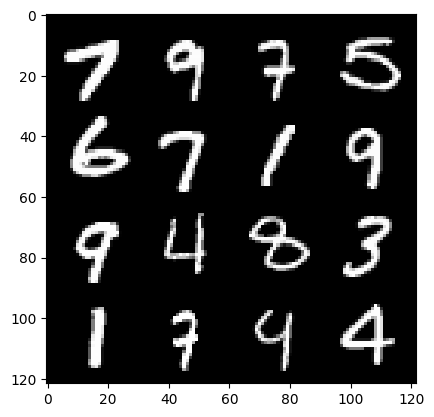

178: step 86100 / Gen loss: 1.410120863119761 / Disc loss: 0.4140196549892424


  0%|          | 0/469 [00:00<?, ?it/s]

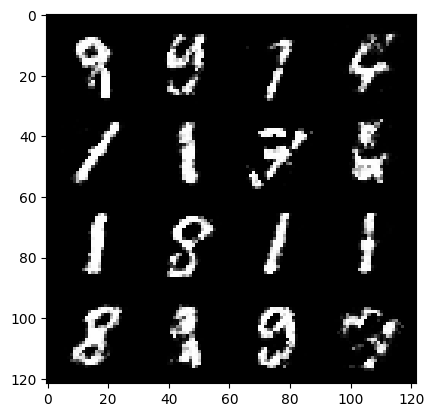

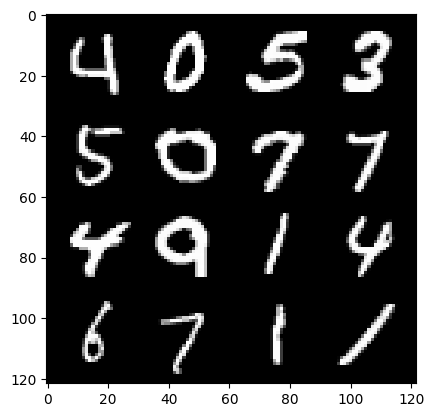

179: step 86400 / Gen loss: 1.4264986451466866 / Disc loss: 0.41412492762009284


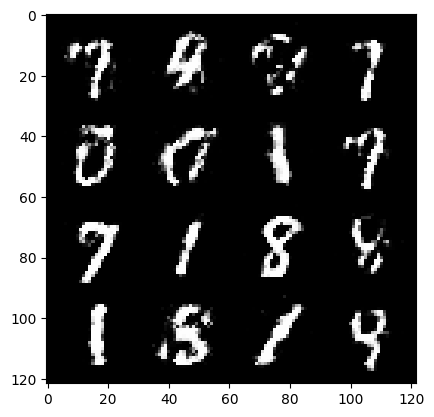

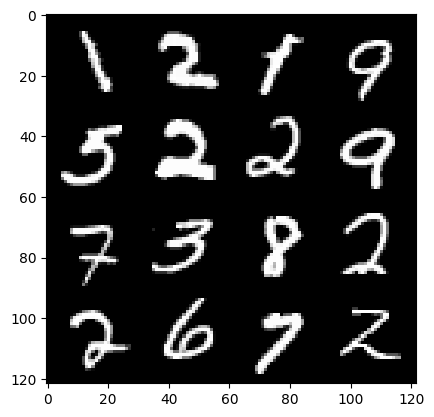

179: step 86700 / Gen loss: 1.485620784759522 / Disc loss: 0.39894224156936015


  0%|          | 0/469 [00:00<?, ?it/s]

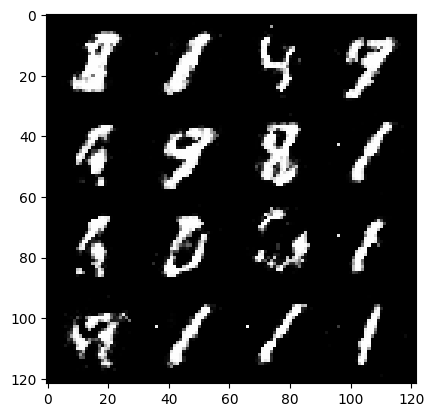

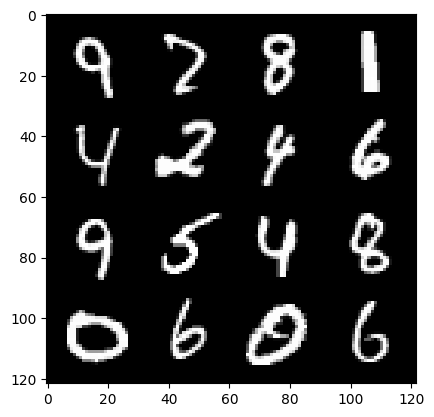

180: step 87000 / Gen loss: 1.4454763714472454 / Disc loss: 0.41235289196173347


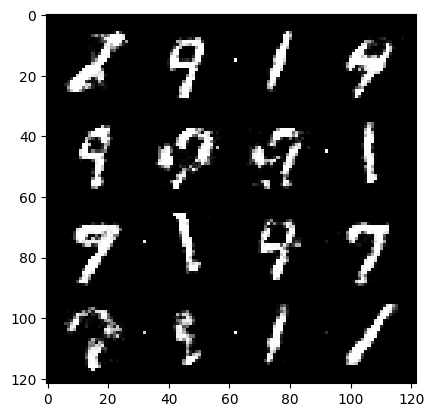

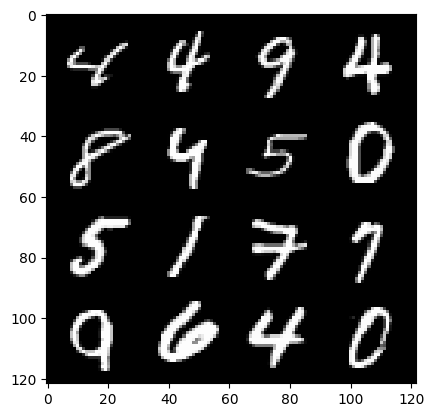

180: step 87300 / Gen loss: 1.327095206975938 / Disc loss: 0.46315340995788595


  0%|          | 0/469 [00:00<?, ?it/s]

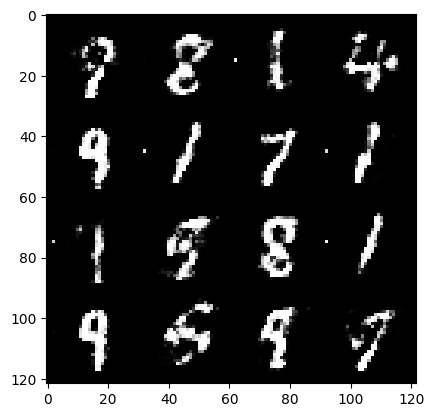

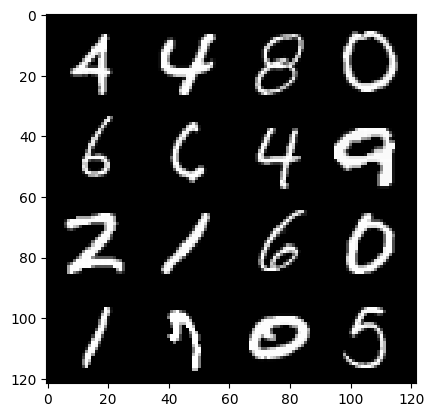

181: step 87600 / Gen loss: 1.3736080404122668 / Disc loss: 0.4254569086432456


  0%|          | 0/469 [00:00<?, ?it/s]

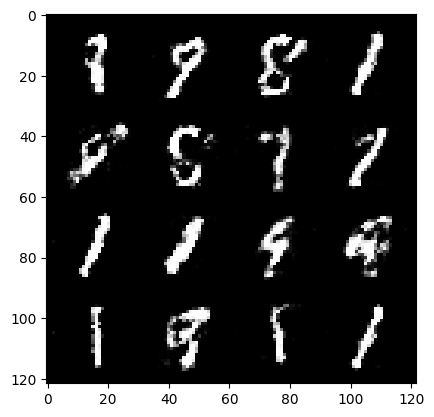

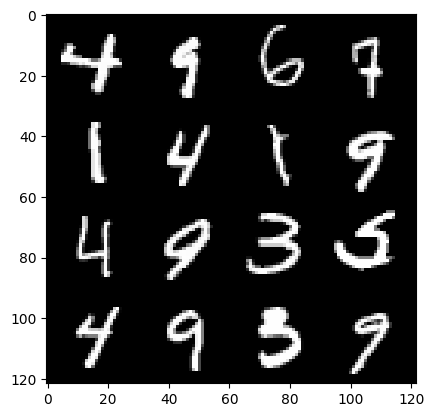

182: step 87900 / Gen loss: 1.4191819647947952 / Disc loss: 0.4070919419328371


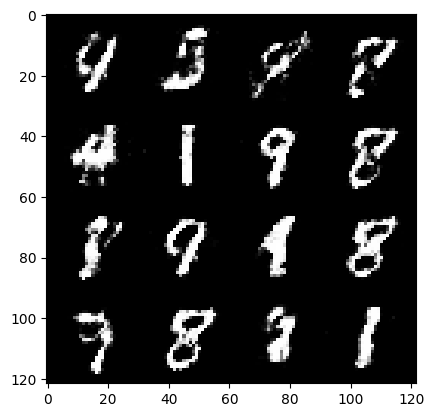

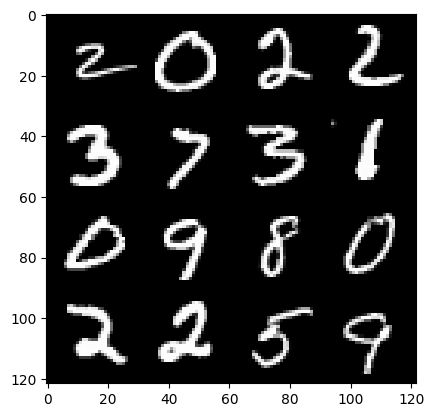

182: step 88200 / Gen loss: 1.4323151981830586 / Disc loss: 0.4111412444710732


  0%|          | 0/469 [00:00<?, ?it/s]

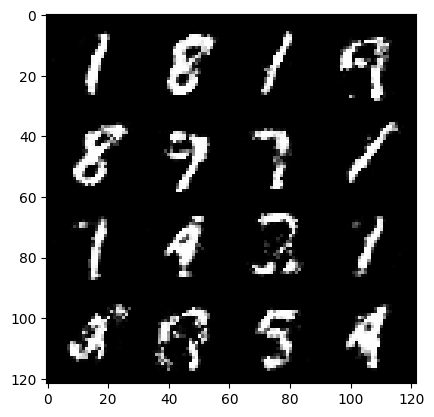

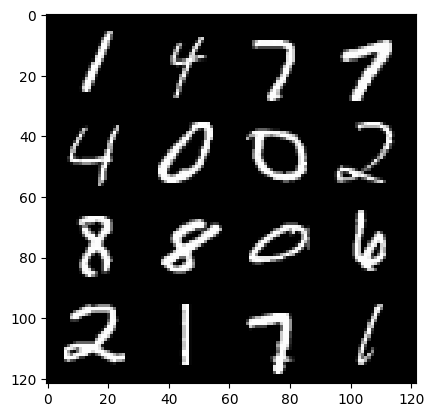

183: step 88500 / Gen loss: 1.374776778221131 / Disc loss: 0.43344812343517936


  0%|          | 0/469 [00:00<?, ?it/s]

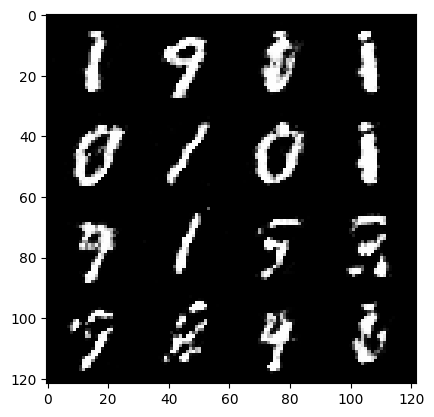

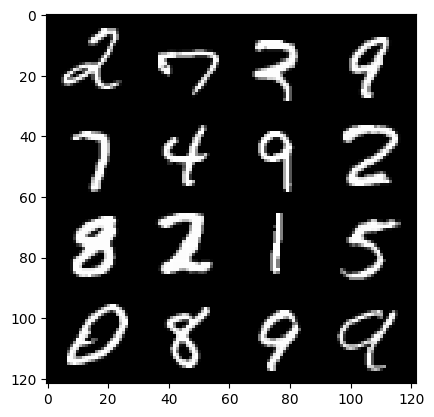

184: step 88800 / Gen loss: 1.3680395181973775 / Disc loss: 0.43407121519247654


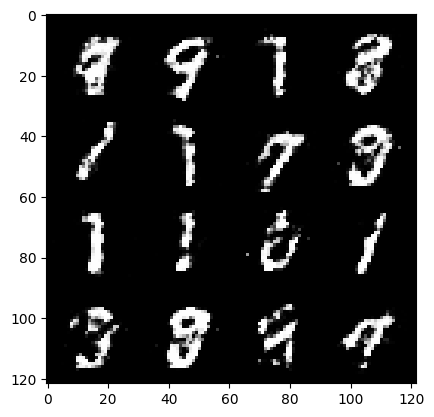

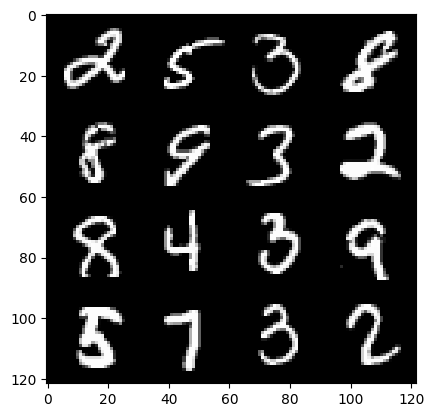

184: step 89100 / Gen loss: 1.3676177708307913 / Disc loss: 0.4344611613949143


  0%|          | 0/469 [00:00<?, ?it/s]

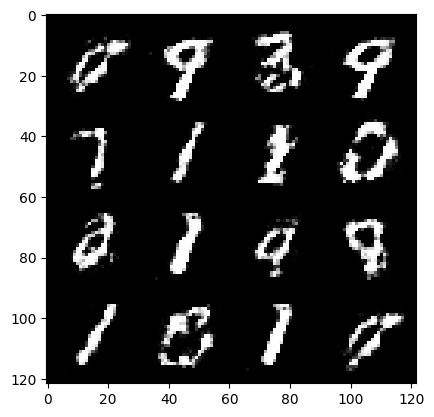

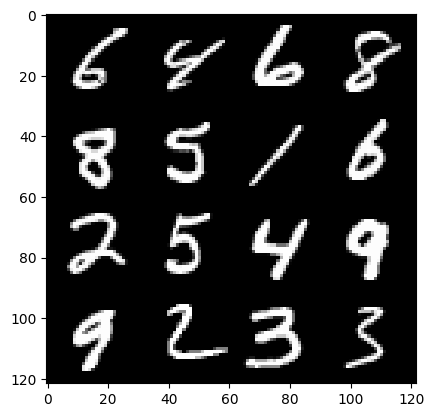

185: step 89400 / Gen loss: 1.3277971510092421 / Disc loss: 0.4439959079027172


  0%|          | 0/469 [00:00<?, ?it/s]

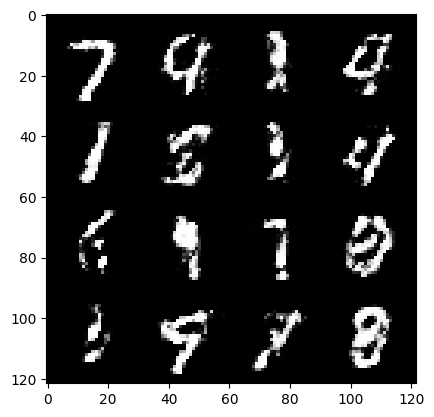

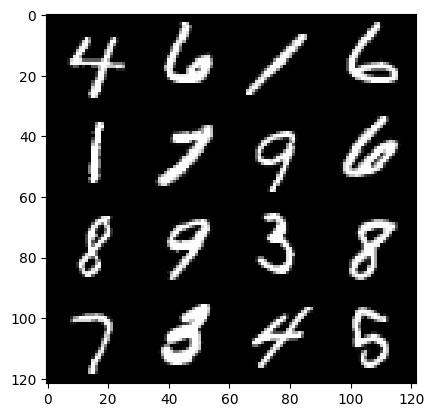

186: step 89700 / Gen loss: 1.3743781542777995 / Disc loss: 0.42266776651143984


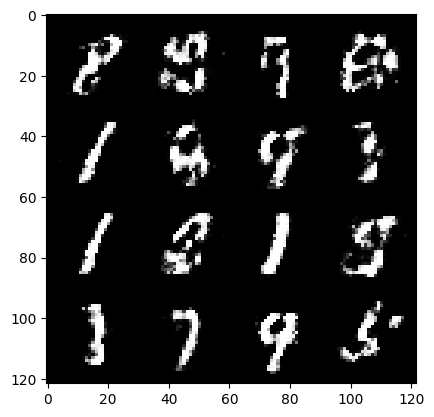

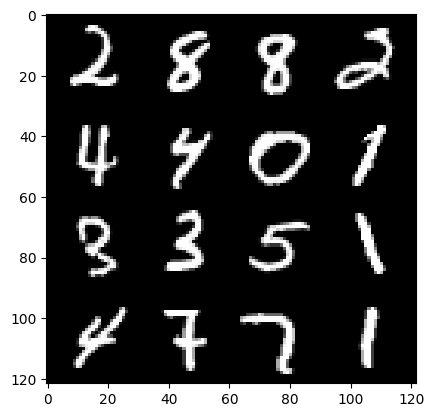

186: step 90000 / Gen loss: 1.4328356417020152 / Disc loss: 0.40360964735349036


  0%|          | 0/469 [00:00<?, ?it/s]

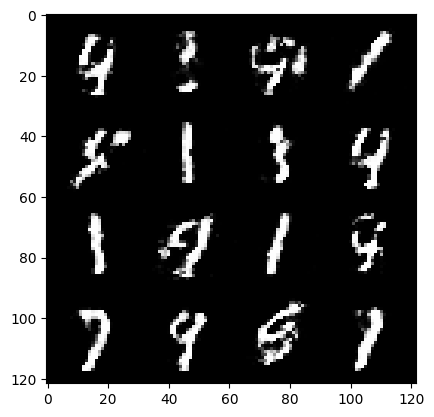

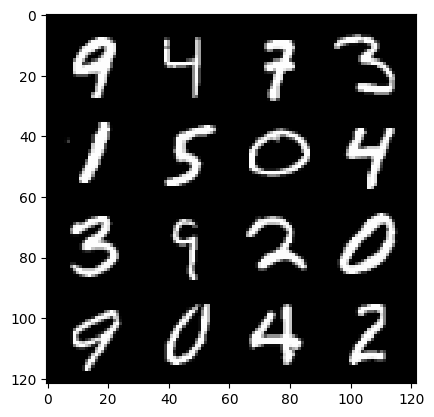

187: step 90300 / Gen loss: 1.4551915677388503 / Disc loss: 0.40915269126494713


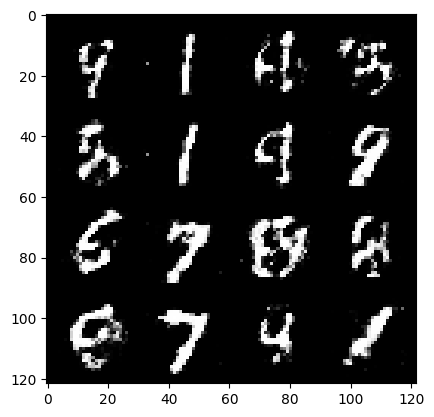

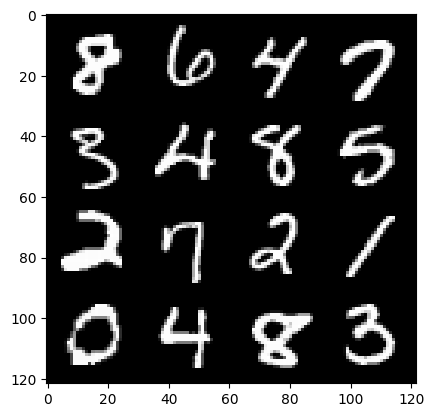

187: step 90600 / Gen loss: 1.385642591317496 / Disc loss: 0.4262147365013759


  0%|          | 0/469 [00:00<?, ?it/s]

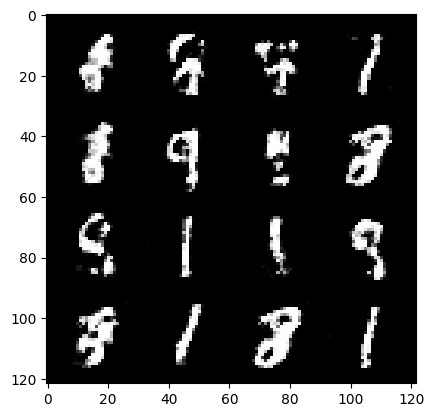

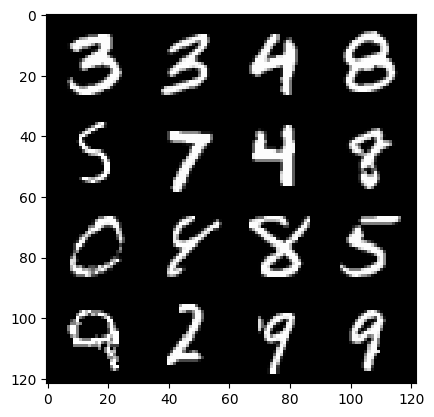

188: step 90900 / Gen loss: 1.4394642885526026 / Disc loss: 0.4105696216225626


  0%|          | 0/469 [00:00<?, ?it/s]

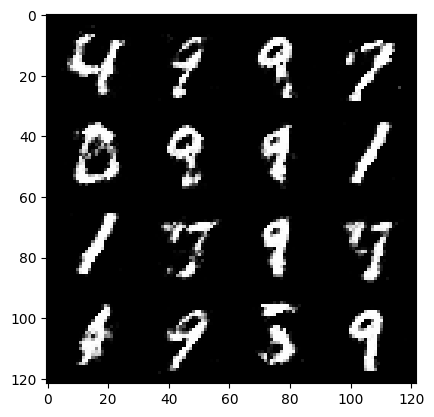

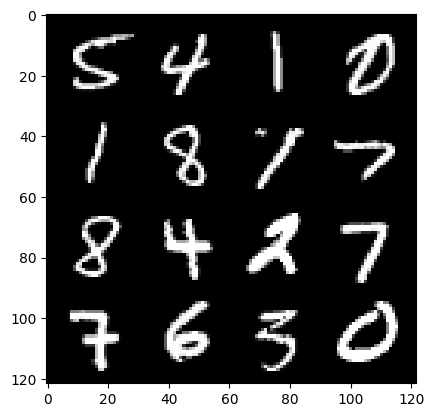

189: step 91200 / Gen loss: 1.4329630136489875 / Disc loss: 0.41373473495245006


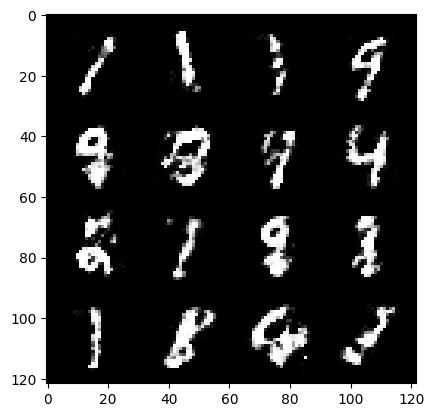

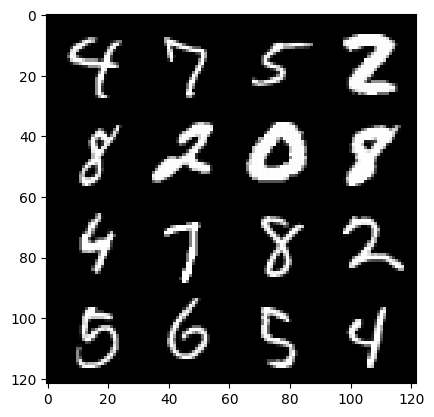

189: step 91500 / Gen loss: 1.4719944743315383 / Disc loss: 0.39923907637596145


  0%|          | 0/469 [00:00<?, ?it/s]

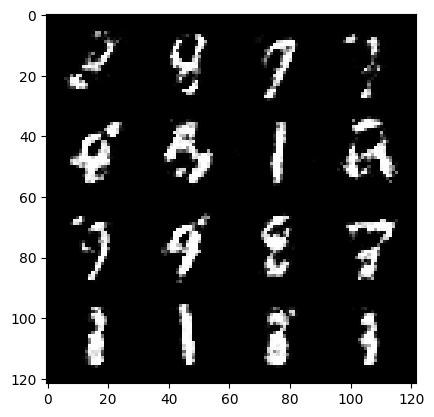

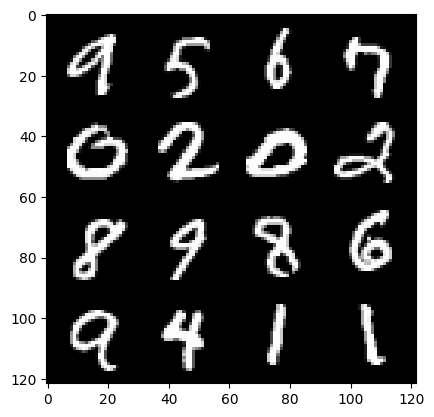

190: step 91800 / Gen loss: 1.4447621472676593 / Disc loss: 0.40389582435290017


  0%|          | 0/469 [00:00<?, ?it/s]

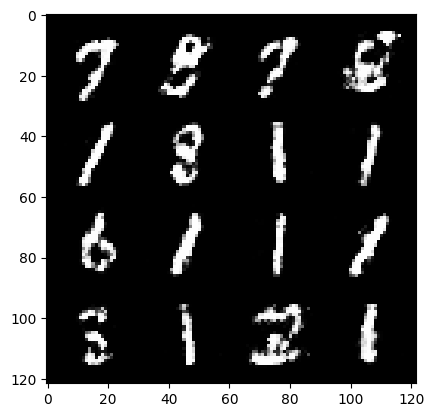

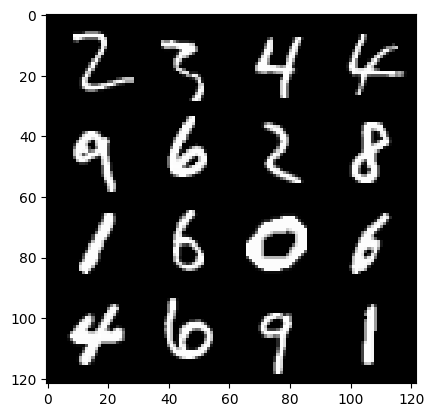

191: step 92100 / Gen loss: 1.516062662601471 / Disc loss: 0.3951401154200235


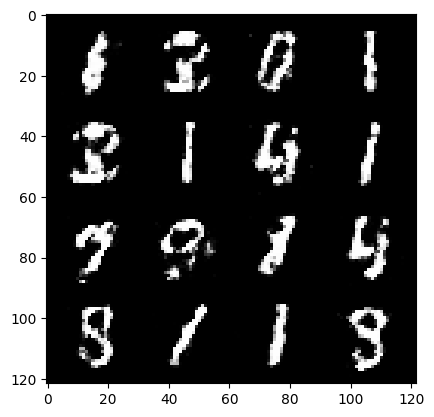

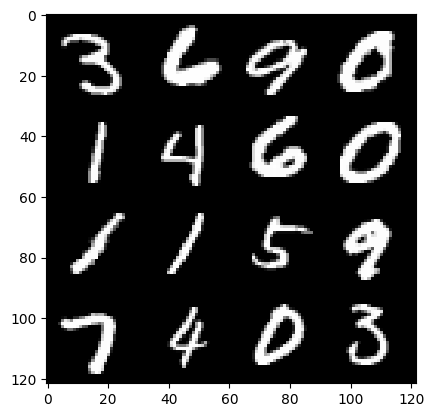

191: step 92400 / Gen loss: 1.4034637459119161 / Disc loss: 0.41228152533372253


  0%|          | 0/469 [00:00<?, ?it/s]

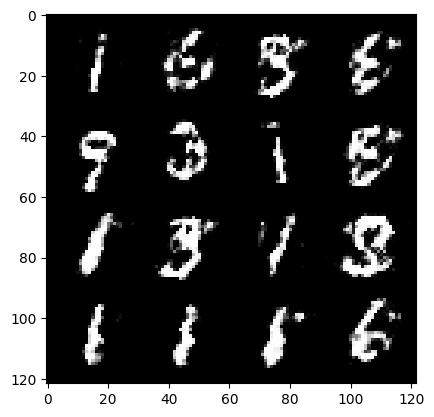

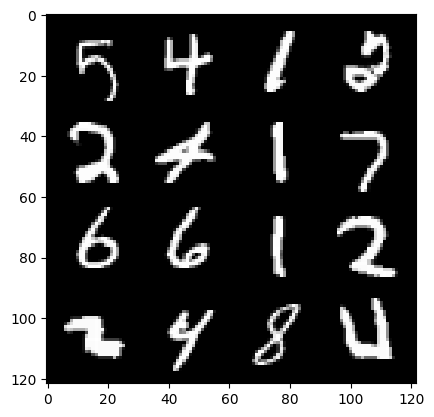

192: step 92700 / Gen loss: 1.4524245711167647 / Disc loss: 0.39302644302447654


  0%|          | 0/469 [00:00<?, ?it/s]

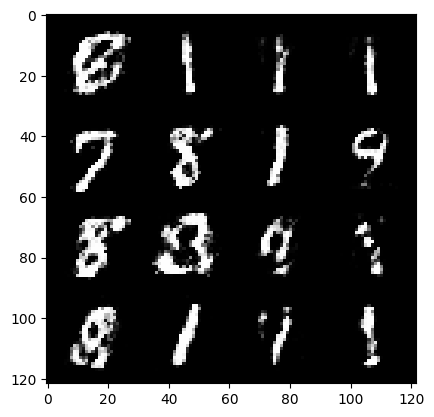

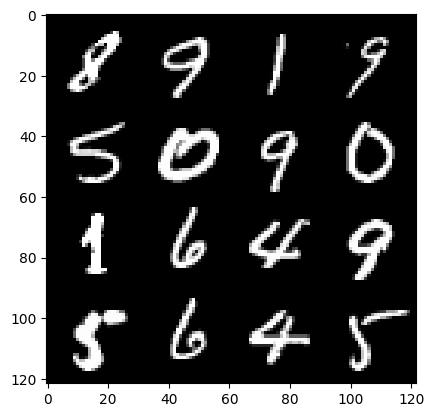

193: step 93000 / Gen loss: 1.4926189879576357 / Disc loss: 0.3912280196944874


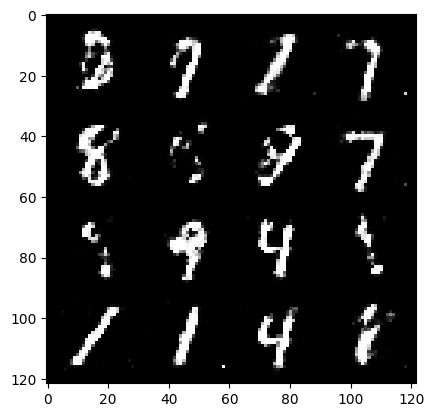

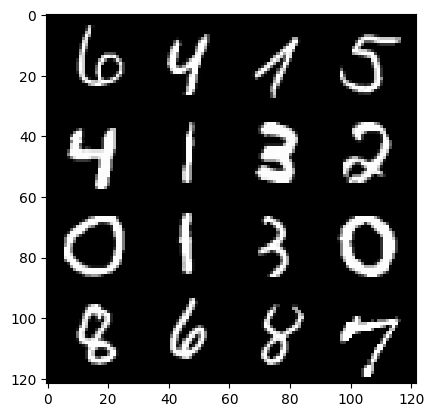

193: step 93300 / Gen loss: 1.41128276904424 / Disc loss: 0.42873326639334364


  0%|          | 0/469 [00:00<?, ?it/s]

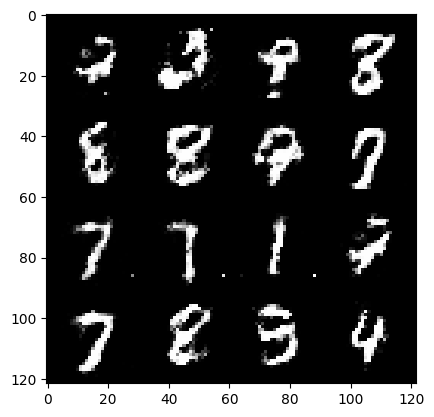

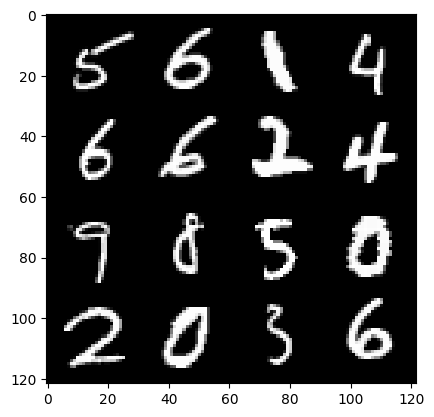

194: step 93600 / Gen loss: 1.3847056225935612 / Disc loss: 0.4213054128487909


  0%|          | 0/469 [00:00<?, ?it/s]

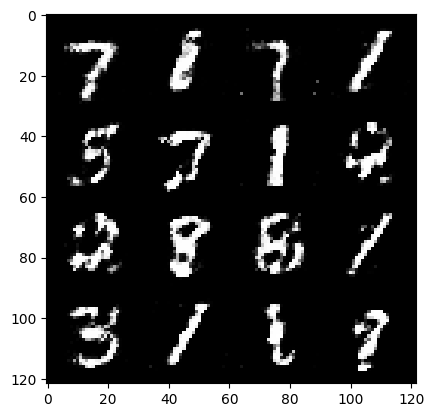

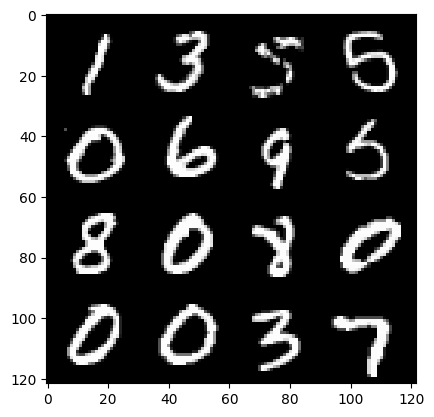

195: step 93900 / Gen loss: 1.5091107531388597 / Disc loss: 0.3912694112459821


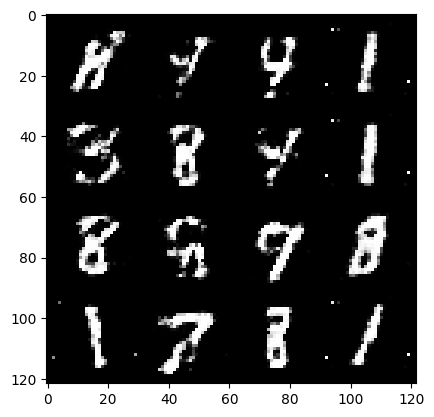

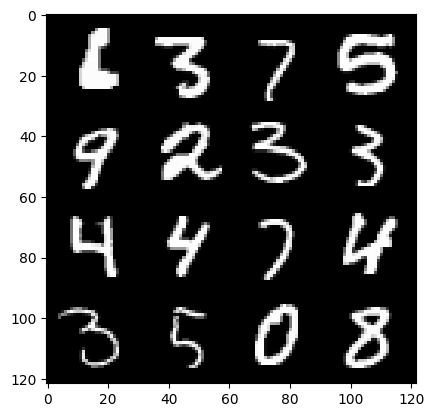

195: step 94200 / Gen loss: 1.262647041479746 / Disc loss: 0.49937018136183425


  0%|          | 0/469 [00:00<?, ?it/s]

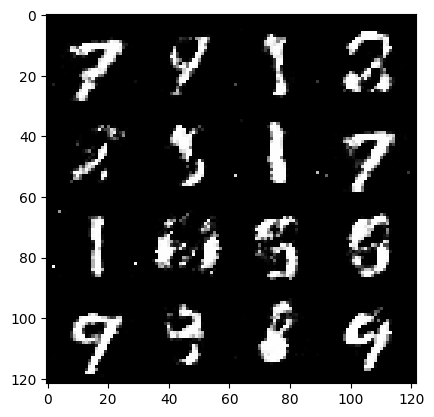

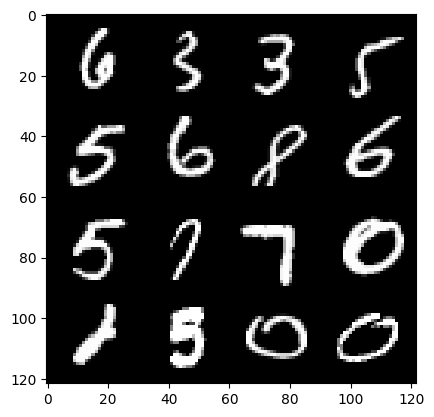

196: step 94500 / Gen loss: 1.3792208369572958 / Disc loss: 0.43845861544211717


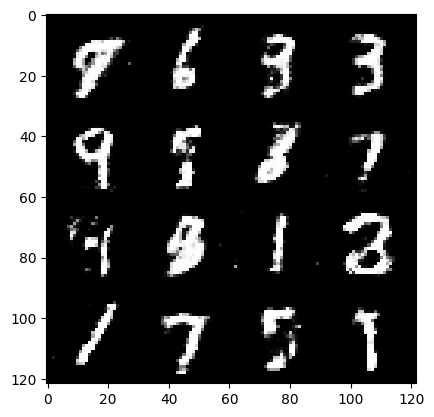

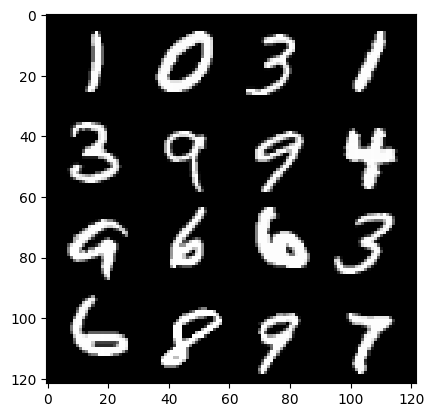

196: step 94800 / Gen loss: 1.4118854820728306 / Disc loss: 0.4188098543882369


  0%|          | 0/469 [00:00<?, ?it/s]

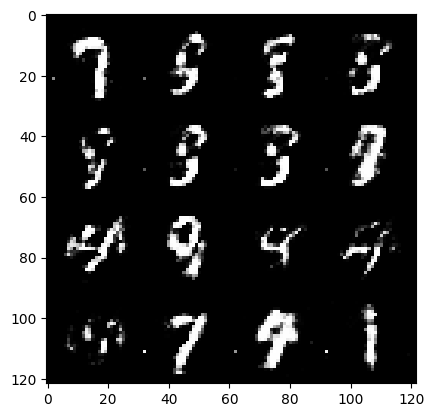

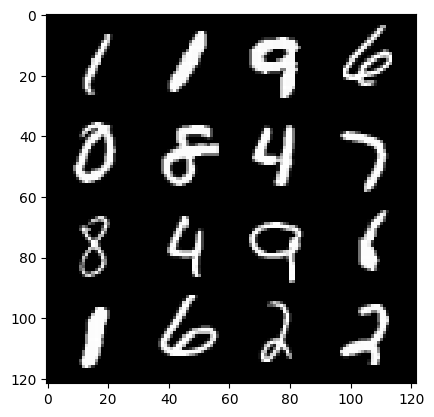

197: step 95100 / Gen loss: 1.38555537144343 / Disc loss: 0.4133660142620404


  0%|          | 0/469 [00:00<?, ?it/s]

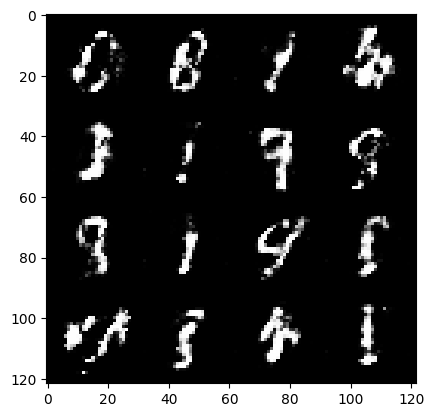

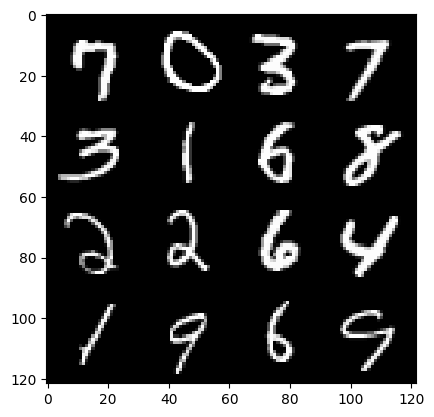

198: step 95400 / Gen loss: 1.4537278680006656 / Disc loss: 0.3847287956873575


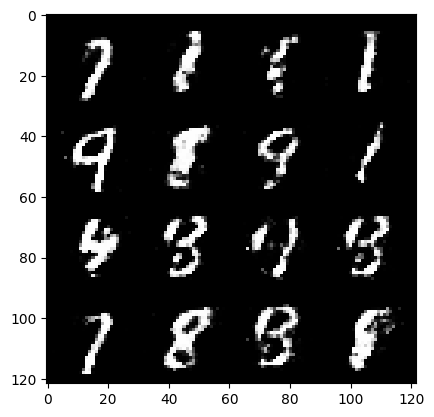

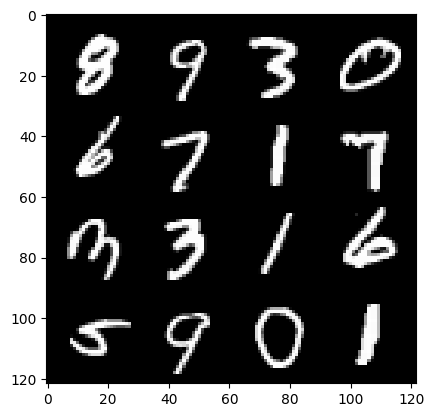

198: step 95700 / Gen loss: 1.4398564159870149 / Disc loss: 0.4020240181684493


  0%|          | 0/469 [00:00<?, ?it/s]

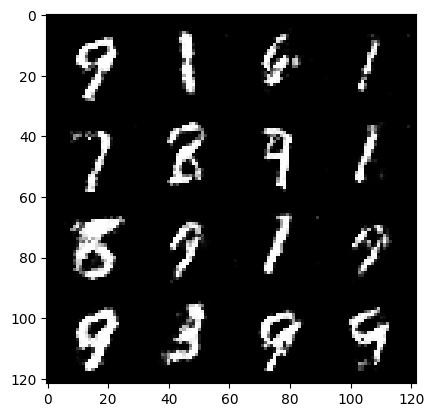

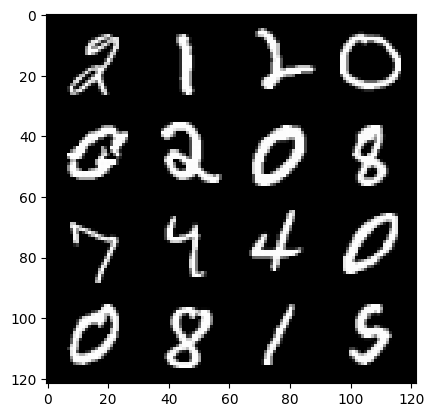

199: step 96000 / Gen loss: 1.5025009799003588 / Disc loss: 0.39976029733816804


  0%|          | 0/469 [00:00<?, ?it/s]

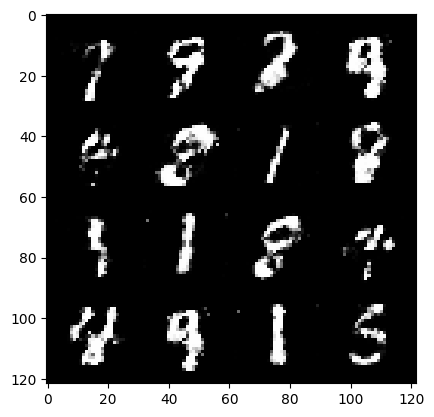

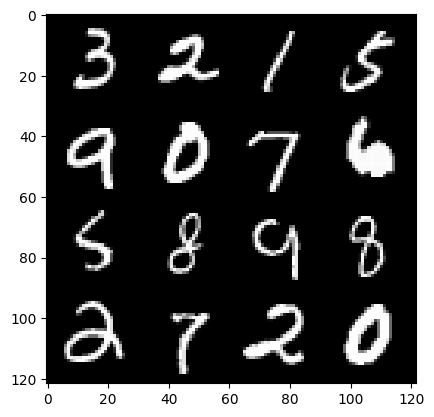

200: step 96300 / Gen loss: 1.5395222326119735 / Disc loss: 0.3951730972528457


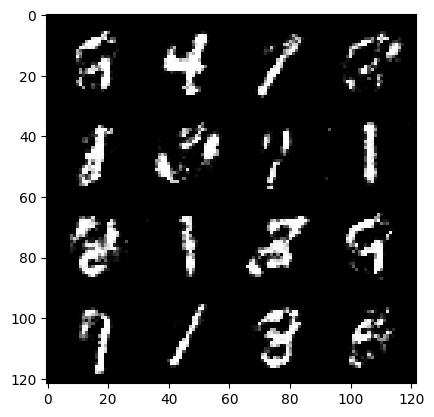

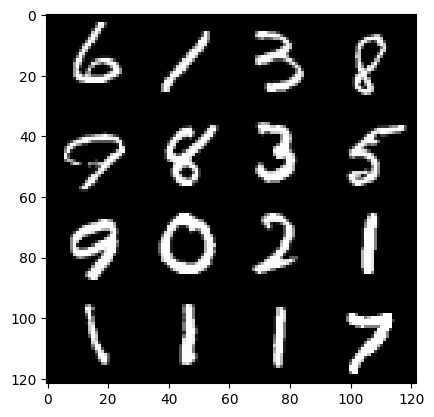

200: step 96600 / Gen loss: 1.4160225808620455 / Disc loss: 0.4146567994356158


  0%|          | 0/469 [00:00<?, ?it/s]

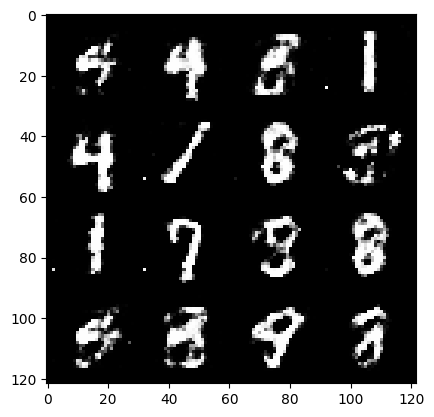

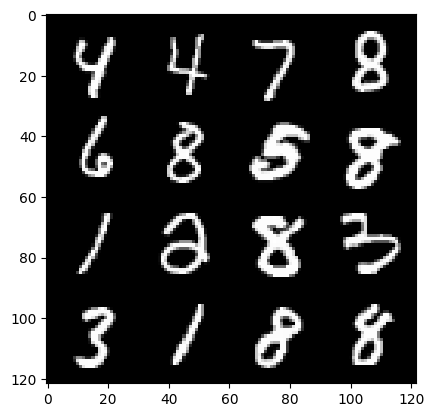

201: step 96900 / Gen loss: 1.3576591213544213 / Disc loss: 0.4473434580365818


  0%|          | 0/469 [00:00<?, ?it/s]

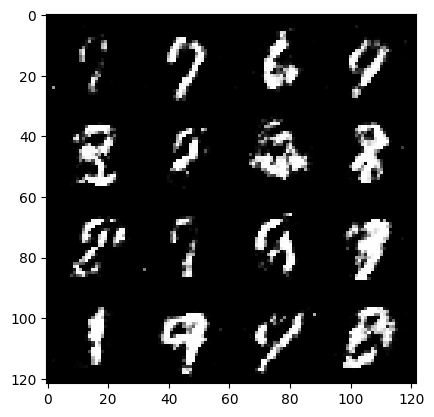

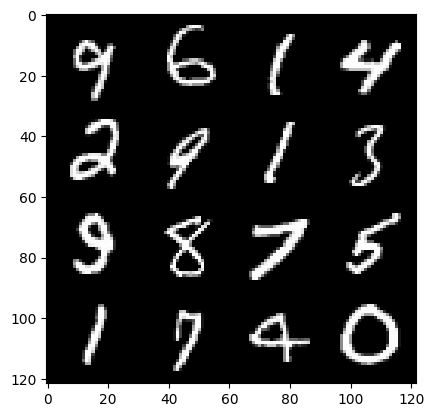

202: step 97200 / Gen loss: 1.511814001401266 / Disc loss: 0.38116477499405527


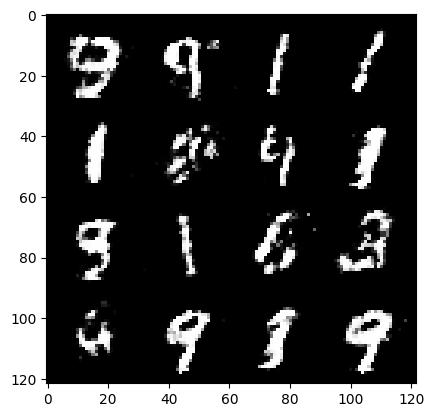

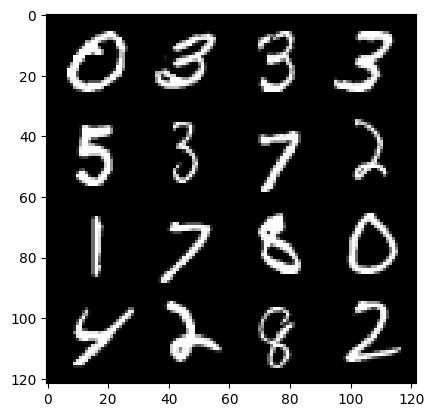

202: step 97500 / Gen loss: 1.5066742885112758 / Disc loss: 0.38580433060725505


  0%|          | 0/469 [00:00<?, ?it/s]

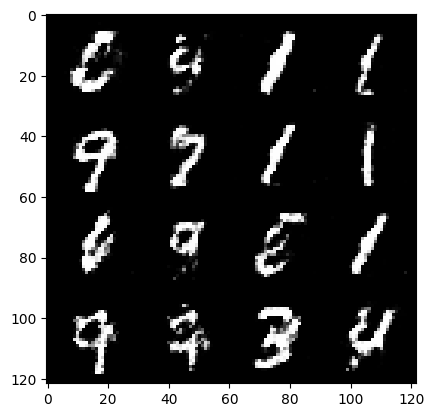

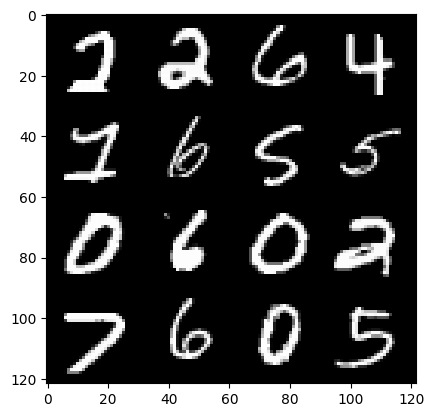

203: step 97800 / Gen loss: 1.4785287320613865 / Disc loss: 0.3863569402694704


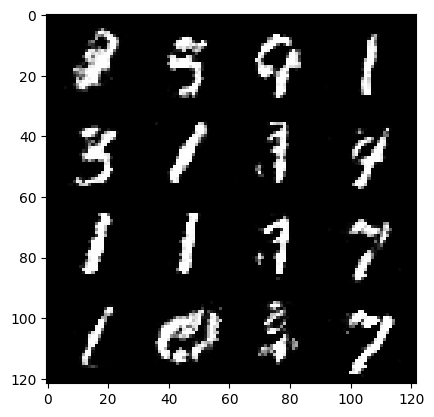

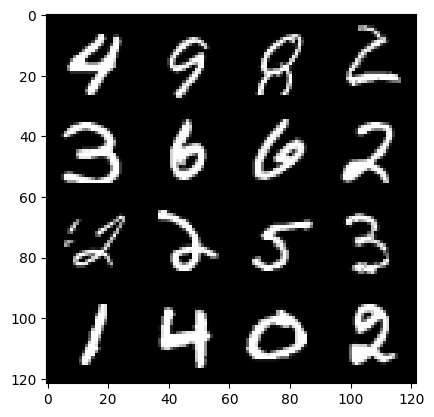

203: step 98100 / Gen loss: 1.4600467642148345 / Disc loss: 0.39348541577657054


  0%|          | 0/469 [00:00<?, ?it/s]

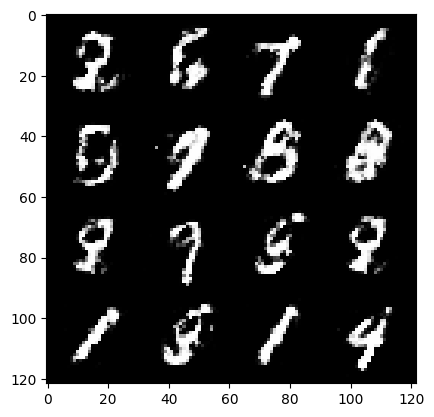

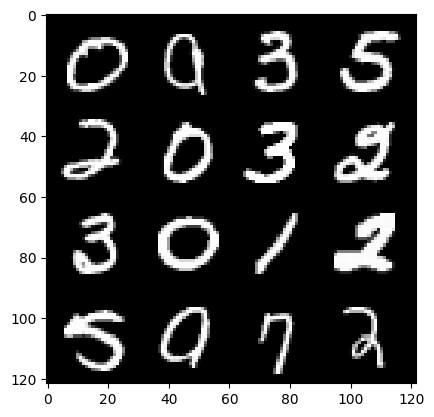

204: step 98400 / Gen loss: 1.4195703975359608 / Disc loss: 0.4105007043480876


  0%|          | 0/469 [00:00<?, ?it/s]

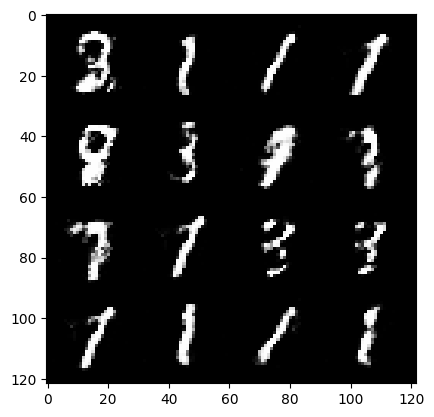

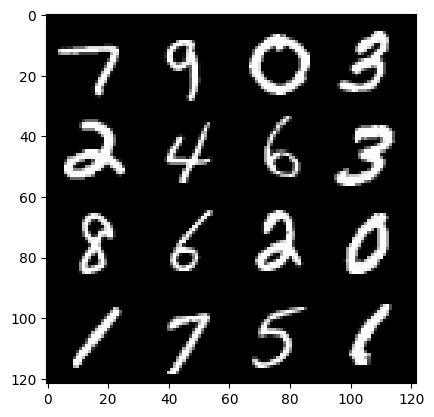

205: step 98700 / Gen loss: 1.3924129939079284 / Disc loss: 0.4237671927611032


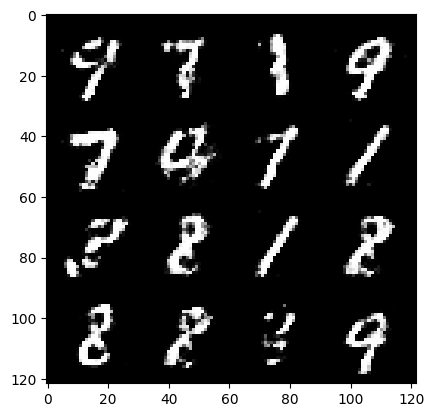

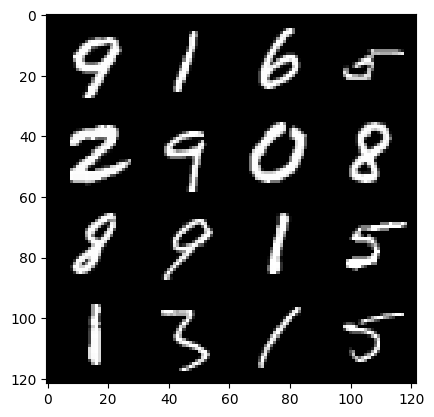

205: step 99000 / Gen loss: 1.342241248289743 / Disc loss: 0.4262278126676874


  0%|          | 0/469 [00:00<?, ?it/s]

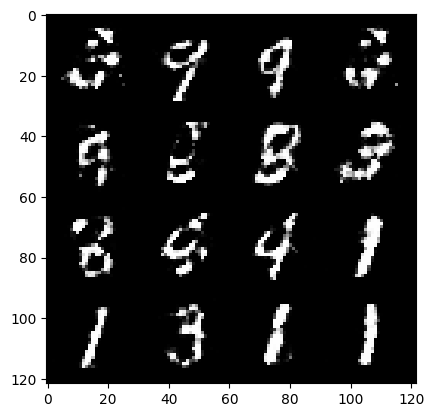

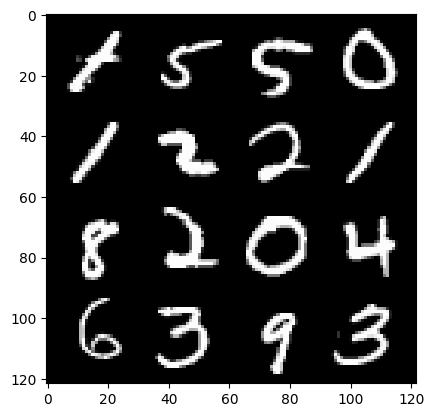

206: step 99300 / Gen loss: 1.3728894313176472 / Disc loss: 0.42097996920347214


  0%|          | 0/469 [00:00<?, ?it/s]

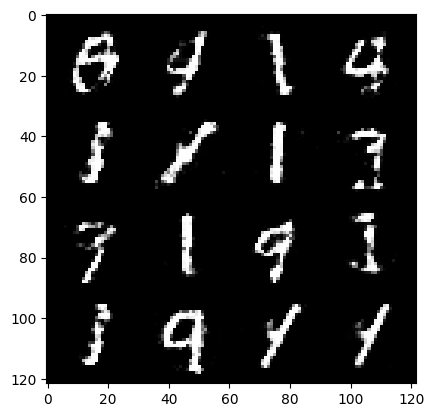

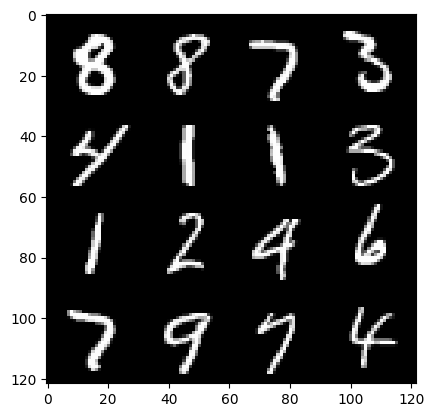

207: step 99600 / Gen loss: 1.3771279466152189 / Disc loss: 0.4195517571767174


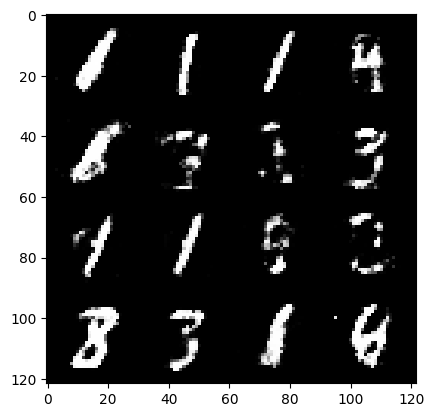

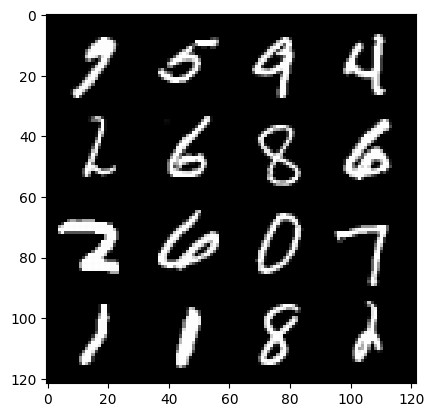

207: step 99900 / Gen loss: 1.4032146318753562 / Disc loss: 0.41429475118716547


  0%|          | 0/469 [00:00<?, ?it/s]

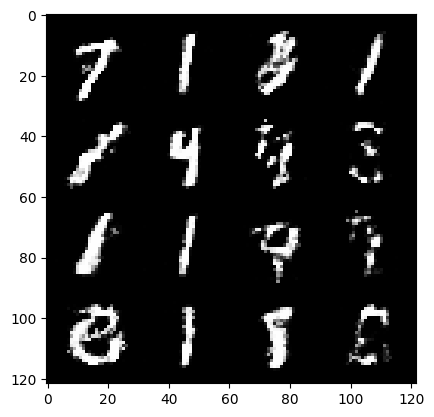

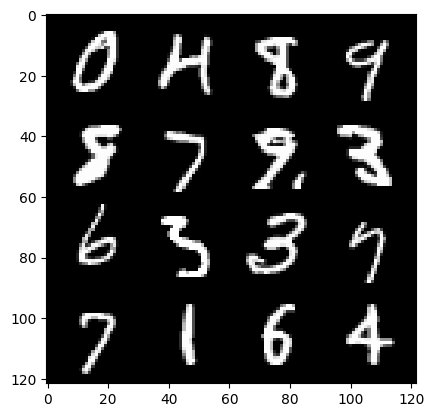

208: step 100200 / Gen loss: 1.349236445426941 / Disc loss: 0.42556922793388363


  0%|          | 0/469 [00:00<?, ?it/s]

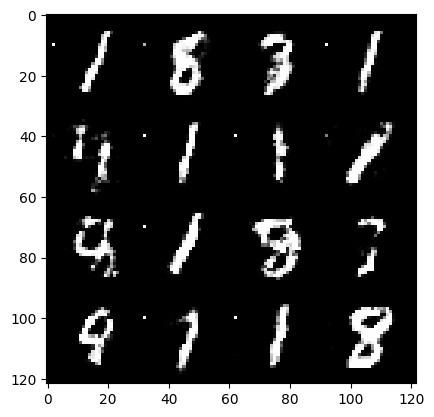

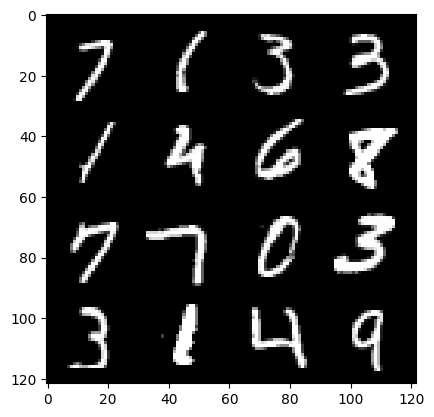

209: step 100500 / Gen loss: 1.3316545259952548 / Disc loss: 0.4392717126011848


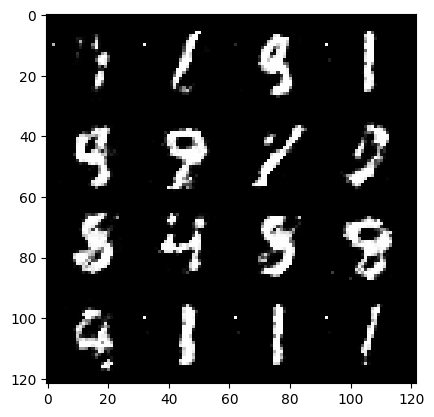

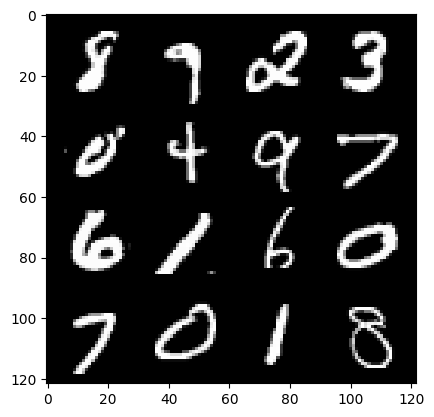

209: step 100800 / Gen loss: 1.2726034760475162 / Disc loss: 0.4435645713408786


  0%|          | 0/469 [00:00<?, ?it/s]

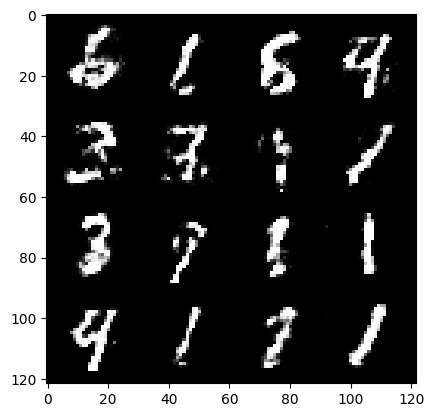

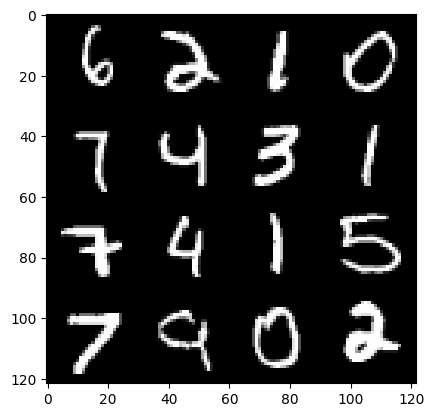

210: step 101100 / Gen loss: 1.3208704654375716 / Disc loss: 0.4248086146513621


  0%|          | 0/469 [00:00<?, ?it/s]

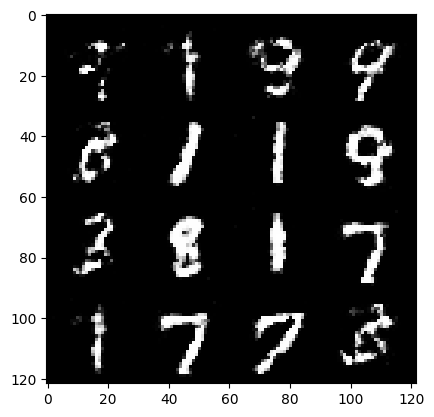

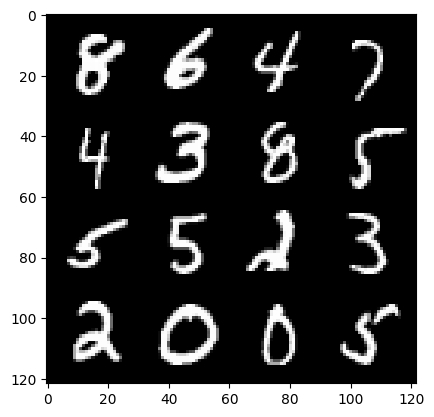

211: step 101400 / Gen loss: 1.2880558168888088 / Disc loss: 0.4475179528196651


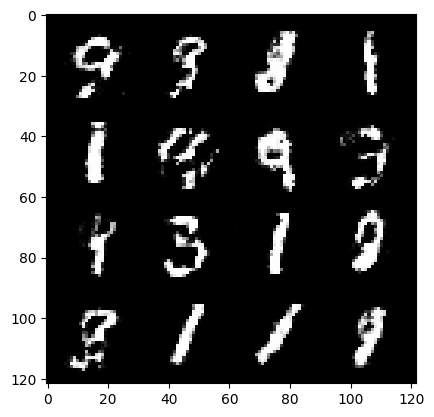

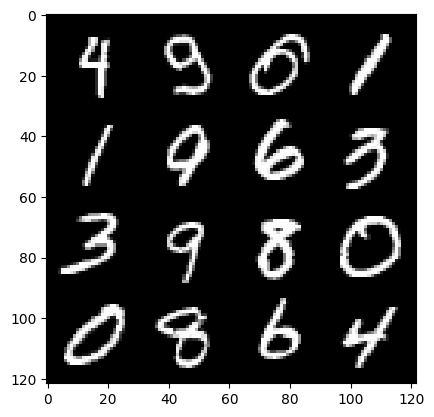

211: step 101700 / Gen loss: 1.3076210677623739 / Disc loss: 0.4446468197305995


  0%|          | 0/469 [00:00<?, ?it/s]

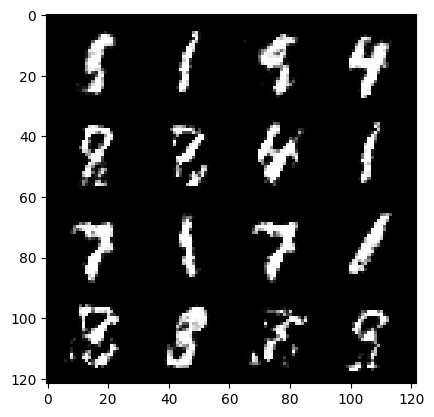

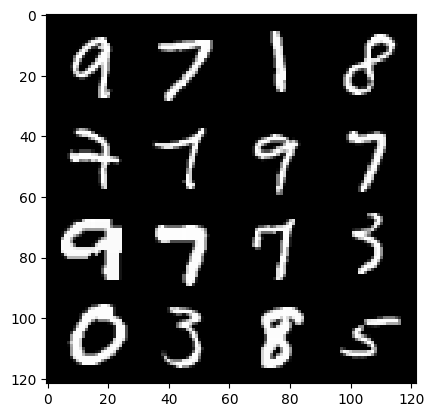

212: step 102000 / Gen loss: 1.3494911897182462 / Disc loss: 0.43283885816733036


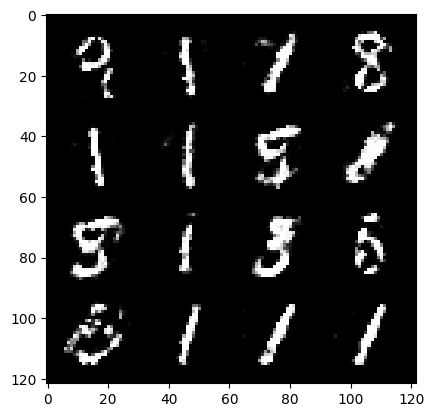

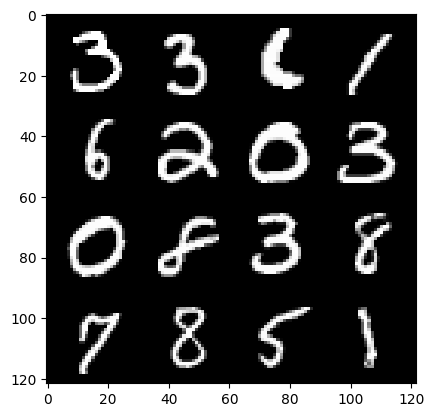

212: step 102300 / Gen loss: 1.346854269107183 / Disc loss: 0.42698331167300546


  0%|          | 0/469 [00:00<?, ?it/s]

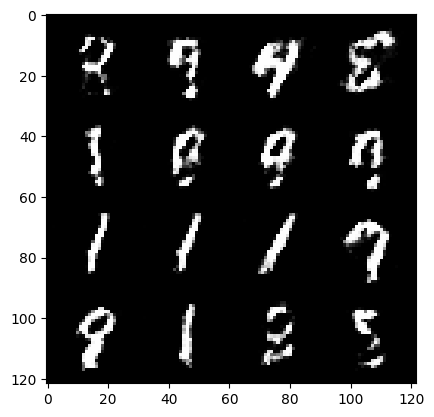

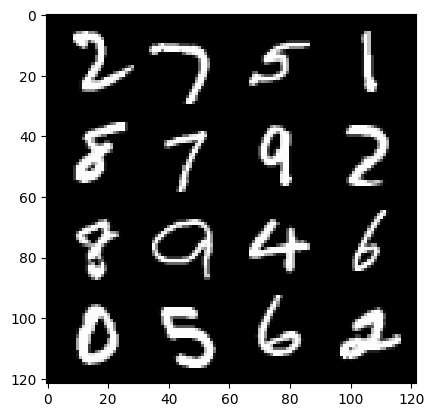

213: step 102600 / Gen loss: 1.3211763207117715 / Disc loss: 0.4364899716774618


  0%|          | 0/469 [00:00<?, ?it/s]

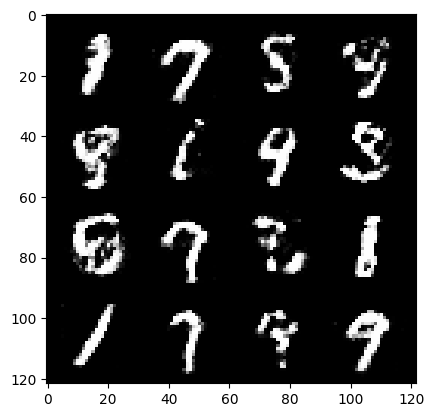

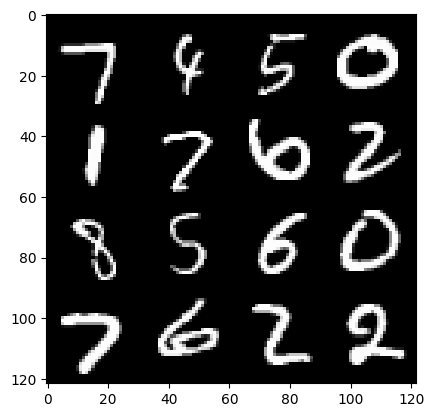

214: step 102900 / Gen loss: 1.3346699432531999 / Disc loss: 0.4370236125588411


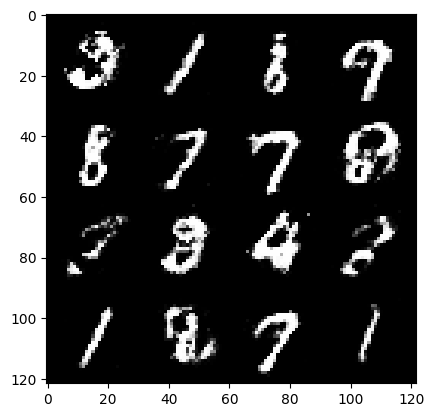

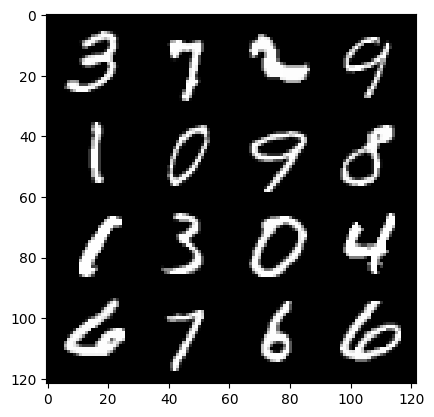

214: step 103200 / Gen loss: 1.258599615097046 / Disc loss: 0.4716691196958225


  0%|          | 0/469 [00:00<?, ?it/s]

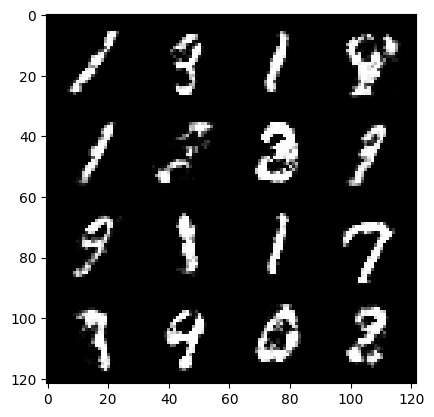

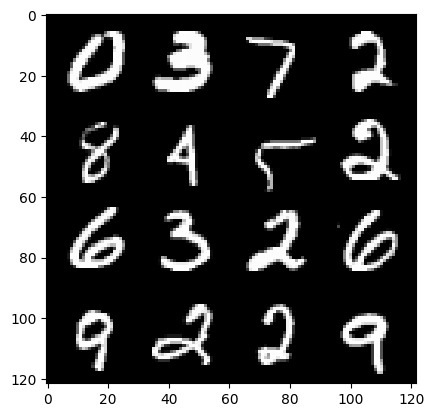

215: step 103500 / Gen loss: 1.3136308896541595 / Disc loss: 0.441762057542801


  0%|          | 0/469 [00:00<?, ?it/s]

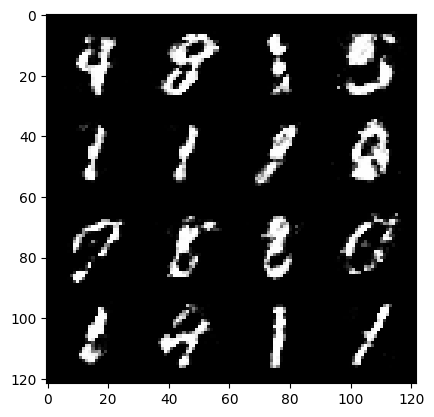

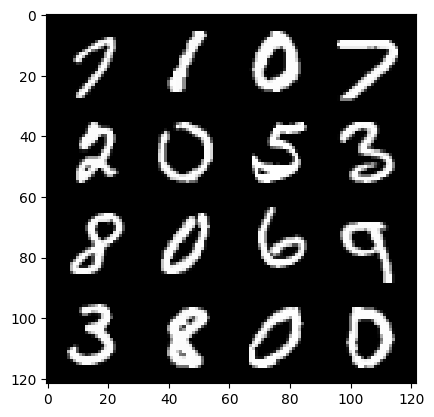

216: step 103800 / Gen loss: 1.3448964897791533 / Disc loss: 0.4341321922341983


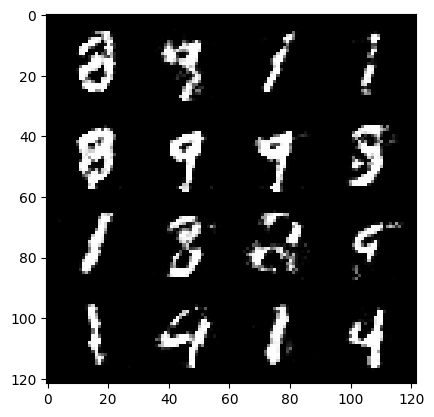

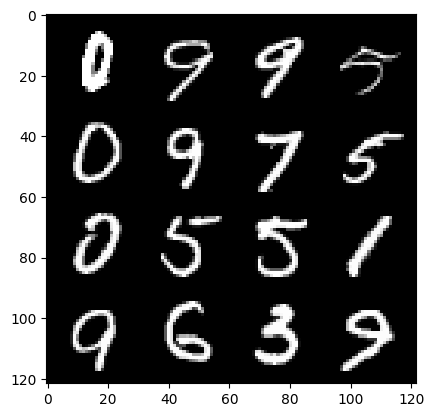

216: step 104100 / Gen loss: 1.3757654360930112 / Disc loss: 0.42411081294218705


  0%|          | 0/469 [00:00<?, ?it/s]

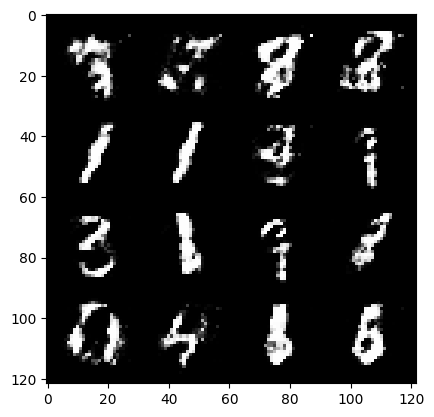

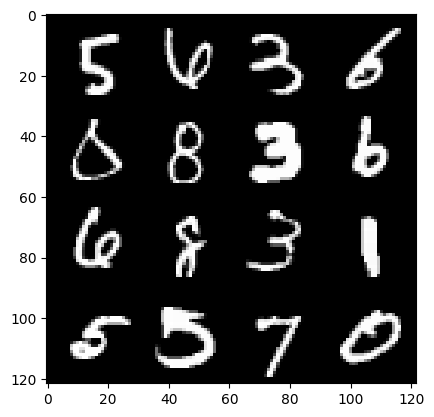

217: step 104400 / Gen loss: 1.3308792535463974 / Disc loss: 0.4353378553191818


  0%|          | 0/469 [00:00<?, ?it/s]

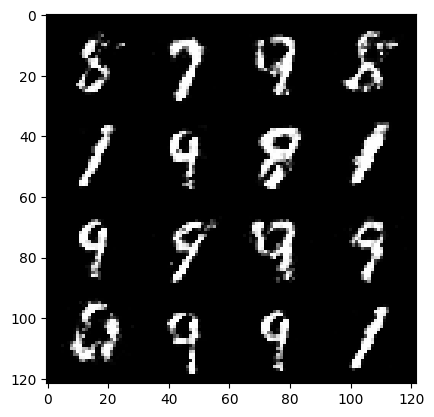

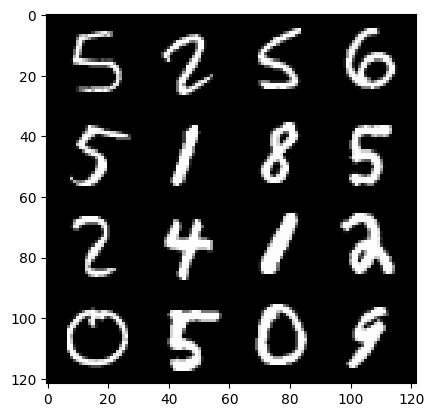

218: step 104700 / Gen loss: 1.3425855640570319 / Disc loss: 0.4398156682650244


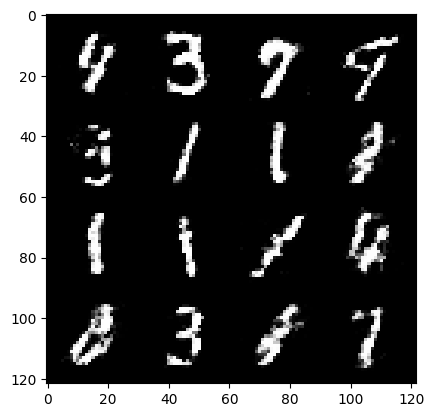

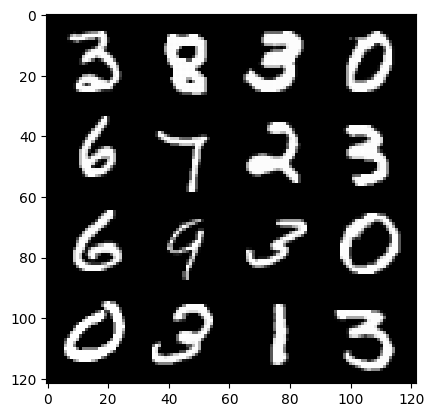

218: step 105000 / Gen loss: 1.339247042338053 / Disc loss: 0.4367551824450492


  0%|          | 0/469 [00:00<?, ?it/s]

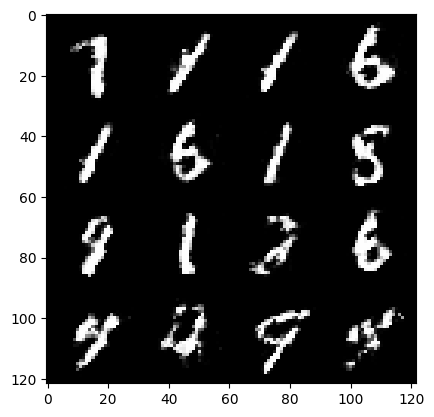

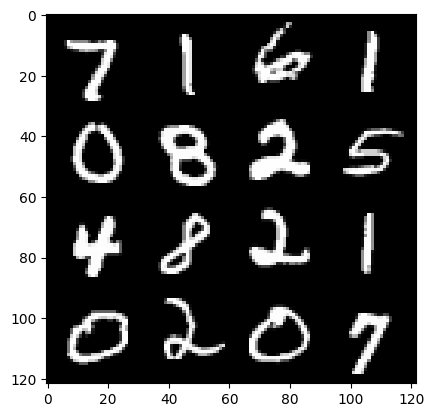

219: step 105300 / Gen loss: 1.3483415699005126 / Disc loss: 0.4301304882764818


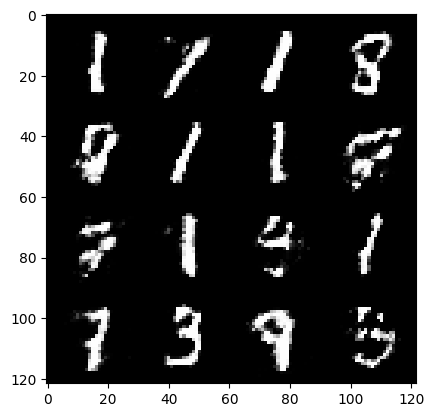

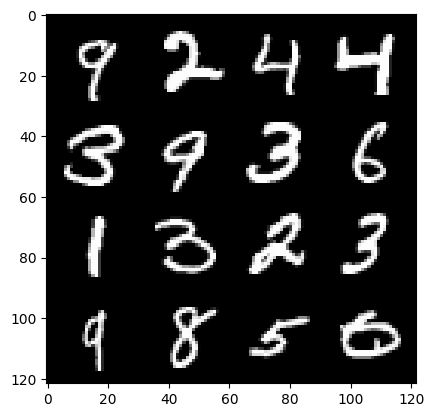

219: step 105600 / Gen loss: 1.2826431508859002 / Disc loss: 0.45417439828316386


  0%|          | 0/469 [00:00<?, ?it/s]

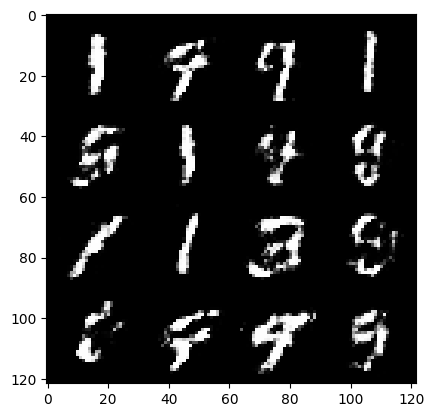

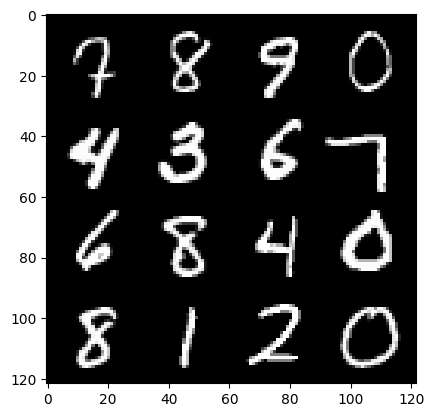

220: step 105900 / Gen loss: 1.2514647380510964 / Disc loss: 0.46121128698190056


  0%|          | 0/469 [00:00<?, ?it/s]

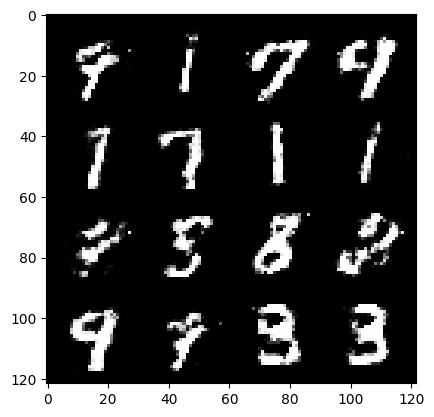

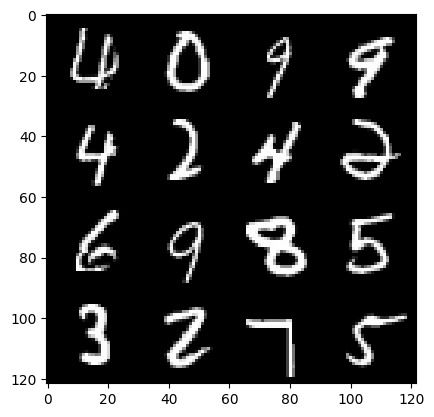

221: step 106200 / Gen loss: 1.2476954992612201 / Disc loss: 0.45898449112971623


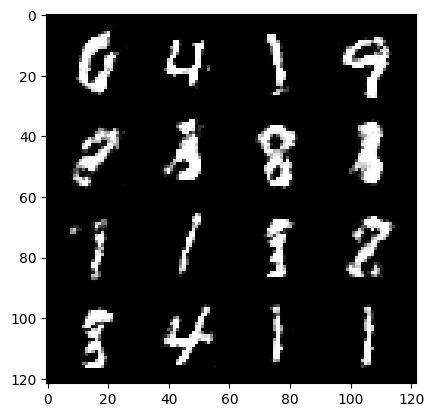

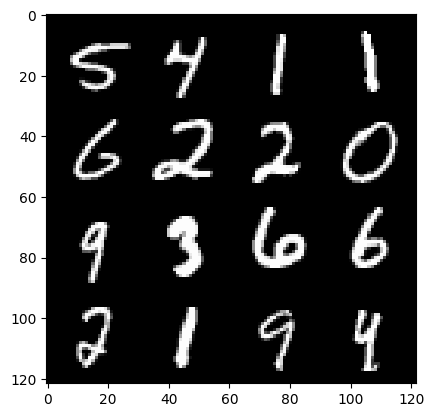

221: step 106500 / Gen loss: 1.2470990816752099 / Disc loss: 0.4548377683758736


  0%|          | 0/469 [00:00<?, ?it/s]

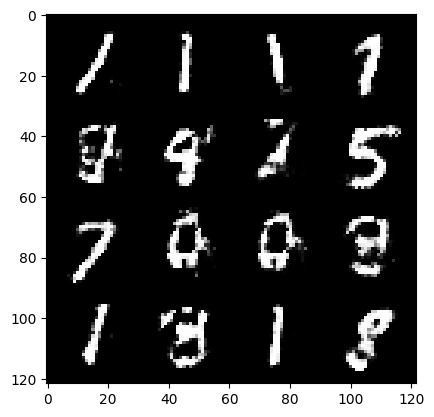

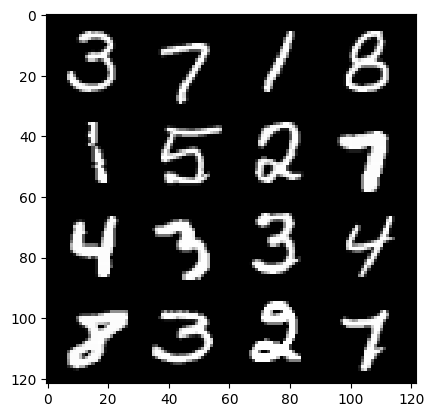

222: step 106800 / Gen loss: 1.2520312857627867 / Disc loss: 0.458375455836455


  0%|          | 0/469 [00:00<?, ?it/s]

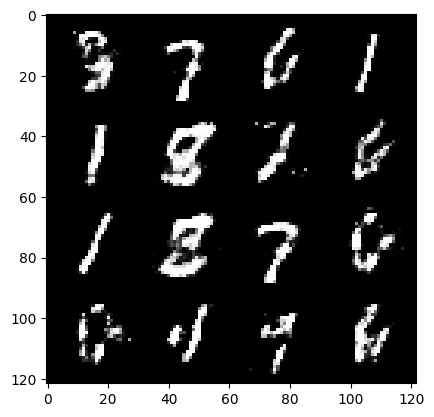

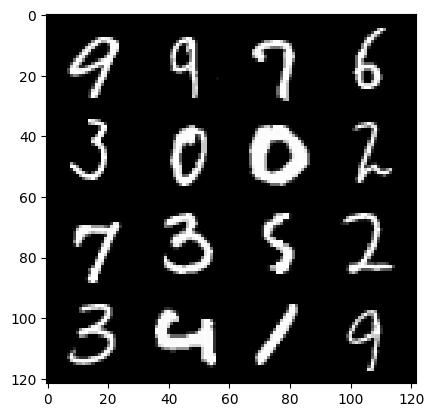

223: step 107100 / Gen loss: 1.2706046509742728 / Disc loss: 0.45580688695112914


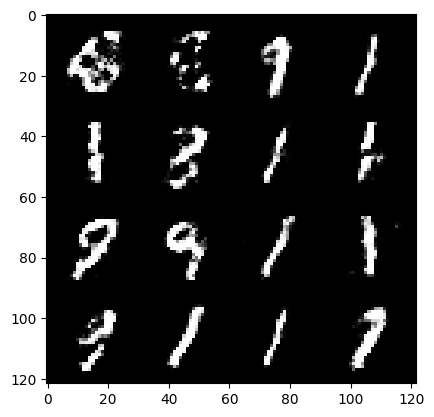

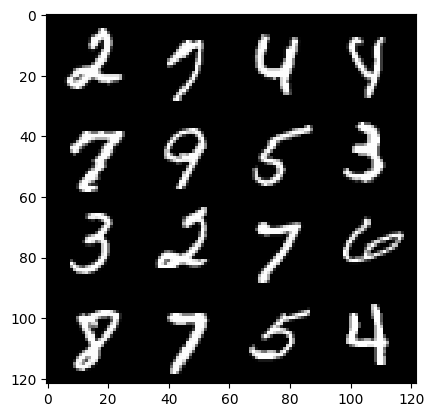

223: step 107400 / Gen loss: 1.3186204500993088 / Disc loss: 0.43550981223583235


  0%|          | 0/469 [00:00<?, ?it/s]

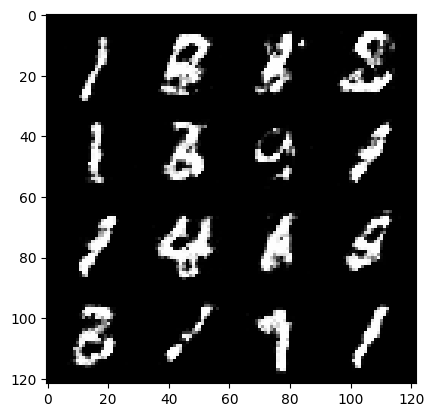

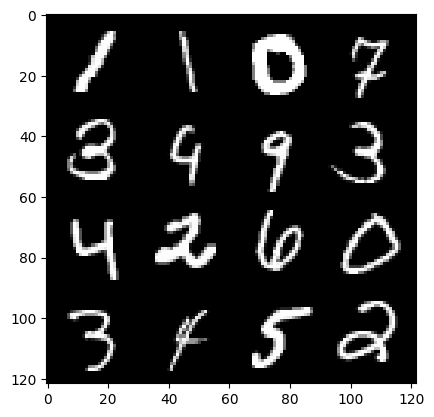

224: step 107700 / Gen loss: 1.2315638744831094 / Disc loss: 0.4769333311915397


  0%|          | 0/469 [00:00<?, ?it/s]

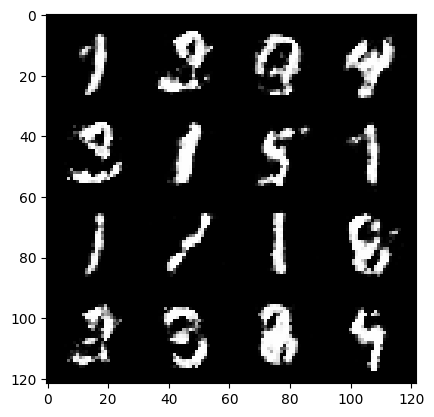

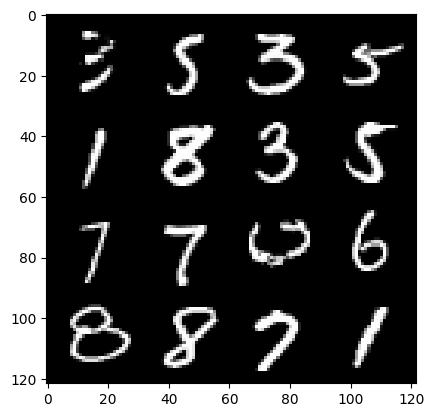

225: step 108000 / Gen loss: 1.2231148215134942 / Disc loss: 0.4639120848973593


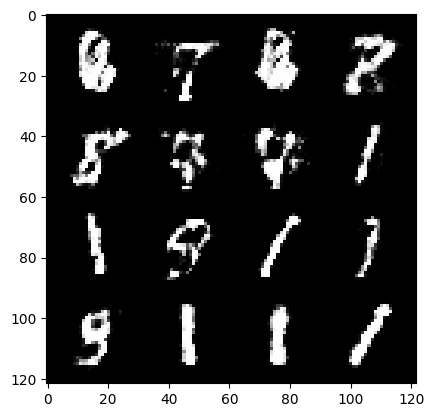

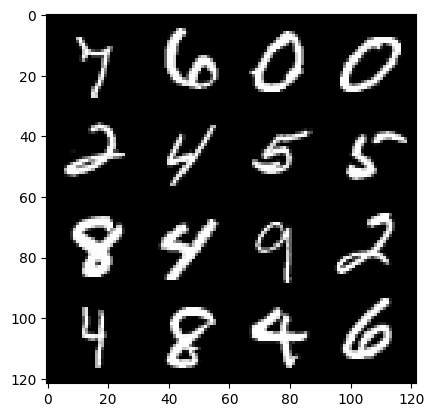

225: step 108300 / Gen loss: 1.2803223605950687 / Disc loss: 0.4506981506943699


  0%|          | 0/469 [00:00<?, ?it/s]

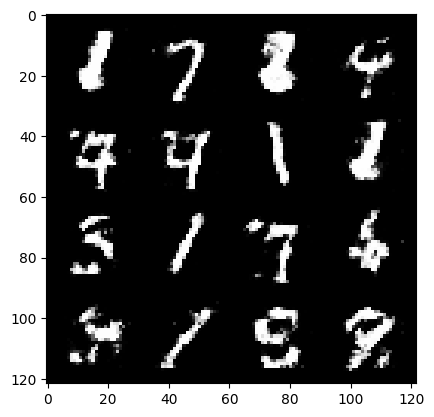

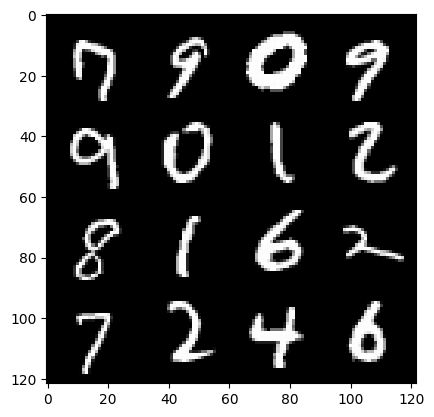

226: step 108600 / Gen loss: 1.2773139301935839 / Disc loss: 0.4497977227965992


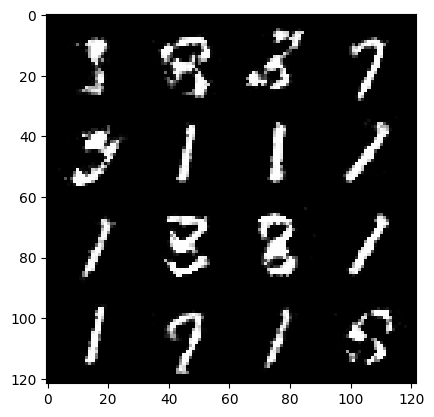

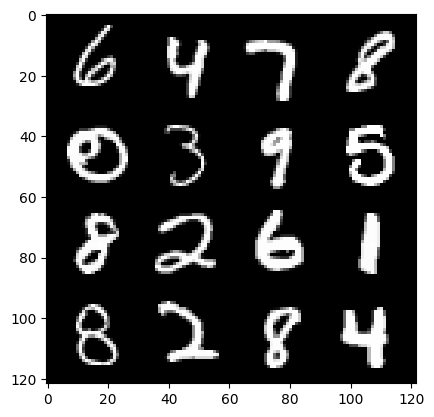

226: step 108900 / Gen loss: 1.3597787511348722 / Disc loss: 0.4334712768594422


  0%|          | 0/469 [00:00<?, ?it/s]

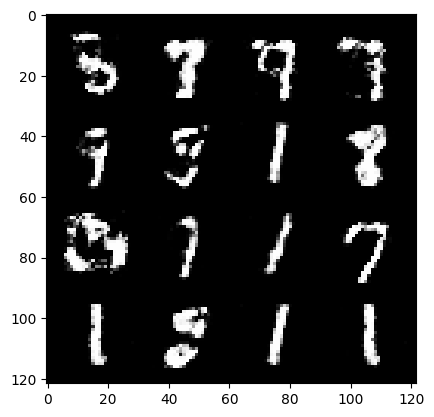

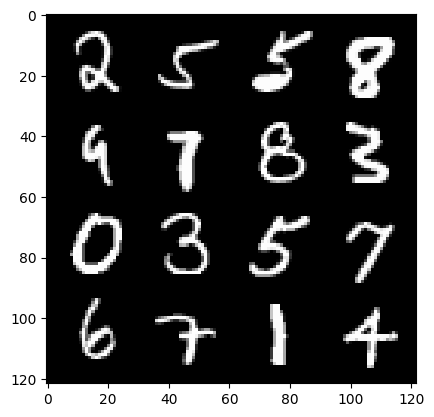

227: step 109200 / Gen loss: 1.3123298720518746 / Disc loss: 0.4480051792661348


  0%|          | 0/469 [00:00<?, ?it/s]

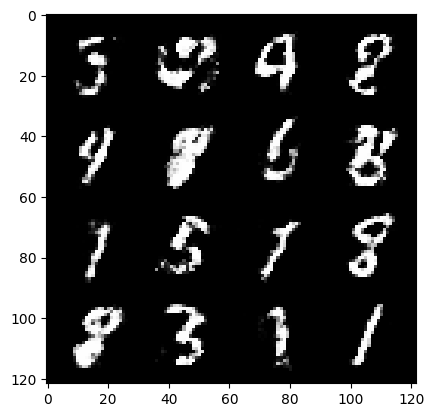

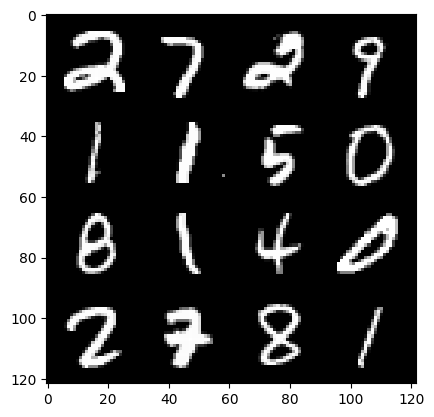

228: step 109500 / Gen loss: 1.3351168314615882 / Disc loss: 0.43872891088326776


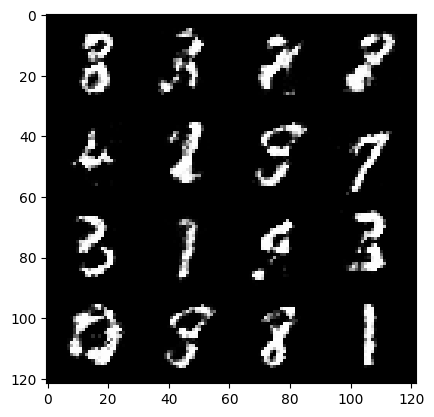

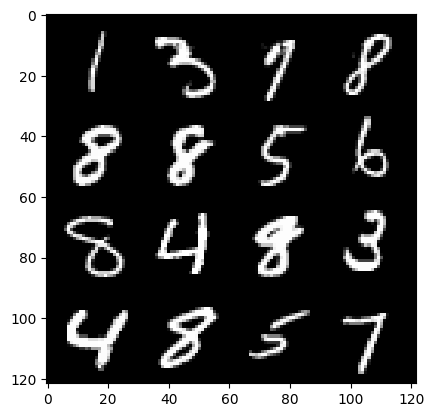

228: step 109800 / Gen loss: 1.3183734122912094 / Disc loss: 0.4275118003288907


  0%|          | 0/469 [00:00<?, ?it/s]

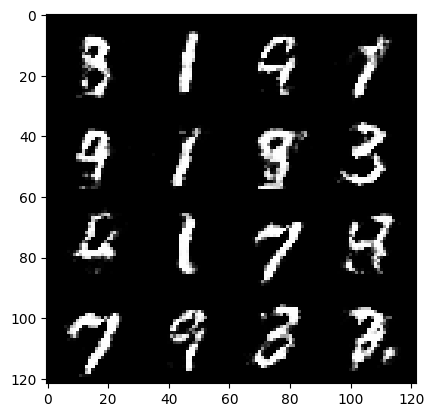

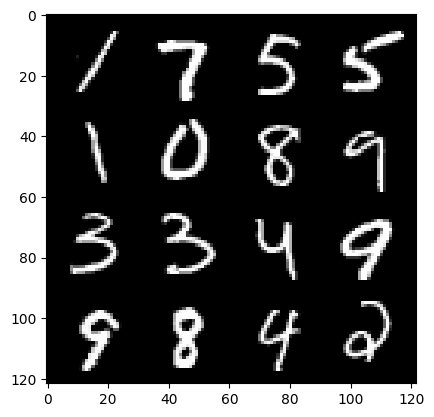

229: step 110100 / Gen loss: 1.3777962299187978 / Disc loss: 0.4179891131321591


  0%|          | 0/469 [00:00<?, ?it/s]

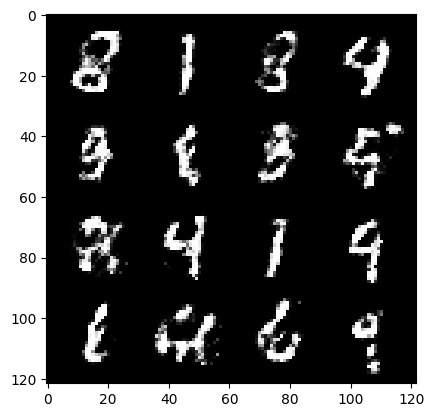

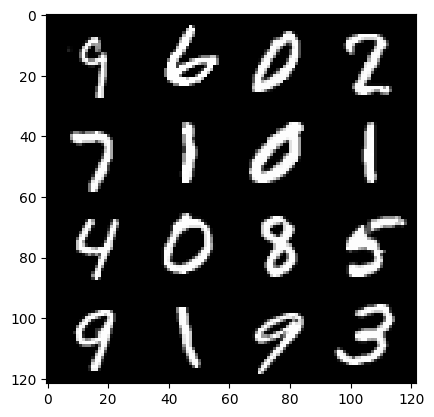

230: step 110400 / Gen loss: 1.3759301006793974 / Disc loss: 0.42911054233709955


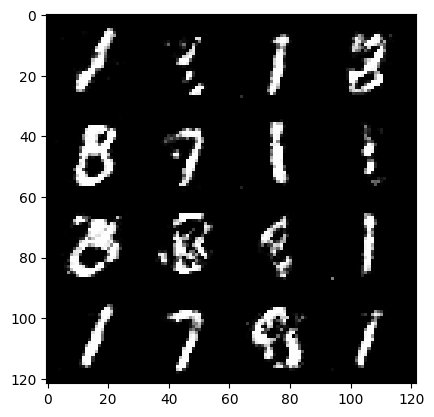

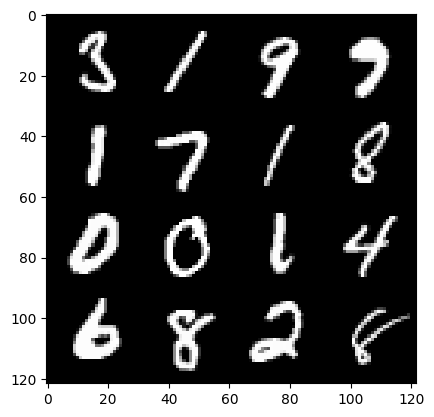

230: step 110700 / Gen loss: 1.3534658241271975 / Disc loss: 0.43539052148660007


  0%|          | 0/469 [00:00<?, ?it/s]

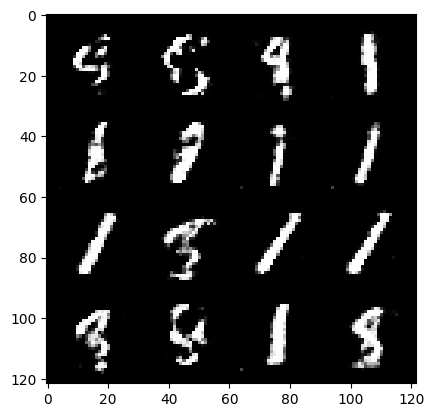

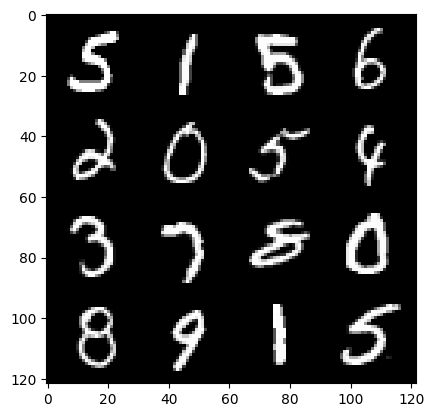

231: step 111000 / Gen loss: 1.3217419588565815 / Disc loss: 0.4379568087061244


  0%|          | 0/469 [00:00<?, ?it/s]

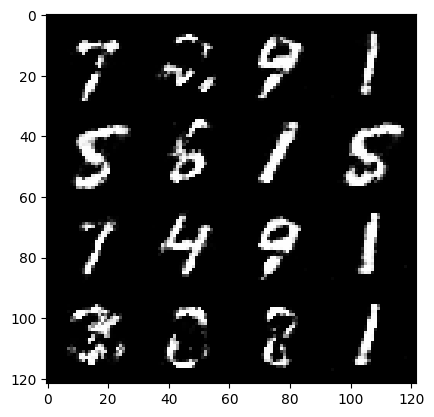

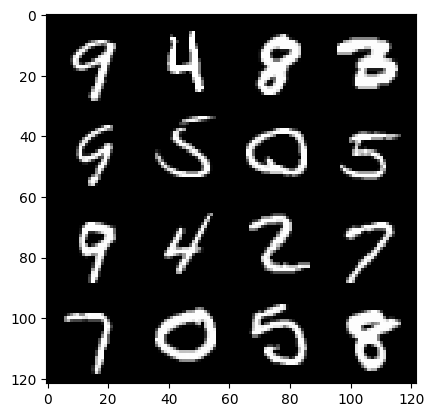

232: step 111300 / Gen loss: 1.3346178301175438 / Disc loss: 0.44011620521545397


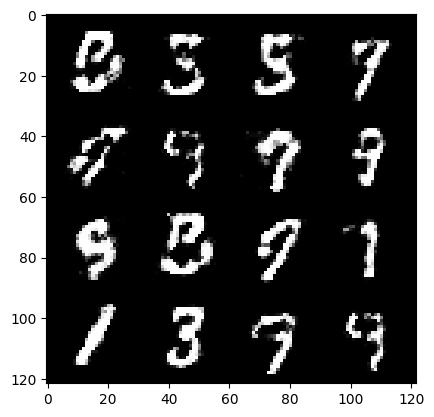

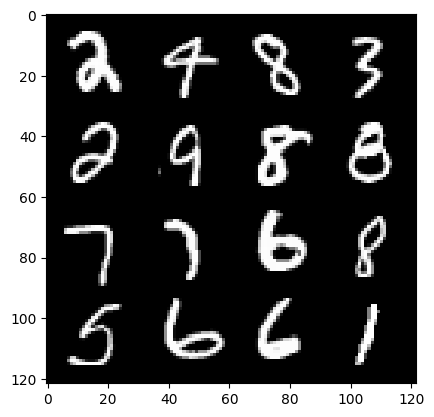

232: step 111600 / Gen loss: 1.283151153723398 / Disc loss: 0.4484794728954632


  0%|          | 0/469 [00:00<?, ?it/s]

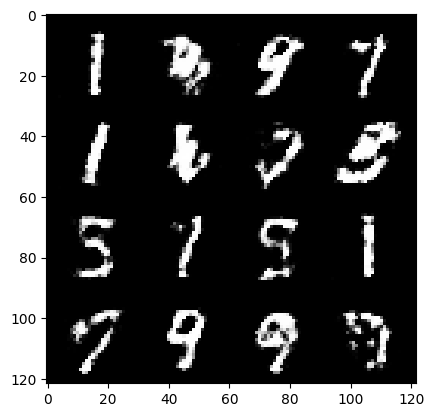

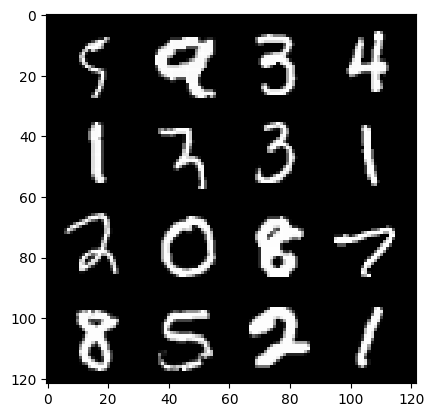

233: step 111900 / Gen loss: 1.3122694071133936 / Disc loss: 0.4400639704863232


  0%|          | 0/469 [00:00<?, ?it/s]

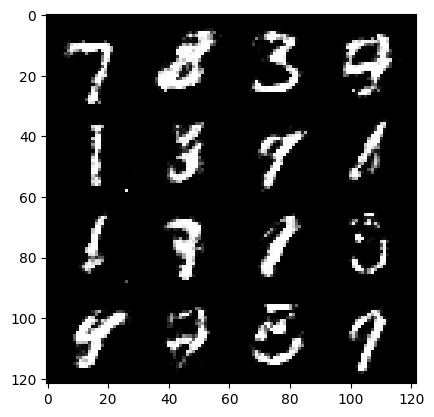

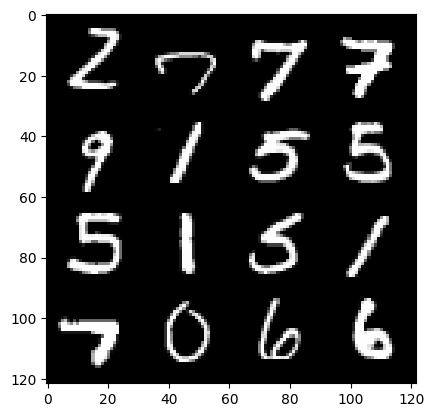

234: step 112200 / Gen loss: 1.2979330297311151 / Disc loss: 0.4464707112312313


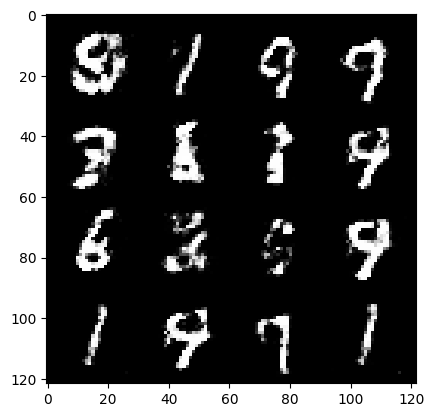

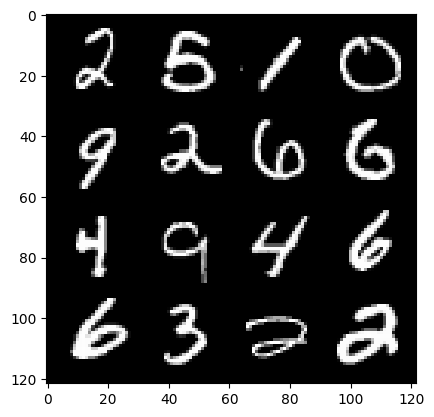

234: step 112500 / Gen loss: 1.2675959046681726 / Disc loss: 0.4506478279829025


  0%|          | 0/469 [00:00<?, ?it/s]

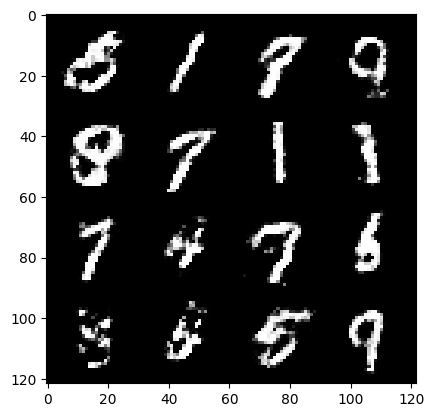

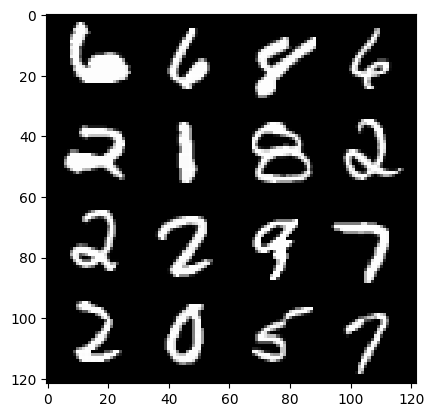

235: step 112800 / Gen loss: 1.4021272210280102 / Disc loss: 0.4159410733977958


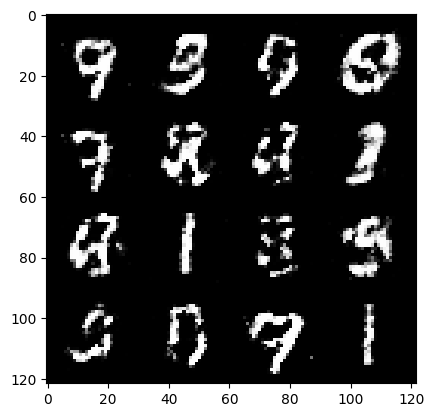

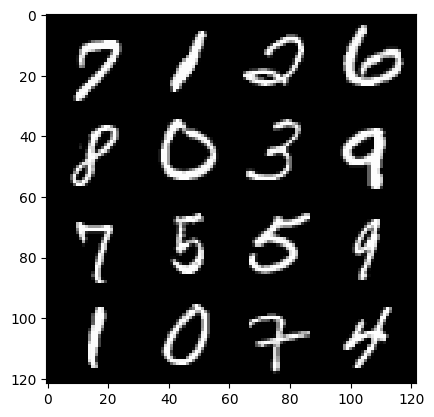

235: step 113100 / Gen loss: 1.3386919236183168 / Disc loss: 0.4290312910079957


  0%|          | 0/469 [00:00<?, ?it/s]

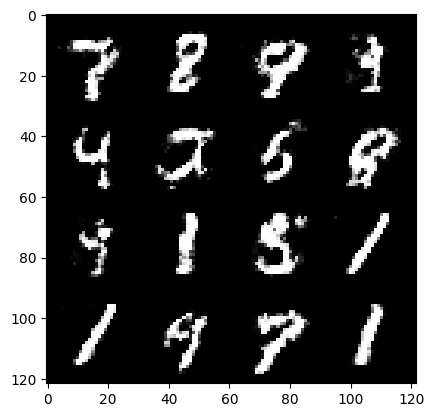

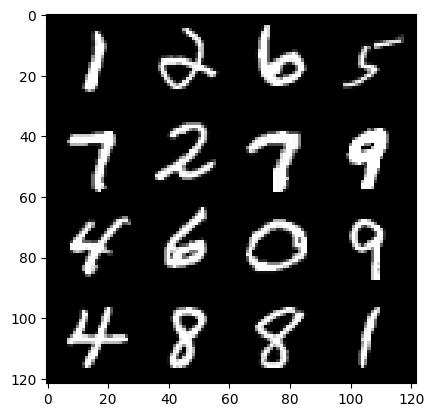

236: step 113400 / Gen loss: 1.3643379962444306 / Disc loss: 0.42487853159507083


  0%|          | 0/469 [00:00<?, ?it/s]

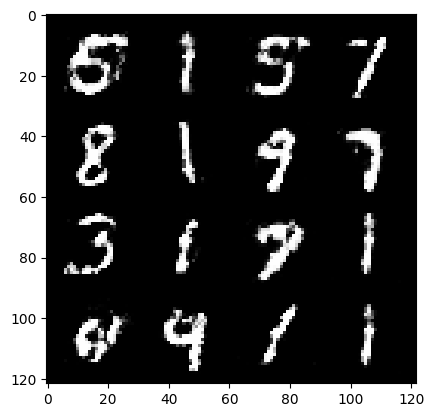

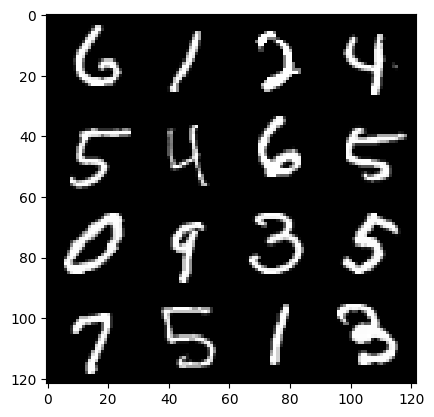

237: step 113700 / Gen loss: 1.2384865760803216 / Disc loss: 0.4763094486792881


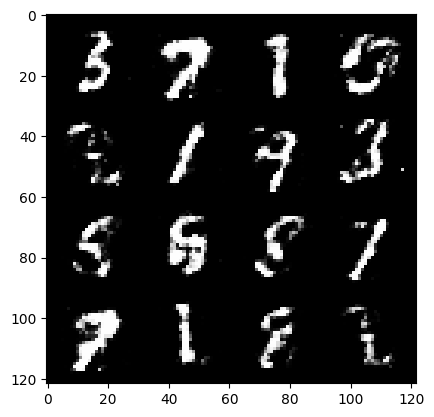

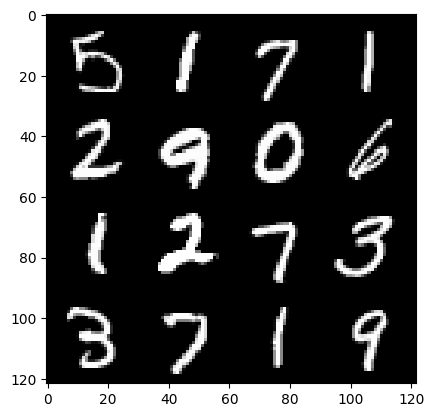

237: step 114000 / Gen loss: 1.2677320154507963 / Disc loss: 0.46479843894640605


  0%|          | 0/469 [00:00<?, ?it/s]

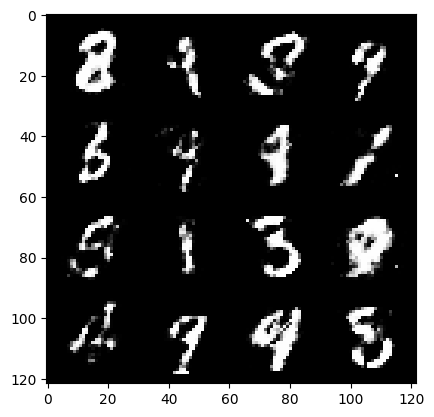

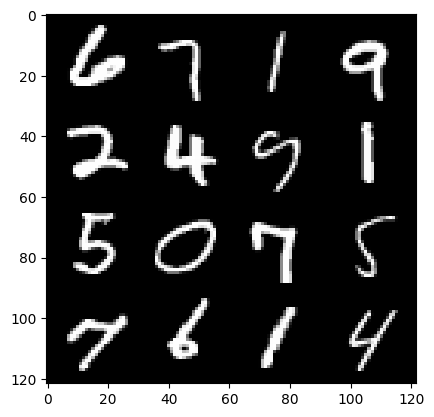

238: step 114300 / Gen loss: 1.2603424266974135 / Disc loss: 0.45939589112997065


  0%|          | 0/469 [00:00<?, ?it/s]

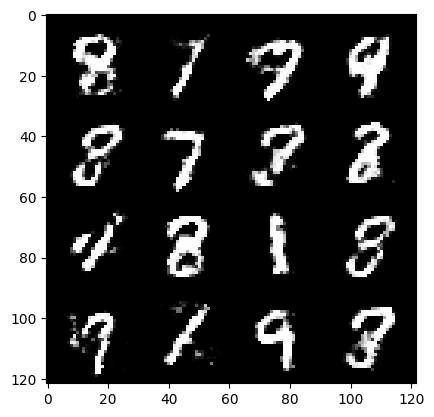

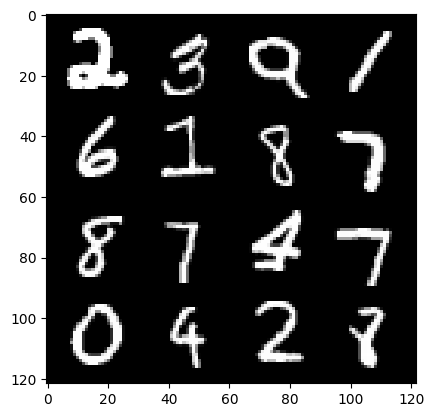

239: step 114600 / Gen loss: 1.2845689125855764 / Disc loss: 0.45205393473307287


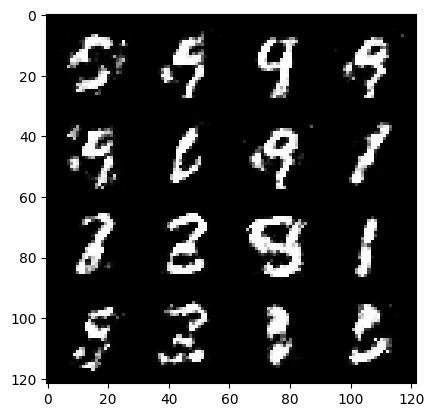

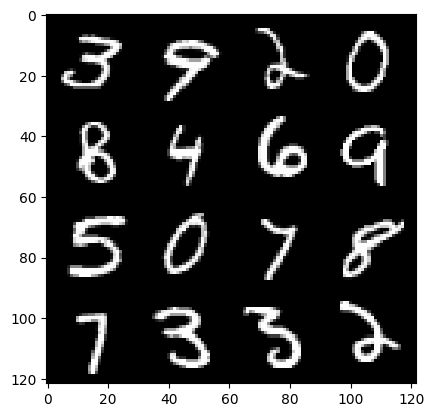

239: step 114900 / Gen loss: 1.2323906282583883 / Disc loss: 0.4723937682310743


  0%|          | 0/469 [00:00<?, ?it/s]

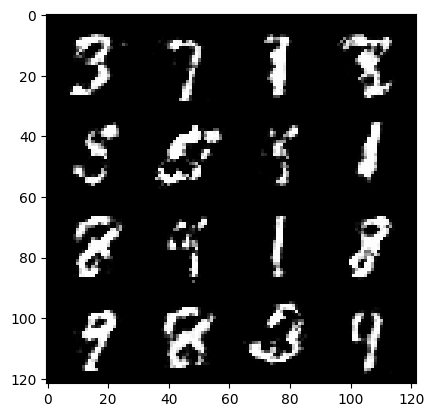

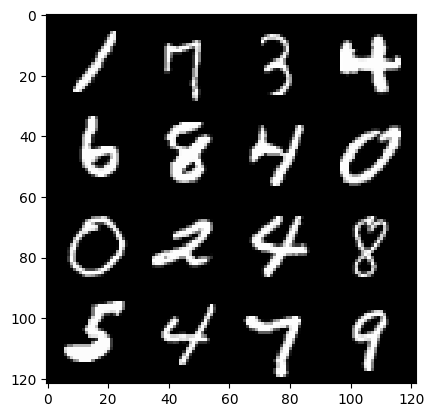

240: step 115200 / Gen loss: 1.289730415344238 / Disc loss: 0.4512213671207425


  0%|          | 0/469 [00:00<?, ?it/s]

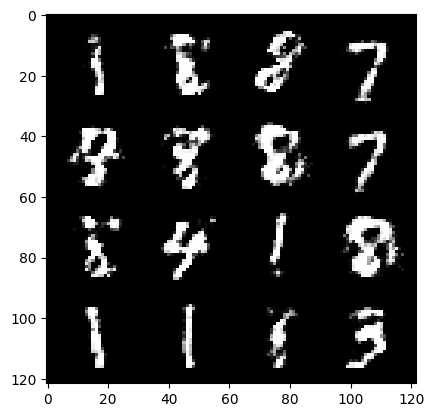

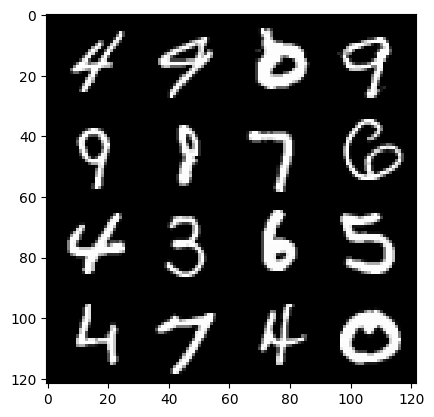

241: step 115500 / Gen loss: 1.2607221563657134 / Disc loss: 0.46126812438170106


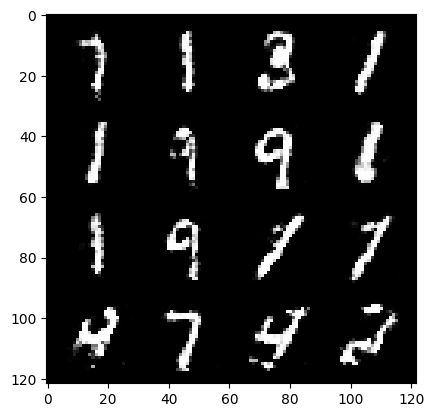

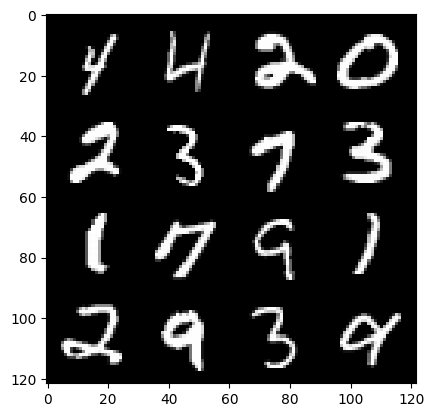

241: step 115800 / Gen loss: 1.3257771317164113 / Disc loss: 0.44566548109054605


  0%|          | 0/469 [00:00<?, ?it/s]

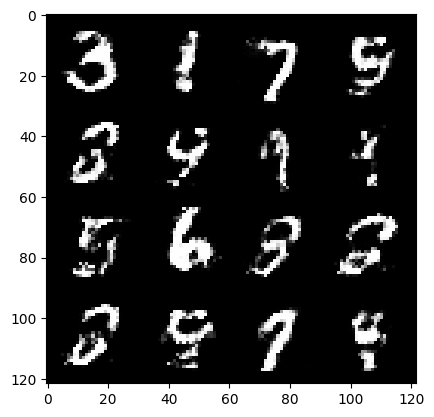

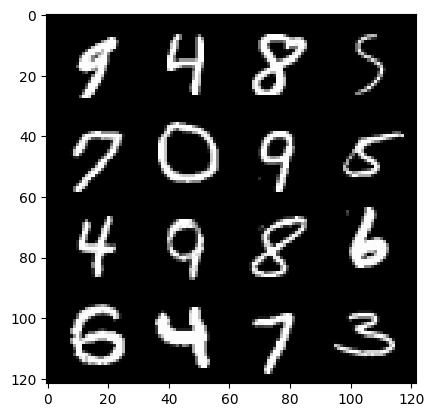

242: step 116100 / Gen loss: 1.2019369888305667 / Disc loss: 0.4766270592808723


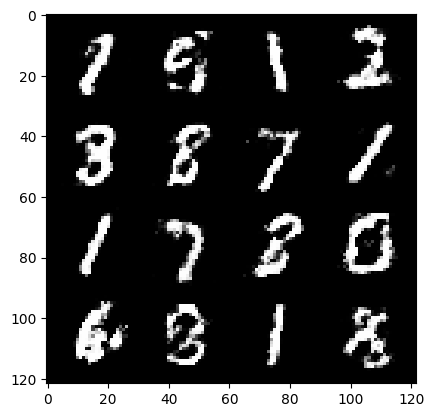

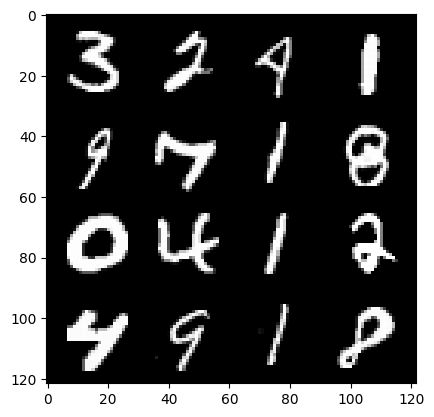

242: step 116400 / Gen loss: 1.2815113544464103 / Disc loss: 0.46006737212340026


  0%|          | 0/469 [00:00<?, ?it/s]

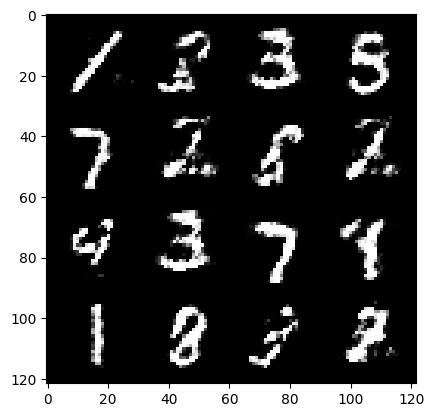

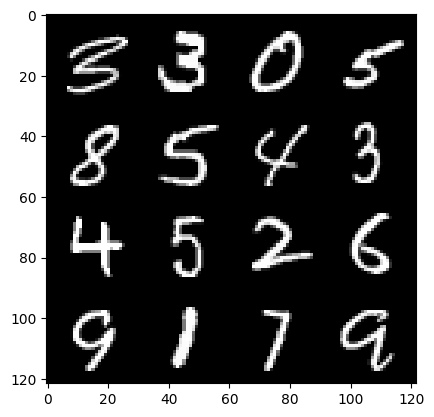

243: step 116700 / Gen loss: 1.290581842263539 / Disc loss: 0.46689083874225634


  0%|          | 0/469 [00:00<?, ?it/s]

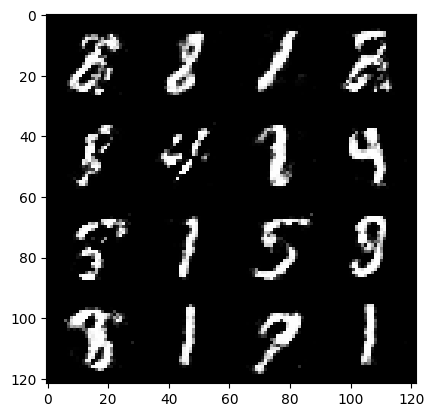

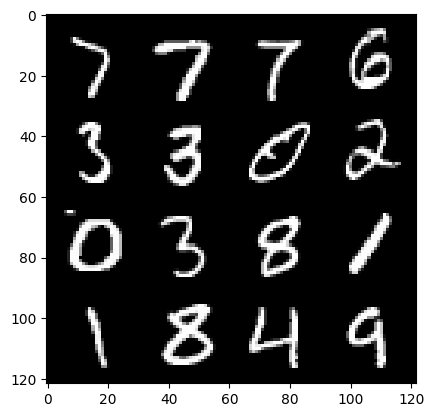

244: step 117000 / Gen loss: 1.2182746322949727 / Disc loss: 0.4759077184398967


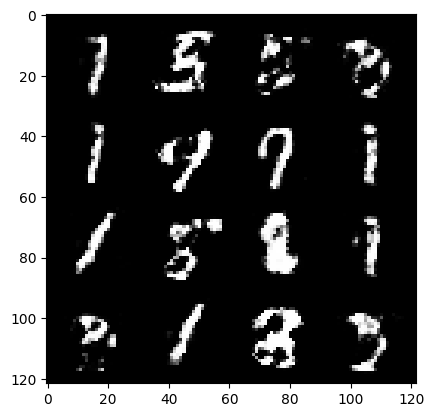

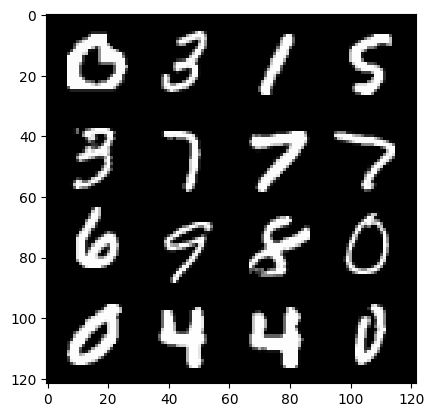

244: step 117300 / Gen loss: 1.2150112919012706 / Disc loss: 0.47250610659519804


  0%|          | 0/469 [00:00<?, ?it/s]

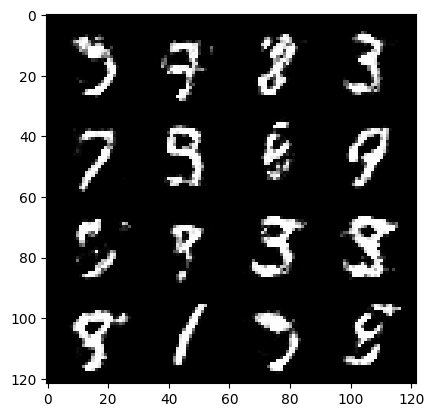

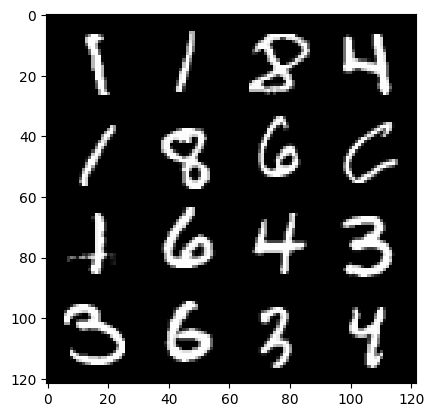

245: step 117600 / Gen loss: 1.2539080325762435 / Disc loss: 0.46459102461735413


  0%|          | 0/469 [00:00<?, ?it/s]

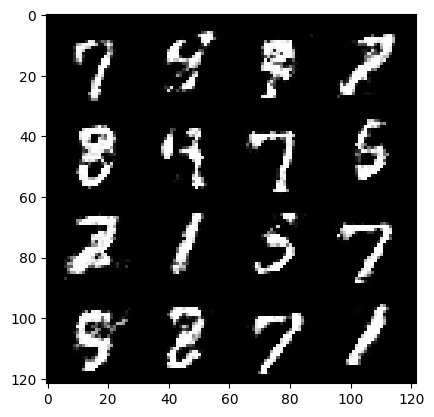

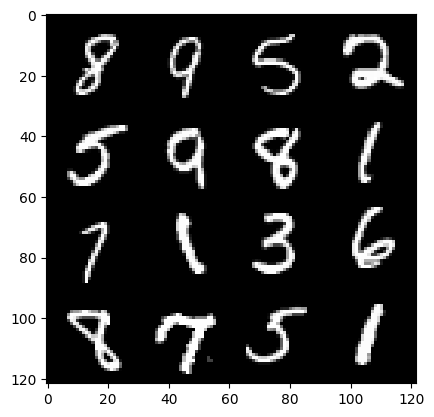

246: step 117900 / Gen loss: 1.2752023386955247 / Disc loss: 0.4633736726641655


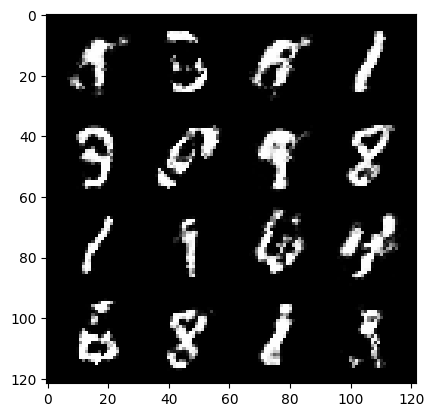

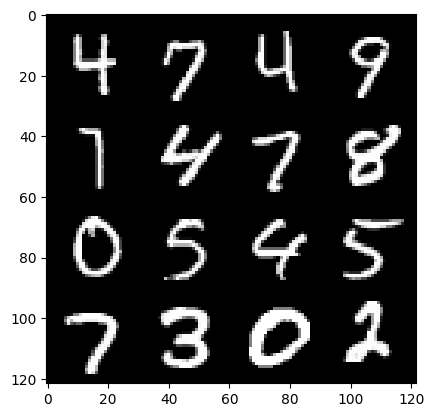

246: step 118200 / Gen loss: 1.2017164099216453 / Disc loss: 0.4826038284103074


  0%|          | 0/469 [00:00<?, ?it/s]

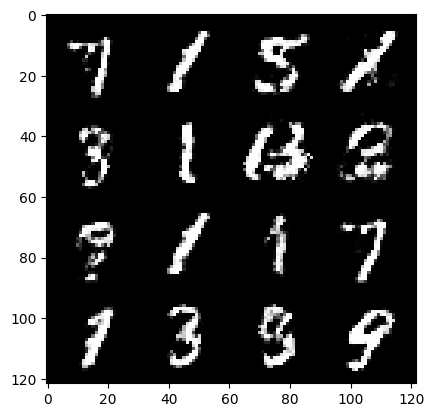

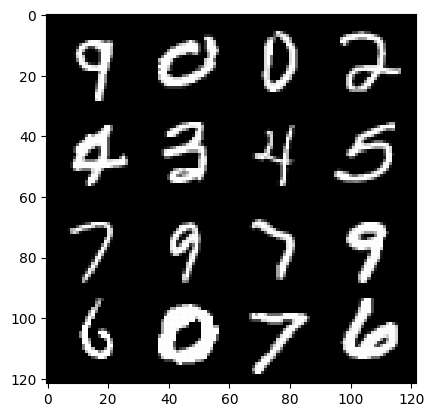

247: step 118500 / Gen loss: 1.252752113739649 / Disc loss: 0.47079114784797


  0%|          | 0/469 [00:00<?, ?it/s]

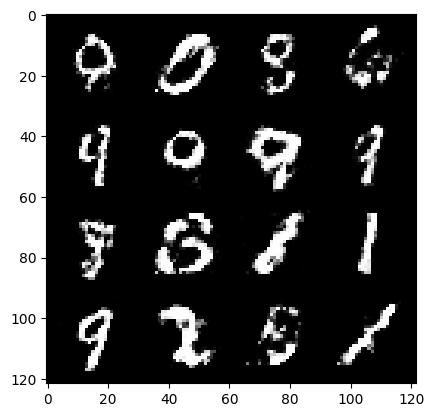

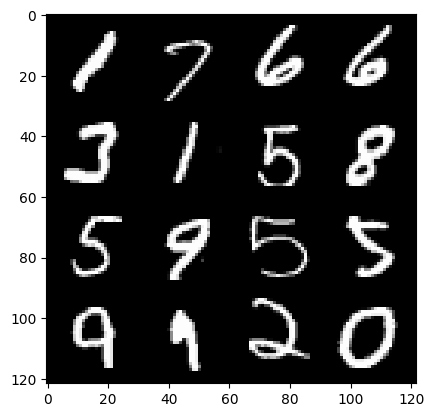

248: step 118800 / Gen loss: 1.233967591524125 / Disc loss: 0.4653254698713626


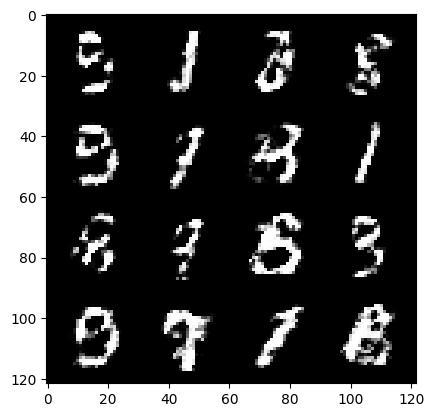

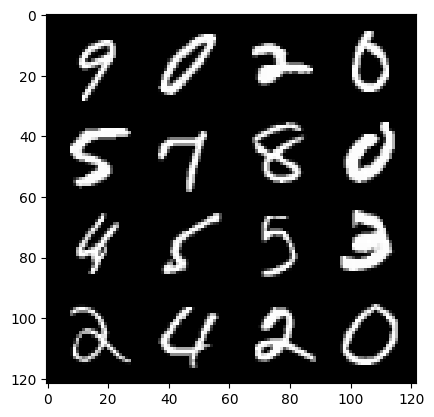

248: step 119100 / Gen loss: 1.2510138690471646 / Disc loss: 0.4648700106143952


  0%|          | 0/469 [00:00<?, ?it/s]

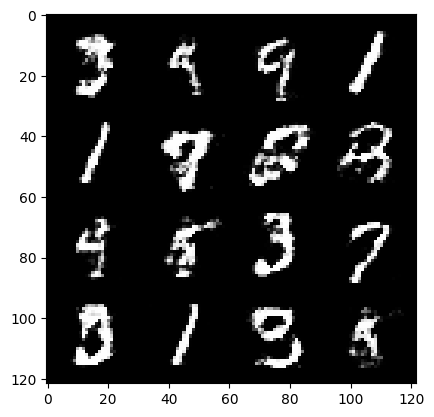

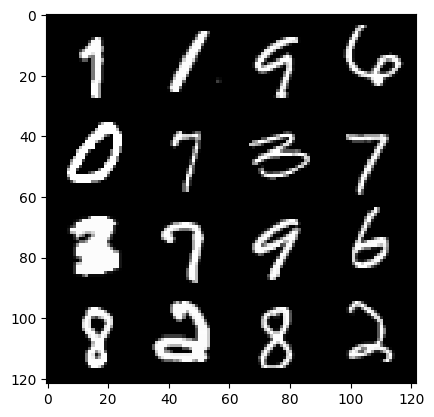

249: step 119400 / Gen loss: 1.2280834666887925 / Disc loss: 0.46238231947024666


  0%|          | 0/469 [00:00<?, ?it/s]

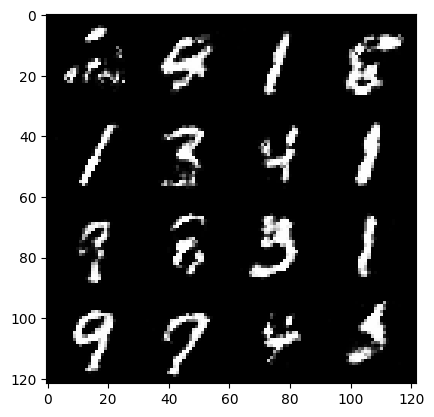

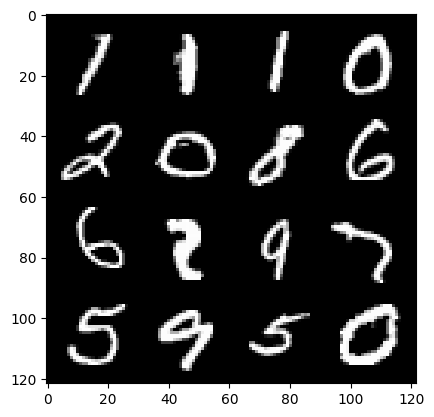

250: step 119700 / Gen loss: 1.2779796516895292 / Disc loss: 0.45594798445701606


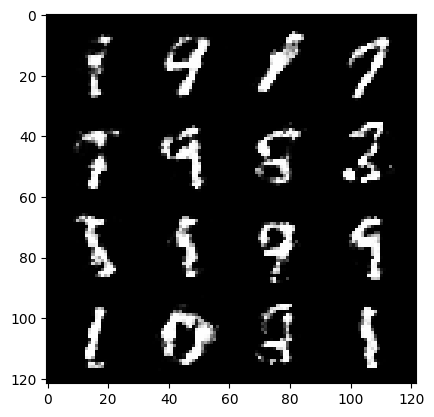

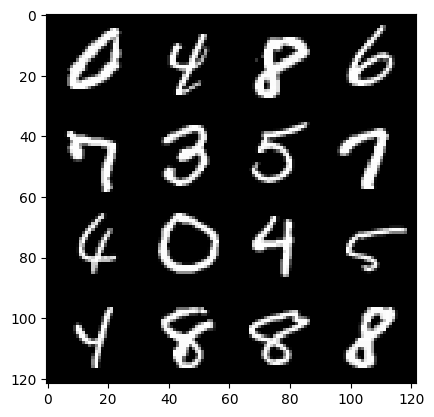

250: step 120000 / Gen loss: 1.242087078491847 / Disc loss: 0.47262724896272


  0%|          | 0/469 [00:00<?, ?it/s]

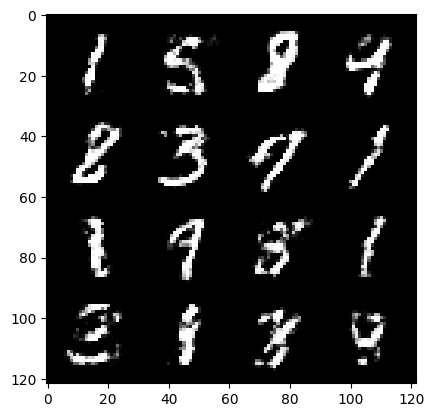

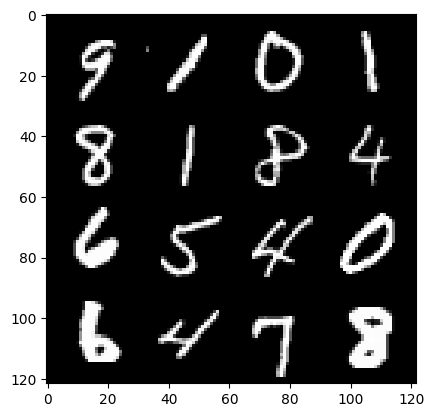

251: step 120300 / Gen loss: 1.2643918915589643 / Disc loss: 0.4587048880259197


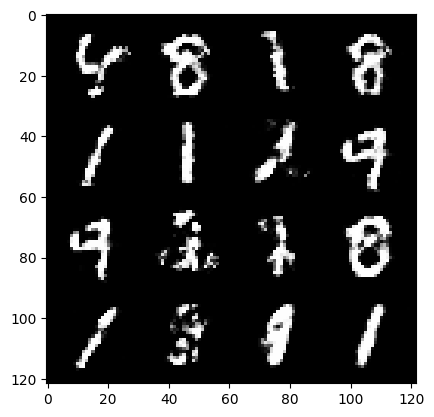

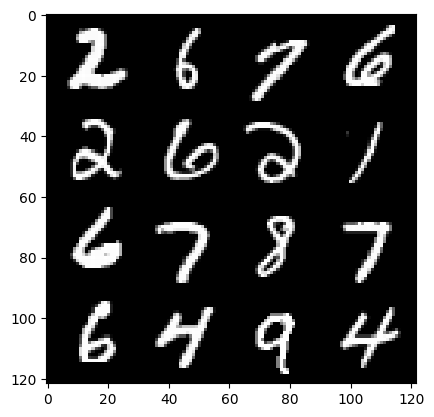

251: step 120600 / Gen loss: 1.245802532434463 / Disc loss: 0.4550223820408185


  0%|          | 0/469 [00:00<?, ?it/s]

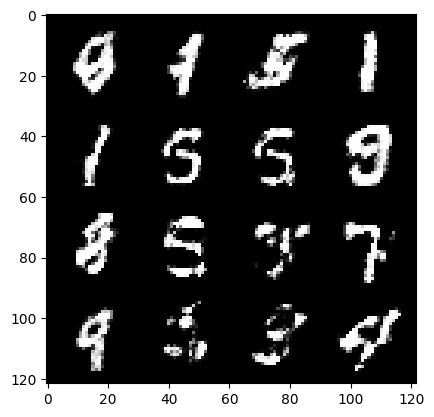

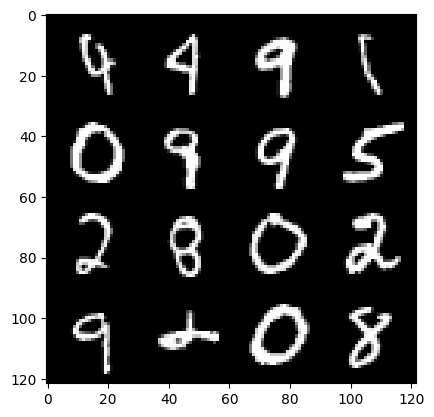

252: step 120900 / Gen loss: 1.2986132268110913 / Disc loss: 0.45211714158455507


  0%|          | 0/469 [00:00<?, ?it/s]

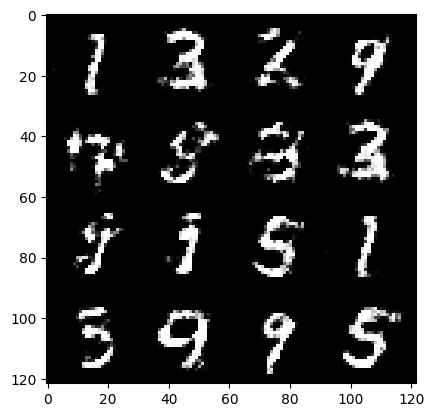

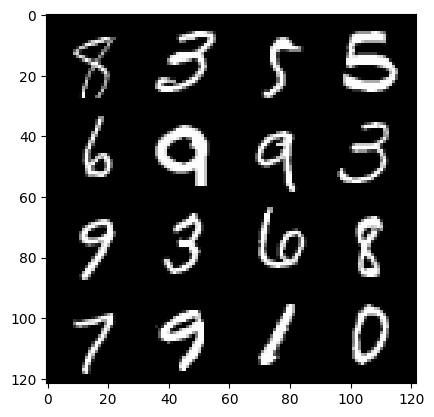

253: step 121200 / Gen loss: 1.2685150059064239 / Disc loss: 0.45588338881731005


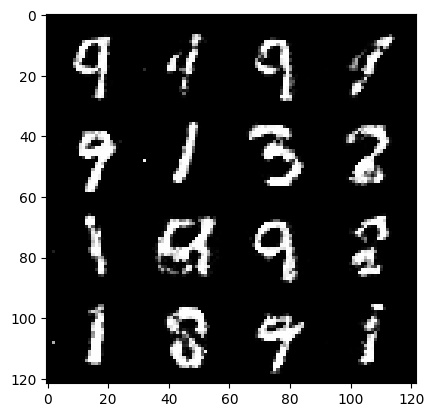

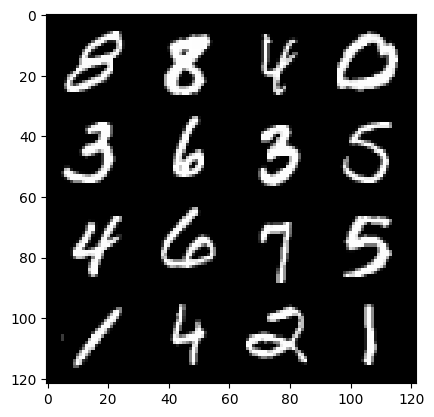

253: step 121500 / Gen loss: 1.2351381750901544 / Disc loss: 0.4680315852165226


  0%|          | 0/469 [00:00<?, ?it/s]

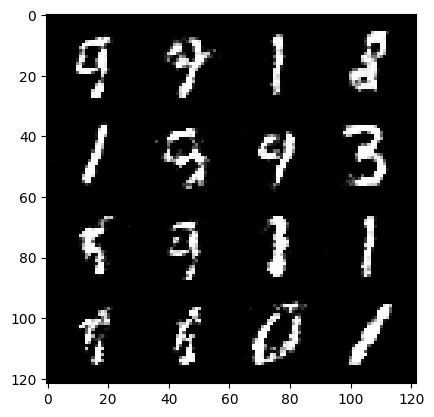

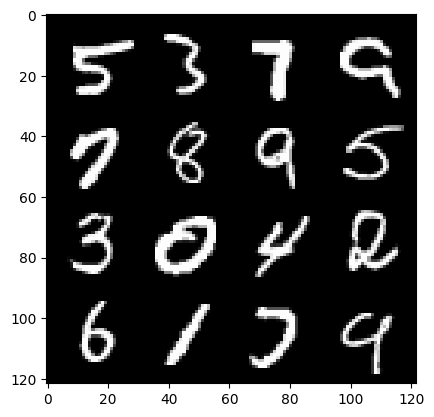

254: step 121800 / Gen loss: 1.309560162623723 / Disc loss: 0.44029622246821715


  0%|          | 0/469 [00:00<?, ?it/s]

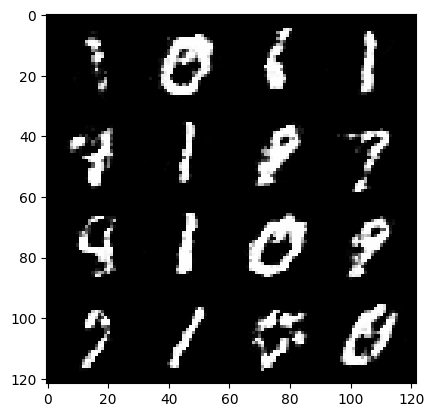

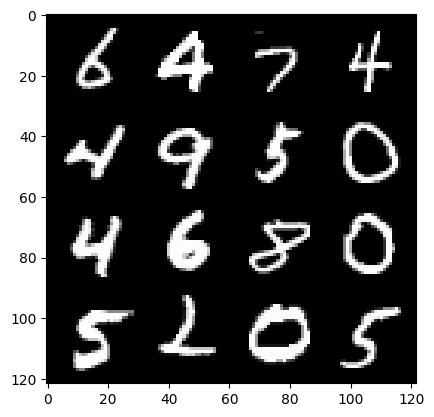

255: step 122100 / Gen loss: 1.3137228083610544 / Disc loss: 0.4421792518099147


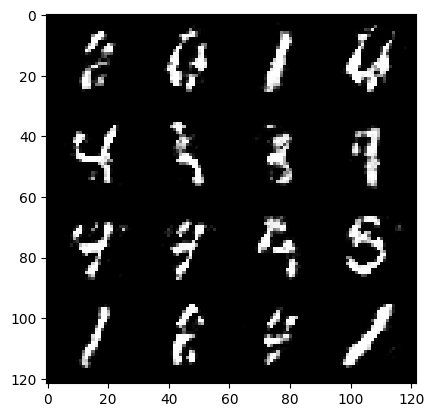

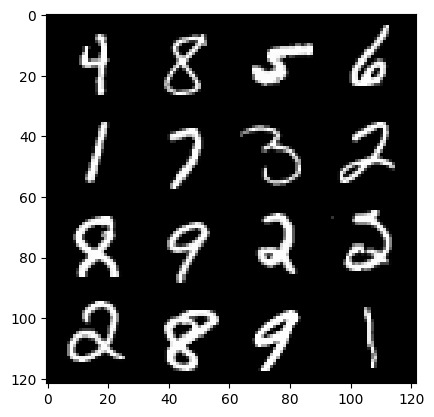

255: step 122400 / Gen loss: 1.3378721606731403 / Disc loss: 0.4266958395640056


  0%|          | 0/469 [00:00<?, ?it/s]

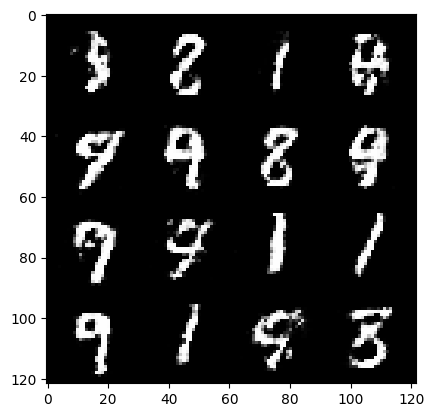

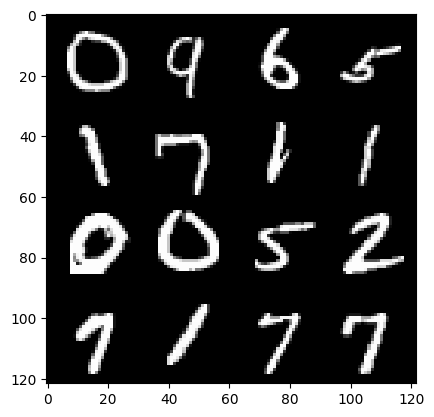

256: step 122700 / Gen loss: 1.247663697004319 / Disc loss: 0.4673413361112275


  0%|          | 0/469 [00:00<?, ?it/s]

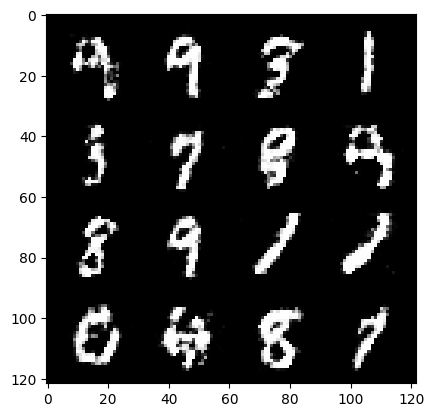

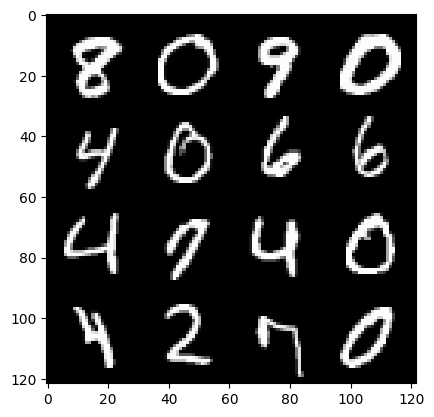

257: step 123000 / Gen loss: 1.2272982350985209 / Disc loss: 0.46885856499274564


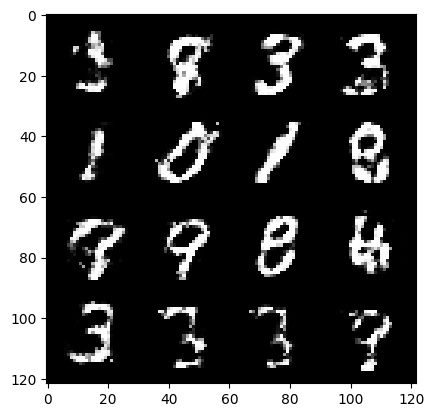

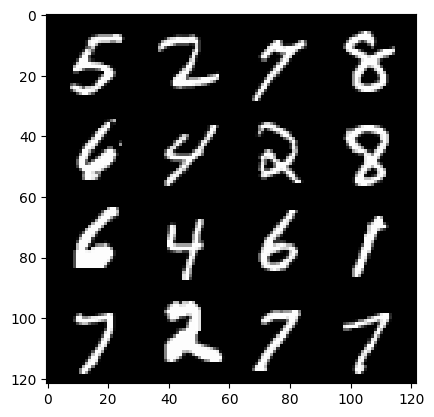

257: step 123300 / Gen loss: 1.1935112146536517 / Disc loss: 0.46814027776320805


  0%|          | 0/469 [00:00<?, ?it/s]

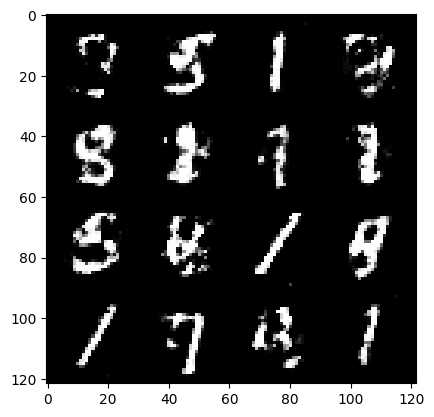

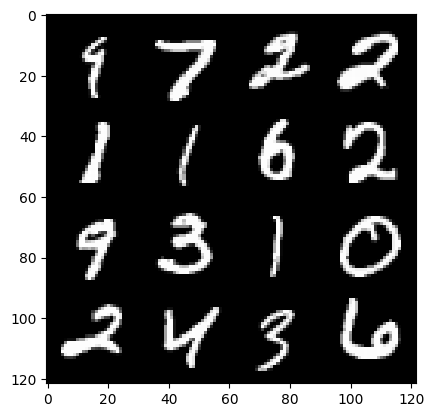

258: step 123600 / Gen loss: 1.20840021530787 / Disc loss: 0.4651164874434471


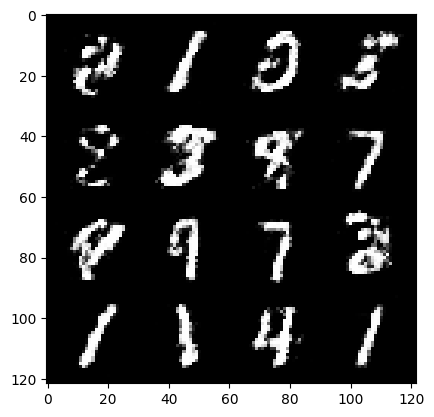

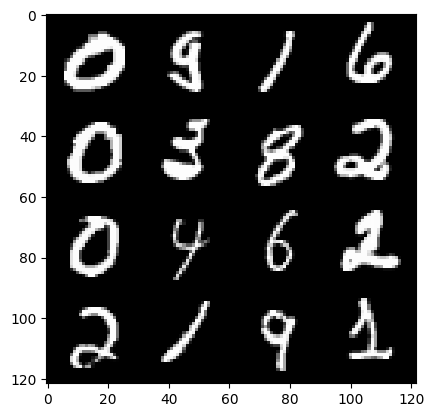

258: step 123900 / Gen loss: 1.2638279219468438 / Disc loss: 0.4672690639893212


  0%|          | 0/469 [00:00<?, ?it/s]

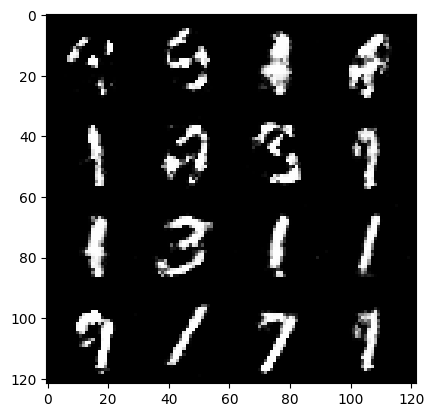

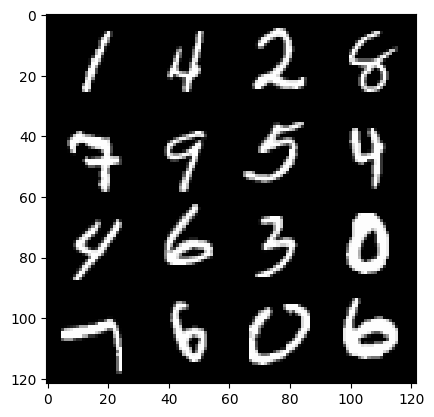

259: step 124200 / Gen loss: 1.3129906113942473 / Disc loss: 0.44803136914968494


  0%|          | 0/469 [00:00<?, ?it/s]

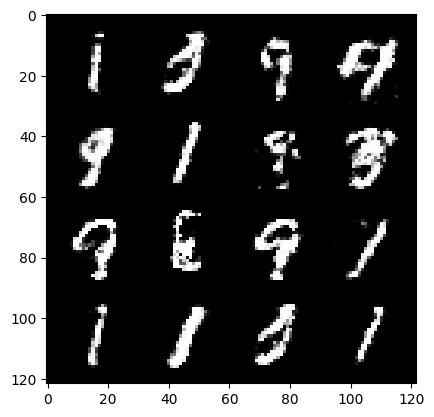

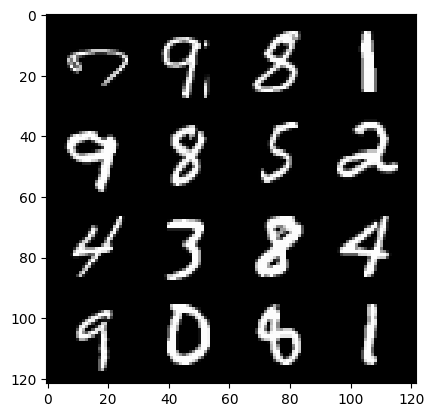

260: step 124500 / Gen loss: 1.2499733074506107 / Disc loss: 0.46132734398047115


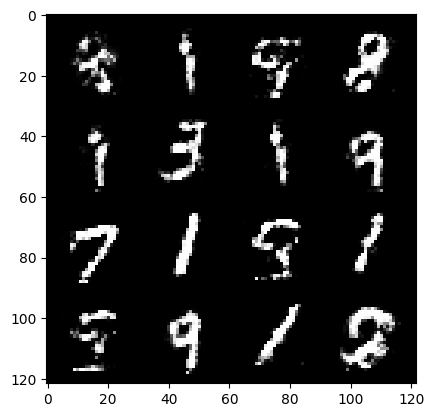

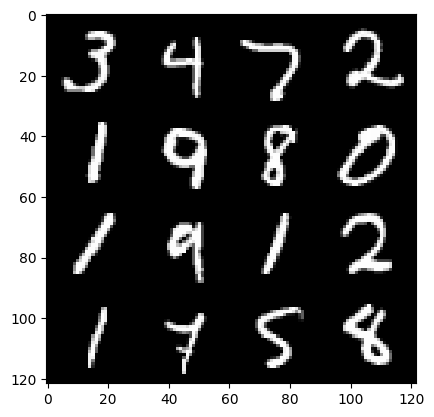

260: step 124800 / Gen loss: 1.2409580671787261 / Disc loss: 0.47005260596672693


  0%|          | 0/469 [00:00<?, ?it/s]

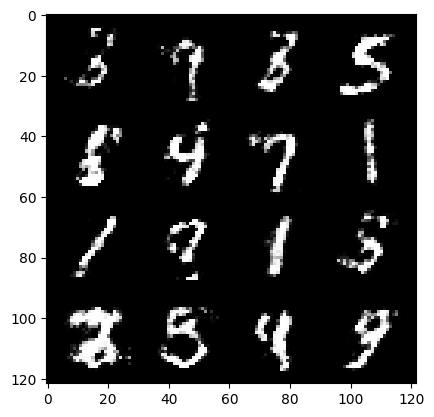

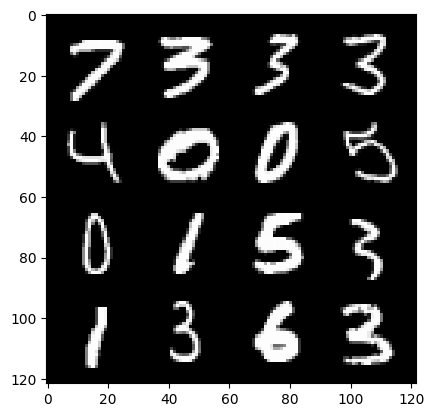

261: step 125100 / Gen loss: 1.3786739548047384 / Disc loss: 0.42555750320355107


  0%|          | 0/469 [00:00<?, ?it/s]

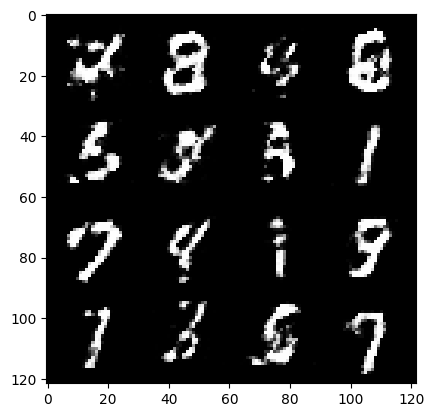

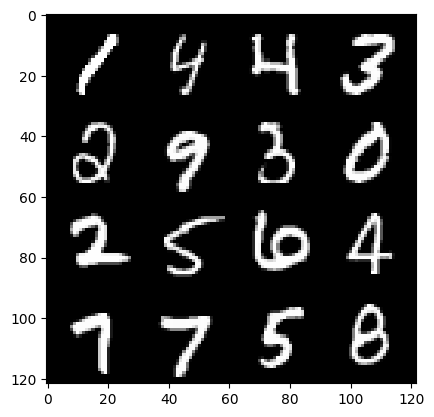

262: step 125400 / Gen loss: 1.3019805669784539 / Disc loss: 0.4446011869112649


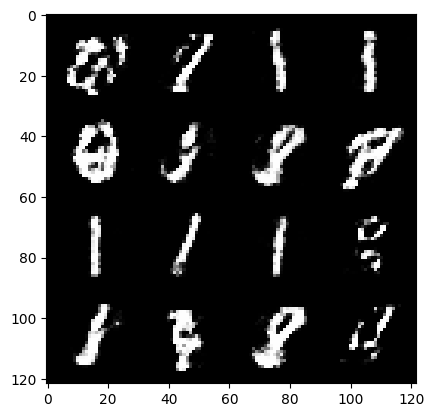

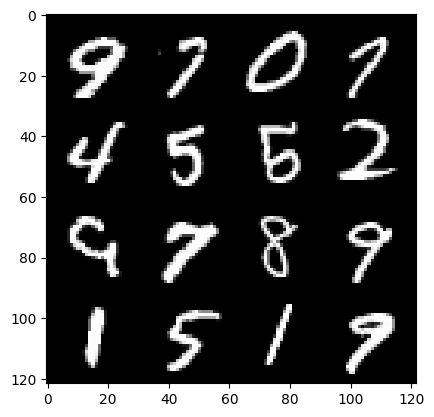

262: step 125700 / Gen loss: 1.2856338520844774 / Disc loss: 0.45266451726357154


  0%|          | 0/469 [00:00<?, ?it/s]

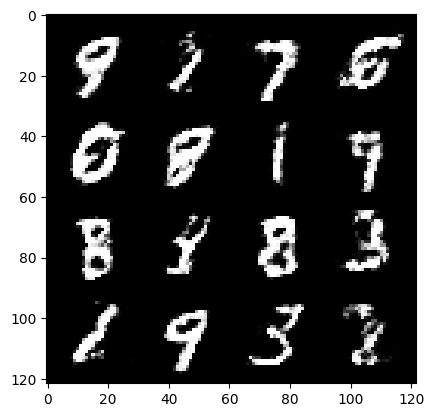

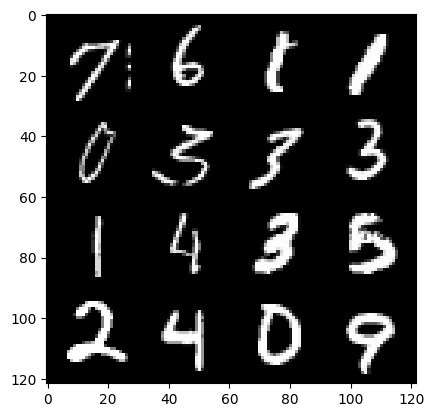

263: step 126000 / Gen loss: 1.2769672743479406 / Disc loss: 0.4564607319235803


  0%|          | 0/469 [00:00<?, ?it/s]

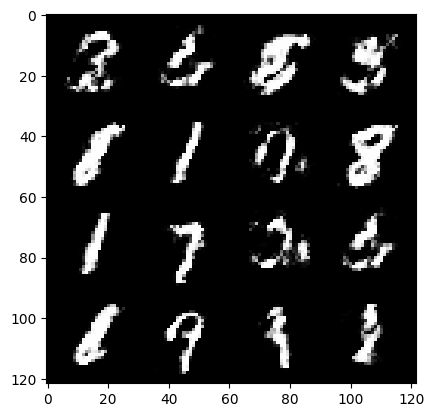

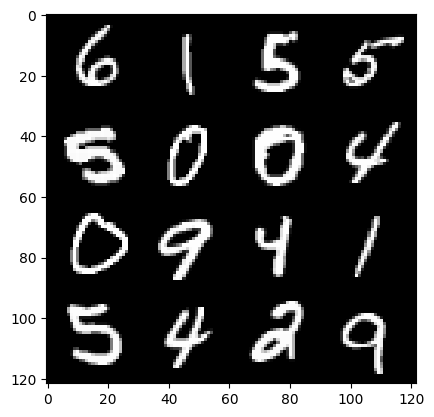

264: step 126300 / Gen loss: 1.2806990889708199 / Disc loss: 0.4518306338787077


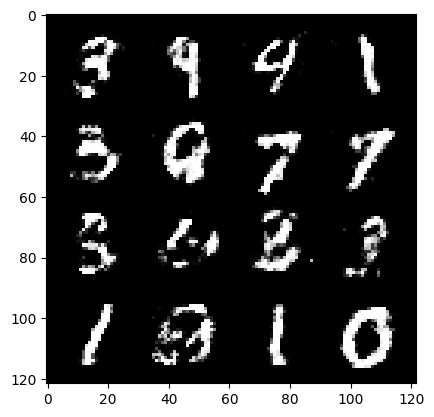

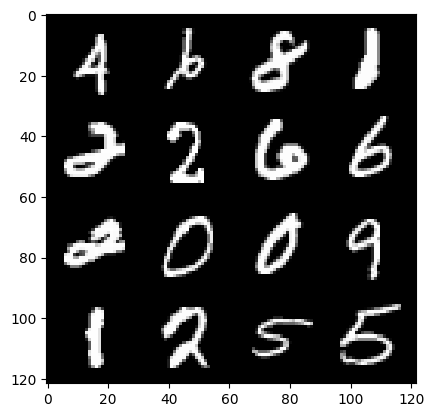

264: step 126600 / Gen loss: 1.264185366630555 / Disc loss: 0.46415037582318003


  0%|          | 0/469 [00:00<?, ?it/s]

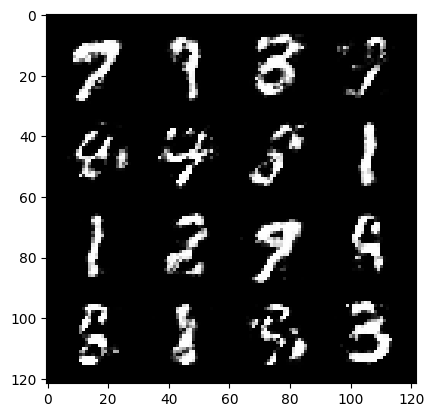

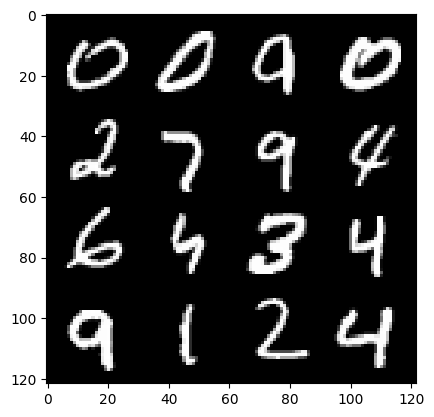

265: step 126900 / Gen loss: 1.2673820539315543 / Disc loss: 0.4555860507488251


  0%|          | 0/469 [00:00<?, ?it/s]

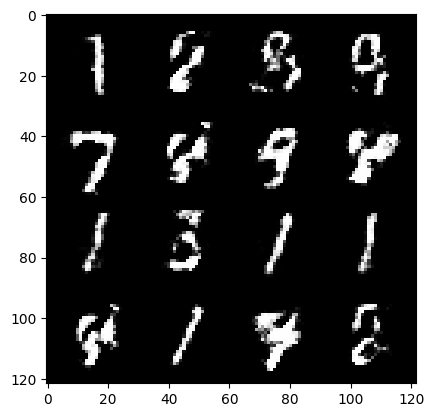

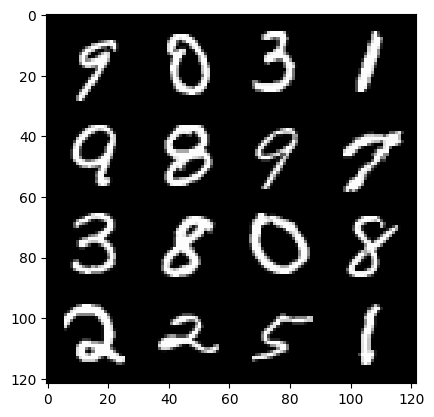

266: step 127200 / Gen loss: 1.2938882374763485 / Disc loss: 0.45053991069396326


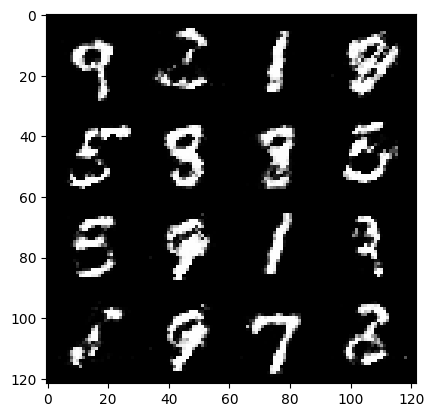

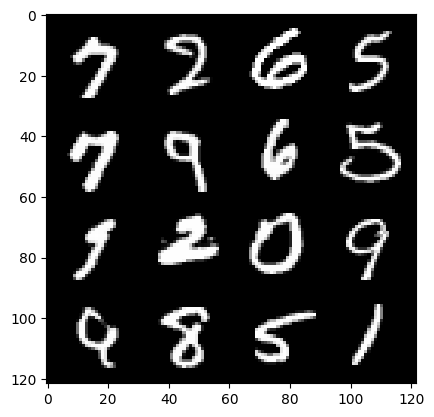

266: step 127500 / Gen loss: 1.2946041429042814 / Disc loss: 0.44567844996849726


  0%|          | 0/469 [00:00<?, ?it/s]

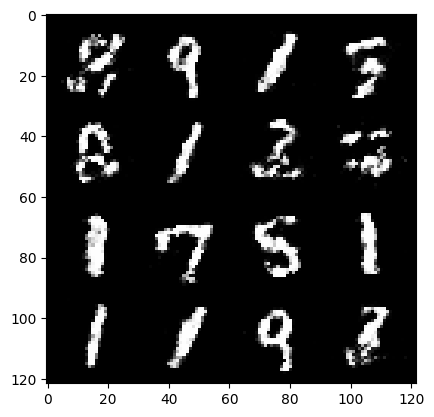

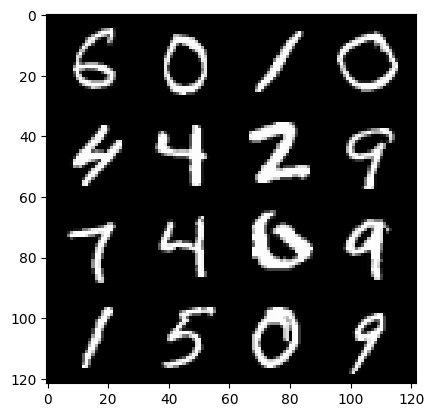

267: step 127800 / Gen loss: 1.3146554911136623 / Disc loss: 0.4546813882390659


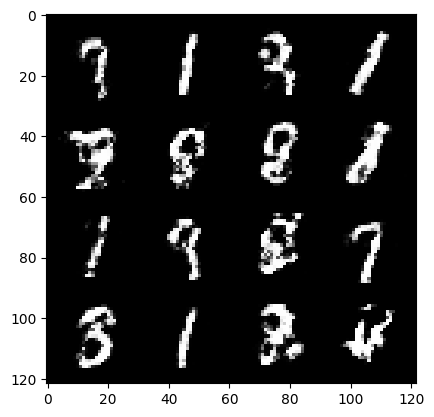

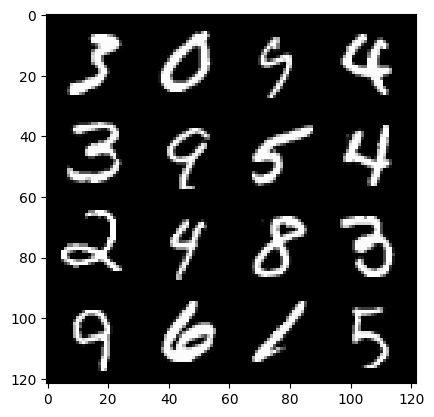

267: step 128100 / Gen loss: 1.2595581877231588 / Disc loss: 0.46807851215203594


  0%|          | 0/469 [00:00<?, ?it/s]

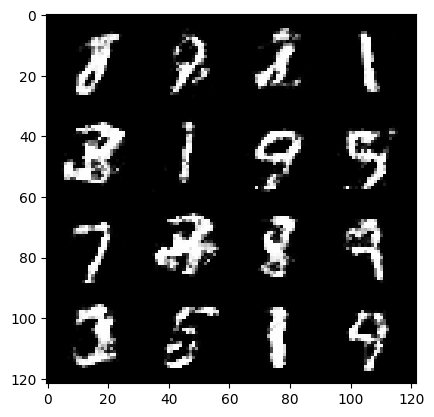

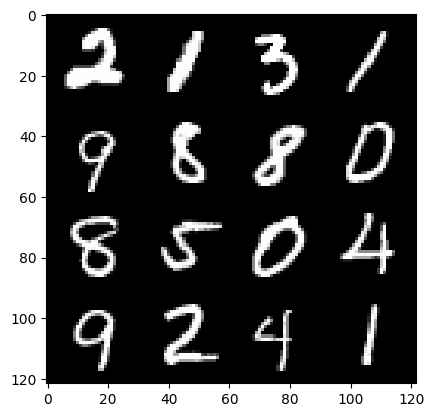

268: step 128400 / Gen loss: 1.215821135838827 / Disc loss: 0.4733788059155148


  0%|          | 0/469 [00:00<?, ?it/s]

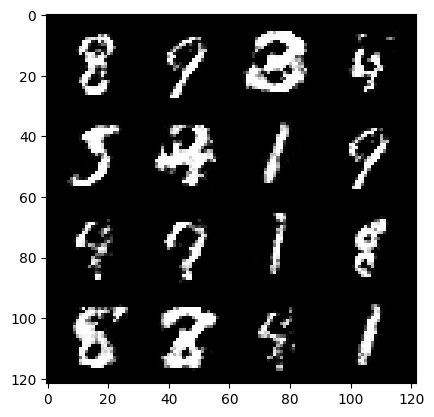

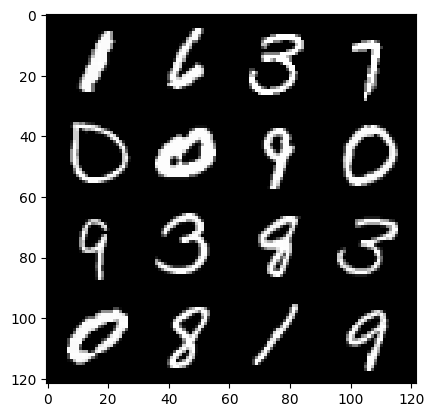

269: step 128700 / Gen loss: 1.2659423363208782 / Disc loss: 0.4645329609513283


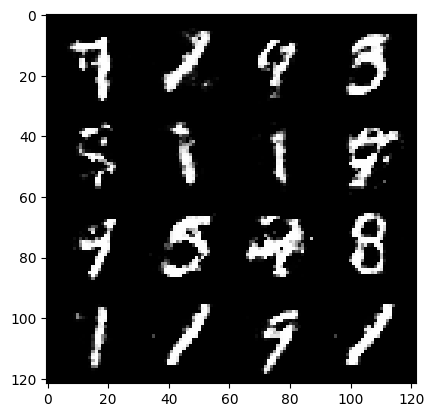

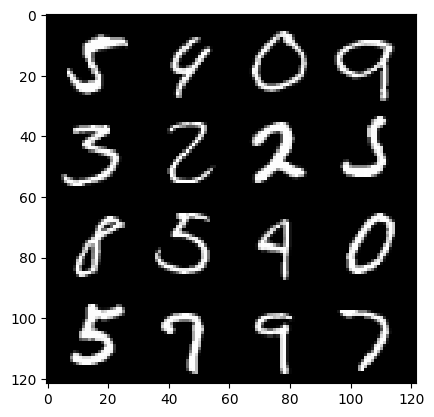

269: step 129000 / Gen loss: 1.2062775444984428 / Disc loss: 0.46971247156461093


  0%|          | 0/469 [00:00<?, ?it/s]

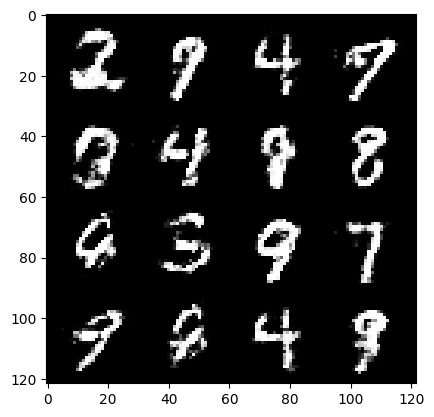

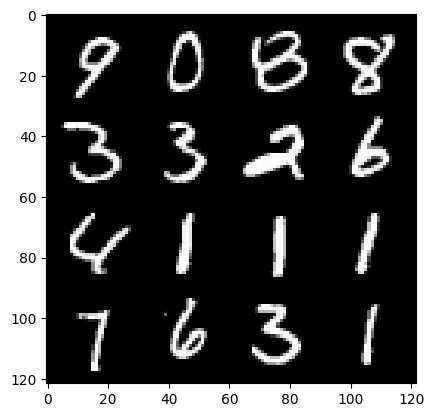

270: step 129300 / Gen loss: 1.310441381136577 / Disc loss: 0.4399240854382511


  0%|          | 0/469 [00:00<?, ?it/s]

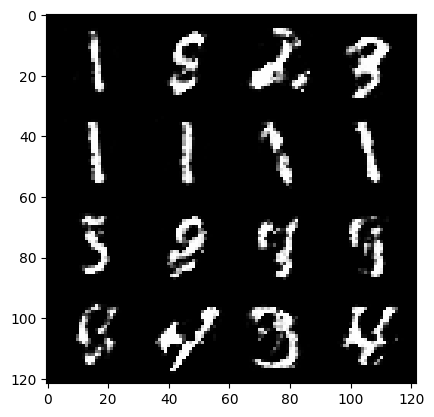

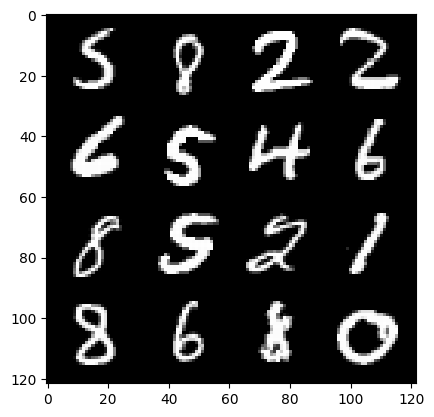

271: step 129600 / Gen loss: 1.2703781477610265 / Disc loss: 0.4677431801954909


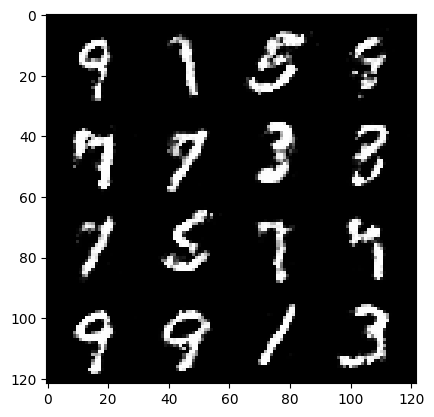

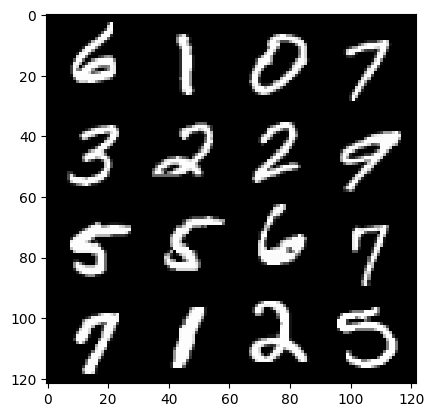

271: step 129900 / Gen loss: 1.241314915815988 / Disc loss: 0.4638785967230803


  0%|          | 0/469 [00:00<?, ?it/s]

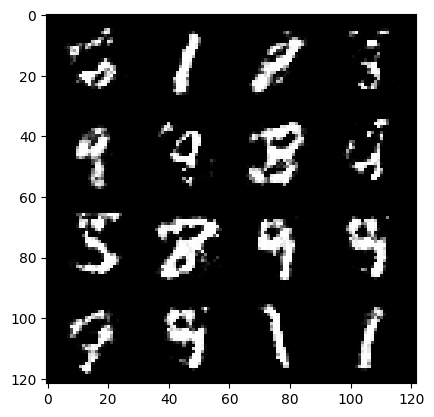

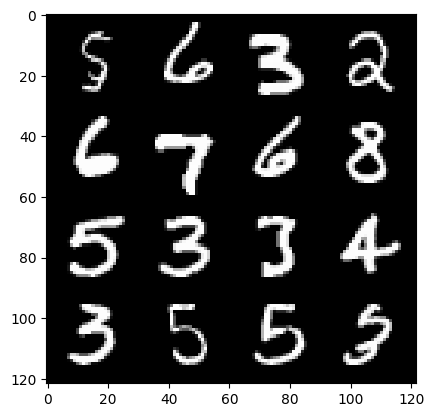

272: step 130200 / Gen loss: 1.2265003538131707 / Disc loss: 0.4662104080120719


  0%|          | 0/469 [00:00<?, ?it/s]

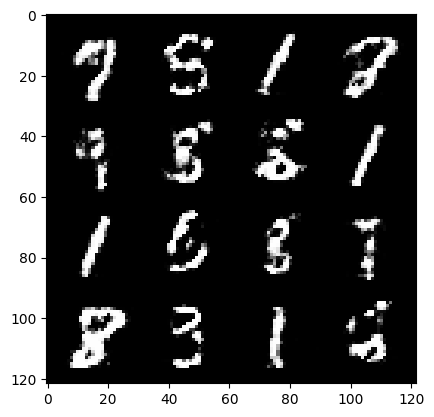

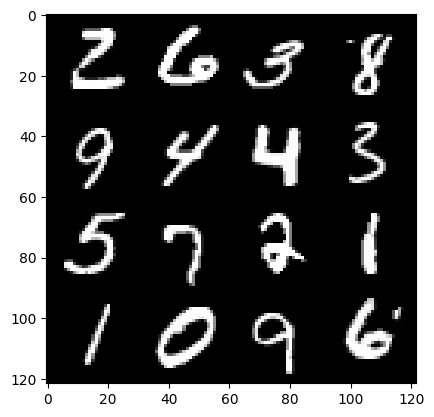

273: step 130500 / Gen loss: 1.2161001690228783 / Disc loss: 0.46152349342902516


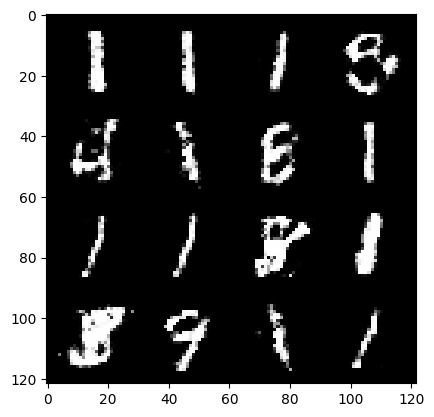

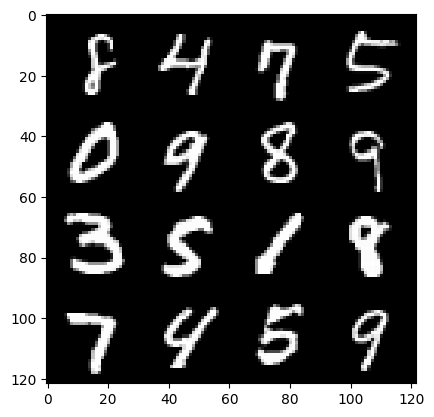

273: step 130800 / Gen loss: 1.254159269730251 / Disc loss: 0.45980261653661736


  0%|          | 0/469 [00:00<?, ?it/s]

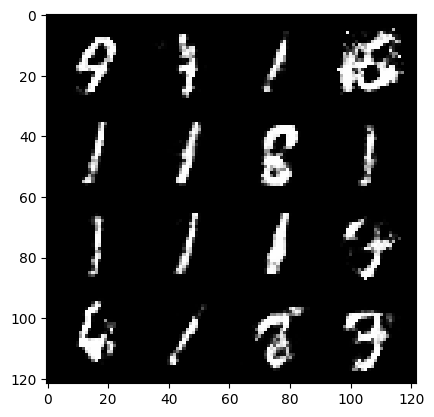

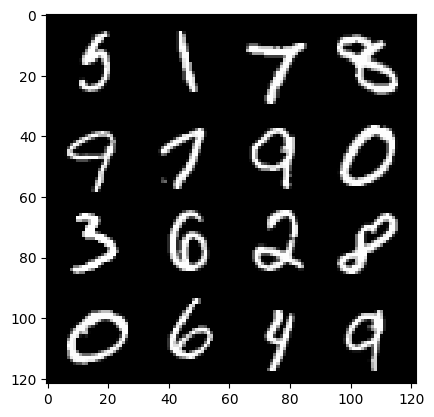

274: step 131100 / Gen loss: 1.2191368232170736 / Disc loss: 0.4841326758265498


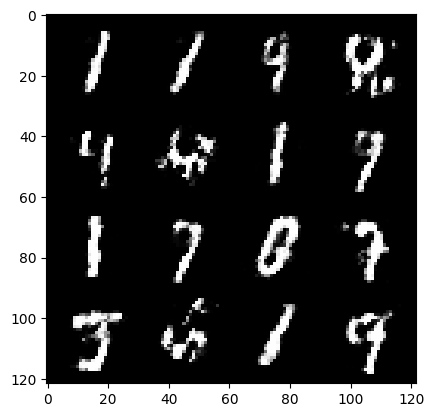

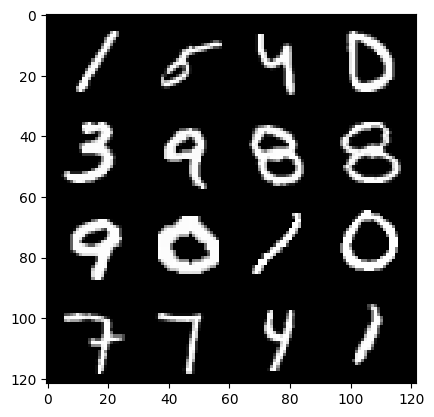

274: step 131400 / Gen loss: 1.2123902809619902 / Disc loss: 0.47863479107618345


  0%|          | 0/469 [00:00<?, ?it/s]

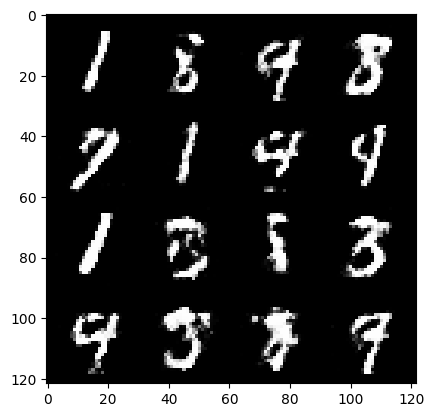

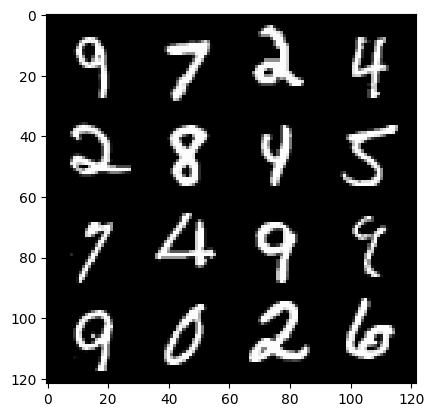

275: step 131700 / Gen loss: 1.2766830539703382 / Disc loss: 0.4595778198043503


  0%|          | 0/469 [00:00<?, ?it/s]

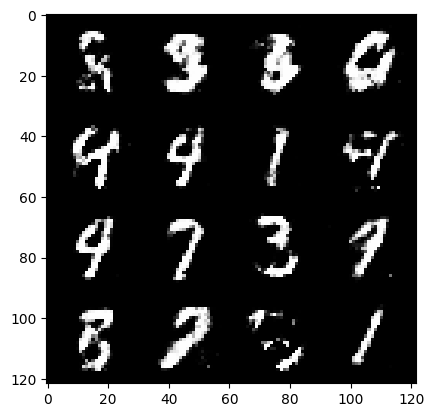

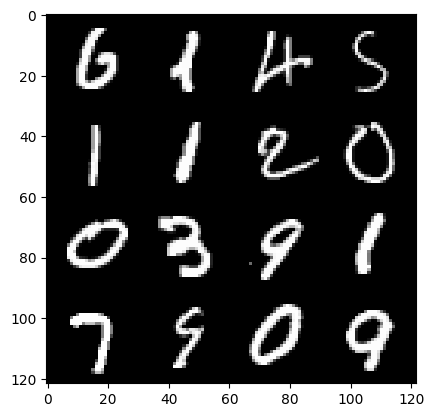

276: step 132000 / Gen loss: 1.2596819221973414 / Disc loss: 0.4622325776020685


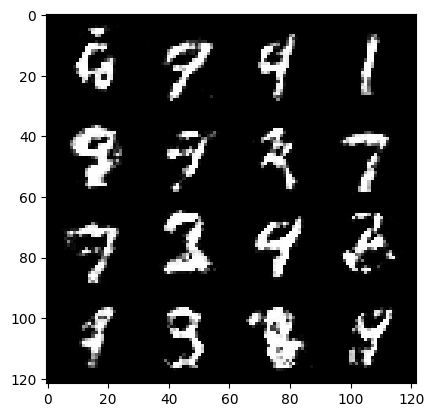

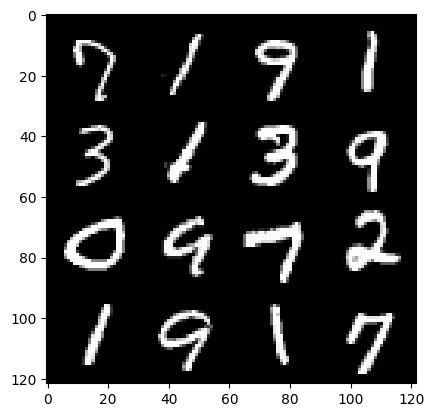

276: step 132300 / Gen loss: 1.2943857947985333 / Disc loss: 0.4528824326395991


  0%|          | 0/469 [00:00<?, ?it/s]

In [ ]:
for epoch in range(epochs):
    for real, _ in tqdm(dataloader):

        disc_opt.zero_grad()
        cur_bs = len(real)
        real = real.view(cur_bs, -1).to(device)
        disc_loss = calc_disc_loss(loss_func, gen, disc, cur_bs, real, z_dim)
        disc_loss.backward(retain_graph=True)
        disc_opt.step()

        gen_opt.zero_grad()
        gen_loss = calc_gen_loss(loss_func, gen, disc, cur_bs, z_dim)
        gen_loss.backward(retain_graph=True)
        gen_opt.step()

        mean_disc_loss += disc_loss.item() / info_step
        mean_gen_loss += gen_loss.item() / info_step

        if cur_step % info_step == 0 and cur_step > 0:
            fake_noise = gen_noise(cur_bs, z_dim)
            fake = gen(fake_noise)
            show(fake)
            show(real)
            print(f"{epoch}: step {cur_step} / Gen loss: {mean_gen_loss} / Disc loss: {mean_disc_loss}")
            mean_gen_loss, mean_disc_loss = 0, 0
        cur_step += 1
